# Import

In [5]:
import numpy as np
import numpy.ma as ma

# !pip install matplotlib==3.9.2
from matplotlib import pyplot as plt
import matplotlib
# %matplotlib inline
# matplotlib.use('agg')
import PIL
from PIL import Image
import pdb

import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import cm

from scipy.interpolate import griddata
from scipy.signal import convolve2d
from scipy.signal import correlate2d

from scipy.interpolate import CloughTocher2DInterpolator
from scipy.interpolate import interp1d
from scipy.interpolate import LinearNDInterpolator
from scipy.ndimage import gaussian_filter
from matplotlib.ticker import FormatStrFormatter

import os
from scipy.io import loadmat
#!pip install mat73
#import mat73
import seaborn as sns
%config InlineBackend.figure_format='retina'
import pandas as pd
import time
import sys
import pickle

# import cProfile
from cProfile import Profile
from pstats import SortKey, Stats

from scipy.stats import zscore
from scipy.signal import spectrogram
from sklearn.cluster import KMeans
from scipy.signal import find_peaks,peak_prominences
from scipy.signal import correlate
from scipy.ndimage import gaussian_filter1d
from scipy.ndimage import gaussian_filter
from scipy.ndimage import rotate
from scipy.ndimage import zoom

from sklearn.linear_model import Ridge,Lasso,LinearRegression,LogisticRegression
import gc

import matplotlib as mpl
mpl.rcParams['figure.dpi'] = 100

def circ_dist(x,y):
    return np.minimum(np.abs(x-y),2*np.pi-np.abs(x-y))

def circ_mean(x,axis=-1,keepdims=False):
    return np.arctan2(np.sin(x).mean(axis,keepdims=keepdims),np.cos(x).mean(axis,keepdims=keepdims))

sns.set(style='ticks',font_scale=1.2)

import cupy as cp

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
import torch.optim as optim
from torch.optim import lr_scheduler
from torch.distributions import MultivariateNormal

device = torch.device('cuda')
dtype = torch.float32

# Helper function to convert between numpy arrays and tensors
to_t = lambda array: torch.tensor(array, device=device, dtype=dtype)
from_t = lambda tensor: tensor.to("cpu").detach().numpy()



In [9]:
import GPUtil
len(GPUtil.getAvailable())

1

In [7]:
device = torch.device('cuda')
device

device(type='cuda')

In [7]:
def fix_boundary_vel(vel, start_pos, minx, miny, maxx, maxy, fix_factor = 1):
    pos = np.cumsum(vel, axis=0) + start_pos
    n_bins = vel.shape[0]

    # flip velocity signs when it causes you to cross boundary
    for i in np.arange(n_bins-1):
        old_vel = np.copy(vel[i, :])
        if pos[i+1, 0] < minx: # if at the next timestep, you're at or past maximum boundary
            vel[i, 0] = fix_factor*np.abs(vel[i, 0]) # then, change this timestep's velocity to be positive instead of negative
            # pos[i+1:, 0] += 2*vel[i, 0] # add twice the new velocity because changed the direction
            
        if pos[i+1, 0] > maxx: # if at the next timestep, you're at or past minimum boundary
            vel[i, 0] = -1*fix_factor*np.abs(vel[i, 0]) # then, change this timestep's velocity to be negative instead of positive
            # pos[i+1:, 0] += 2*vel[i, 0] # add twice the new velocity because changed the direction
            
        if pos[i+1, 1] < miny:
            vel[i, 1] = fix_factor*np.abs(vel[i, 1])
            # pos[i+1:, 1] += 2*vel[i, 1]
           
        if pos[i+1, 1] > maxy:
            vel[i, 1] = -1*fix_factor*np.abs(vel[i, 1])
            # pos[i+1:, 1] += 2*vel[i, 1]

        pos[i+1:, :] += (vel[i] - old_vel) # subtract off the old velocity and replace with the new one
        
    return vel

In [8]:
# def fix_boundary_vel(vel, start_pos, minx, miny, maxx, maxy, fix_factor = 1):
#     pos = np.cumsum(vel, axis=0) + start_pos
#     n_bins = vel.shape[0]

#     # flip velocity signs when it causes you to cross boundary
#     for i in np.arange(n_bins-1):
#         if pos[i+1, 0] < minx: # if at the next timestep, you're at or past maximum boundary
#             vel[i, 0] = fix_factor * np.abs(vel[i, 0]) # then, change this timestep's velocity to be positive instead of negative, multipied by the fix_factor
            
#         if pos[i+1, 0] > maxx: # if at the next timestep, you're at or past minimum boundary
#             vel[i, 0] = -fix_factor*np.abs(vel[i, 0]) # then, change this timestep's velocity to be negative instead of positive, multipied by the fix_factor
            
#         if pos[i+1, 1] < miny:
#             vel[i, 1] = fix_factor * np.abs(vel[i, 1])
           
#         if pos[i+1, 1] > maxy:
#             vel[i, 1] = -fix_factor*np.abs(vel[i, 1])

#         pos[i+1,:] = pos[i,:] + vel[i,:]
            
#     return vel

In [9]:
def calc_maps(A, track_length, spatial_bin, velocity_gain):
    n_total_timebins, N = A.shape

    posx_lin = np.arange(0, n_total_timebins*velocity_gain*0.5, velocity_gain*0.5)
    posx = np.mod(posx_lin, track_length)
    n_spatial_bins = int(track_length // spatial_bin)

    trial_idxs = np.concatenate((np.array([0]), np.where(np.diff(posx)<-20)[0]+1, np.array([posx.shape[0]+1])))
    # print(posx_lin.max(0))
    # print(trial_idxs.shape)
    n_trials = trial_idxs.shape[0]-1
    
    raw_maps = np.zeros((N, n_trials, n_spatial_bins))
    for t in range(n_trials):
        trial_A = A[trial_idxs[t]:trial_idxs[t+1], :]
        trial_posx = posx[trial_idxs[t]:trial_idxs[t+1]]
        bins = np.arange(0, track_length, spatial_bin)
        
        posx_bins = np.concatenate((np.array([0]), 
                                    np.cumsum(np.histogram(trial_posx, bins)[0])))
    
        for c in range(N):
            f = interp1d(trial_posx, trial_A[:, c], fill_value='extrapolate', kind='cubic')
            trial_fr = f(bins)
    
            raw_maps[c, t, :] = trial_fr
            
    return raw_maps, posx_lin, posx

In [10]:
def fig2data ( fig ):
    """
    @brief Convert a Matplotlib figure to a 4D numpy array with RGBA channels and return it
    @param fig a matplotlib figure
    @return a numpy 3D array of RGBA values
    """
    # draw the renderer
    fig.canvas.draw ( )
 
    # Get the RGBA buffer from the figure
    w,h = fig.canvas.get_width_height()
    buf = np.frombuffer ( fig.canvas.tostring_argb(), dtype=np.uint8 )
    buf.shape = ( w, h,4 )
 
    # canvas.tostring_argb give pixmap in ARGB mode. Roll the ALPHA channel to have it in RGBA mode
    buf = np.roll ( buf, 3, axis = 2 )
    return buf
    
def fig2img(fig):
    """
    @brief Convert a Matplotlib figure to a PIL Image in RGBA format and return it
    @param fig a matplotlib figure
    @return a Python Imaging Library ( PIL ) image
    """
    # put the figure pixmap into a numpy array
    buf = fig2data ( fig )
    w, h, d = buf.shape
    return Image.frombuffer( "RGBA", ( w ,h ), buf.tobytes( ) )

In [11]:
def nan_helper(y):
    """Helper to handle indices and logical indices of NaNs.

    Input:
        - y, 1d numpy array with possible NaNs
    Output:
        - nans, logical indices of NaNs
        - index, a function, with signature indices= index(logical_indices),
          to convert logical indices of NaNs to 'equivalent' indices
    Example:
        >>> # linear interpolation of NaNs
        >>> nans, x= nan_helper(y)
        >>> y[nans]= np.interp(x(nans), x(~nans), y[~nans])
    """

    return np.isnan(y), lambda z: z.nonzero()[0]


In [12]:
def get_2d_sort(x1,x2,resx,resy):
    """
    Reshapes x1 and x2 into square arrays, and then sorts
    them such that x1 increases downward and x2 increases
    rightward. Returns the order.
    """
    n = np.minimum(resx,resy)
    total_order = x1.argsort()
    total_order = total_order.reshape(resx,resy)
    for i in np.arange(n):
        row_order = x2[total_order.ravel()].reshape(resx,resy)[i].argsort()
        total_order[i] = total_order[i,row_order]
    total_order = total_order.ravel()
    return total_order

In [13]:
def coord_from_phase(p1,p2):
    c1 = p1 + p2/2
    c2 = np.sqrt(3)*p2/2
    return c1,c2

def plot_rhombus(x0,y0):
    plt.plot([x0+0,x0+1],[y0+0,y0+0],c='black',linestyle='dashed')
    plt.plot([x0+1,x0+1.5],[y0+0,y0+np.sqrt(3)/2],c='black',linestyle='dashed')
    plt.plot([x0+0.5,x0+1.5],[y0+np.sqrt(3)/2,y0+np.sqrt(3)/2],c='black',linestyle='dashed')
    plt.plot([x0+0,x0+0.5],[y0+0,y0+np.sqrt(3)/2],c='black',linestyle='dashed')

def plot_line(r,theta,x0=0,y0=0,c='black'):
    plt.plot([x0,x0-r*np.cos(theta)],[y0,y0-r*np.sin(theta)],c=c)

from scipy import ndimage
from matplotlib.collections import LineCollection
def plot_multicolor(x,y,ax,linewidth=1,f=1, cmap='magma'):
    t = np.tile(np.linspace(0,1,len(x)//f),f)
    points = np.array([x, y]).T.reshape(-1, 1, 2)
    segments = np.concatenate([points[:-1], points[1:]], axis=1)
    norm = plt.Normalize(t.min(), t.max())
    lc = LineCollection(segments, cmap=cmap, norm=norm)
    lc.set_array(t)
    lc.set_linewidth(linewidth)
    ax.add_collection(lc)
    ax.set_xlim(x.min(), x.max())
    ax.set_ylim(y.min(), y.max())

def plot_line(r,theta,x0=0,y0=0,c='black'):
    plt.plot([x0,x0-r*np.cos(theta)],[y0,y0-r*np.sin(theta)],c=c)

In [14]:
# # OLD KEEP IN CASE WANT TO TRY DIFFERENT V AND BETA
# # beta = np.pi/2
# #1000 x 866
# #100 x 87

# # n_x = 10 # column n
# # n_y = 9 # row n
# n_x = 13 # column n
# n_y = 11 # row n
# # n_x = 6 # column n
# # n_y = 5 # row n
# N = n_x * n_y

# # Update function
# # tau = 0.8 # original
# tau = 0.95 # higher value to stabilize activity. might be necessary for larger N
# I = 0.3
# alpha = 0.06
# # T = 0.05 # original
# T = 0.05
# # sigma = 0.24 # original
# sigma = 0.25

# n_timebins = 100000
# cell_positions = calc_cell_positions(n_y, n_x)
# cell_position_diffs = calc_cell_position_diffs(cell_positions)
# init_state = initialize_network(n_y, n_x, seed=1)
# init_state = init_state.reshape(-1)

# rng = np.random.default_rng(seed=3)
# v_mu0 = 0.6
# v_mu1 = 0.4
# v_sigma0 = 1
# v_sigma1 = 5

# v_smooth_sigma0 = 10
# v_smooth_sigma1 = 10

# # beta = np.linspace(np.pi/6, np.pi/3, n_timebins) # GOOD
# # should make beta and velocity independent of n_timebins. also try without noise first

# beta = 1/(12*np.pi) * (np.sin(np.arange(n_timebins,)/1000)) + np.pi/6

# # range should be pi/6

# # previous beta
# # beta1 = np.linspace(np.pi/6, np.pi/3-0.05, 2*n_timebins//3) + np.cumsum(20/n_timebins*rng.standard_normal(size=(2*n_timebins//3,)))
# # beta2 = np.linspace(np.pi/3-0.05, np.pi/3.5, n_timebins//3) + np.cumsum(20/n_timebins*rng.standard_normal(size=(n_timebins//3,)))
# # beta = gaussian_filter1d(np.concatenate((beta1,beta2)), n_timebins/100)
# # beta = beta.clip(min=np.pi/6, max=np.pi/3)
# # beta = (0.5* gaussian_filter1d(rng.uniform(low=0, high=np.pi/3, size=(n_timebins,)), 1000) +
# #         0.5* gaussian_filter1d(rng.uniform(low=0, high=np.pi/3, size=(n_timebins,)), 100))
# # plt.plot(gaussian_filter1d(beta, 100))


# # velocity = np.zeros((n_timebins, 2))
# # velocity[:, 0] = v_mu0 + v_sigma0 * rng.standard_normal(size=(n_timebins,))
# # velocity[:, 1] = v_mu1 + v_sigma1 * rng.standard_normal(size=(n_timebins,))
# # speed = np.linalg.norm(velocity, axis=1)
# # overspeed = np.where(speed > 0.9)[0]
# # velocity[overspeed] = velocity[overspeed]*0.8

# velocity = 0.5*np.ones((n_timebins, 2))
# # velocity[:,0]= 0.75 * (np.sin(np.arange(0, n_timebins)/(n_timebins/2)))
# # velocity[:,1]= 0.75 * (np.cos(np.arange(0, n_timebins)/(n_timebins/2)))

# # velocity[:,0]= 0.075 * (np.sin(np.arange(n_timebins//2, 3*n_timebins//2)/(n_timebins/8))+2)
# # velocity[:,1]= 0.15 * (np.cos(np.arange(-n_timebins//2, n_timebins//2)/(n_timebins/16))+2)

# # timestep_noise = 100/n_timebins*rng.standard_normal(size=(n_timebins,2))
# # cumulative_noise = np.cumsum(timestep_noise, axis=0)
# # cumulative_noise = cumulative_noise.clip(min=-0.15, max=0.75)

# # velocity = velocity + cumulative_noise
# # velocity = velocity.clip(min=-0.5, max=0.75)

# # velocity[:, 0] = gaussian_filter1d(velocity[:, 0], v_smooth_sigma0, axis=0)
# # velocity[:, 1] = gaussian_filter1d(velocity[:, 1], v_smooth_sigma1, axis=0)

# # new_speed = np.linalg.norm(velocity, axis=1)

# # velocity = np.ones((n_timebins, 2))
# # plt.subplot(3,1,1)
# # plt.plot(velocity[:, 0])
# # plt.plot(velocity[:, 1])
# # # plt.plot(cumulative_noise[:,0])
# # # plt.plot(cumulative_noise[:,1])
# # plt.plot(new_speed)
# # plt.ylim([-0.5, 1])

# # plt.subplot(3,1,2)
# # plt.plot(np.cumsum(velocity[:, 0]), np.cumsum(velocity[:, 1]))

# # plt.subplot(3,1,3)
# # posx_temp = np.cumsum(new_speed, axis=0)
# # plt.plot(posx_temp)

# Guanella et al. Model

## Model Description

### 2.1 Neurons

#### Activity and Stabilization
$A_i(t+1) = B_i(t+1) + \tau\bigg(\frac{B_i(t+1)} {{<B_j(t)>}_{j=1}^{N}} - B_i(t+1)\bigg)$

$B_i(t+1) = A_i(t) + \sum_{j=1}^{N}A_j(t)w_{ji}(t)$

$\tau$ = stabilization strength

${< \space .\space>}_{j=1}^{N}$ is the mean over cells in the network

Neurons initialized with random activity $0$ and $1/\sqrt N$

$A$: activity

$B$: linear transfer function

$A_i < 0$ are set to $0$

### 2.2 Synapses

Two sets of weights
1. There is an additional external unit that receives and sends projections to all the grid cells with weight 1
2. Weights that instantiate attractor dynamics: weights between the N cells:

#### Attractor Dynamics
$w_{ij} = I \exp \bigg(- \frac{||c_i - c_j||^2_{tri}} {\sigma^2}\bigg) - T$

$\bf{c_i}$ $= (c_{i_{x}}\space ,\space c_{i_{y}})$, the position of cell $i$ defined respectively by 

$ c_{i_{x}} = (i_x− 0.5)/N_x $ and by 

$ c_{i_{y}} = \frac{\sqrt3}{2} (i_y− 0.5)/N_y$

with $i_x \in \{1, 2, ..., N_x\}$ and
$i_y \in \{1, 2, ..., N_y\}$, and where $N_x$ and $N_y$ are the number of columns and rows
in the cells matrix and $i_x$ and $i_y$ the column and the row numbers of
cell $i$. 

$I$ is the intensity parameter, $\sigma$ regulates the size of the Gaussian and $T$ is the shift parameter


$\text{dist}_{tri}(\bf{c_i}$ $, $ $\bf c_j$ $)$ := $\| c_i− c_j \|_{tri} = \text{min}_{k=1}^7 \|\bf c_i $ $− \space \bf c_j$ $+ \bf \space s_k\|$, 

where

$s_1 := (0, 0)$

$s_2 := (−0.5, \frac{\sqrt3}{2})$

$s_3 := (−0.5, -\frac{\sqrt3}{2})$

$s_4 := (0.5, \frac{\sqrt3}{2})$

$s_5 := (0.5, -\frac{\sqrt3}{2})$

$s_6 := (−1, 0)$

$s_7 := (1, 0)$

and where $\| \space . \space \|$ is the Euclidean norm.

#### Modulation
$v := (v_x, v_y)$

The maximum speed of the agent is set by $v_{max}$ such that $\| v \|$ is always smaller than $v_{max}$.

The scale and orientation of the grid is dictated by the gain factor $\alpha \in \mathbb{R}^+$ and bias $\beta \in [0, π/3]$

The input of the network is thus modulated and biased by the gain and the bias parameters, with

$v \longmapsto \alpha R_{\beta}v$ , 

where $R_{\beta}$ is the rotation matrix of angle $\beta$ defined by

$R_{\beta} = \begin{bmatrix}
\cos(\beta) & -\sin(\beta) \\
\sin(β) & cos(β)\end{bmatrix}$


The activity pattern is stable when the mobile agent stays immobile. However,
when the agent moves, the synaptic connections of the network shift in the
direction of the speed vector of the robot. When expressing the synaptic
weight as a function of time, we have

$w_{ij}(t + 1) =  I \exp \bigg(- \frac{\|c_i - c_j+ \alpha R_{\beta}v(t)\|^2_{tri}} {\sigma^2}\bigg) - T$

### 2.2' Landmarks and Noise

This model is modified in two key ways from the model described in Guanella et al 2007. The first modification adds heading direction noise at each timestep, and the second introduces landmark inputs to the grid cell network. Heading direction noise is added as 

$\beta_{\text{noisy}}(t) = \beta + \sigma_{\beta} r(t)$ 

where $\beta$ is the unmodified bias, $\sigma_{\beta}$ regulates the extent of noise, and $r(t)$ is drawn from the standard normal distribution, and $\beta_{\text{noisy}}(t)$ is still constrained such that $\beta_{\text{noisy}}(t) \in [0, π/3]$ The rotation matrix is then calculated using $\beta_{\text{noisy}}(t)$.

Landmark inputs are added with the addition of landmark cells and their unidirectional excitatory synaptic connections to grid cells. When landmarks are present, each landmark $L_{i}$ is associated with its own dedicated landmark cell whose activity $A_{L_i}$ is dependent on the agent's proximity to the landmark's position, where $i \in \{1, ..., N_L\}$ and where $N_L$ is the number of landmarks present. The activity of landmark cell $A_{L_i}$ is defined as

$A_{L_i} = \begin{cases} 
\alpha_{L_i} \exp \bigg(- \frac{||p(t) - p_{L_i}||^2} {\big(\frac{1}{2} q_{L_i}\big)^2} \bigg) &  \text{if} \space ||p(t) - p_{L_i}|| \leq q_{L_i} \\
0 & \text{otherwise}
\end{cases} $

where the strength of landmark $L_i$ is governed by $\alpha_{L_i} \in \mathbb{R}^+$, $p(t):= (p_x(t), p_y(t))$ is the position of the agent at time $t$, $p_{L_i} := (p_{L_{i_x}}, p_{L_{i_y}})$ is the position of $L_i$, and $q_{L_i} \in \mathbb{R}^+$ represents the lookahead distance at which landmark $L_i$ begins recruiting the activity of its landmark cell. In the most basic form of this model, each landmark cell sends an excitatory connection to only one grid cell and contributes to its activity through the linear transfer function:

$B_i(t+1) = A_i(t) + \sum_{j=1}^{N}A_j(t)w_{ji}(t) + \sum_{k=1}^{N_{L}} A_{L_k}(t) w_{ki}$

where $w_{ki} = 1$ and $\sum_{i=1}^{N} w_{ki} = 1$, allowing each landmark cell to be connected with only one grid cell. 

A model containing a Hebbian plasticity term between landmark cells and grid cells makes the following modifications:
1. The weight between each landmark cell and the $N$ grid cells is initialized randomly with values between $0$ and $1/\sqrt N$
2. Hebbian plasticity allows changes in weights between landmark cells and grid cells as follows:

$w_{ki}(t+1) = w_{ki}(t) + \alpha_{\text{hebb}} (A_i(t) A_{L_k}(t)) - \alpha_{\text{decay}}$

where $ \alpha_{\text{hebb}}$ regulates the extent of Hebbian potentiation and $ \alpha_{\text{decay}}$ provides a constant decay factor. Weight values are constrained to be between some minimum $W_{L_{\text{min}}}$ and maximum $W_{L_{\text{max}}}$

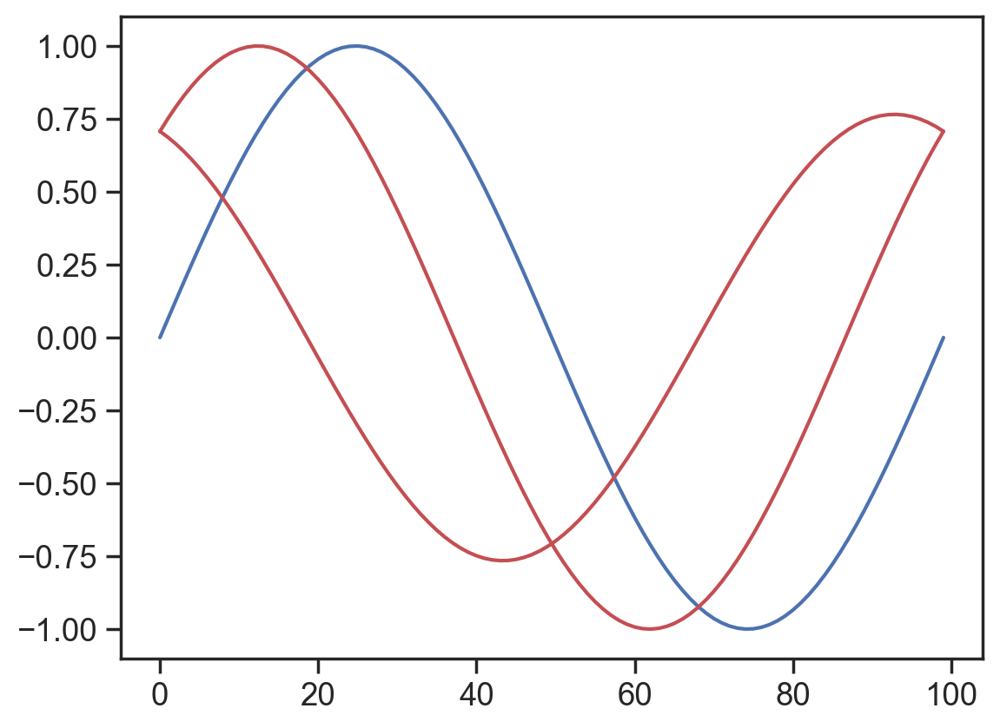

In [15]:
xs = np.linspace(0, 2*np.pi, 100)
a1 = np.sin(xs)
a_sub = np.sin(xs + np.pi/4)
a_add = np.sin(xs - np.pi/4)

plt.plot(a1)
plt.plot(a_sub, c='r')
plt.plot(a_sub-a1, c='r')

## 2.3 Mobile Agent and Environment
Actual robot used and arena is 1m x 1m, where the 1m side is 18x larger than robot diameter of 0.055m

## 2.4 Parameters
Parameter Value Unit

$N = 90$ [cell]

$N_x = 10$ [cell]

$N_y = 9$ [cell]

$\tau = 0.8$ [no unit]

$I = 0.3$ [no unit]

$\sigma = 0.24$ [meter]

$T = 0.05$ [no unit]

$v_{max} = 0.0275$ [meter/time step]

## Instantiation

### Functions

In [28]:
def plot_weight_mat(cell_position_diffs, cell_idx, W, three_dim):
    fig = plt.figure()
    
    xs = cell_position_diffs[0, :, cell_idx]
    ys = cell_position_diffs[1, :, cell_idx]
    zs = W[:,cell_idx]

    if three_dim:
        ax = fig.add_subplot(projection='3d')
        ax.scatter(xs, ys, zs)
    else:
        plt.scatter(xs, ys, c=zs)
    
    # ax.set_xlabel('X Label')
    # ax.set_ylabel('Y Label')
    # ax.set_zlabel('Z Label')


In [29]:
def relu(x):
    return np.maximum(x, 0)

In [30]:
def calc_cell_positions(n_y, n_x):
    cell_positions = np.zeros((2, n_y, n_x))
    cell_positions[0, :, :] = np.tile(np.sqrt(3)/2 * (np.arange(1, n_y+1) - 0.5) / n_y, (n_x, 1)).T
    cell_positions[1, :, :] = np.tile((np.arange(1,n_x+1) - 0.5)/n_x, (n_y, 1))
  
    return cell_positions # 2 x n_y x n_x

In [31]:
def one_to_two_index(idx, n_y): # equivalent to the commented out version using n_x since everything is flipped
    # to get the 2d indices from a 1d index
    two_index = []
    two_index.append(int(np.mod(idx, n_y)))
    two_index.append(int(idx - np.mod(idx, n_y))//n_y)
    # assuming n_y is dimension 0 (row #), this will gives you a two_index of [row #, col #]
 
    return two_index

In [32]:
def calc_cell_position_diffs(cell_positions):
    # want to be able to get the difference between positions of cells c_l and c_m easily.
    # there are (n_y * n_x)^2 comparisons. easiest way is just to vectorize it. 
    # cell_position_diffs is of shape 2 x (n_y * n_x) x (n_y * n_x) with element :,l,m representing the difference between the positions of c_l - c_m
    # if you want the compare cell c_l (at position i1j1) to cell c_m (at position i2j2), you get their 1d indices.
    _, n_y, n_x = cell_positions.shape
    N = n_y * n_x
    cell_position_diffs = np.zeros((2, N, N))
    # cell_positions_vec = cell_positions.reshape(2, -1)

    for i in range(N):
        # cell_position_diffs[:, i, :] = cell_positions_vec - np.roll(cell_positions_vec, -i)
        # cell1_idx = one_to_two_index(i, n_x)
        cell1_idx = one_to_two_index(i, n_y) # sequentially down the rows then left to right through columns

        cell1_pos = cell_positions[:, cell1_idx[0], cell1_idx[1]]
        
        for j in range(N):
            # cell2_idx = one_to_two_index(j, n_x)
            cell2_idx = one_to_two_index(j, n_y)

            cell2_pos = cell_positions[:, cell2_idx[0], cell2_idx[1]]

            cell_position_diffs[:, i, j] = cell1_pos - cell2_pos
            
    return cell_position_diffs

In [33]:
# _, n_y, n_x = cell_positions.shape
# N = n_y * n_x
# cell_position_diffs = np.zeros((2, N, N))
# # cell_positions_vec = cell_positions.reshape(2, -1)

# for i in range(1):
#     # cell1_idx = one_to_two_index(i, n_x)
#     cell1_idx = one_to_two_index(i, n_y) # sequentially through rows then columns
#     cell1_pos = cell_positions[:, cell1_idx[0], cell1_idx[1]]
#     # plt.scatter(cell1_pos[1], cell1_pos[0])
#     print(f'i={i}, cell1_col={cell1_idx[1]}, cell1_row={cell1_idx[0]}, cell1_pos={cell1_pos}')
    
    
#     for j in range(N):
#         # cell2_idx = one_to_two_index(j, n_x)
#         cell2_idx = one_to_two_index(j, n_y)
#         cell2_pos = cell_positions[:, cell2_idx[0], cell2_idx[1]]
#         print(f'j={j}, cell2_col={cell2_idx[1]}, cell2_row={cell2_idx[0]}, cell2_posx={cell2_pos[1]}, cell2_posy={cell2_pos[0]}')

#         cell_position_diffs[:, i, j] = cell1_pos - cell2_pos

        
#         # colors = cmap(np.linspace(0.2, 0.75, N))
#         # plt.plot(cell2_pos[1], cell2_pos[0], '*', ms =j)

#     # plt.scatter(cell1_pos[1], cell1_pos[0], c='k')
#     # plt.ylim([0,1])
#     # plt.xlim([0,1])


In [34]:
def calc_tri_dist_squared(mat):
    n_comps = mat.shape[1]
    S = np.array([[0, 0], [-0.5, np.sqrt(3)/2], [-0.5, -np.sqrt(3)/2], 
                  [0.5, np.sqrt(3)/2], [0.5, -np.sqrt(3)/2], [-1, 0], [1, 0]]) # THIS WAS WRONG!!! MY MATRIX WAS ASSUMING THE Y VALUE WAS IN INDEX 0 ALONG AXIS 1!! JUST NEED TO FLIP LR
    S = np.fliplr(S)
    
    # make copies to do vector subtractions
    S = np.swapaxes(np.expand_dims(S, 1), 2, 0)
    S = np.tile(S, (1, n_comps, 1))
    
    mat = np.expand_dims(mat, 2)
    mat = np.tile(mat, (1, 1, 7))
    sum_mat = S + mat #np.tile(vec, (7,1))
    
    t_sum_mat = to_t(sum_mat)
    # cp_sum_mat = cp.array(sum_mat)
    # tri_dist_squared = np.min(np.sum(np.power(t_sum_mat, 2), axis=0), axis=1)
    t_tri_dist_squared = torch.min(torch.sum(torch.pow(t_sum_mat, 2), 0), 1)[0]
    tri_dist_squared = from_t(t_tri_dist_squared.cpu())
    return tri_dist_squared #, S, np.linalg.norm(S+np.tile(vec, (7,1)), axis=1)

In [35]:
torch.cuda.is_available()

True

In [36]:
# mat = np.random.randn(2,100)
# a=calc_tri_dist_squared(mat)
# awh

In [37]:
def calc_rot_mat(beta):
    R_beta = np.stack([[np.cos(beta), -np.sin(beta)], [np.sin(beta), np.cos(beta)]])
                      
    return R_beta

# double check: calc_cell_positions is called using  order n_y n_x, W is such that col a is effect on cell a, that update function uses W^T A, ALSO, WHY DOESN'T CELL POSITIONS GO ALL THE WAY TO 1 FOR THE N_Y DIMENSION?? BECAUSE IT'S MEANT TO BE NP.SQRT(3)/2 THE SIZE OF X

(2, 10, 9)


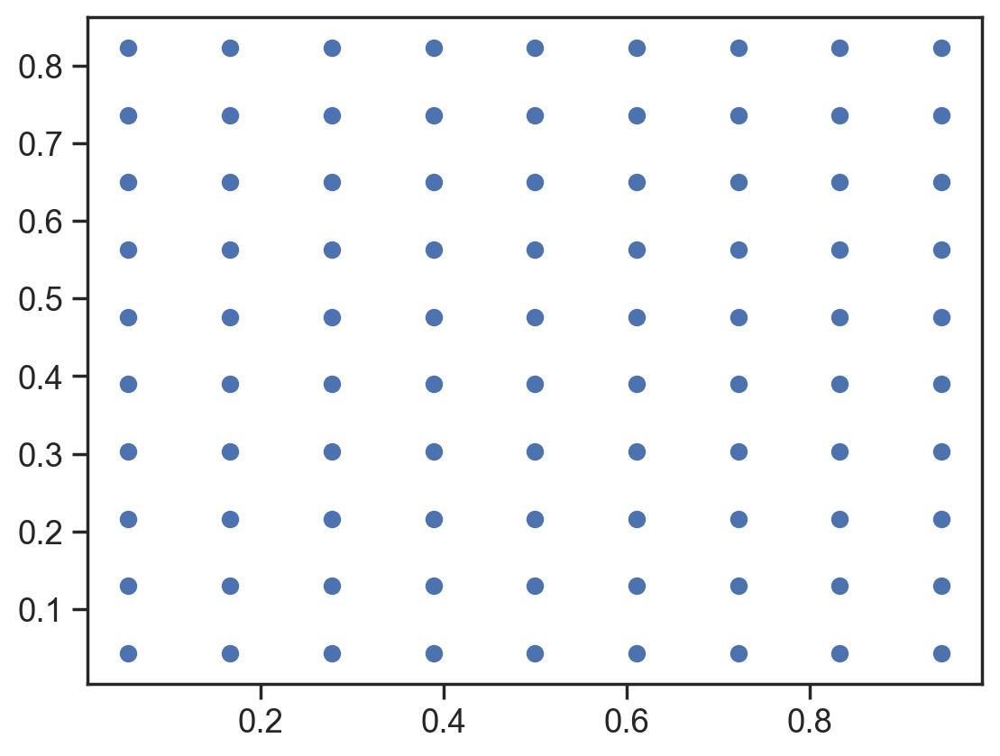

In [38]:
n_x = 10
n_y = 9

cell_positions = calc_cell_positions(n_x, n_y)
cell_positions = np.copy(cell_positions)
print(cell_positions.shape)
plt.scatter(cell_positions[1], cell_positions[0])
# plt.ylim([0, 1])
# plt.xlim([0, 1])

In [791]:
cell_positions.shape

(2, 3, 4)

In [725]:
cell_positions.shape

(2, 3, 4)

In [718]:
cell_position_diffs = calc_cell_position_diffs(cell_positions)
cell_position_diffs.shape

(2, 12, 12)

# SOMETHING WRONG WITH THIS MATRIX CALCULATION THING??? TRY USING JUST THE NON VECOTIRZED FORM??? ALL FIXED. ANNOYING ISSUE WITH S ORIGINALLY

(array([ 15.,  34., 104., 159., 190., 190., 164.,  89.,  39.,  16.]),
 array([0.52734626, 0.57933138, 0.63131651, 0.68330164, 0.73528677,
        0.7872719 , 0.83925703, 0.89124216, 0.94322729, 0.99521242,
        1.04719755]),
 <BarContainer object of 10 artists>)

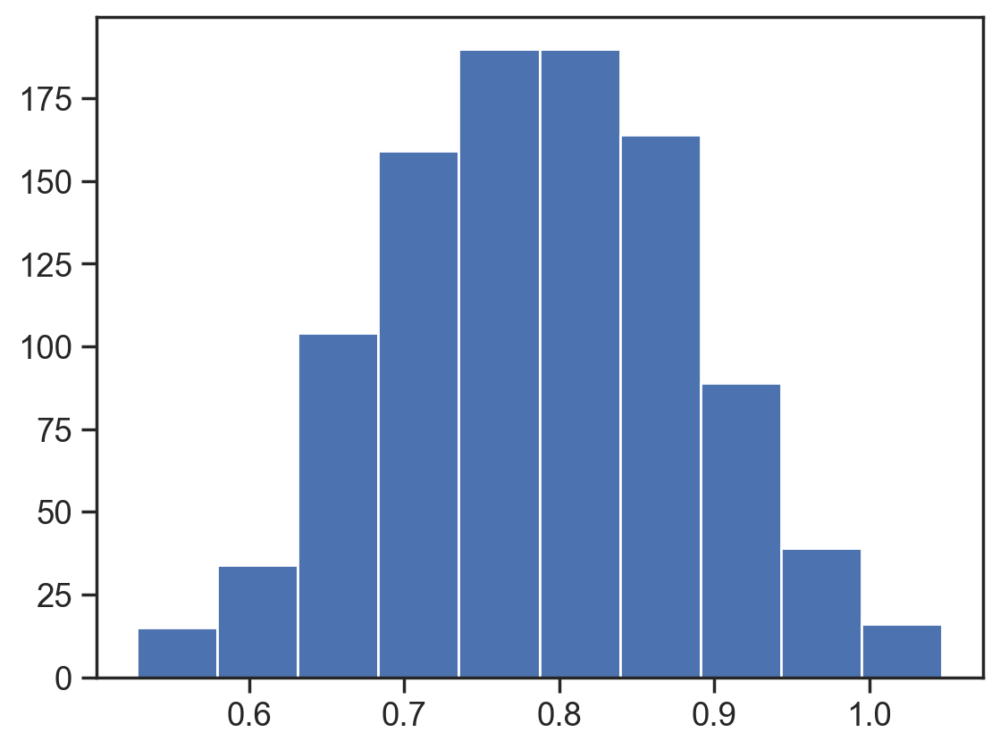

In [6460]:
a=[]
beta_noise = 0.1
for i in range(1000):
    a.append(np.max(np.min((np.pi/3, beta+beta_noise*np.random.randn(1)[0])), 0))

plt.hist(a)

In [39]:
def calc_weight_mat(cell_position_diffs, n_y, n_x, alpha, beta, velocity, I, sigma, T):
    # eventually will use W as W^{T}A
    N = n_y * n_x
    exp_arg = np.zeros((N, N))

    R_beta = calc_rot_mat(beta)

    modulation_vec = alpha * R_beta @ velocity
    
    modulation_mat = np.zeros((2, N, N))
    modulation_mat[0,:,:] = modulation_vec[0]
    modulation_mat[1,:,:] = modulation_vec[1]
    
    cell_position_diffs_with_mod = cell_position_diffs + modulation_mat

    modded_mat = cell_position_diffs_with_mod.reshape(2, -1)
    exp_arg = calc_tri_dist_squared(modded_mat).reshape(N, N)
    
    exp_arg = -1*(exp_arg / np.power(sigma, 2))
    
    W = I * np.exp(exp_arg) - T
    return W, exp_arg

In [40]:
# Non-negativity function
def nonnegative(x):
    nonneg_x = x.clip(min=0)
    # nonneg_x = x.clip(min=0, max=10)
    return nonneg_x

def initialize_network(n_y, n_x, seed):
    np.random.seed(seed)
    N = n_y * n_x

    init_state = np.zeros((n_y, n_x))
    idx1=np.max([2, n_y//3])
    idx2=np.max([2, n_x//3])
    
    init_state[:idx1, :idx2]=1

    return init_state

In [41]:
def update_function(A_t, W_t, A_l_t, W_l_t, tau, mean_val):
    # B_t1 = A_t + W_t.T @ A_t + A_l_t @ W_l_t @ A_t # ORIGINAL
    # weight_noise_mat = weight_noise*mean_val*rng.standard_normal(size=(A_t.shape[0],))
    
    # B_t1 = A_t + W_t.T @ A_t + W_l_t.T @ A_l_t + weight_noise

    B_t1 = A_t + W_t.T @ A_t + W_l_t.T @ A_l_t

    A_t1 = B_t1 + tau * B_t1 * (1 / mean_val - 1)
    A_t1 = nonnegative(A_t1)
    return A_t1, B_t1

In [6978]:
W_l = all_W_ls[0,3,0,:,:]
A_l = all_A_ls[0,3,0,:]
print(W_l.T.shape, A_l.shape)

(90, 4) (4,)


In [6972]:
all_W_ls.shape

(3, 4, 1000, 4, 90)

In [6974]:
all_A_ls.shape

(3, 4, 1000, 4)

In [6980]:
n_y = 9
n_x = 10

N = n_y*n_x
cell_positions_temp = calc_cell_positions(n_y, n_x)
cell_position_diffs_temp = calc_cell_position_diffs(cell_positions_temp)

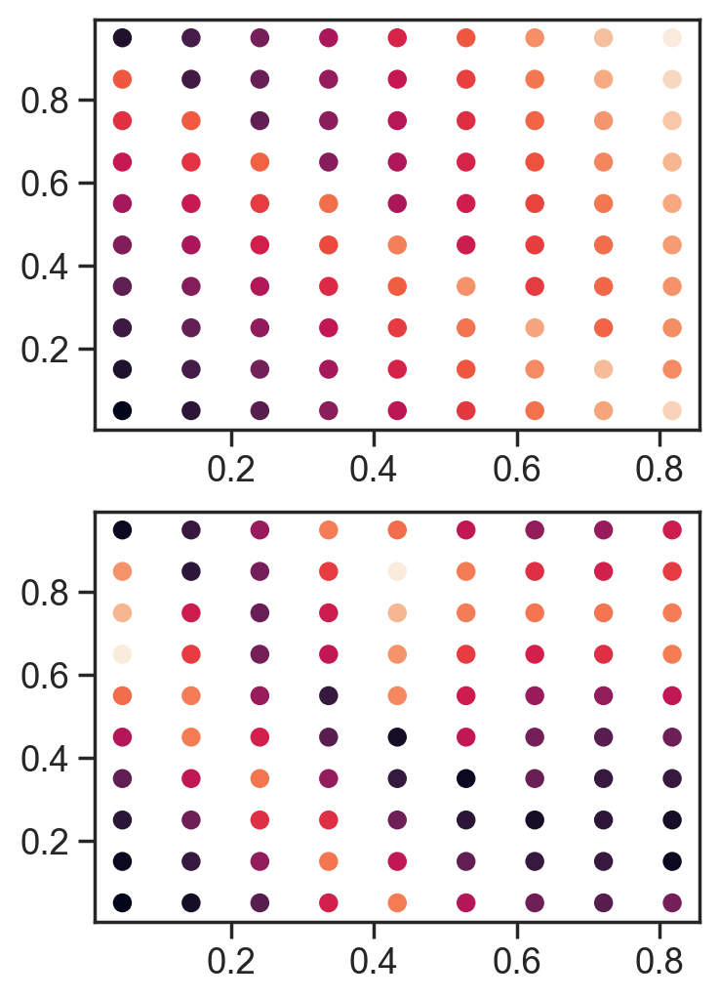

In [5132]:
this_cell = 0

this_cell_dist_from_all = cell_position_diffs_temp[:, this_cell, :]
euc_dist = np.linalg.norm(this_cell_dist_from_all, axis=0)
this_cell_dist_from_all = calc_tri_dist_squared(this_cell_dist_from_all)

plt.figure(figsize=(4,6))
plt.subplot(2,1,1)
plt.scatter(cell_positions_temp.reshape(2, -1)[0], 
            cell_positions_temp.reshape(2, -1)[1],
            c= euc_dist)

plt.subplot(2,1,2)
plt.scatter(cell_positions_temp.reshape(2, -1)[0], 
            cell_positions_temp.reshape(2, -1)[1],
            c= this_cell_dist_from_all)

In [5134]:
n_sigma_vals = 10
sigmas = np.linspace(0.2, 0.3, n_sigma_vals)

n_T_vals = 10
Ts = np.linspace(0.01, 0.1, n_T_vals)

beta = 0
velocity = np.zeros((n_timebins, 2))
v = velocity[0, :]

Ws_all = np.zeros((n_sigma_vals, n_T_vals, N, N))
exp_args_all = np.zeros((n_sigma_vals, n_T_vals, N, N))

for s in range(n_sigma_vals):
    sigma = sigmas[s]
    
    for t in range(n_T_vals):
        T = Ts[t]
        
        W_temp, exp_arg_temp, _ = calc_weight_mat(cell_position_diffs_temp, n_y, n_x, alpha, beta, v, I, sigma, T, 0)
        # Ws_all[s, t, :] = W_temp[:, int(n_x*n_y//2+n_y//2)]
        Ws_all[s, t, :, :] = W_temp
        exp_args_all[s, t, :, :] = exp_arg_temp

ValueError: too many values to unpack (expected 2)

NameError: name 'n' is not defined

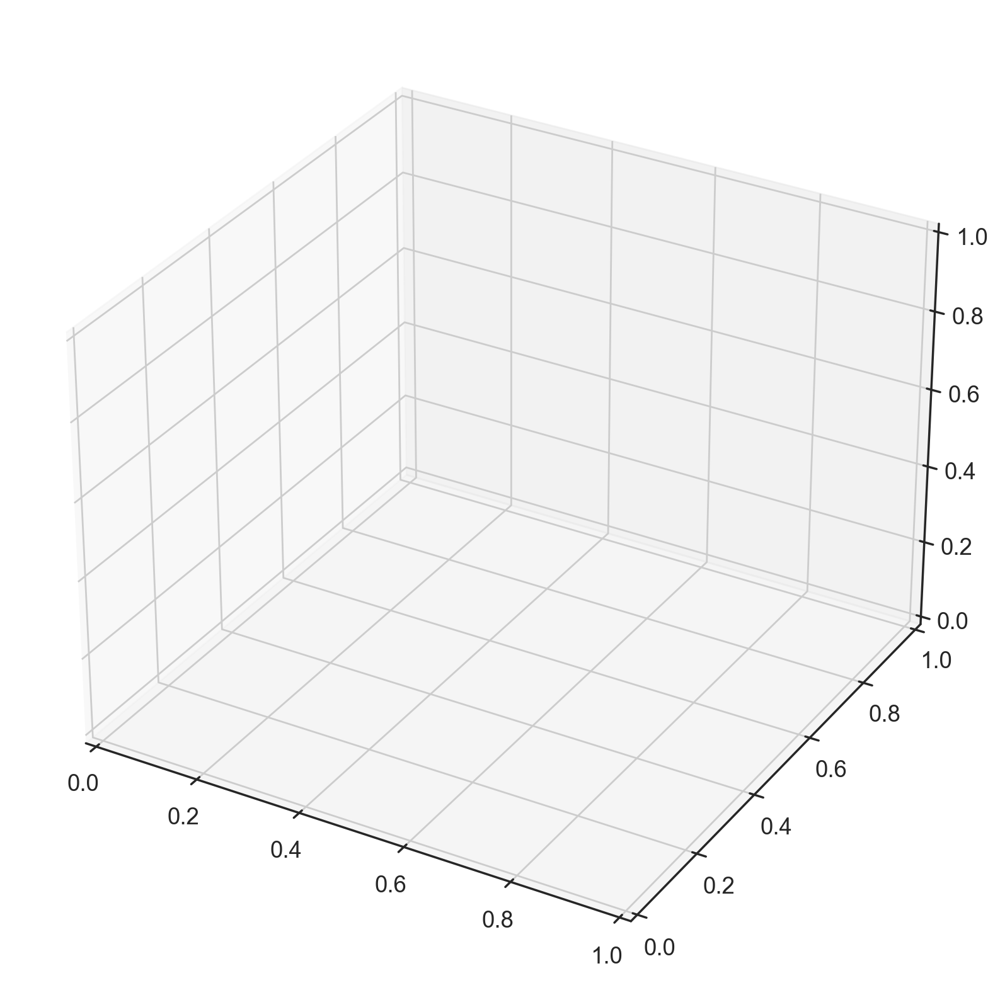

In [854]:
# n = U.shape[0]

# Create a figure and an axes object.
fig = plt.figure(figsize=(10,10))
ax = fig.add_subplot(111, projection='3d')

# Define parameters
R = 2  # Major radius
r = 1 # Minor radius
# n = 100  # Number of points
twists = 0  # Number of twists

# Generate parameter values
u = np.linspace(0, 2 * np.pi, n)
v = np.linspace(0, 2 * np.pi, n)
u, v = np.meshgrid(u, v)

# Calculate coordinates
x = (R + r * np.cos(v)) * np.cos(u)
y = (R + r * np.cos(v)) * np.sin(u)
z = r * np.sin(v) + twists * u / (2 * np.pi)

# Plot the torus.

# this_cell = 0
# this_cell_dist_from_all = cell_position_diffs[:, this_cell, :]
# this_cell_tri_dist = calc_tri_dist_squared(this_cell_dist_from_all)
# sort_idxs = np.argsort(this_cell_tri_dist)
Z=Zs[0]
ax.plot_surface(x, y, z, rstride=5, cstride=5, facecolors = cm.turbo_r(Z.reshape(n, n)),linewidth=0, antialiased=False)
# ax.plot_surface(x, y, z, rstride=1, cstride=1, facecolors = cm.turbo_r(A[0,:].reshape(9, 10)),linewidth=0, antialiased=False)

# Set the title and labels.
# ax.set_title('Torus')


ax.view_init(90, 0, 0)
ax.set_zlim(-2, 2)
ax.set_xlim(-2*np.pi,2*np.pi)
ax.set_ylim(-2*np.pi,2*np.pi)
        

In [10030]:
np.max(z)

0.9999829508016124

In [10032]:
pil_use = True
save_fig = True
save_dir = 'D:/Code/bump_video/sim/torus2/'
if not os.path.isdir(save_dir):
    os.makedirs(save_dir, exist_ok=True)
            

dpi_val=50
if pil_use:
    mpl.rcParams['figure.dpi'] = dpi_val

try:
    plt.close('all')
    if save_fig:
        matplotlib.use('agg')
    else:
        %matplotlib inline
    
    pid = 0
    for i in range(180):
        
        fig = plt.figure(figsize=(6,6))
        ax = fig.add_subplot(111, projection='3d')

        # Create the 3D plot
        # ax.plot_surface(x, y, z, rstride=5, cstride=5,facecolors=cm.turbo_r(Z.reshape(n, n)),linewidth=0, antialiased=False)

        if (i < 180):
            ax.view_init(90-2*i,0,0)
            ax.plot_surface(x, y, z, rstride=10, cstride=10, facecolors = cm.turbo(Zs[0].reshape(n, n)),linewidth=0, antialiased=False)

        # else:
        #     ax.view_init(87+180,2*i,0)

        ax.grid(False)
        # Hide axes ticks
        ax.set_xticks([])
        ax.set_yticks([])
        ax.set_zticks([])
        plt.axis('off')
        ax.set_zlim(-1.05*r, 1.05*r)
        ax.set_xlim(-1*np.pi,1*np.pi)
        ax.set_ylim(-1*np.pi,1*np.pi)
        
        if save_fig:
            if pil_use:
                img = fig2img(fig)
                img.save(os.path.join(save_dir,f'{pid:04d}.png'), quality=dpi_val)

                if ((i==0) or (i==179)):
                    for j in range(30):
                        pid+=1
                        img.save(os.path.join(save_dir,f'{pid:04d}.png'), quality=dpi_val)
                        
                plt.close(fig)
            else:
                plt.savefig(os.path.join(save_dir,f'{pid:04d}.jpg'), dpi=dpi_val)
                # fig.savefig(os.path.join(save_dir,f'{pid:03d}.png'), dpi=dpi_val)
                plt.close(fig)
            if not (i==0) and not (i==179):
                pid += 1
                
        
    for i in range(4800):
        
        fig = plt.figure(figsize=(10,10))
        ax = fig.add_subplot(111, projection='3d')

        
        # Create the 3D plot
        ax.plot_surface(x, y, z, rstride=10, cstride=10, facecolors = cm.turbo(Zs[i].reshape(n, n)),linewidth=0, antialiased=False)

        ax.view_init(90,0,0)

        if ((i > 0)):
            ax.view_init(90-(i-0),(i-0),(i-0))

        ax.grid(False)
        # Hide axes ticks
        ax.set_xticks([])
        ax.set_yticks([])
        ax.set_zticks([])
        plt.axis('off')

        ax.set_zlim(-1.05*r, 1.05*r)
        ax.set_xlim(-1*np.pi,1*np.pi)
        ax.set_ylim(-1*np.pi,1*np.pi)


        if save_fig:
            if pil_use:
                img = fig2img(fig)
                img.save(os.path.join(save_dir,f'{pid:04d}.png'), quality=dpi_val)
                plt.close(fig)
            else:
                plt.savefig(os.path.join(save_dir,f'{pid:04d}.jpg'), dpi=dpi_val)
                # fig.savefig(os.path.join(save_dir,f'{pid:03d}.png'), dpi=dpi_val)
                plt.close(fig)
                
            pid += 1
            if np.mod(i, 320)==0:
                print(f'{i}')

except KeyboardInterrupt:
    print("\nProgram terminated by user.")
    plt.close('all')
    %matplotlib inline     
    mpl.rcParams['figure.dpi'] = 100

finally:
    print("\nProgram finished.")
    plt.close('all')
    %matplotlib inline       
    mpl.rcParams['figure.dpi'] = 100
# 

0
320
640
960

Program finished.


IndexError: list index out of range

In [10042]:
vr_maps.shape

(90, 17920)

In [9833]:
# Define the parametric equations for the Klein bottle
def klein(u, v):
    # # original
    # x = (2 + np.cos(u/2) * np.sin(v) - np.sin(u/2) * np.sin(2*v)) * np.cos(u)
    # y = (2 + np.cos(u/2) * np.sin(v) - np.sin(u/2) * np.sin(2*v)) * np.sin(u)

    x = (5 + np.cos(u/2) * np.sin(v) - np.sin(u/2) * np.sin(2*v)) * np.cos(u)
    y = (5 + np.cos(u/2) * np.sin(v) - np.sin(u/2) * np.sin(2*v)) * np.sin(u)
    z = np.sin(u/2) * np.sin(v) + np.cos(u/2) * np.sin(2*v)
    return x, y, z

#https://virtualmathmuseum.org/Surface/klein_bottle/klein_bottle.html

In [10245]:
x.shape

(10, 9)

In [10246]:
X.shape

(27, 30)

In [1961]:
# SOMETHING NOT RIGHT HERE
def upscale_grid_data(resx,resy,scale_res,data,smooth_sigma):

    x,y=np.mgrid[:resx,:resy]/(resy)
    # u,v = coord_from_phase(x+1,y+1)

    # im = data.reshape(resx, resy)
    
    # im_copies = np.tile(im, (3,3))
    # im_copies[:resx, :] = np.flipud(im_copies[:resx, :])
    # im_copies[2*resx:3*resx:, :] = np.fliplr(im_copies[2*resx:3*resx , :])
   
    # if smooth_sigma > 0:
    #     im_copies = gaussian_filter(im_copies, smooth_sigma)

    # data = im_copies[resx:2*resx, resy:2*resy].reshape(-1)
    
    X = np.linspace(np.min(x), np.max(x), resx*scale_res)
    Y = np.linspace(np.min(y), np.max(y), resy*scale_res)
    X, Y = np.meshgrid(X, Y)  # 2D grid for interpolation

    # X,Y=np.mgrid[:resx*scale_res,:resy*scale_res-1]/(resy*scale_res)

    
    U, V = coord_from_phase(X+1, Y+1)
    # points = np.vstack((x.reshape(-1), y.reshape(-1))).T
    # xi =  np.vstack((X.reshape(-1), Y.reshape(-1))).T

    points = np.vstack((u.reshape(-1), v.reshape(-1))).T
    xi =  np.vstack((U.reshape(-1), V.reshape(-1))).T

    Z=griddata(points, data, xi, method='cubic')

    return Z, U, V, u, v

In [1963]:
# gridsort = get_2d_sort(phases_all[phase1_use][:resx*resy],phases_all[phase2_use][:resx*resy],resx,resy)
# new_A = vr_maps[gridsort, :].T
resx=10
resy=9
x,y=np.mgrid[:resx,:resy]/resy


scale_res=3
smooth_sigma=2
Zs=[]
for i in range(1000): #A.shape[0]): #new_A.shape[0]):
    data=A[i]
    Z, U,V, u, v=upscale_grid_data(resx,resy,scale_res,data,smooth_sigma)
    Zs.append(Z)

In [10281]:
np.max(u) - np.max(U)

0.0

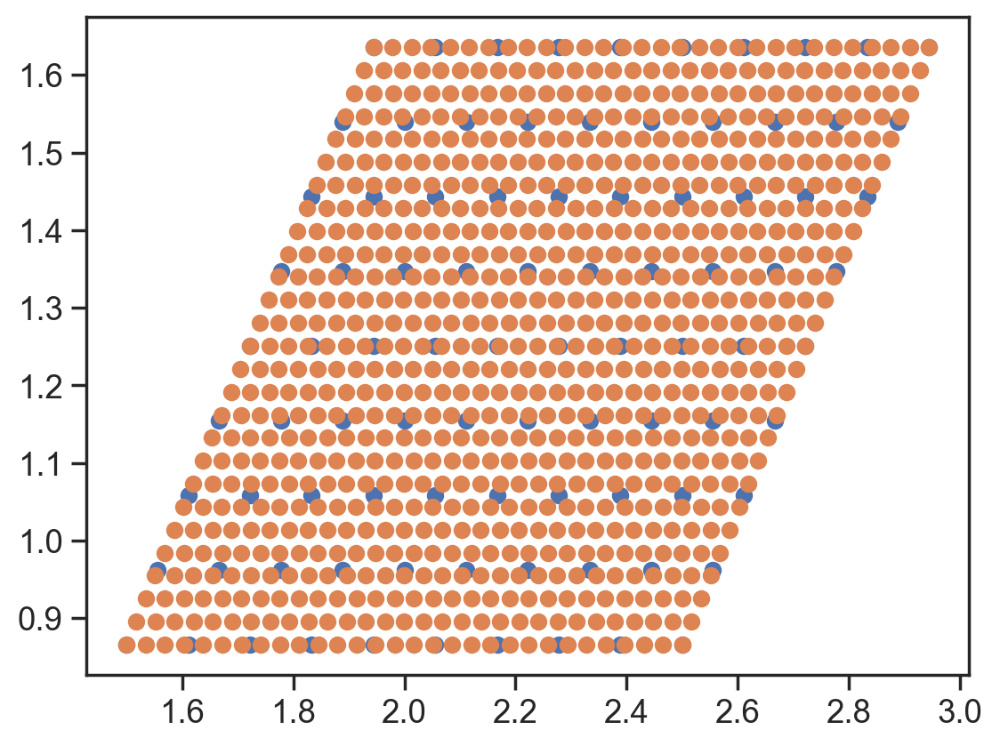

In [10284]:
plt.scatter(u,v)
plt.scatter(U,V)

In [ ]:
im_copies[resx

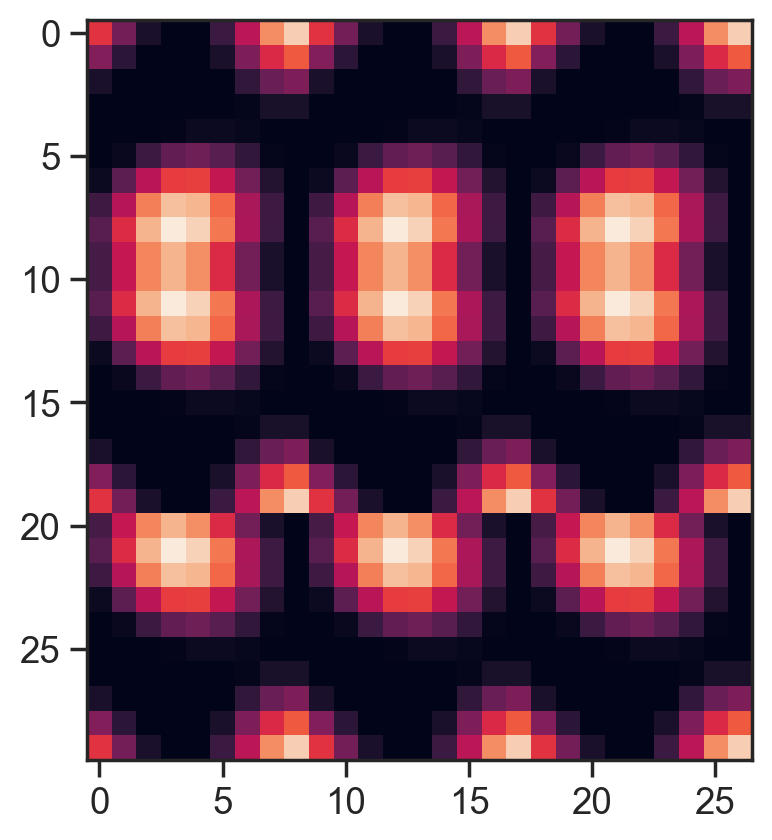

In [10288]:
im = data.reshape(resx, resy)

im_copies = np.tile(im, (3,3))
im_copies[:resx, :] = np.flipud(im_copies[:resx, :])
# im_copies[2*resx:3*resx:, :] = np.fliplr(im_copies[2*resx:3*resx , :])

plt.imshow(im_copies)

# if smooth_sigma > 0:
#     im_copies = gaussian_filter(im_copies, smooth_sigma)

# data = im_copies[resx:2*resx, resy:2*resy].reshape(-1)

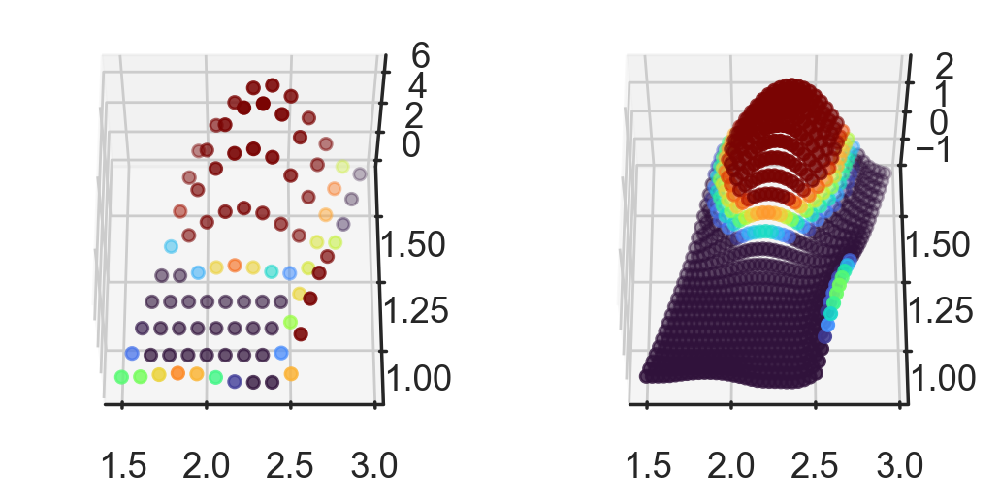

In [10283]:
fig=plt.figure()
ax=fig.add_subplot(121, projection='3d')
i=85

ax.scatter(u.reshape(-1),v.reshape(-1),A[i], c=cm.turbo(A[i]))
ax.view_init(60, -90, 0)

ax=fig.add_subplot(122, projection='3d')
ax.scatter(U.reshape(-1),V.reshape(-1),zscore(Zs[i]), c=cm.turbo(zscore(Zs[i])))
ax.view_init(60, -90, 0)

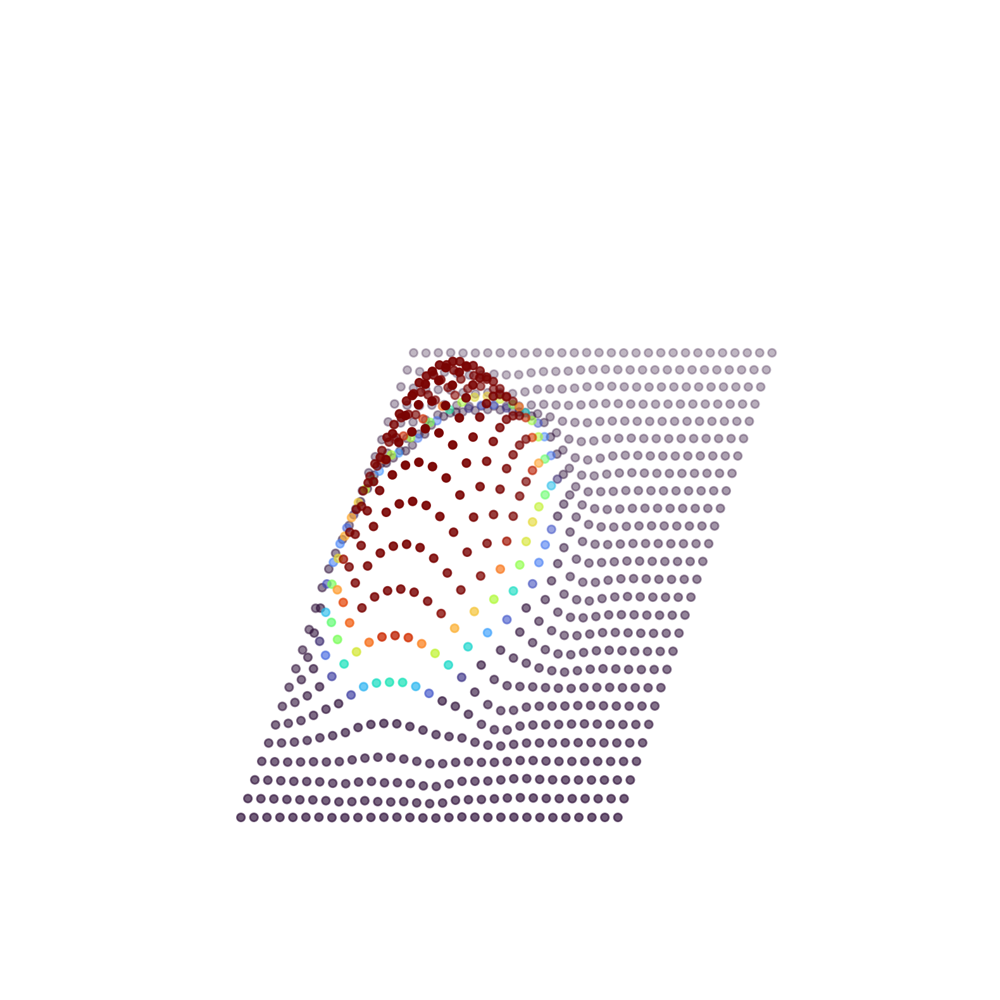

In [1973]:
fig=plt.figure(figsize=(10,10))
i=70

ax=fig.add_subplot(111, projection='3d')
ax.scatter(U.reshape(-1),V.reshape(-1),zscore(Zs[i]), c=cm.turbo(zscore(Zs[i])))
ax.view_init(60, -90, 0)
plt.axis('off')
plt.savefig('3d_bump.png', dpi=300)

In [10250]:
print(u.shape, U.shape)

(10, 9) (30, 27)


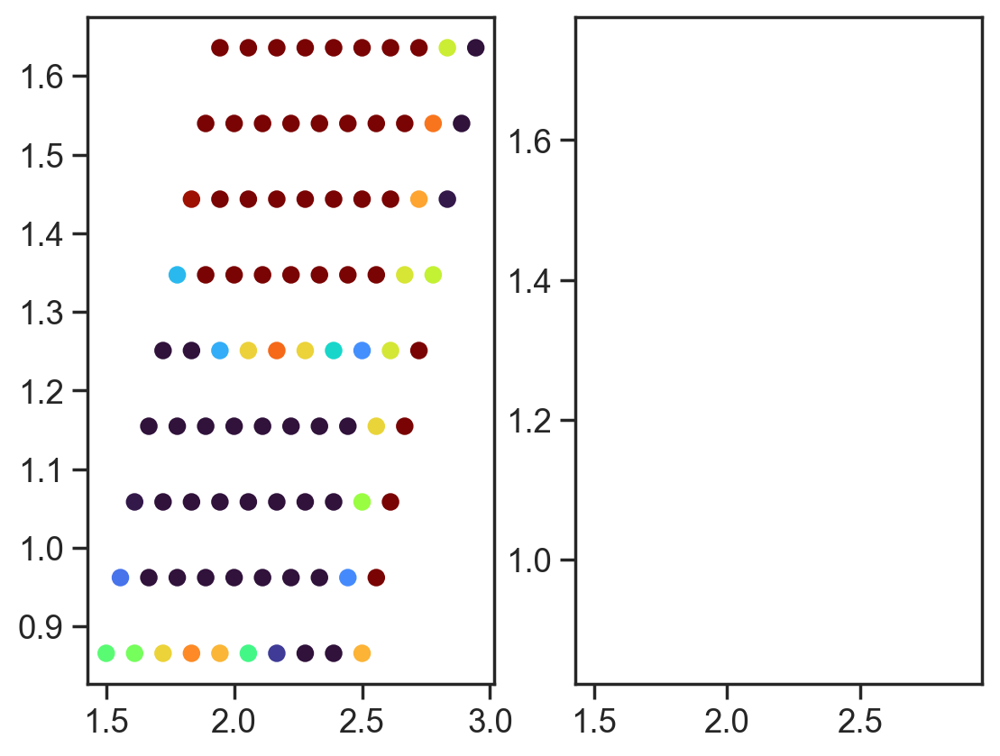

In [10249]:
fig=plt.figure()
ax=fig.add_subplot(121)
i=85

ax.scatter(u.reshape(-1),v.reshape(-1), c=cm.turbo(A[i]))

ax=fig.add_subplot(122)
ax.scatter(U.reshape(-1),V.reshape(-1),c=cm.turbo(zscore(Zs[i])))


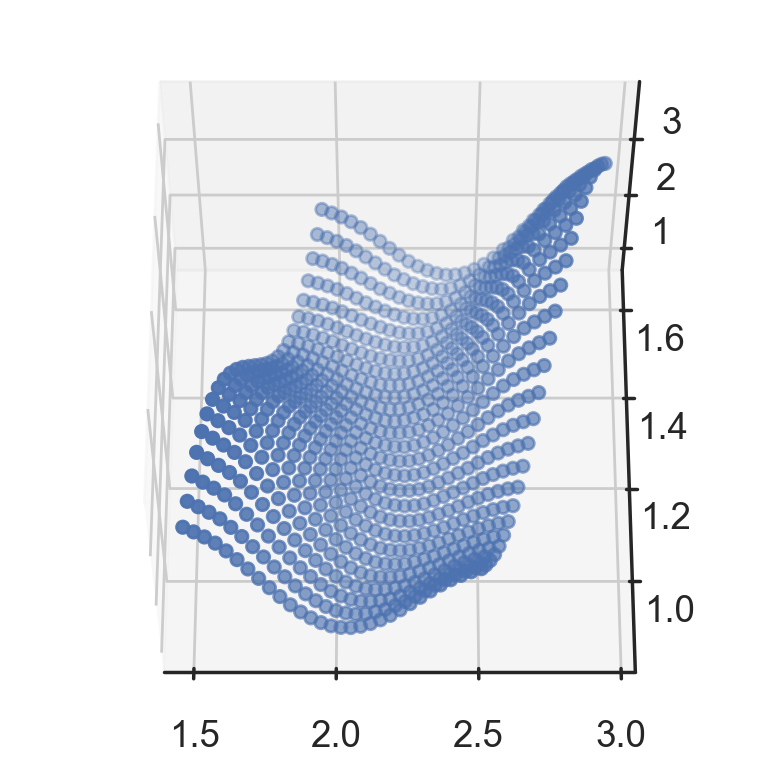

In [10213]:
fig=plt.figure()
ax=fig.add_subplot(111, projection='3d')

ax.scatter(U.reshape(-1),V.reshape(-1),Zs[0])
ax.view_init(60, -90, 0)

In [10034]:
# x,y=np.mgrid[:resx,:resy]/resy
# scale_res=3
# Zs=[]
# for i in range(A.shape[0]):
#     data=A[i]
#     Z,U,V,u,v=upscale_grid_data(x,y,scale_res,data)
#     Zs.append(Z)

In [10102]:
V.shape

(270, 270)

In [10094]:
n1=U.shape[0]
n2=U.shape[0]

# Generate the data points
u = np.linspace(0, 2 * np.pi, n)
# v = np.linspace(0, np.pi, n)
v = np.linspace(0, 2*np.pi, n) 

u_twisted_torus, v_twisted_torus = np.meshgrid(u, v)
x_twisted_torus, y_twisted_torus, z_twisted_torus = klein(u, v)

In [10095]:
pickle_bool = True

if pickle_bool:
    filename = 'D:/Code/bump_video/sim/twisted_torus2.pkl'
    
    data_dict = {"Zs":Zs,
                 "scale_res":scale_res,
                 "u_twisted_torus":u_twisted_torus,
                 "v_twisted_torus":v_twisted_torus,
                 "x_twisted_torus":x_twisted_torus,
                 "y_twisted_torus":y_twisted_torus,
                 "z_twisted_torus":z_twisted_torus,
                 "raw_maps":raw_maps,
                 "gridsort":gridsort,
                 "resx":resx,
                 "resy":resy,
                 "phases_all":phases_all,
                 "discs_smooth":discs_smooth,
                 "all_angles_smooth":all_angles_smooth,
                 "all_angles_smooth_norm":all_angles_smooth_norm,
                 "phase1_use":phase1_use,
                 "phase2_use":phase2_use,
                 "A":A, "B":B, "W":W,
                 "scaled_velocity":scaled_velocity,
                 "posx_lin":posx_lin, 
                 "posx":posx,
                 "velocity":velocity,
                 "block_timebin_starts":block_timebin_starts,
                 "l_pos_pb":l_pos_pb,
                 "trials_pb":trials_pb,
                 "n_timebins":n_timebins,
                 "init_state":init_state,
                 "cell_position_diffs":cell_position_diffs,
                 "n_y":n_y, "n_x":n_x, "alpha":alpha, "beta_base":beta_base, "I":I,
                 "sigma":sigma, "T":T, "tau":tau, "velocity_gain":velocity_gain,
                 "track_length":track_length, "l_str":l_str, "n_warmup_bins":n_warmup_bins
                 }
    
    
    with open(filename, 'wb') as file:
      pickle.dump(data_dict, file)
    
    # with open(filename, 'rb') as file:
    #   data = pickle.load(file)

## TO DO: MAKE TORUS PLOTS AND COMBINE INTO ANIMATION WITH THE SORTED GRIDSORT A

In [10097]:
pil_use = True
save_fig = True
save_dir = 'D:/Code/bump_video/sim/twisted_torus2/'
if not os.path.isdir(save_dir):
    os.makedirs(save_dir, exist_ok=True)
            

dpi_val=30
if pil_use:
    mpl.rcParams['figure.dpi'] = dpi_val

try:
    plt.close('all')
    if save_fig:
        matplotlib.use('agg')
    else:
        %matplotlib inline
    
    pid = 0
    for i in range(180):
        
        fig = plt.figure(figsize=(8,8))
        ax = fig.add_subplot(111, projection='3d')

        Z=Zs[4000-480]
        # Create the 3D plot
        ax.plot_surface(x, y, z, rstride=5, cstride=5,facecolors=cm.turbo(Z.reshape(n, n)),linewidth=0, antialiased=False)
        
        # ax.set_title("Klein Bottle")
        if (i < 180):
            ax.view_init(87-2*i,0,0)

        # else:
        #     ax.view_init(87+180,2*i,0)

        ax.grid(False)
        # Hide axes ticks
        ax.set_xticks([])
        ax.set_yticks([])
        ax.set_zticks([])
        plt.axis('off')
        ax.set_zlim(-1, 1)
        ax.set_xlim(-2*np.pi,2*np.pi)
        ax.set_ylim(-2*np.pi,2*np.pi)
        
        if save_fig:
            if pil_use:
                img = fig2img(fig)
                img.save(os.path.join(save_dir,f'{pid:04d}.png'), quality=dpi_val)

                if ((i==0) or (i==179)):
                    for j in range(30):
                        pid+=1
                        img.save(os.path.join(save_dir,f'{pid:04d}.png'), quality=dpi_val)
                        
                plt.close(fig)
            else:
                plt.savefig(os.path.join(save_dir,f'{pid:04d}.jpg'), dpi=dpi_val)
                # fig.savefig(os.path.join(save_dir,f'{pid:03d}.png'), dpi=dpi_val)
                plt.close(fig)
            if not (i==0) and not (i==179):
                pid += 1
                
            if np.mod(i, 320)==0:
                print(f'{i}')


        
    for i in range(960):
        
        fig = plt.figure(figsize=(10,10))
        ax = fig.add_subplot(111, projection='3d')

        Z=Zs[i+4000-480]
        # Create the 3D plot
        ax.plot_surface(x, y, z, rstride=5, cstride=5,facecolors=cm.turbo(Z.reshape(n, n)),linewidth=0, antialiased=False)
        
        # ax.set_title("Klein Bottle")
        ax.view_init(87,0,0)

        if ((i > 320)):
            ax.view_init(87-(i-320),0,0)

        ax.grid(False)
        # Hide axes ticks
        ax.set_xticks([])
        ax.set_yticks([])
        ax.set_zticks([])
        plt.axis('off')

        ax.set_zlim(-1, 1)
        ax.set_xlim(-2*np.pi,2*np.pi)
        ax.set_ylim(-2*np.pi,2*np.pi)


        if save_fig:
            if pil_use:
                img = fig2img(fig)
                img.save(os.path.join(save_dir,f'{pid:04d}.png'), quality=dpi_val)
                plt.close(fig)
            else:
                plt.savefig(os.path.join(save_dir,f'{pid:04d}.jpg'), dpi=dpi_val)
                # fig.savefig(os.path.join(save_dir,f'{pid:03d}.png'), dpi=dpi_val)
                plt.close(fig)
                
            pid += 1
            if np.mod(i, 320)==0:
                print(f'{i}')

except KeyboardInterrupt:
    print("\nProgram terminated by user.")
    plt.close('all')
    %matplotlib inline     
    mpl.rcParams['figure.dpi'] = 100

finally:
    print("\nProgram finished.")
    plt.close('all')
    %matplotlib inline       
    mpl.rcParams['figure.dpi'] = 100
# 

0
0
320
640

Program finished.


In [ ]:
# fig = plt.figure(figsize=(20,25))
# for i in range(20):
#     Z=Zs[i]
#     # Create the 3D plot
#     ax = fig.add_subplot(5,4,i+1, projection='3d')
#     ax.plot_surface(x, y, z, rstride=10, cstride=10,facecolors=cm.turbo_r(Z.reshape(n, n)),linewidth=0, antialiased=False)
    
#     # ax.set_title("Klein Bottle")
#     ax.view_init(90,0,0)
# # plt.show()

In [ ]:
# FIGURE OUT AXIS LIMITS AND SET TO BE THE SAME FOR ALL PLOTS

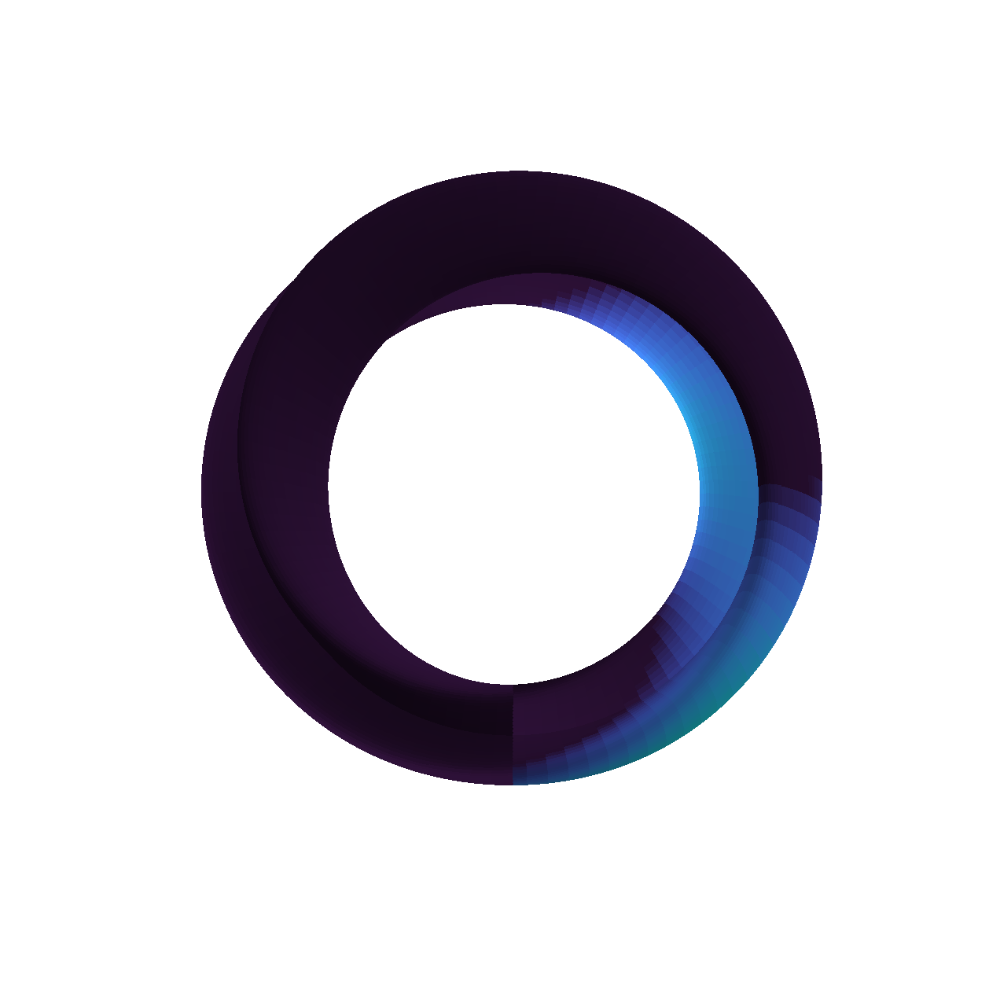

In [10098]:
fig = plt.figure(figsize=(8,8))
%matplotlib inline     

Z=Zs[i]
ax = fig.add_subplot(111,projection='3d')
# Create the 3D plot
ax.plot_surface(x, y, z, rstride=3, cstride=3,facecolors=cm.turbo_r(Z.reshape(n, n)),linewidth=0, antialiased=False)

# ax.set_title("Klein Bottle")
ax.view_init(87+180,180,0)
# # Hide axes ticks

# from mpl_toolkits.mplot3d import Axes3Dfrom Axes3D import set_zlim
ax.set_zlim(-1, 1)
ax.set_xlim(-2*np.pi,2*np.pi)
ax.set_ylim(-2*np.pi,2*np.pi)

ax.set_xticks([])
ax.set_yticks([])
ax.set_zticks([])
plt.axis('off')
plt.show()
ax.grid(False)


In [10100]:
Z.shape

(72900,)

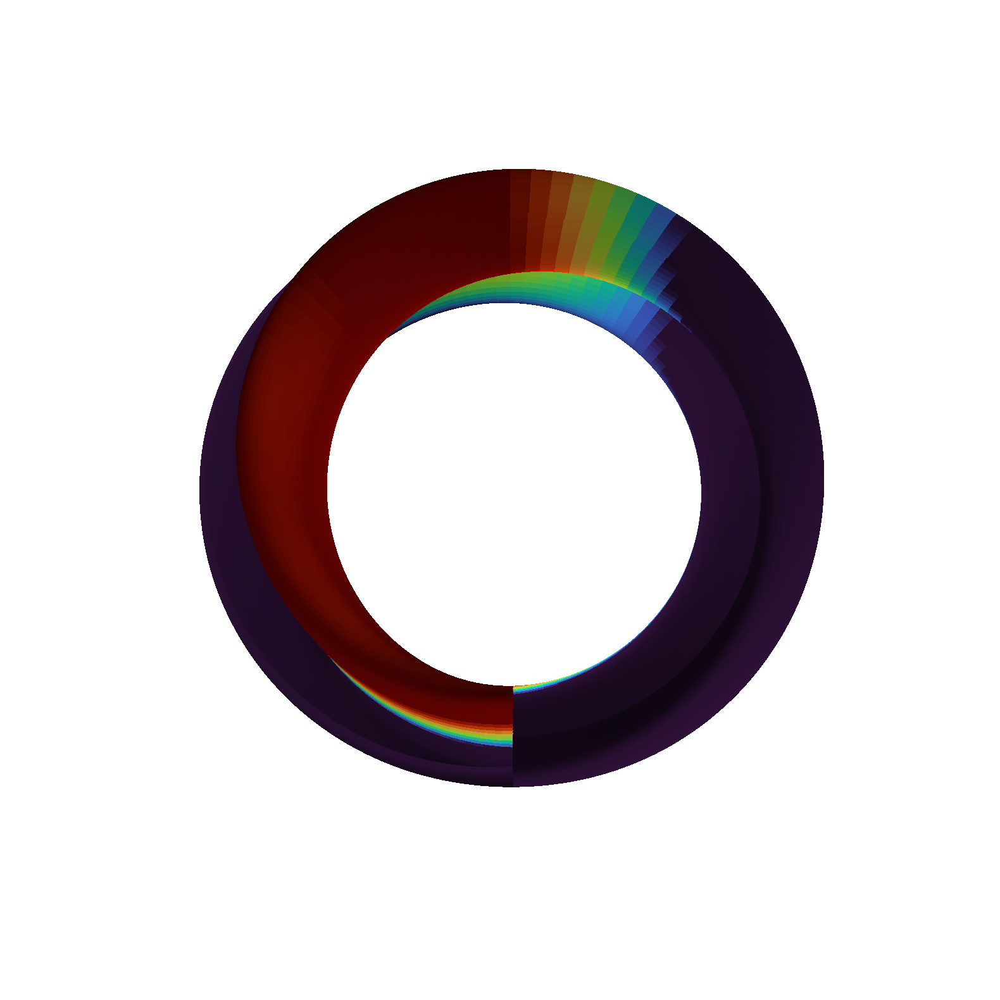

In [9878]:
fig = plt.figure(figsize=(10,10))
%matplotlib inline     

Z=Zs[i]
ax = fig.add_subplot(111,projection='3d')
# Create the 3D plot
ax.plot_surface(x, y, z, rstride=3, cstride=3,facecolors=cm.turbo_r(Z.reshape(n, n)),linewidth=0, antialiased=False)

# ax.set_title("Klein Bottle")
ax.view_init(87,0,0)
# # Hide axes ticks

# from mpl_toolkits.mplot3d import Axes3Dfrom Axes3D import set_zlim
ax.set_zlim(-1, 1)
ax.set_xlim(-2*np.pi,2*np.pi)
ax.set_ylim(-2*np.pi,2*np.pi)

ax.set_xticks([])
ax.set_yticks([])
ax.set_zticks([])
plt.axis('off')
plt.show()
ax.grid(False)


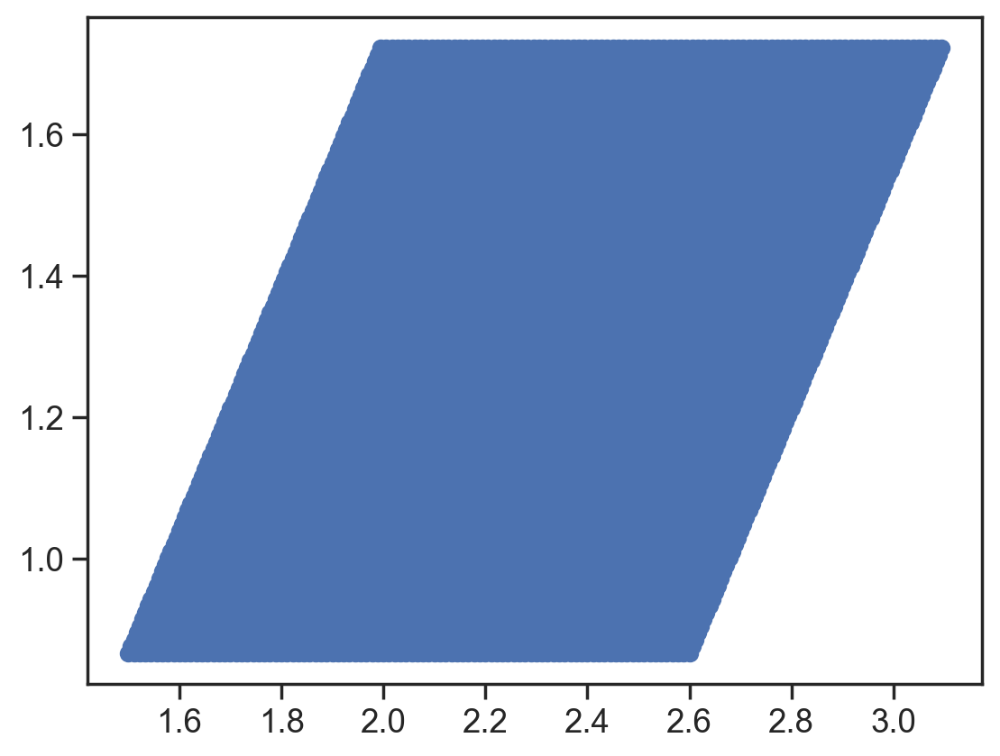

In [9556]:
plt.scatter(ubig.reshape(-1), vbig.reshape(-1))
# plt.scatter(u_sim.reshape(-1), v_sim.reshape(-1))

In [9458]:
b

0

In [5136]:
n_vels = 10

velocity = np.zeros((n_vels,2))
velocity[:,0] = np.sin(np.arange(n_vels)/(2*np.pi))
velocity[:,1] = np.sqrt(1 - np.power(velocity[:,0], 2))

n_betas = 10
betas = np.linspace(0, np.pi/3)

Ws_all = np.zeros((n_vels, n_betas, 90, 90))
exp_args_all = np.zeros((n_vels, n_betas, 90, 90))

alpha = 0.1
T=0.05
I=0.3
sigma=0.24

for v_idx in range(n_vels):
    v = velocity[v_idx,:]
    
    for b in range(n_betas):
        beta = betas[b]
        
        W_temp, exp_arg_temp, _ = calc_weight_mat(cell_position_diffs_temp, 9, 10, alpha, beta, v, I, sigma, T, 0)
        # Ws_all[s, t, :] = W_temp[:, int(n_x*n_y//2+n_y//2)]
        Ws_all[v_idx, b, :, :] = W_temp
        exp_args_all[v_idx, b, :, :] = exp_arg_temp

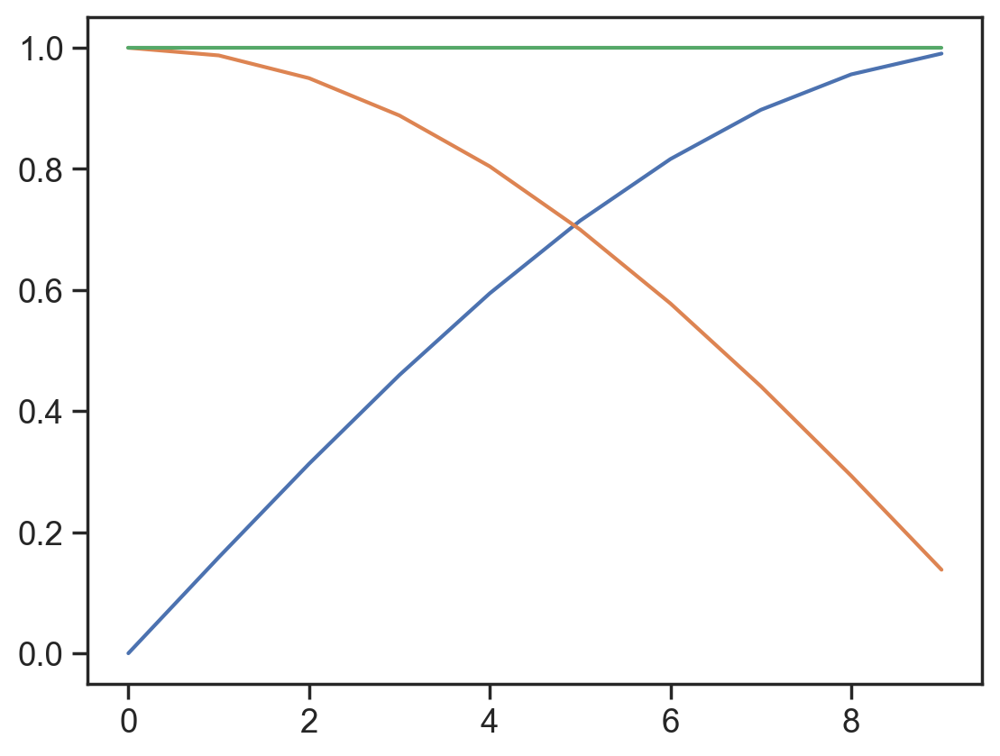

In [5137]:
plt.plot(velocity[:,0])
plt.plot(velocity[:,1])
plt.plot(np.linalg.norm(velocity, axis=1))

In [9826]:
# plt.figure(figsize=(20,20))
# for v_idx in range(n_vels):
    
#     for b in range(n_betas):
#         plt.subplot(n_vels, n_betas, b+1+n_betas*v_idx)        
#         plt.imshow(Ws_all[v_idx,b,:,:].sum(0).reshape(26,30))

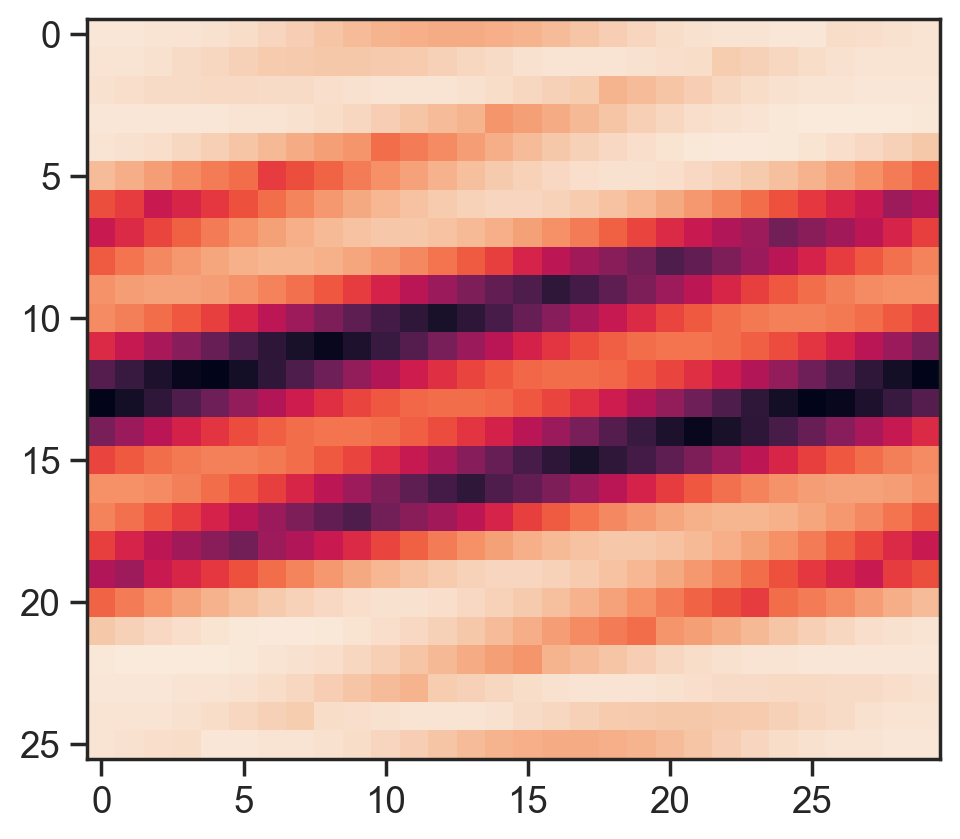

In [9452]:
plt.imshow(Ws_all[9,9,:,:].sum(0).reshape(26,30))

In [4170]:
sigmas

array([0.2       , 0.21111111, 0.22222222, 0.23333333, 0.24444444,
       0.25555556, 0.26666667, 0.27777778, 0.28888889, 0.3       ])

In [4171]:
Ts

array([0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09, 0.1 ])

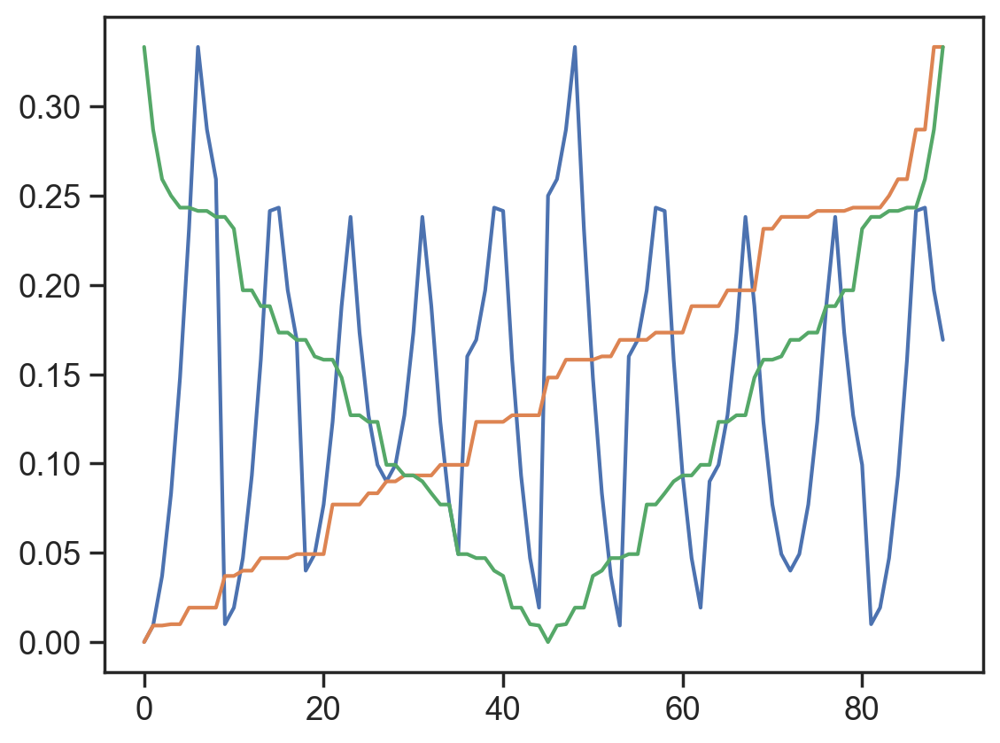

In [5140]:
this_cell = 0
this_cell_dist_from_all = cell_position_diffs_temp[:, this_cell, :]
# this_cell_euc_dist = np.linalg.norm(this_cell_dist_from_all, axis=0)
this_cell_tri_dist = calc_tri_dist_squared(this_cell_dist_from_all)

sort_idxs = np.argsort(this_cell_tri_dist)

plt.plot(this_cell_tri_dist)
plt.plot(this_cell_tri_dist[sort_idxs])

sort_idxs2=np.concatenate((sort_idxs[::-2], sort_idxs[::2]))
plt.plot(this_cell_tri_dist[sort_idxs2])

Text(0.5, 1.0, 'W sorted by W')

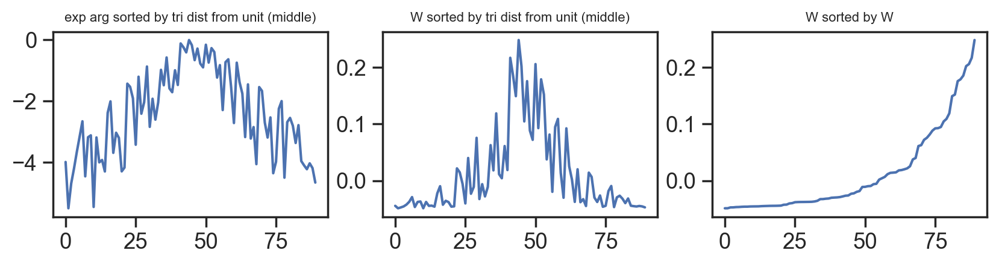

In [5141]:
plt.figure(figsize=(10,2))

plt.subplot(1,3,1)
plt.plot(exp_args_all[9,2,this_cell,sort_idxs2])
plt.title('exp arg sorted by tri dist from unit (middle)', fontsize=8)

plt.subplot(1,3,2)
plt.plot(Ws_all[9,2,this_cell,sort_idxs2])
plt.title('W sorted by tri dist from unit (middle)', fontsize=8)

plt.subplot(1,3,3)
plt.plot(np.sort(Ws_all[9,2,this_cell,:]))
plt.title('W sorted by W', fontsize=8)


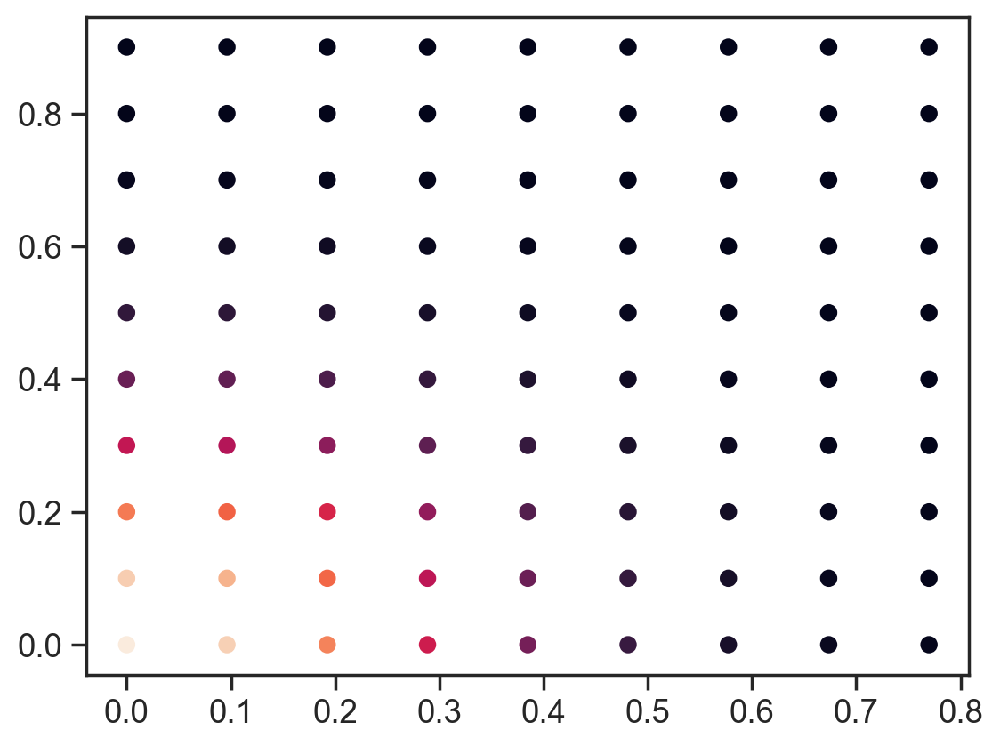

In [5167]:
euc_diff = np.exp(-np.power(np.linalg.norm(cell_position_diffs_temp[:, :, :], axis=0),2) /np.power(0.35, 2))
plot_weight_mat(cell_position_diffs_temp, 0, euc_diff, False)

In [5152]:
Ws_all[i,0,:,:].shape

(90, 90)

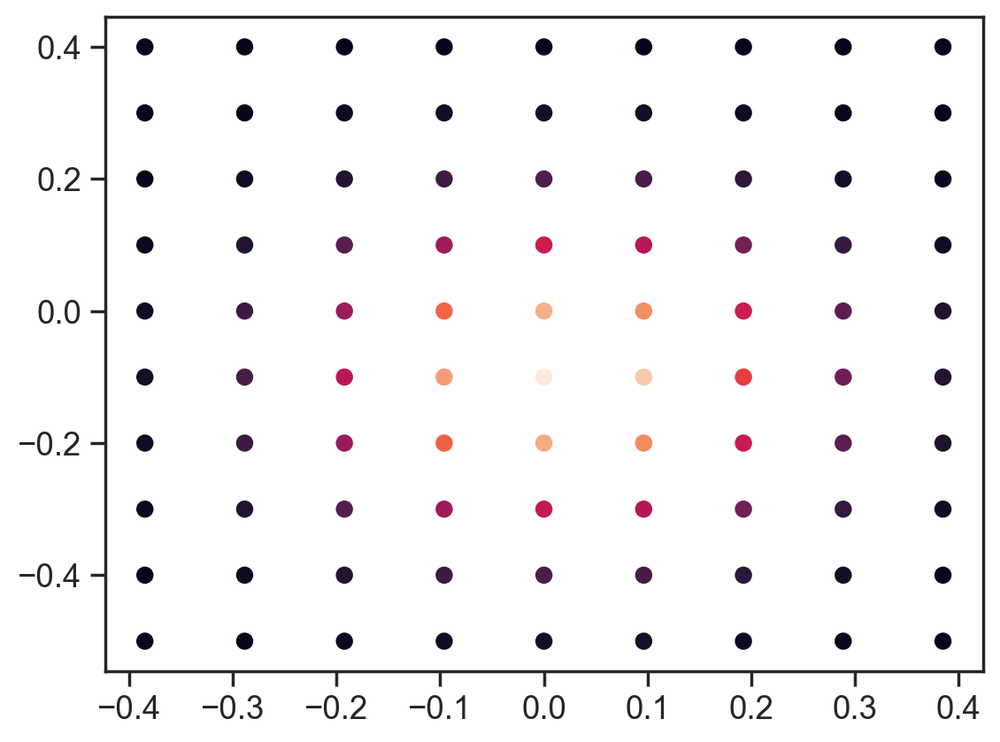

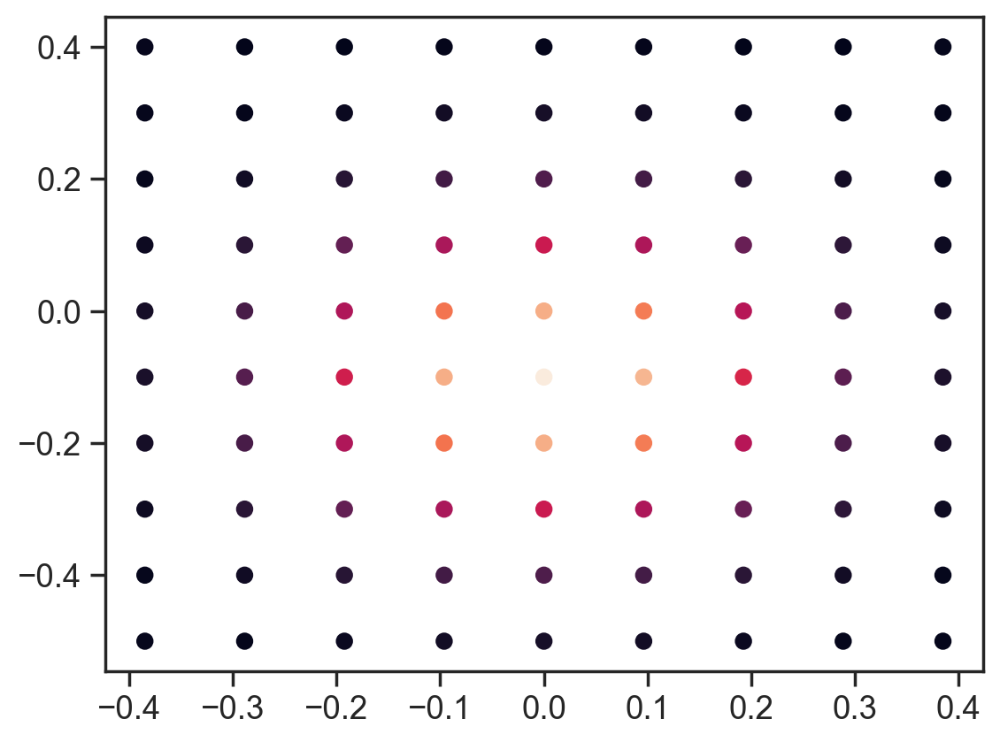

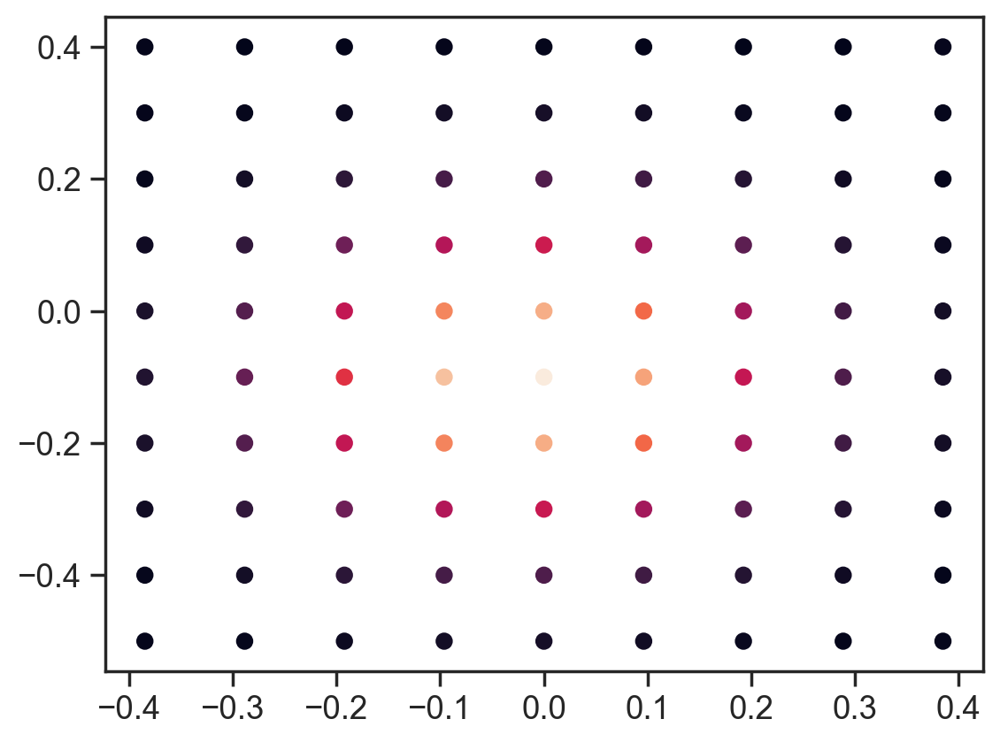

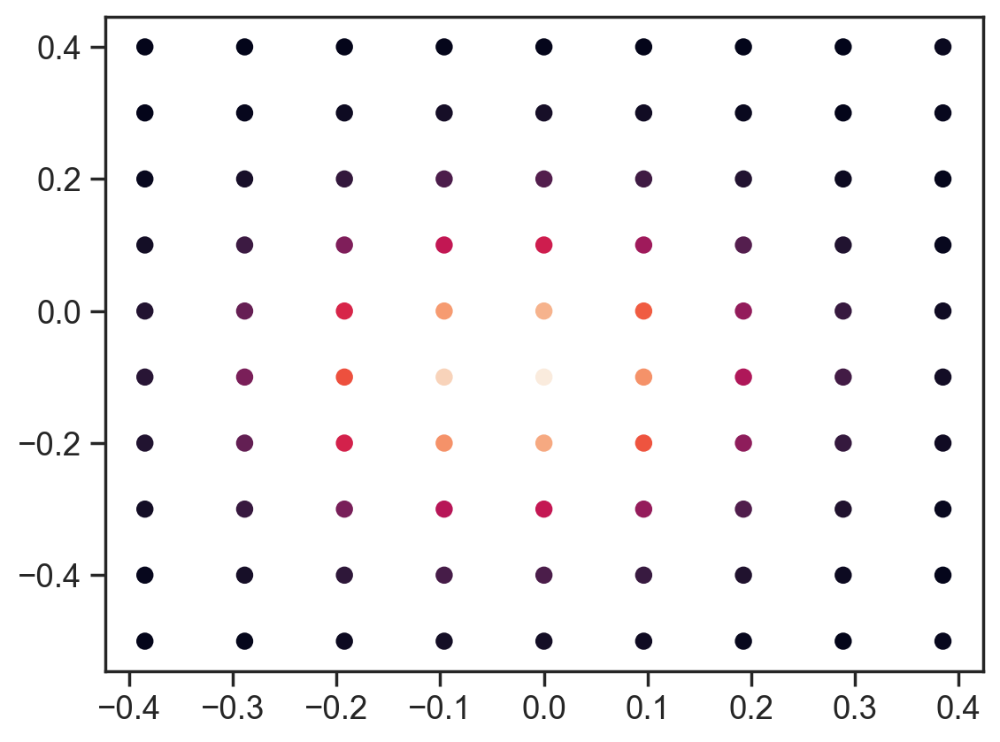

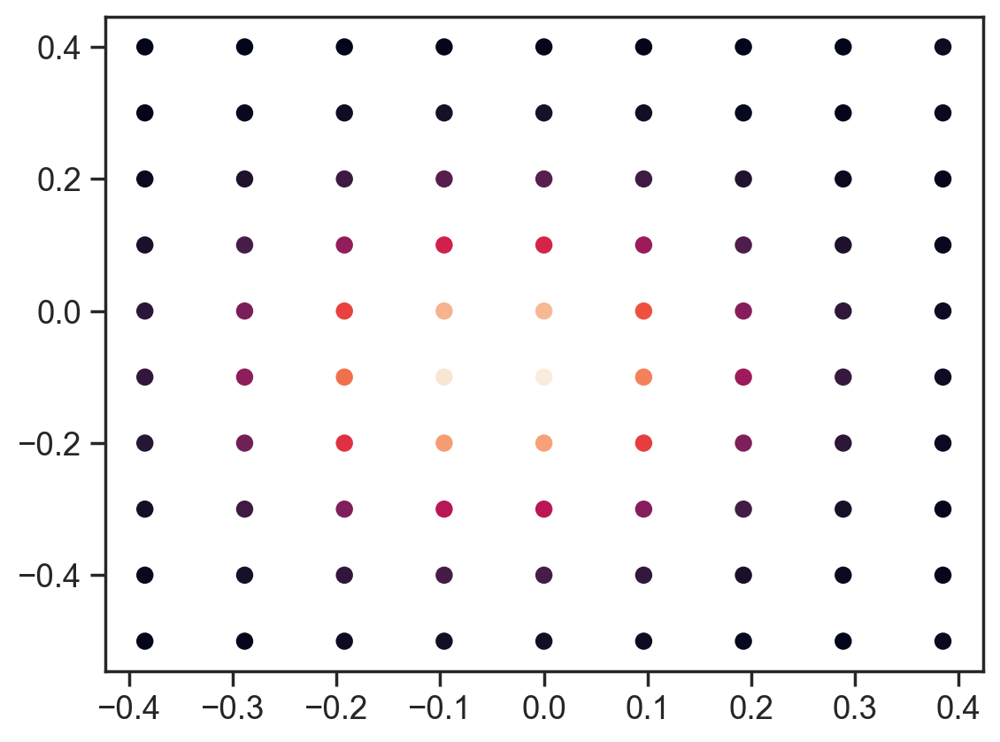

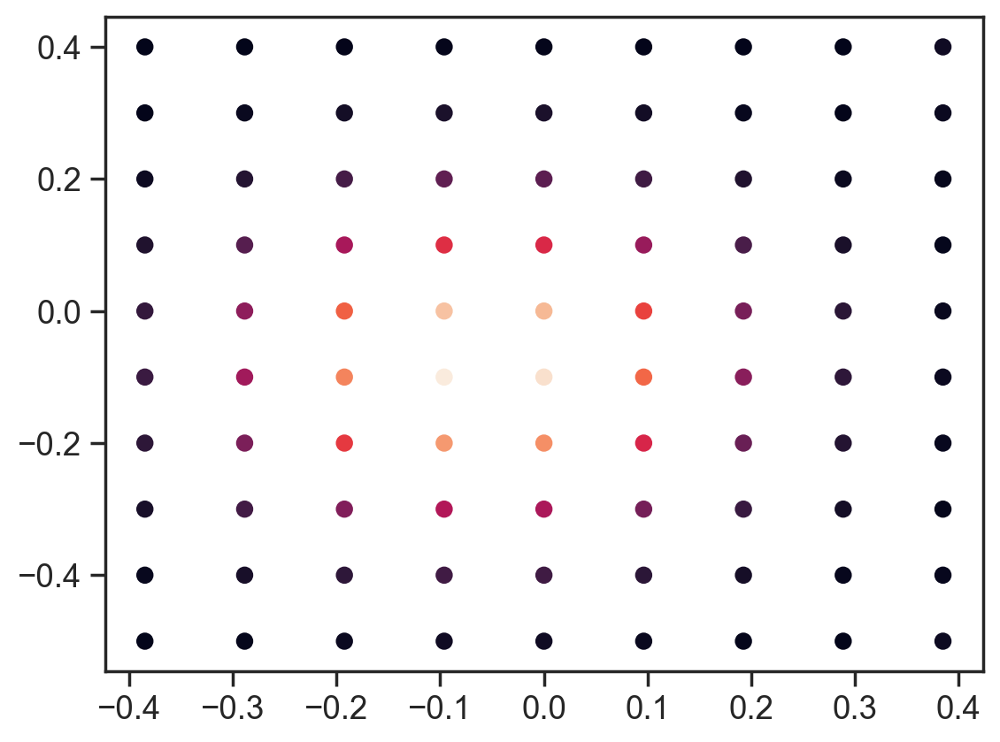

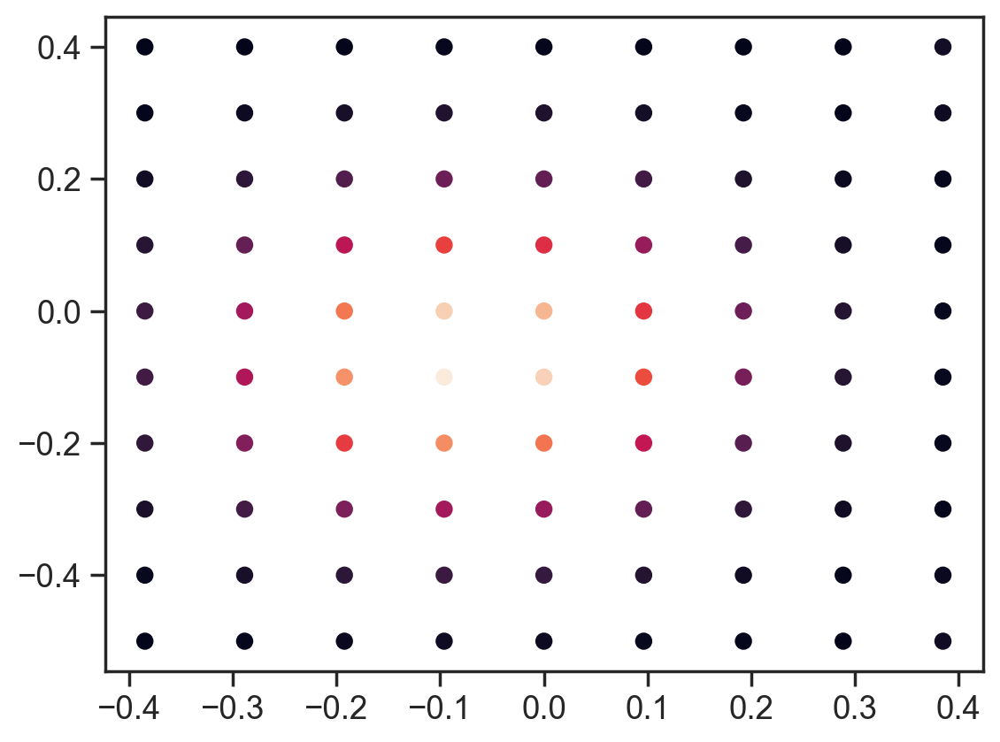

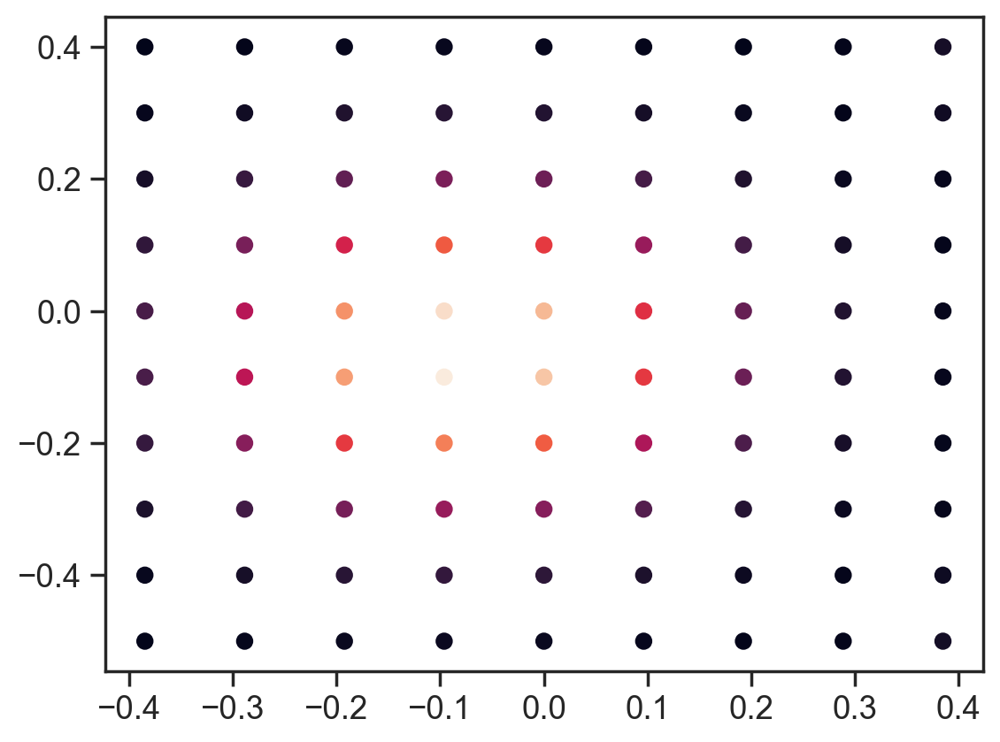

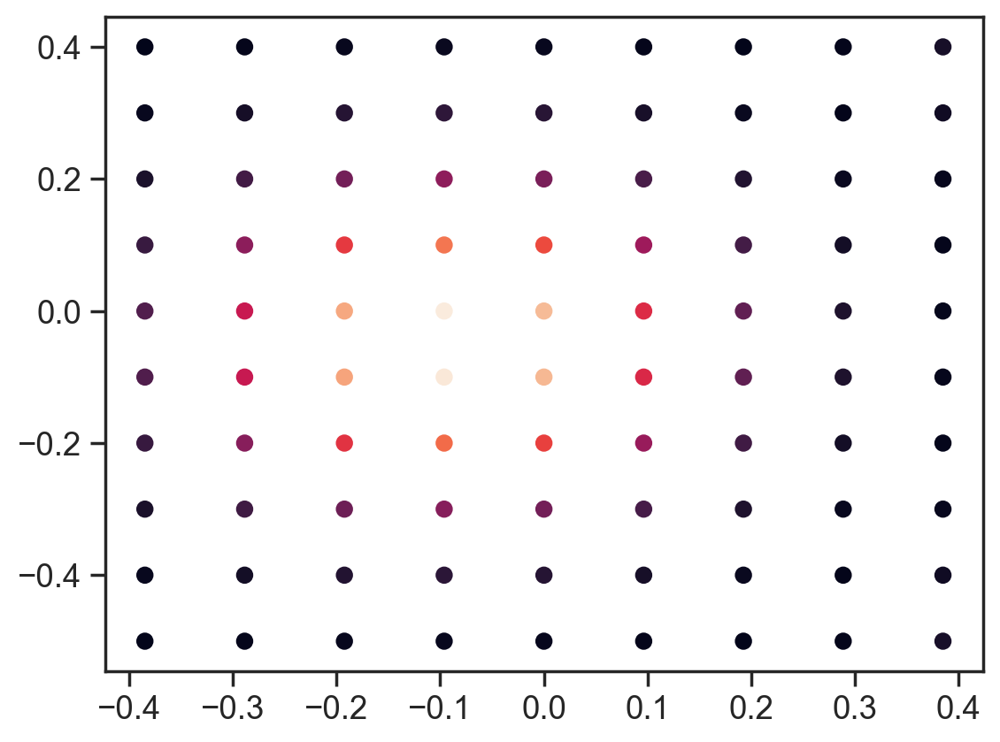

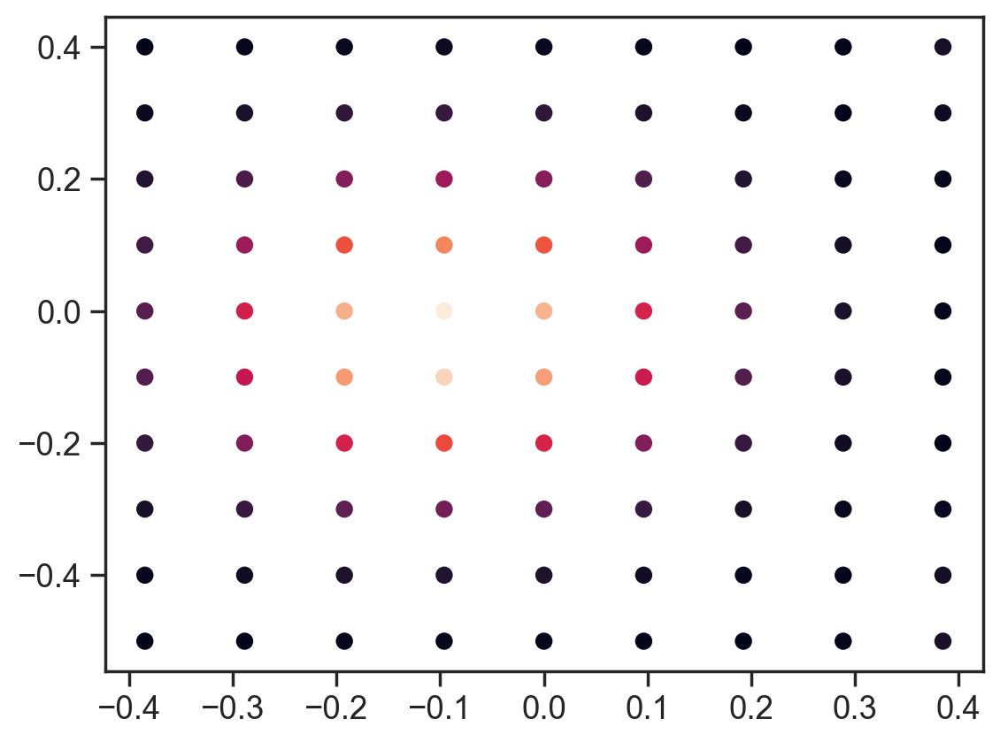

In [5169]:
for i in range(n_vels):
    plot_weight_mat(cell_position_diffs_temp, 49, Ws_all[i,0,:,:], False)

In [4913]:
cell_position_diffs.shape

(2, 90, 90)

In [4955]:
# these are the cells receiving landmark input
l_gcs = np.arange(0,90, n_x+n_y+2)

cell_position_tri_dists = np.zeros((N,N))
for i in range(N):
    cell_position_tri_dists[i] = calc_tri_dist_squared(cell_position_diffs[:, i, :])

avg_dist = np.mean(cell_position_tri_dists)
l_gcs_dist_from_others = cell_position_tri_dists[l_gcs, :]
avg_l_gcs_dist_from_others = np.mean(l_gcs_dist_from_others)
l_gcs_dist_each_other = np.zeros((5,5))

for i in range(5):
    l_gcs_dist_each_other[i, :] = l_gcs_dist_from_others[i, l_gcs]

avg_l_gcs_dist_from_each_other = np.mean(l_gcs_dist_each_other)

print(avg_dist, avg_l_gcs_dist_from_others, avg_l_gcs_dist_from_each_other)

0.1378876049278511 0.13644031700212508 0.14560020476579666


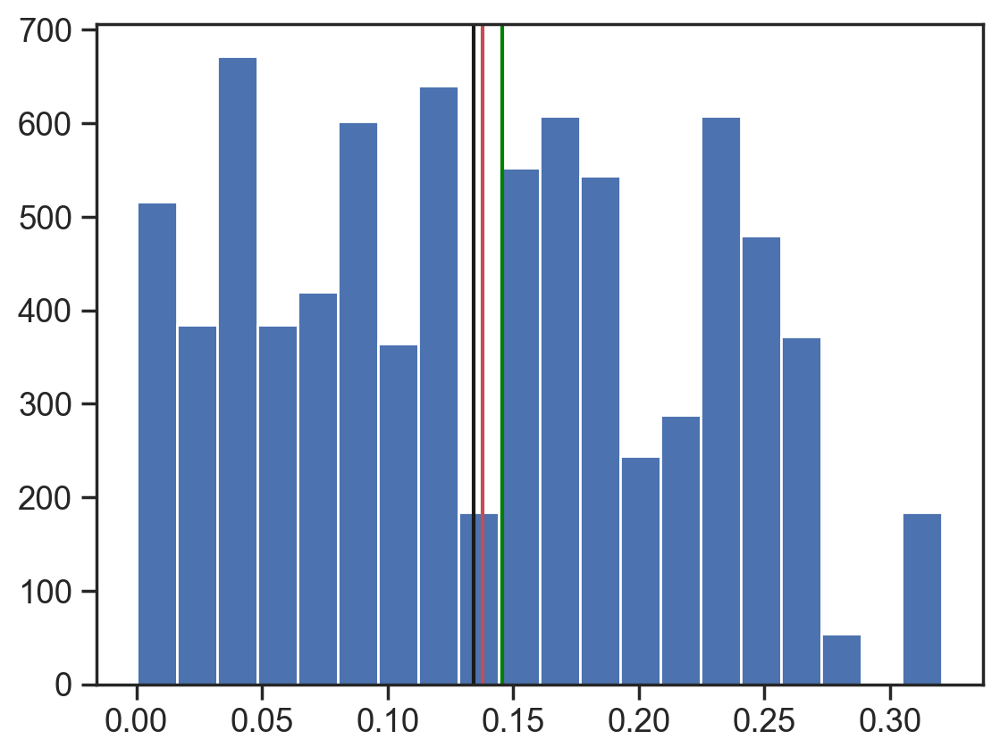

In [4956]:
h=plt.hist(cell_position_tri_dists.reshape(-1), 20)
plt.axvline(np.median(cell_position_tri_dists.reshape(-1)), c='k')
plt.axvline(np.mean(cell_position_tri_dists.reshape(-1)), c='r')
plt.axvline(avg_l_gcs_dist_from_each_other, c='green')

In [4954]:
avg_dist

0.1378876049278511

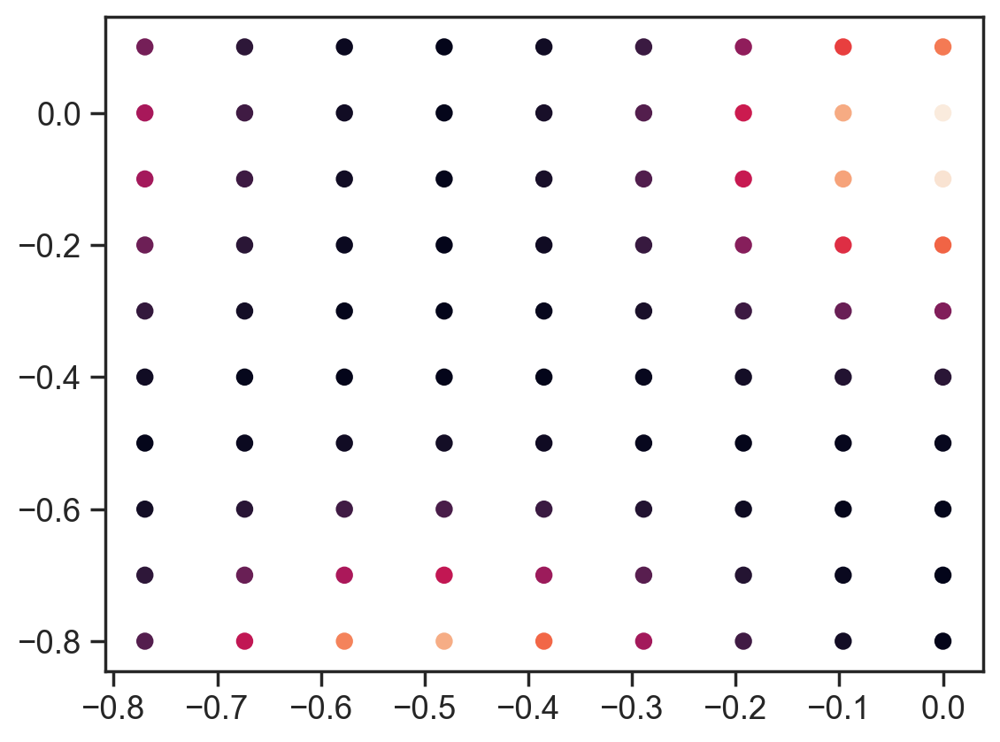

In [4906]:
plot_weight_mat(cell_position_diffs, n_x*2*i, W[0,:,:], False)


In [4895]:
# for i in range(5):
#     plt.figure(figsize=(3,5))
#     plot_weight_mat(cell_position_diffs, n_x*2*i, W[0,:,:], False)


3.3758634850382805


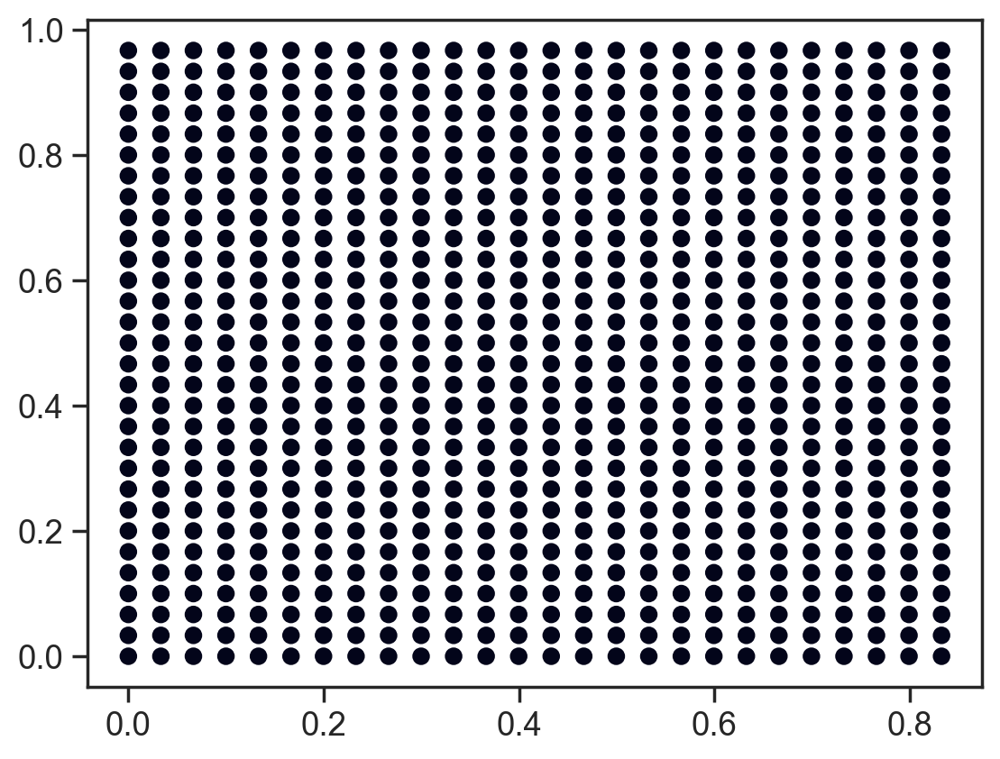

In [859]:
# seems like the sum of all the weights should be uniform. UNIFORM AFTER FIXING S MAT!!!!
xs = cell_position_diffs_temp[0, :, 0]
ys = cell_position_diffs_temp[1, :, 0]
zs = np.sum(Ws_all[4,5,:,:], axis=-1)
# zs = np.sum(Ws_all[6,6,:,:], axis=-1)
# zs = np.sum(Ws_all[6,6,:,:], axis=-1) - np.sum(Ws_all[4,5,:,:], axis=-1)
print(np.mean(zs))

plt.scatter(xs, ys, c=zs)


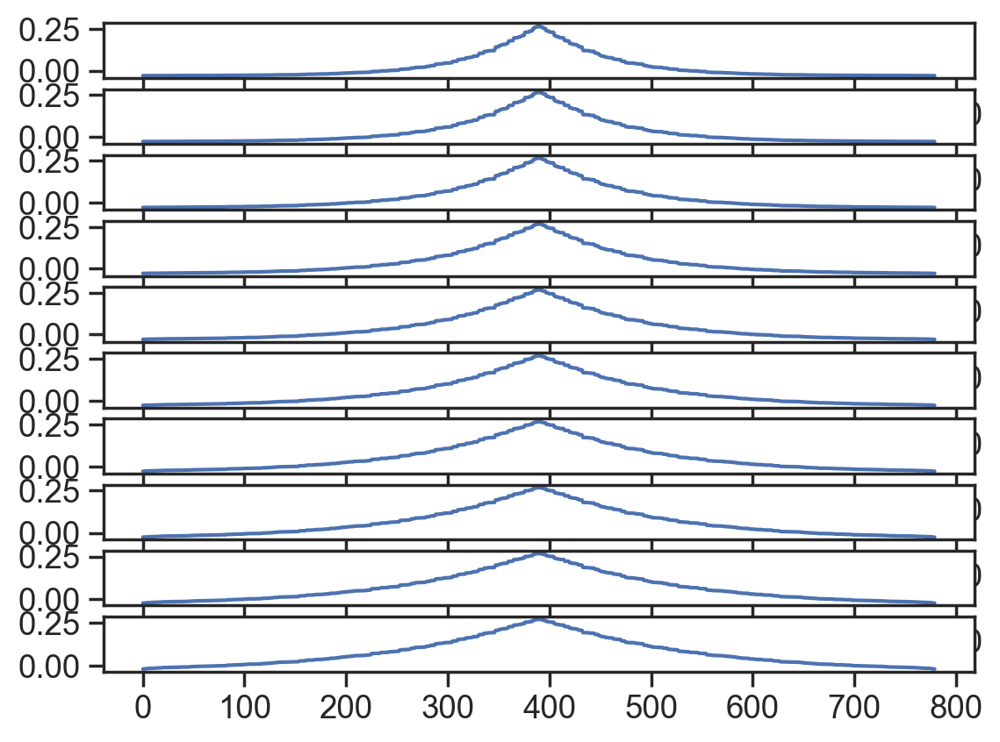

In [4176]:
for i in range(10):
    plt.subplot(10,1,i+1)
    plt.plot(Ws_all[i,2,sort_idxs2,0])


In [10587]:
## Used for buildup simulation
# def run_sim(n_timebins, init_state, cell_position_diffs, 
#             n_y, n_x, alpha, beta, I, sigma, T, tau, velocity, velocity_gain, 
#             track_length,
#             l_pos, l_str,
#             n_warmup_bins,
#             B0):
   
#     N = init_state.shape[0]
#     A = np.zeros((n_timebins, N))
#     B = np.zeros((n_timebins, N))
#     W = np.zeros((n_timebins, N, N))
#     mean_vals = np.zeros((n_timebins,))
#     B[0,:] = B0
#     mean_vals[0] = np.mean(B0)


#     # expecting constant speed
#     speed = velocity_gain*np.linalg.norm(velocity, axis=1)[0]
#     scaled_velocity = speed
#     posx_lin = np.arange(0, speed * n_timebins, speed)
#     posx = np.mod(posx_lin, track_length)
    
#     if l_pos.size > 0:
#         n_landmarks = l_pos.size
#     else:
#         l_pos = np.array([-100, -100])
#         n_landmarks = 2

#     l_pos_all = np.tile(np.expand_dims(l_pos, 0), (n_timebins,1))
#     posx_all = np.tile(np.expand_dims(posx, 1), (1,n_landmarks))
#     pos_from_l = posx_all - l_pos_all

#     a=(pos_from_l>-20)*(pos_from_l<10)
#     b=(pos_from_l<=-20)+(pos_from_l>=10)
#     pos_from_l[b] = -np.inf
#     A_l = l_str * np.exp(-np.power(0.1*(pos_from_l),2))

#     ## THINGS TO TRY:
#     # INCREASE LOOKAHEAD DISTANCE TO 50
#     # ADD MORE LANDMARKS (ONE AT 320)
#     # DECREASE CONSTANT WITHIN EXPONENT TO SPREAD OUT THE EFFECT
#     # SET PINNING PHASE MORE LIKE A GAUSSIAN AROUND A CELL WITH NEARBY (TRIDIST) CELLS
    
#     W_l = np.zeros((n_timebins, n_landmarks, N))
    
#     for l in range(n_landmarks):
#         # order that landmarks come on: reward, t1, t3, t2
#         # order of landmarks in positions: t1, t2, t3, reward
        
#         if (l_pos[l] == 319):
#             this_cell = 0*(n_x + n_y + 2)
#             this_cell_dist_from_all = cell_position_diffs[:, this_cell, :]
#             this_cell_tri_dist = calc_tri_dist_squared(this_cell_dist_from_all)
#             sort_idxs = np.argsort(this_cell_tri_dist)
#             close_cells = sort_idxs[np.array([0, N//2, -1])]
#             W_l[:, l, close_cells] = 0.12
#         elif (l_pos[l] == 50):
#             this_cell = 1*(n_x + n_y + 2)
#             this_cell_dist_from_all = cell_position_diffs[:, this_cell, :]
#             this_cell_tri_dist = calc_tri_dist_squared(this_cell_dist_from_all)
#             sort_idxs = np.argsort(this_cell_tri_dist)
#             close_cells = sort_idxs[np.array([0, N//2, -1])]
#             W_l[:, l, close_cells] = 0.04
#         elif (l_pos[l] == 120):
#             this_cell = 2*(n_x + n_y)
#             this_cell_dist_from_all = cell_position_diffs[:, this_cell, :]
#             this_cell_tri_dist = calc_tri_dist_squared(this_cell_dist_from_all)
#             sort_idxs = np.argsort(this_cell_tri_dist)
#             close_cells = sort_idxs[np.array([0, N//2, -1])]
#             W_l[:, l, close_cells] = 0.12
#         elif (l_pos[l] == 190):
#             this_cell = 3*(n_x + n_y)
#             this_cell_dist_from_all = cell_position_diffs[:, this_cell, :]
#             this_cell_tri_dist = calc_tri_dist_squared(this_cell_dist_from_all)
#             sort_idxs = np.argsort(this_cell_tri_dist)
#             close_cells = sort_idxs[np.array([0, N//2, -1])]
#             W_l[:, l, close_cells] = 0.1
#         elif (l_pos[l] == 260):
#             this_cell = 4*(n_x + n_y)
#             this_cell_dist_from_all = cell_position_diffs[:, this_cell, :]
#             this_cell_tri_dist = calc_tri_dist_squared(this_cell_dist_from_all)
#             sort_idxs = np.argsort(this_cell_tri_dist)
#             close_cells = sort_idxs[np.array([0, N//2, -1])]
#             W_l[:, l, close_cells] = 0.12

#     # want a landmark component. current weight matrix is (N, N)
#     # W_l should be W_l^T A_t as well. A_t is (N, ) W_l^T will be (n_landmarks, N)
    
#     # modulate the W_l matrix by activity of landmark cells 
#     # l W_l^T A_t
#     # (n_landmarks,) x (n_landmarks, N) x (N,)
        
#     # need 3 changes: 
#     # 1. add a function to calculate hebbian plasticity and edit the landmark weight matrix. 
#     # 2. add landmark weight matrix to the update function. 
#     # 3. add landmark cells to the population
#     # 4. keep track of position based on speed (should be constant) 

#     if np.isscalar(beta):
#         beta = beta * np.ones(n_timebins, )
    
#     if n_warmup_bins > 0:
#         A_warmup = np.zeros((n_warmup_bins, N))
#         B_warmup = np.zeros((n_warmup_bins, N))
#         W_warmup = np.zeros((n_warmup_bins, N, N))
#         mean_vals_warmup = np.zeros((n_warmup_bins,))

#         A_l_warmup = np.zeros((n_warmup_bins, n_landmarks))
#         W_l_warmup = np.zeros((n_warmup_bins, n_landmarks, N))
        
#         warmup_velocity = np.tile(np.zeros((1, 2)), (n_warmup_bins, 1))
#         warmup_beta = beta[0] * np.ones(n_warmup_bins)
#         A_warmup[0, :] = init_state

#         for t in np.arange(0, n_warmup_bins-1):
#             if t == 0:
#                 mean_vals_warmup[t] = np.mean(A_warmup[t, :])
#             else:
#                 mean_vals_warmup[t] = np.mean(B_warmup[t, :])

#             W_warmup[t, :, :], _ = calc_weight_mat(cell_position_diffs, n_y, n_x, alpha, warmup_beta[t], warmup_velocity[t], I, sigma, T)
#             A_warmup[t+1, :], B_warmup[t+1, :] = update_function(A_warmup[t, :], W_warmup[t, :, :], A_l_warmup[t, :], W_l_warmup[t, :, :], tau, mean_vals_warmup[t])

#         init_state = A_warmup[-1, :]
#         print('Warmup Complete')

#     A[0, :] = init_state
#     for t in np.arange(0, n_timebins-1):
#        if mean_vals[0] == 0:
#            mean_vals[t] = np.mean(A[t, :])
#        else:
#            mean_vals[t] = np.mean(B[t, :])

#         W[t, :, :], _ = calc_weight_mat(cell_position_diffs, n_y, n_x, alpha, beta[t], velocity[t], I, sigma, T)
#         A[t+1, :], B[t+1, :] = update_function(A[t, :], W[t, :, :], A_l[t, :], W_l[t, :, :], tau, mean_vals[t])
        
#     if (np.mod(t, 10000)==0):
#         print(t)

#     return A, B, W, scaled_velocity, posx_lin, posx, A_l, W_l

In [5249]:
# def run_sim(n_timebins, init_state, cell_position_diffs, 
#             n_y, n_x, alpha, beta, I, sigma, T, tau, velocity, velocity_gain, 
#             track_length,
#             l_pos, l_str,
#             n_warmup_bins,
#             B0, beta_noise, weight_noise):
   
#     N = init_state.shape[0]
#     A = np.zeros((n_timebins, N))
#     B = np.zeros((n_timebins, N))
#     W = np.zeros((n_timebins, N, N))
#     mean_vals = np.zeros((n_timebins,))
#     B[0,:] = B0
#     mean_vals[0] = np.mean(B0)

#     # expecting constant speed
#     speed = velocity_gain*np.linalg.norm(velocity, axis=1)[0]
#     scaled_velocity = speed
#     posx_lin = np.arange(0, speed * n_timebins, speed)[:n_timebins]
#     posx = np.mod(posx_lin, track_length)[:n_timebins]

#     pos = np.concatenate((np.zeros((1,2)), np.cumsum(velocity, axis=0)))
    
#     if l_pos.size > 0:
#         n_landmarks = l_pos.size
#     else:
#         l_pos = np.array([-100, -100])
#         n_landmarks = 2

#     l_pos_all = np.tile(np.expand_dims(l_pos, 0), (n_timebins,1))
#     posx_all = np.tile(np.expand_dims(posx, 1), (1,n_landmarks))
    
#     pos_from_l = posx_all - l_pos_all

#     a=(pos_from_l>-50)*(pos_from_l<10)
#     b=(pos_from_l<=-50)+(pos_from_l>=10)
#     pos_from_l[b] = -np.inf
#     A_l = l_str * np.exp(-np.power(0.04*(pos_from_l),2))

#     W_l = np.zeros((n_timebins, n_landmarks, N))
    
#     rng = np.random.default_rng()
#     pinning_phases = rng.choice(N, int(n_landmarks * l_pinning_n)).reshape(n_landmarks, l_pinning_n)

#     # add input to specify landmark pinning phases later
#     for l in range(n_landmarks):
#         this_cell = pinning_phases[l]
#         W_l[:, l, this_cell] = 0.2 # add input to specify landmark pinning weight

#     # for l in range(n_landmarks):
#     #     # order that landmarks come on: reward, t1, t3, t2
#     #     # order of landmarks in positions: t1, t2, t3, reward
#     #     if (l == 0):
#     #         this_cell = 3*(n_x + n_y)
#     #         this_cell_dist_from_all = cell_position_diffs[:, this_cell, :]
#     #         this_cell_tri_dist = calc_tri_dist_squared(this_cell_dist_from_all)
#     #         sort_idxs = np.argsort(this_cell_tri_dist)
#     #         close_cells = sort_idxs[np.array([0,1,2])]
#     #         W_l[:, l, close_cells] = 0.22
#     #     elif (l==1):
#     #         this_cell = 48
#     #         # this_cell = 3*(n_x + n_y)
#     #         this_cell_dist_from_all = cell_position_diffs[:, this_cell, :]
#     #         this_cell_tri_dist = calc_tri_dist_squared(this_cell_dist_from_all)
#     #         sort_idxs = np.argsort(this_cell_tri_dist)
#     #         close_cells = sort_idxs[0]
#     #         W_l[:, l, close_cells] = 0.3
#     #     elif (l==2):
#     #         this_cell = n_x+n_y
#     #         # this_cell = 3*(n_x + n_y)
#     #         this_cell_dist_from_all = cell_position_diffs[:, this_cell, :]
#     #         this_cell_tri_dist = calc_tri_dist_squared(this_cell_dist_from_all)
#     #         sort_idxs = np.argsort(this_cell_tri_dist)
#     #         close_cells = sort_idxs[0]
#     #         W_l[:, l, close_cells] = 0.4
        
#     # want a landmark component. current weight matrix is (N, N)
#     # W_l should be W_l^T A_t as well. A_t is (N, ) W_l^T will be (n_landmarks, N)
    
#     # modulate the W_l matrix by activity of landmark cells 
#     # l W_l^T A_t
#     # (n_landmarks,) x (n_landmarks, N) x (N,)
        
#     # need 3 changes: 
#     # 1. add a function to calculate hebbian plasticity and edit the landmark weight matrix. 
#     # 2. add landmark weight matrix to the update function. 
#     # 3. add landmark cells to the population
#     # 4. keep track of position based on speed (should be constant) 

#     if np.isscalar(beta):
#         beta = beta * np.ones(n_timebins, )
    
#     if n_warmup_bins > 0:
#         A_warmup = np.zeros((n_warmup_bins, N))
#         B_warmup = np.zeros((n_warmup_bins, N))
#         W_warmup = np.zeros((n_warmup_bins, N, N))
#         mean_vals_warmup = np.zeros((n_warmup_bins,))

#         A_l_warmup = np.zeros((n_warmup_bins, n_landmarks))
#         W_l_warmup = np.zeros((n_warmup_bins, n_landmarks, N))
        
#         warmup_velocity = np.tile(np.zeros((1, 2)), (n_warmup_bins, 1))
#         warmup_beta = beta[0] * np.ones(n_warmup_bins)
#         A_warmup[0, :] = init_state

#         for t in np.arange(0, n_warmup_bins-1):
#             if t == 0:
#                 mean_vals_warmup[t] = np.mean(A_warmup[t, :])
#             else:
#                 mean_vals_warmup[t] = np.mean(B_warmup[t, :])
                            
#             W_warmup[t, :, :], _, _ = calc_weight_mat(cell_position_diffs, n_y, n_x, alpha, warmup_beta[t], warmup_velocity[t], I, sigma, T, beta_noise)
            
#             #pdb.set_trace()           

#             A_warmup[t+1, :], B_warmup[t+1, :], _ = update_function(A_warmup[t, :], W_warmup[t, :, :], A_l_warmup[t, :], W_l_warmup[t, :, :], tau, mean_vals_warmup[t], weight_noise)

#         init_state = A_warmup[-1, :]
#         print('Warmup Complete')

#     A[0, :] = init_state
#     for t in np.arange(0, n_timebins-1):
#         if mean_vals[0] == 0:
#             mean_vals[t] = np.mean(A[t, :])
#         else:
#             mean_vals[t] = np.mean(B[t, :])
#         # pdb.set_trace()
#         W[t, :, :], _, _= calc_weight_mat(cell_position_diffs, n_y, n_x, alpha, beta[t], velocity[t], I, sigma, T, beta_noise)
#         A[t+1, :], B[t+1, :], _ = update_function(A[t, :], W[t, :, :], A_l[t, :], W_l[t, :, :], tau, mean_vals[t], weight_noise)
        
#     if (np.mod(t, 10000)==0):
#         print(t)

#     return A, B, W, scaled_velocity, posx_lin, posx, A_l, W_l

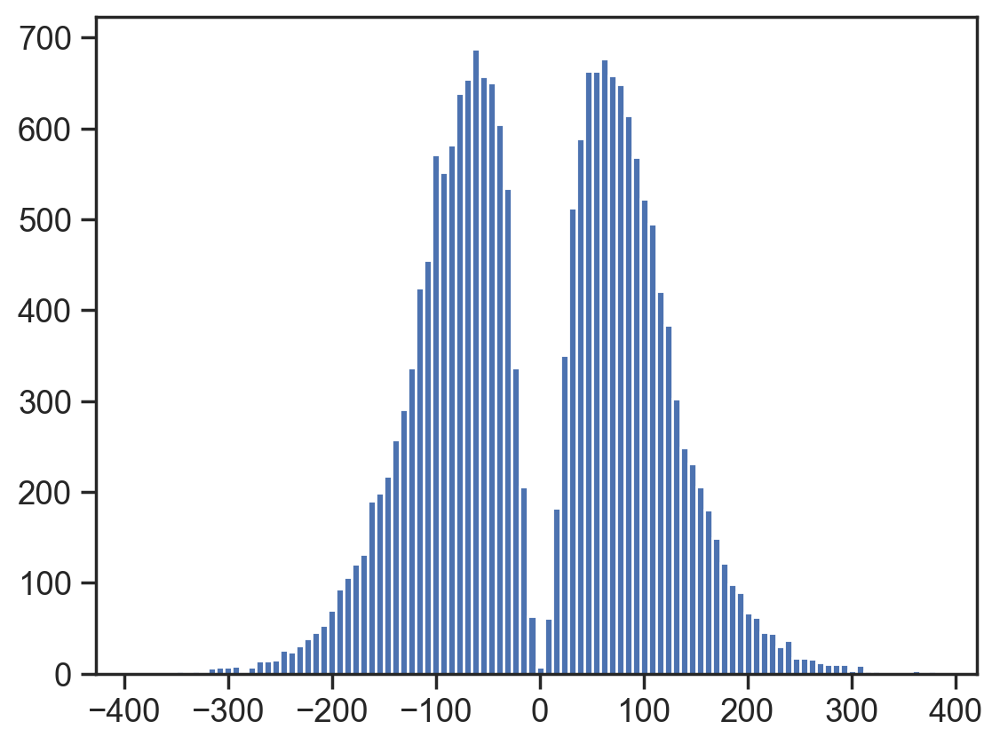

In [5669]:
shape = 3
scale = 1
vel_rw = 30*rng.gamma(shape, scale, size=(n_bins,2)) * np.sign(rng.standard_normal(size=(n_bins,2)))

h=plt.hist(vel_rw.reshape(-1), 100)

# Run 2D Simulation

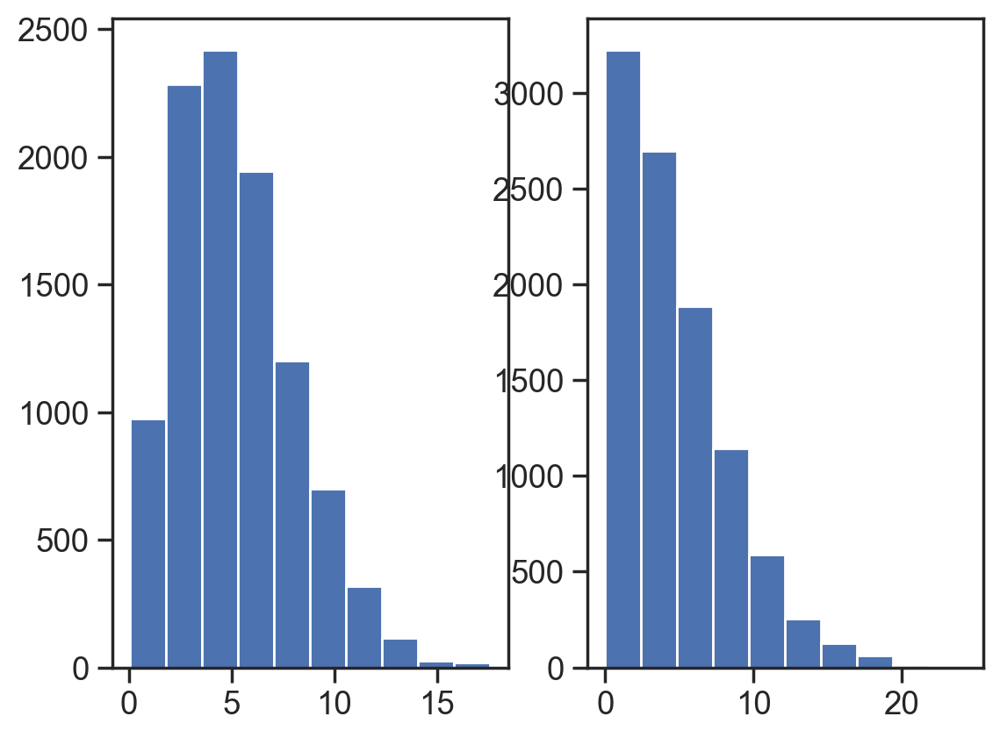

In [6015]:
# generate 2D random walk
rng = np.random.default_rng(seed=6)
n_bins = 10000

# acc_rw = 30*rng.standard_normal(size=(n_bins,2))
# vel_rw = np.cumsum(acc_rw,axis=0)
vel_rw = 20*rng.standard_normal(size=(n_bins,2))

# shape = 3
# scale = 1
# vel_rw = 20*rng.gamma(shape, scale, size=(n_bins,2)) * np.sign(rng.standard_normal(size=(n_bins,2)))

# vel_rw = gaussian_filter1d(vel_rw, 2, axis=0)

# speed_rw = np.linalg.norm(vel_rw, axis=1)
# vel_rw = 20*np.divide(vel_rw, np.expand_dims(speed_rw, 1))
# vel_rw = 50*np.divide(vel_rw, np.expand_dims(speed_rw, 1))

minx = 0
miny = 0
maxx = 250
maxy = 250
start_pos = np.array([maxx//2, maxy//2])


# iteratively fix velocity so that it isn't too jagged
n_iters=5
postemps = np.zeros((n_iters+1, n_bins, 2))
postemps[0, :, :] = np.cumsum(vel_rw, axis=0) + start_pos
vel_rws = np.zeros((n_iters+1, n_bins, 2))
vel_rws[0, :, :] = vel_rw
smooth_per_iter = 3

for i in range(n_iters-1):
    # fix velocity so doesn't cross boundary
    vel_rw = fix_boundary_vel(vel_rw, start_pos, minx, miny, maxx, maxy, 0.8)

    # smooth velocity so boundary velocity isn't too weird
    vel_rw = gaussian_filter1d(vel_rw, smooth_per_iter, axis=0)
    vel_rws[i+1, :, :] = vel_rw

    # save the pos
    postemps[i+1, :, :] = np.cumsum(vel_rw, axis=0) + start_pos

# STILL NEED ONE MORE FIX AFTER THE SMOOTH
vel_rw = fix_boundary_vel(vel_rw, start_pos, minx, miny, maxx, maxy, 0.8)
vel_rws[i+2] = vel_rw
postemps[i+2, :, :] = np.cumsum(vel_rw, axis=0) + start_pos

# looks like the second correction is already good enough
vel2d = vel_rws[2, :, :]
speed_vel2d = np.linalg.norm(vel2d, axis=1)

plt.subplot(121)
# plt.plot(speed_vel2d)
h=plt.hist(speed_vel2d)

plt.subplot(122)
# plt.plot(np.linalg.norm(np.diff(vel2d), axis=1))
h=plt.hist(np.linalg.norm(np.diff(vel2d), axis=1))


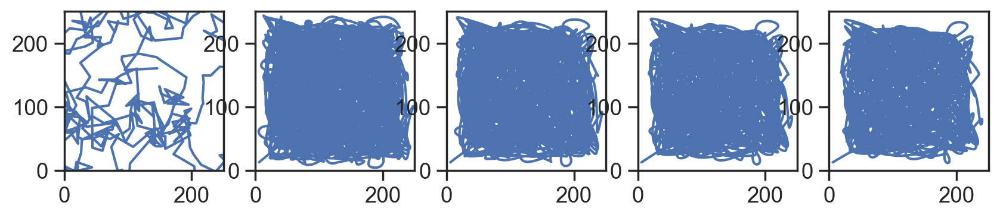

In [6016]:
plt.figure(figsize=(n_iters * 2, n_iters))
for i in range(n_iters):
    plt.subplot(1, n_iters,i+1)
    plt.plot(postemps[i,:,0], postemps[i,:,1])
    plt.axis('square')
    plt.xlim([0, maxx])
    plt.ylim([0, maxy])
    # note that first plot is no correction
    # second is after correction, but because of smoothing the positions can still go out of the boundaries

In [44]:
import csv
# filename = 'D:/Code/bump_video/sim/AO1_231221_postop_day9_OF01_g2_position.txt'
# filename = 'D:/Code/bump_video/sim/AO2_231221_postop_day7_OF01_g1_position.txt'
# filename = 'D:/Code/bump_video/sim/AO4_231219_postop_day5_OF01_g1_position.txt'
filename = 'D:/Code/bump_video/sim/AO5_231218_postop_day6_OF01_g1_position.txt'

data = []
with open(filename, newline='') as csvfile:
    reader = csv.reader(csvfile, delimiter=',')
    for row in reader:
        data.append(row)
        
csvfile.close()
data=np.array(data)

pos_str = data[100:,7:9]

def myArrayConverter(arr):

    convertArr = []
    for s in arr.ravel():    
        try:
            value = float(s)
        except ValueError:
            value = np.nan

        convertArr.append(value)

    return np.array(convertArr,dtype=object).reshape(arr.shape)

C:\Users\johnh\.conda\envs\si_env\Lib\site-packages\numpy\core\_methods.py:45: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\johnh\.conda\envs\si_env\Lib\site-packages\numpy\core\_methods.py:41: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


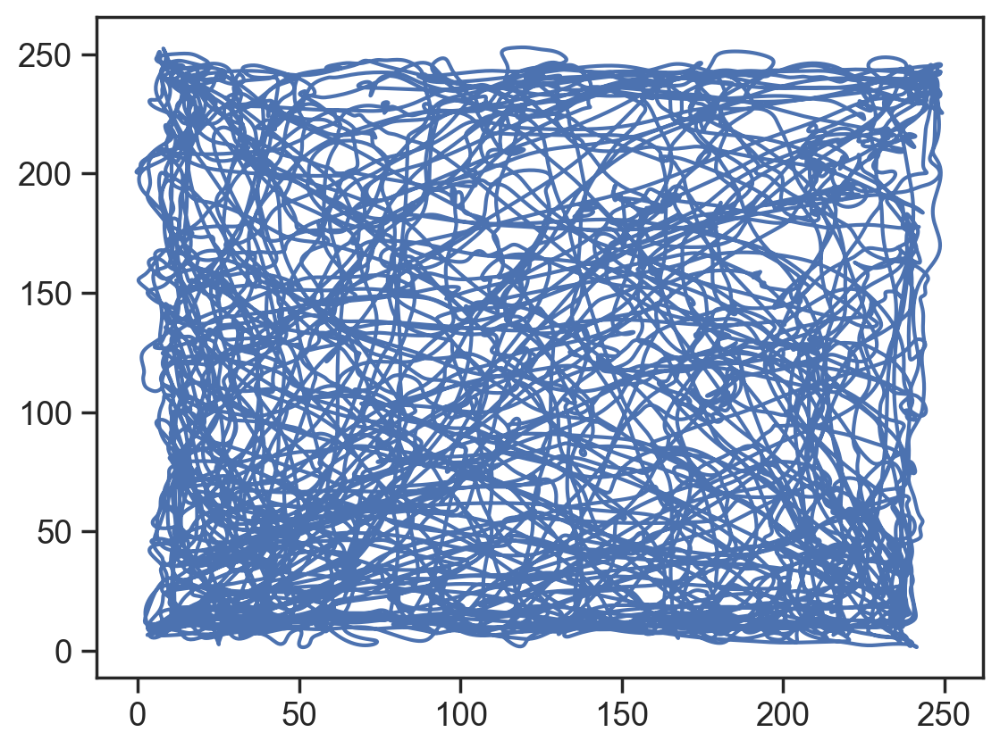

In [46]:
pos = myArrayConverter(pos_str)
norm_pos=(pos - pos.min(0)) / (pos.max(0)-pos.min(0))
pos = (norm_pos * 250).astype(float)
# pos = gaussian_filter1d(pos, 1, axis=0)
# plt.plot(pos[:,0], pos[:,1])

vel2d = np.diff(pos, axis=0)
speed = np.sqrt((np.power(vel2d[:,0], 2) + np.power(vel2d[:,1],2)).astype(float))

# bins_moving = np.where(speed > 0.5)[0]
bins_moving = np.where(speed > 0.35)[0]

start_bin=15000
pos_moving = pos[bins_moving[start_bin:start_bin+50001:1],:]
vel2d = np.diff(pos_moving, axis=0).astype(float)
vel2d = gaussian_filter1d(vel2d, 2, axis=0)

this_pos = pos_moving[0,:] + np.cumsum(vel2d, axis=0)
plt.plot(this_pos[:,0], this_pos[:,1])

In [47]:
bins_moving.shape

(83487,)

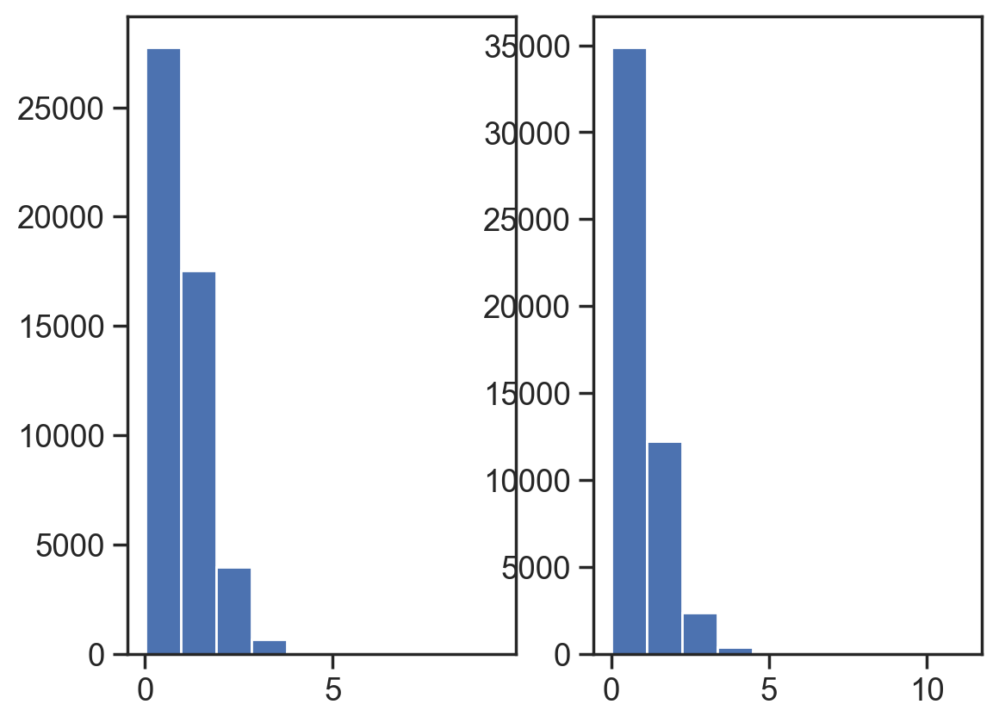

In [48]:
speed_vel2d = np.linalg.norm(vel2d, axis=1)

plt.subplot(121)
# plt.plot(speed_vel2d)
h=plt.hist(speed_vel2d)

plt.subplot(122)
# plt.plot(np.linalg.norm(np.diff(vel2d), axis=1))
h=plt.hist(np.linalg.norm(np.diff(vel2d), axis=1))

In [49]:
vel2d.shape

(50000, 2)

In [50]:
# H,_,_=np.histogram2d(postemps[2, :, 0], postemps[2,:, 1], bins=50)
# plt.imshow(H)
# a = np.digitize(postemps[2,:,:], bins=np.arange(0, maxx, 50))

In [51]:
# run full experiment
n_x = 10 # column n
n_y = 9 # row n
N = n_x * n_y

cell_positions = calc_cell_positions(n_y, n_x)
cell_position_diffs = calc_cell_position_diffs(cell_positions)
init_state = initialize_network(n_y, n_x, seed=1)
init_state = init_state.reshape(-1)

# velocity_gain = 1
# l_pos_pb=np.array([[], [80], [80, 180], [80, 180, 320]], dtype='object')

# block_timebin_starts = np.concatenate((np.array([0]), np.cumsum(n_timebins_pb)))

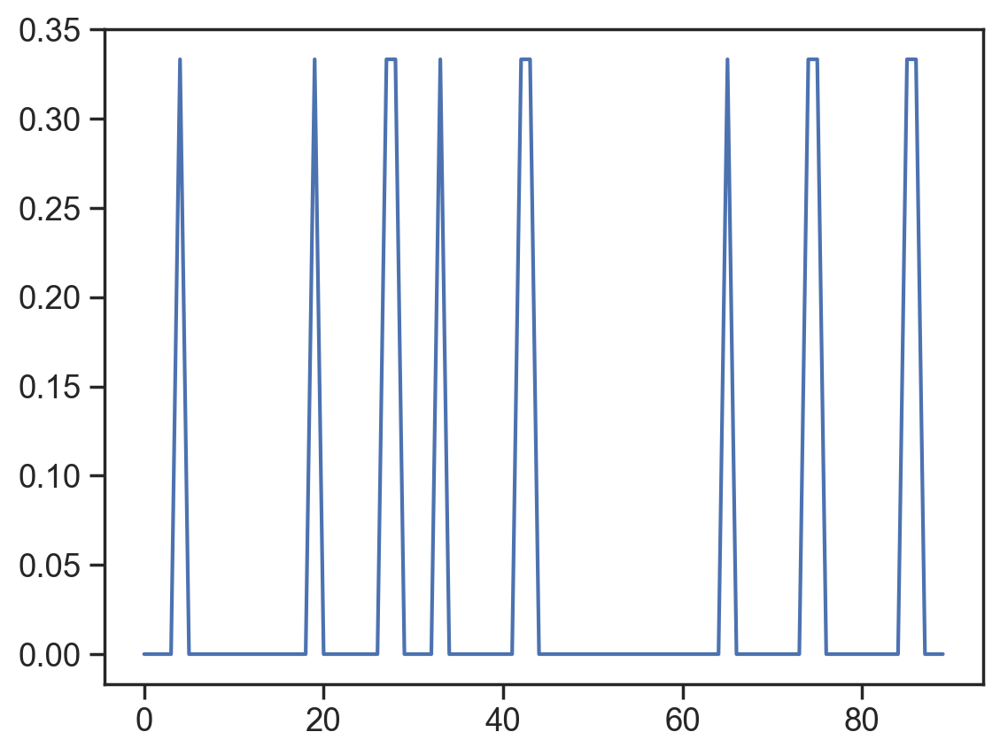

In [6929]:
N=90
n_landmarks = 4
l_pinning_n = 3
rng = np.random.default_rng(seed=1)
pinning_phases = rng.choice(N, n_landmarks*l_pinning_n).reshape(n_landmarks, l_pinning_n)

use_nearby = True # make this an input later
W_l_test = np.zeros((1, n_landmarks, N))
# add input to specify landmark pinning phases later
for l in range(n_landmarks):
    for li in range(l_pinning_n):
        if li==0:
            this_cell = pinning_phases[l, li]
        else:
            if use_nearby:
                cell0 = pinning_phases[l, 0]
                this_cell_dist_from_all = cell_position_diffs[:, cell0, :]
                this_cell_tri_dist = calc_tri_dist_squared(this_cell_dist_from_all)
                closest_cells = np.argsort(this_cell_tri_dist)
                this_cell = closest_cells[li+1]

        W_l_test[:, l, this_cell] = 1/l_pinning_n # add input to specify landmark pinning weight
        
plt.plot(np.sum(W_l_test[0], axis=0))

In [62]:
# # copy
# def run_sim2d(n_timebins, init_state, cell_position_diffs, 
#               n_y, n_x, alpha, beta, I, sigma, T, tau, velocity, start_pos,
#               track_length,
#               l_pos, l_str, l_pinning_n, l_use_nearby, l_lookahead,
#               n_warmup_bins,
#               B0, beta_noise=0, weight_noise=0, 
#               W_input=None, W_l_input=None, output_bins=10000):
   
#     N = init_state.shape[0]
#     A = np.zeros((n_timebins, N))
#     B = np.zeros((n_timebins, N))
#     mean_vals = np.zeros((n_timebins,))

#     if W_input is not None:
#         W = np.copy(W_input)
#         betas_with_noise = np.zeros((n_timebins,))
#         weight_noise_vals = np.zeros((n_timebins, N, N))
#     else:
#         W = np.zeros((n_timebins, N, N))
#         rng = np.random.default_rng(seed=1)
#         betas_with_noise = beta+np.cumsum(beta_noise*rng.standard_normal(size=((n_timebins,))))
#         weight_noise_vals = weight_noise*rng.standard_normal(size=(n_timebins, N, N))

#     B[0,:] = B0
#     mean_vals[0] = np.mean(B0)

#     pos = np.cumsum(velocity, axis=0) + start_pos
#     # make all of this landmark stuff a function later
#     if l_pos.size > 0:
#         n_landmarks = l_pos.size // 2 # two dimensions in l_pos
#     else:
#         l_pos = np.array([-np.inf, -np.inf])
#         n_landmarks = 1

#     if W_l_input is not None:
#         W_l = W_l_input
#     else:
#         W_l = np.zeros((n_timebins, n_landmarks, N))
    
#     l_pos_all = np.tile(np.expand_dims(l_pos, 0), (n_timebins,1,1))
#     pos_all = np.tile(np.expand_dims(pos, 1), (1,n_landmarks,1))
    
#     pos_from_l = pos_all - l_pos_all
#     true_pos_from_l = np.linalg.norm(pos_from_l, axis=2)

#     # a=(pos_from_l>-50)*(pos_from_l<10)
#     # b=(pos_from_l<=-50)+(pos_from_l>=10)

#     exp_factor = 2 / l_lookahead

#     b = np.abs(true_pos_from_l) >= l_lookahead # the smaller this becomes, the larger the factor x needs to be below (x * (true_pos_from_l))
#     true_pos_from_l[b] = -np.inf
#     A_l = l_str * np.exp(-np.power(exp_factor*(true_pos_from_l),2)) 
    
#     rng = np.random.default_rng(seed=1)
#     pinning_phases = rng.choice(N, n_landmarks*l_pinning_n).reshape(n_landmarks, l_pinning_n)
    
#     # add input to specify landmark pinning phases later 
#     # add another conditional here about hebbian plasticity term being 0. otherwise, W_l_input MUST be calculated each timestep
#     if W_l_input is None:
#         for l in range(n_landmarks):
#             for li in range(l_pinning_n):
#                 if li==0:
#                     this_cell = pinning_phases[l, li]
#                 else:
#                     if l_use_nearby:
#                         cell0 = pinning_phases[l, 0]
#                         this_cell_dist_from_all = cell_position_diffs[:, cell0, :]
#                         this_cell_tri_dist = calc_tri_dist_squared(this_cell_dist_from_all)
#                         closest_cells = np.argsort(this_cell_tri_dist)
#                         this_cell = closest_cells[li+1]
#                     else:
#                         this_cell = pinning_phases[l, li]
    
#                 W_l[:, l, this_cell] = 1/l_pinning_n # add input to specify landmark pinning weight
      
#     if n_warmup_bins > 0:
#         A_warmup = np.zeros((n_warmup_bins, N))
#         B_warmup = np.zeros((n_warmup_bins, N))
#         W_warmup = np.zeros((n_warmup_bins, N, N))
#         mean_vals_warmup = np.zeros((n_warmup_bins,))

#         A_l_warmup = np.zeros((n_warmup_bins, n_landmarks))
#         W_l_warmup = np.zeros((n_warmup_bins, n_landmarks, N))
        
#         warmup_velocity = np.tile(np.zeros((1, 2)), (n_warmup_bins, 1))
#         warmup_beta = beta * np.ones(n_warmup_bins)
#         A_warmup[0, :] = init_state

#         for t in np.arange(0, n_warmup_bins-1):
#             if t == 0:
#                 mean_vals_warmup[t] = np.mean(A_warmup[t, :])
#             else:
#                 mean_vals_warmup[t] = np.mean(B_warmup[t, :])
                            
#             W_warmup[t, :, :], _, = calc_weight_mat(cell_position_diffs, n_y, n_x, alpha, warmup_beta[t], warmup_velocity[t], I, sigma, T)
#             A_warmup[t+1, :], B_warmup[t+1, :] = update_function(A_warmup[t, :], W_warmup[t, :, :], A_l_warmup[t, :], W_l_warmup[t, :, :], 
#                                                                  tau, mean_vals_warmup[t])

#         init_state = A_warmup[-1, :]
#         if output_bins>0:
#             print('Warmup Complete')

#     A[0, :] = init_state
#     for t in np.arange(0, n_timebins-1):
#         if mean_vals[0] == 0:
#             mean_vals[t] = np.mean(A[t, :])
#         else:
#             mean_vals[t] = np.mean(B[t, :])

#         # calculate weight matrix and add noise if not supplied
#         if W_input is None:  
#             if t==0:
#                 beta_t = beta
#             else:
#                 beta_t = betas_with_noise[t-1]
#             W[t, :, :], _ = calc_weight_mat(cell_position_diffs, n_y, n_x, alpha, beta_t, velocity[t], I, sigma, T)
#             W[t, :, :] += weight_noise_vals[t, :, :] # add noise

#         # update next timestep
#         A[t+1, :], B[t+1, :] = update_function(A[t, :], W[t, :, :], A_l[t, :], W_l[t, :, :], tau, mean_vals[t])
        
#         if (np.mod(t, output_bins)==0):
#             if output_bins > 0:
#                 print(t)
#                 fig = plt.figure(figsize=(3,3))
#                 plt.imshow(A[t, :].reshape(n_x,n_y))
#                 plt.show()

#     return A, B, W, pos, A_l, W_l, betas_with_noise, weight_noise_vals

In [305]:
def preallocate_sim(n_timebins, N):
    A = np.zeros((n_timebins, N))
    B = np.zeros((n_timebins, N))
    mean_vals = np.zeros((n_timebins,))
    W = np.zeros((n_timebins, N, N))
                 
    return A, B, mean_vals, W

In [306]:
def run_sim2d(init_state, cell_position_diffs, 
              n_y, n_x, alpha, beta, I, sigma, T, tau, velocity, start_pos,
              l_pos, l_str, n_ln, l_pinning_n, l_use_nearby, l_lookahead,
              alpha_hebb,
              n_warmup_bins,
              B0, beta_noise=0, weight_noise=0, 
              W_input=None, W_l_input=None, seed=1, output_bins=10000):

    # change to pos if velocity is None
    n_timebins = velocity.shape[0]
    N = init_state.shape[0]
    A, B, mean_vals, W = preallocate_sim(n_timebins, N)

    if W_input is not None:
        W = np.copy(W_input)
        betas_with_noise = np.zeros((n_timebins,))
        weight_noise_vals = np.zeros((n_timebins, N, N))
    else:
        W = np.zeros((n_timebins, N, N))
        rng = np.random.default_rng(seed=seed)
        betas_with_noise = beta+np.cumsum(beta_noise*rng.standard_normal(size=((n_timebins,))))
        weight_noise_vals = weight_noise*rng.standard_normal(size=(n_timebins, N, N))

    B[0,:] = B0
    mean_vals[0] = np.mean(B0)

    n_landmarks, _ = get_n_landmarks(l_pos)
    pos = np.cumsum(velocity, axis=0) + start_pos
    A_l = calc_A_l(pos, l_pos, n_ln)

    if W_l_input is not None:
        W_l = W_l_input
    else:
        W_l = np.zeros((n_timebins, n_landmarks, n_ln, N))
        W_l[0] = initialize_W_l(n_landmarks, n_ln, l_pinning_n, N, seed=seed)
        
        if alpha_hebb == 0:
            W_l[1:] = W_l[0]

    if n_warmup_bins > 0:
        A_warmup, B_warmup, mean_vals_warmup, W_warmup = preallocate_sim(n_warmup_bins, N)

        A_l_warmup = np.zeros((n_warmup_bins, n_landmarks, n_ln))
        W_l_warmup = np.zeros((n_warmup_bins, n_landmarks, n_ln, N))
        
        warmup_velocity = np.tile(np.zeros((1, 2)), (n_warmup_bins, 1))
        warmup_beta = beta * np.ones(n_warmup_bins)
        A_warmup[0, :] = init_state

        for t in np.arange(0, n_warmup_bins-1):
            if t == 0:
                mean_vals_warmup[t] = np.mean(A_warmup[t, :])
            else:
                mean_vals_warmup[t] = np.mean(B_warmup[t, :])
                            
            W_warmup[t, :, :], _, = calc_weight_mat(cell_position_diffs, n_y, n_x, alpha, warmup_beta[t], warmup_velocity[t], I, sigma, T)
            A_warmup[t+1, :], B_warmup[t+1, :] = update_function(A_warmup[t, :], W_warmup[t, :, :], A_l_warmup[t, :, :].reshape(-1), W_l_warmup[t, :, :, :].reshape(-1, N), 
                                                                 tau, mean_vals_warmup[t])

        init_state = A_warmup[-1, :]
        if output_bins>0:
            print('Warmup Complete')

    A[0, :] = init_state
    for t in np.arange(0, n_timebins-1):
        if mean_vals[0] == 0:
            mean_vals[t] = np.mean(A[t, :])
        else:
            mean_vals[t] = np.mean(B[t, :])

        # calculate weight matrix and add noise if not supplied
        if W_input is None:  
            if t==0:
                beta_t = beta
            else:
                beta_t = betas_with_noise[t-1]
            W[t, :, :], _ = calc_weight_mat(cell_position_diffs, n_y, n_x, alpha, beta_t, velocity[t], I, sigma, T)
            W[t, :, :] += weight_noise_vals[t, :, :] # add noise

        # update next timestep
        A[t+1, :], B[t+1, :] = update_function(A[t, :], W[t, :, :], A_l[t, :, :].reshape(-1), W_l[t, :, :, :].reshape(-1, N), tau, mean_vals[t])
        
        if (np.mod(t, output_bins)==0):
            if output_bins > 0:
                print(t)
                fig = plt.figure(figsize=(3,3))
                plt.imshow(A[t, :].reshape(n_x,n_y))
                plt.show()

    return A, B, W, pos, A_l, W_l, betas_with_noise, weight_noise_vals

In [307]:
W_l0 = initialize_W_l(n_landmarks, n_ln, l_pinning_n, N, seed=1)
A_l = calc_A_l(pos, l_pos, n_ln)

print(W_l0.shape, A_l.shape)

(3, 5, 90) (1000, 3, 5)


In [308]:
def initialize_W_l(n_landmarks, n_ln, l_pinning_n, N, seed=1):

    rng = np.random.default_rng(seed=seed)
    
    pinning_phases = rng.choice(N, n_landmarks*n_ln*l_pinning_n).reshape(n_landmarks, n_ln, l_pinning_n)
    W_l0 = np.zeros((n_landmarks, n_ln, N))
    # add input to specify landmark pinning phases later 
    # add another conditional here about hebbian plasticity term being 0. otherwise, W_l_input MUST be calculated each timestep
    for l in range(n_landmarks):
        for lc in range(n_ln):
            for li in range(l_pinning_n):
                if li==0:
                    this_cell = pinning_phases[l, lc, li]
                else:
                    if l_use_nearby:
                        cell0 = pinning_phases[l, lc, 0]
                        this_cell_dist_from_all = cell_position_diffs[:, cell0, :]
                        this_cell_tri_dist = calc_tri_dist_squared(this_cell_dist_from_all)
                        closest_cells = np.argsort(this_cell_tri_dist)
                        this_cell = closest_cells[li+1]
                    else:
                        this_cell = pinning_phases[l, lc, li]
    
                W_l0[l, lc, this_cell] = 1/(l_pinning_n*n_ln) # add input to specify landmark pinning weight
    return W_l0

In [309]:
def calc_A_l(pos, l_pos, n_ln):
    n_timebins = pos.shape[0]
    n_landmarks,l_pos = get_n_landmarks(l_pos)
    
    l_pos_all = np.tile(np.expand_dims(l_pos, (0,2)), (n_timebins,1,n_ln,1))
    pos_all = np.tile(np.expand_dims(pos, (1,2)), (1,n_landmarks,n_ln,1))

    pos_from_l = pos_all - l_pos_all
    dist_from_l = np.linalg.norm(pos_from_l, axis=-1)

    exp_factor = 2 / l_lookahead

    b = np.abs(dist_from_l) >= l_lookahead # the smaller this becomes, the larger the factor x needs to be below (x * (true_pos_from_l))
    dist_from_l[b] = -np.inf
    A_l = l_str * np.exp(-np.power(exp_factor*(dist_from_l),2)) 
    
    return A_l

In [310]:
def get_n_landmarks(l_pos):
    if l_pos.size > 0:
        n_landmarks = l_pos.size // 2 # two dimensions in l_pos
    else:
        l_pos = np.array([-np.inf, -np.inf])
        n_landmarks = 1
    return n_landmarks, l_pos

Warmup Complete
0


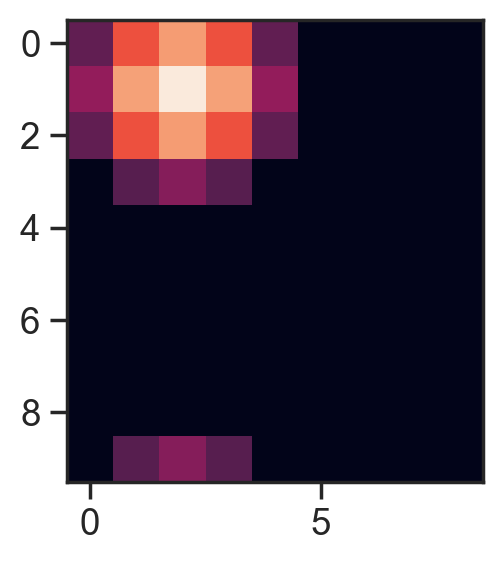

In [311]:
# TEST ADDING MULTIPLE LANDMARK CELLS PER LANDMARK
output_bins = 5000

n_timebins = vel2d.shape[0]

# n_timebins=6000
velocity_gain = 1/5
velocity = velocity_gain* np.copy(vel2d)
velocity = np.copy(velocity[:1000])
n_timebins = 1000

track_length=100
# l_pos = np.array([np.array([5,5]), np.array([45,45]), np.array([5, 45]), np.array([45, 5])])
# l_str = 0.5
n_warmup_bins = 100
B0 = np.zeros((N))
# alpha=0.05
beta = np.pi/4
tau = 0.8
# T_sim = 0.05
T_sim = 0.04
I=0.2
# I = 0.30
# sigma_sim=0.24
sigma_sim=0.20 # trying to make sigma_sim smaller to make things more noticeably different between phases. However, if it's too small, then attractor dynamics win over and prevent external inputs

# n_alphas = 2
# # all_alphas = np.linspace(0.05, 0.2, n_alphas)
# all_alphas = np.linspace(0.04, 0.07, n_alphas)
alpha = 0.12

# n_noisy_betas = 3
# all_beta_noises = np.linspace(0.05, 0.15, n_noisy_betas)
beta_noise=1.5
n_noisy_betas=2

n_l_str = 2
l_str=5

# n_landmark_conditions = 2
l_pos = np.array(([25, 150], [50,50],[40,170]))
l_lookahead = 7.5
l_pinning_n = 3
l_use_nearby = True
weight_noise = 0.05

start_pos=this_pos[0]
n_ln=5

alpha_hebb = 0

(A, _, W,
 pos, A_l, _,
 _, _) = run_sim2d(init_state, cell_position_diffs, 
                   n_y, n_x, alpha, beta, I, sigma_sim, T_sim, tau, velocity, start_pos, 
                   l_pos, l_str, n_ln, l_pinning_n, l_use_nearby, l_lookahead, alpha_hebb,
                   n_warmup_bins, B0, beta_noise, weight_noise, W_input=None, W_l_input=None,
                   output_bins=output_bins)





In [312]:
l_pos = np.array([25, 25])
l_pos.size

2

In [294]:
# velocity = np.zeros((4500, 2))
# velocity[:500, 0] = 0.25
# velocity[500:1000, 1] = 0.25

# velocity[1000:1500, 0] = -0.25
# velocity[1500:2000, 1] = -0.25

# velocity[2000:2500, :] = 0.25

# velocity[2500:3000, 0] = -0.1
# velocity[2500:3000, 1] = -0.15

# velocity[3000:3500, 0] = -0.12
# velocity[3000:3500, 1] = 0.06

# velocity[3500:4000, 0] = 0.08*np.sin(np.arange(500)/100)+0.04*np.arange(500)/100
# velocity[3500:4000, 1] = 0.08*np.cos(np.arange(500)/100)+0.04*np.arange(500)/100

# velocity[4000:4500, 0] = 0.015*np.sin(np.arange(500)/100)+0.03*np.arange(500)/100
# velocity[4000:4500, 1] = -0.1*np.cos(np.arange(500)/100)-0.075*np.arange(500)/100

# velocity = velocity * 2

# v2 = np.ones((10000,2))
# v2[:,0] = np.sin(np.arange(10000)/10000)
# v2[:,1] = np.cos(np.arange(10000)/500)

# velocity = np.concatenate((velocity, v2))
# velocity[4000:5000, 0] = np.sin(np.arange(1000)/500)
# velocity[5000:6000, 0] = np.cos(np.arange(1000)/500)


# n_timebins_remaining = n_timebins - 3000
# xs = np.arange(n_timebins_remaining)/(n_timebins_remaining*2)
# ys = np.cos(xs)

# v2 = np.zeros((n_timebins_remaining, 2))

# v2[:, 1] = ys
# # v2[:, 0] = 0.1*np.sin(xs)

# velocity = np.concatenate((velocity, v2))
# velocity = velocity / np.expand_dims(np.linalg.norm(velocity, axis=1), 1)

# velocity_gain = 1/10
# velocity = velocity * velocity_gain
# plt.plot(np.cumsum(velocity[:,0], axis=0))
# plt.plot(np.cumsum(velocity[:,1], axis=0))


# minx = 0
# miny = 0
# maxx = 250
# maxy = 250


# # iteratively fix velocity so that it isn't too jagged


# # for i in range(1):
# #     # fix velocity so doesn't cross boundary
# #     velocity = fix_boundary_vel(velocity, minx, miny, maxx, maxy)

# #     # smooth velocity so boundary velocity isn't too weird
# #     velocity = gaussian_filter1d(velocity, smooth_per_iter, axis=0)


# # STILL NEED ONE MORE FIX AFTER THE SMOOTH
# velocity = fix_boundary_vel(velocity, minx, miny, maxx, maxy)
# # velocity[i+2] = velocity
# postemps = np.cumsum(velocity, axis=0)

# # looks like the second correction is already good enough
# vel2d = velocity

# plt.plot(postemps[:,0], postemps[:,1])


In [8521]:

# pickle_bool = True

# if pickle_bool:
#     filename = 'D:/Code/bump_video/sim/2d/sweep.pkl'
    
#     data_dict = {"all_As":all_As,
#                  "all_poss":all_poss,
#                  "all_mean_maps":all_mean_maps,
#                  "all_spikes":all_spikes,
#                  "all_alphas":all_alphas,
#                  "all_beta_noises":all_beta_noises,
#                  "all_l_str":all_l_str,
#                  "all_l_pos":all_l_pos,
#                  "velocity":velocity,
#                  "block_timebin_starts":block_timebin_starts,
#                  "l_pos_pb":l_pos_pb,
#                  "trials_pb":trials_pb,
#                  "n_timebins":n_timebins,
#                  "init_state":init_state,
#                  "cell_position_diffs":cell_position_diffs,
#                  "n_y":n_y, "n_x":n_x, "I":I,
#                  "sigma_sim":sigma_sim, "T_sim":T_sim, "tau":tau, "velocity_gain":velocity_gain,
#                  "n_warmup_bins":n_warmup_bins
#                  }
    
    
#     with open(filename, 'wb') as file:
#         pickle.dump(data_dict, file)

#     file.close()
    
#     # with open(filename, 'rb') as file:
#     #   data = pickle.load(file)


In [8522]:
# output_bins = 1500
# vel1d = 0.5* np.ones((10000,2))
# # n_timebins=6000
# velocity_gain = 1
# velocity = velocity_gain* np.copy(vel1d)
# # l_pos = np.array([np.array([5,5]), np.array([45,45]), np.array([5, 45]), np.array([45, 5])])
# # l_str = 0.5
# n_warmup_bins = 100
# l_pos = np.array([-np.inf, -np.inf])
# B0 = np.zeros((N))
# # alpha=0.05
# beta = np.pi/6
# tau = 0.8
# # T_sim = 0.05
# T_sim = 0.04
# I=0.15
# # I = 0.30
# # sigma_sim=0.24
# sigma_sim=0.24 # trying to make sigma_sim smaller to make things more noticeably different between phases. However, if it's too small, then attractor dynamics win over and prevent external inputs

# # n_alphas = 2
# # # all_alphas = np.linspace(0.05, 0.2, n_alphas)
# # all_alphas = np.linspace(0.04, 0.07, n_alphas)
# alpha = 0.12
# beta_noise = 0.25

# A_1d, _, _, _, _, _, _, _ = run_sim2d(n_timebins, init_state, cell_position_diffs, 
#                                       n_y, n_x, alpha, beta, I, sigma_sim, T_sim, tau, velocity, 
#                                       track_length, l_pos, l_str, l_lookahead, n_warmup_bins, B0, beta_noise, weight_noise, output_bins)




In [8523]:
all_l_str

array([  0, 100])

In [8524]:
output_bins = 5000

n_timebins = vel2d.shape[0]

# n_timebins=6000
velocity_gain = 1/5
velocity = velocity_gain* np.copy(vel2d)
# l_pos = np.array([np.array([5,5]), np.array([45,45]), np.array([5, 45]), np.array([45, 5])])
# l_str = 0.5
n_warmup_bins = 100
B0 = np.zeros((N))
# alpha=0.05
beta = np.pi/4
tau = 0.8
# T_sim = 0.05
T_sim = 0.04
I=0.2
# I = 0.30
# sigma_sim=0.24
sigma_sim=0.20 # trying to make sigma_sim smaller to make things more noticeably different between phases. However, if it's too small, then attractor dynamics win over and prevent external inputs

# n_alphas = 2
# # all_alphas = np.linspace(0.05, 0.2, n_alphas)
# all_alphas = np.linspace(0.04, 0.07, n_alphas)
alpha = 0.12

# n_noisy_betas = 3
# all_beta_noises = np.linspace(0.05, 0.15, n_noisy_betas)
all_beta_noises = np.array([0, 1.5])
n_noisy_betas=2

n_l_str = 2
all_l_str = np.linspace(0, 5, n_l_str)

# n_landmark_conditions = 2
l_pos = np.array([25, 25])
l_lookahead = 7.5
weight_noise = 0.05

# all_As = np.zeros((n_alphas, n_noisy_betas, n_l_str, n_timebins, N))
# all_A_ls = np.zeros((n_alphas, n_noisy_betas, n_l_str, n_timebins, 2))
# all_Ws = np.zeros((n_alphas, n_noisy_betas, n_l_str, n_timebins, N, N))
# all_poss = np.zeros((n_alphas, n_noisy_betas, n_l_str, n_timebins, 2))

all_As = np.zeros((n_noisy_betas, n_l_str, n_timebins, N))
all_A_ls = np.zeros((n_noisy_betas, n_l_str, n_timebins, 2))
all_Ws = np.zeros((n_noisy_betas, n_l_str, n_timebins, N, N))
all_poss = np.zeros((n_noisy_betas, n_l_str, n_timebins, 2))


for b in range(n_noisy_betas):
    beta_noise = all_beta_noises[b]
    
    for l in range(n_l_str):
        # l_pos = np.array(all_l_pos[l])
        l_str = all_l_str[l]
        
        (all_As[b,l], _, all_Ws[b,l],
         all_poss[b,l], all_A_ls[b,l], _,
         _, _) = run_sim2d(n_timebins, init_state, cell_position_diffs, 
                           n_y, n_x, alpha, beta, I, sigma_sim, T_sim, tau, velocity, 
                           track_length, l_pos, l_str, l_lookahead, n_warmup_bins, B0, beta_noise, weight_noise, output_bins)
        print(b,l)


# try:
# for a in range(n_alphas):
#     alpha = all_alphas[a]
    
#     for b in range(n_noisy_betas):
#         beta_noise = all_beta_noises[b]
            
#         for l in range(n_l_str):
#             # l_pos = np.array(all_l_pos[l])
#             l_str = all_l_str[l]
            
#             (all_As[a,b,l], _, all_Ws[a,b,l],
#              all_poss[a,b,l], all_A_ls[a,b,l], _,
#              _, _) = run_sim2d(n_timebins, init_state, cell_position_diffs, 
#                                                      n_y, n_x, alpha, beta, I, sigma_sim, T_sim, tau, velocity, 
#                                                      track_length, l_pos, l_str, n_warmup_bins, B0, beta_noise, weight_noise, output_bool)
# except KeyboardInterrupt:
#     print("\nProgram terminated by user.")

# except:
#     print(f'failed at a={a},b={b},w={w},l={l}')



C:\Users\johnh\AppData\Local\Temp\ipykernel_26016\1681128850.py:50: RuntimeWarning: divide by zero encountered in scalar divide
  exp_factor = 2 / l_lookahead


TypeError: 'float' object cannot be interpreted as an integer

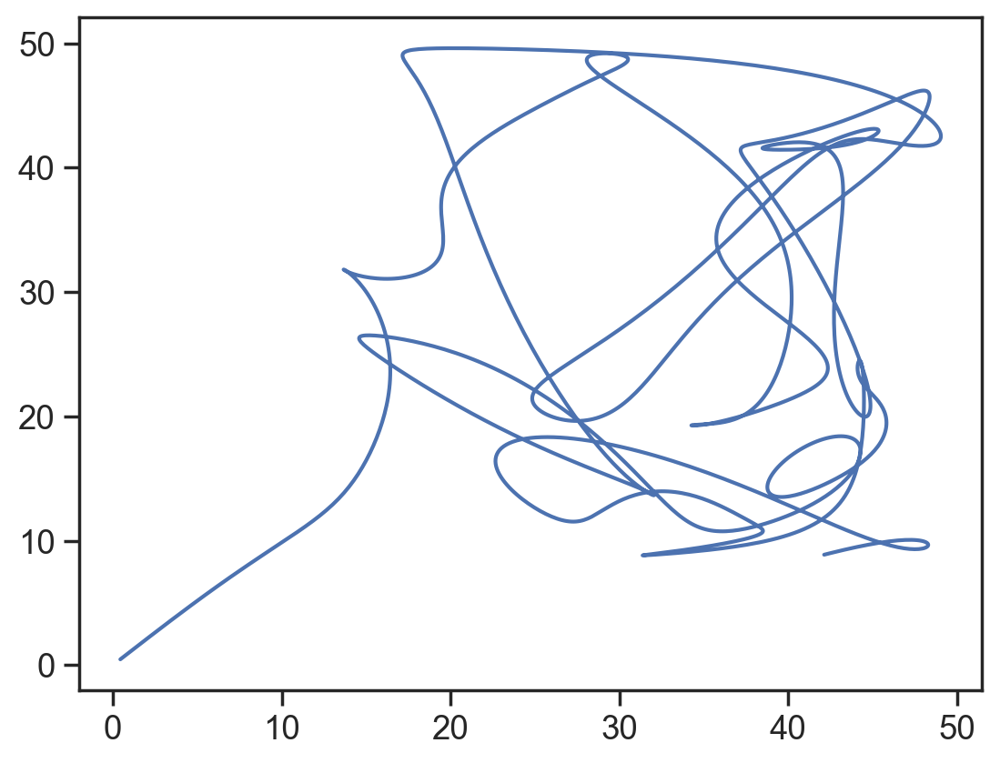

In [4834]:
plt.plot(all_poss[0,0,:2000, 0],all_poss[0,0,:2000, 1])

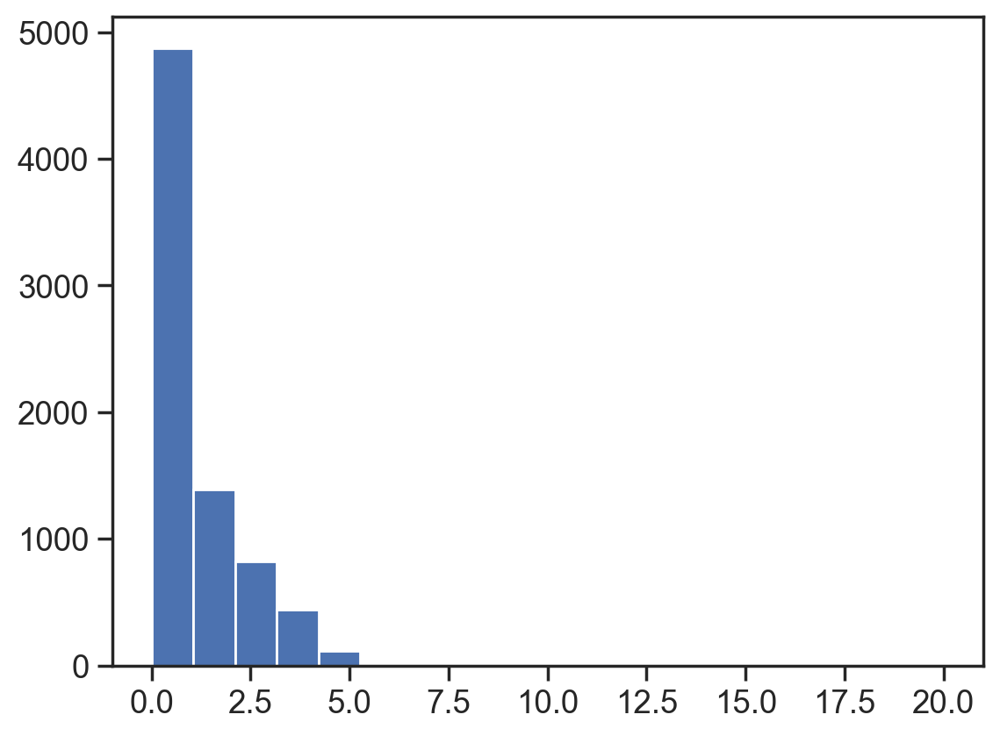

In [4835]:
h=plt.hist(all_A_ls[:,-1,:,:].reshape(-1), np.linspace(0.01,20,20))

In [4836]:
# post processing of experiment
n_bins = 25

# all_mean_maps = np.zeros((n_alphas, n_noisy_betas, n_l_str, N, n_bins, n_bins))
all_mean_maps = np.zeros((n_noisy_betas, n_l_str, N, n_bins, n_bins))

all_spikes = np.zeros((all_As.shape))
norm_factor = 10

for b in range(n_noisy_betas):
    
    for l in range(n_l_str):
    
        this_A = all_As[b,l]
        this_pos = all_poss[b,l]
        
        all_mean_maps[b,l] = calc_2d_maps(this_A, this_pos, n_bins)
        all_spikes[b,l] = calc_spikes(this_A, norm_factor)

# for a in range(n_alphas):
#     for b in range(n_noisy_betas):
#         for l in range(n_l_str):

#             this_A = all_As[a,b,l]
#             this_pos = all_poss[a,b,l]
            
#             all_mean_maps[a,b,l] = calc_2d_maps(this_A, this_pos, n_bins)
#             all_spikes[a,b,l] = calc_spikes(this_A, norm_factor)

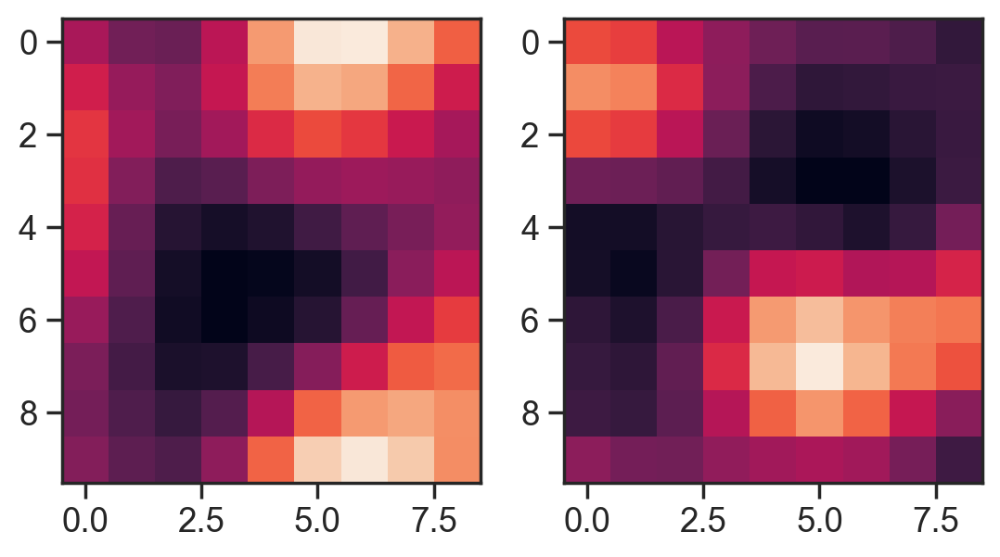

In [4837]:
distl = l_pos-all_poss[0,0,:,:]
distl=np.linalg.norm(distl,axis=-1)
close_to_l = np.where(distl<=l_lookahead)[0]

distn=np.array([8,8])-all_poss[0,0,:,:]
distn = np.linalg.norm(distn, axis=-1)
close_to_n = np.where(distn<=l_lookahead)[0]

b=1
l=1
plt.subplot(1,2,1)
plt.imshow(np.mean(all_As[b,l][close_to_l,:], axis=0).reshape(n_x,n_y))
plt.subplot(1,2,2)
plt.imshow(np.mean(all_As[b,l][close_to_n,:], axis=0).reshape(n_x,n_y))


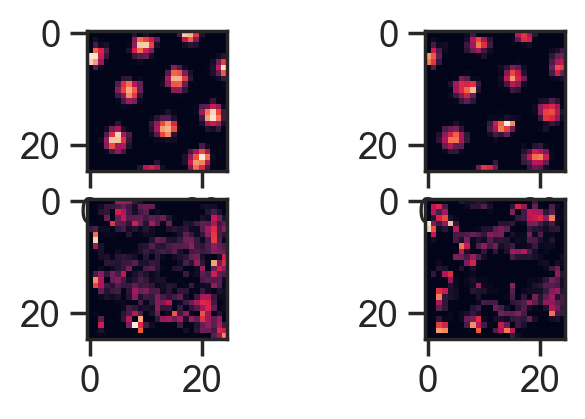

In [5240]:
# fields get clenaer with increased l_str
plt.figure(figsize=(n_l_str*2, n_noisy_betas))
cell_idx=49
for b in range(n_noisy_betas):
    
    for l in range(n_l_str):
        plt.subplot(n_noisy_betas, n_l_str, l+1 + b*n_l_str)
        plt.imshow(all_mean_maps[b,l, cell_idx])

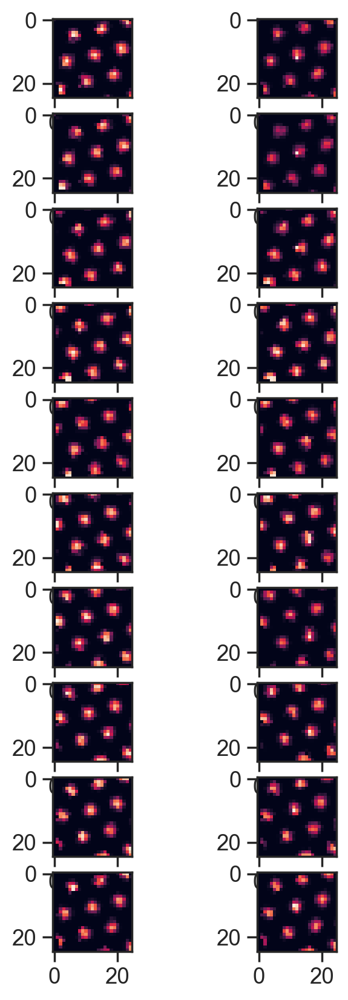

In [5242]:
# fields get clenaer with increased l_str
n_cells_plot = 10
b=0 # no noise
# b=1 # with noise
plt.figure(figsize=(n_l_str*2, n_cells_plot))
for c in range(n_cells_plot):
    cell_idx = c*9
    
    for l in range(n_l_str):
        plt.subplot(n_cells_plot, n_l_str, l+1 + c*n_l_str)
        plt.imshow(all_mean_maps[b,l, cell_idx])

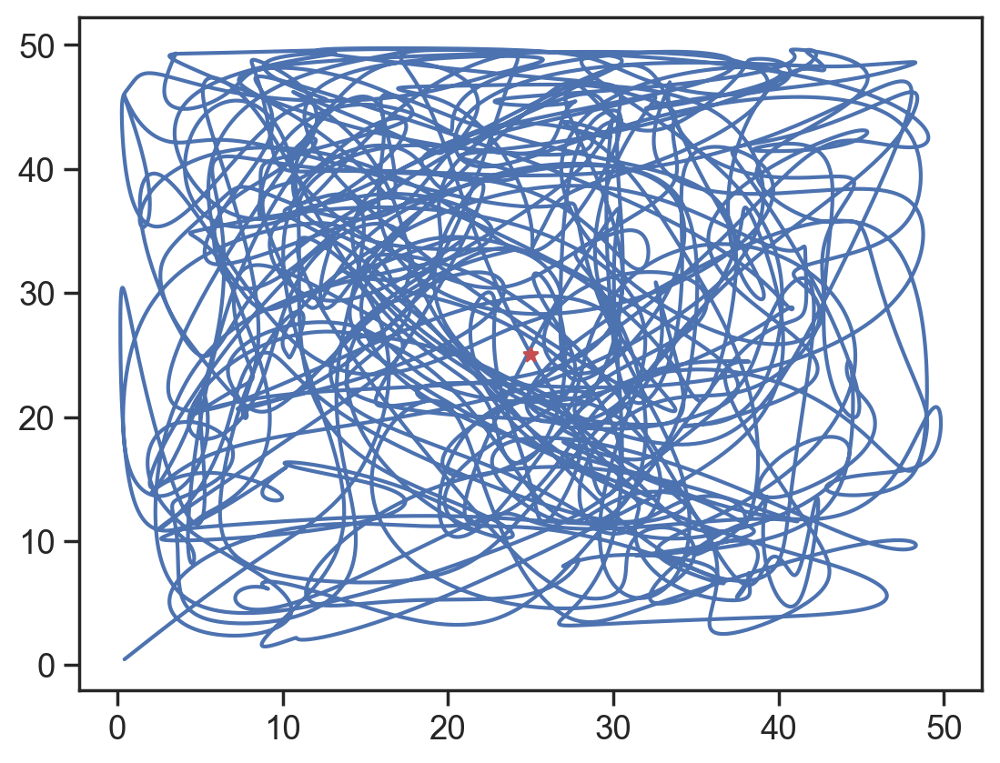

In [4826]:
plt.plot(all_poss[0,0,:,0], all_poss[0,0,:,1])
plt.plot(l_pos[0],l_pos[1],'r*')
# plt.plot(l_pos[:,0],l_pos[:,1],'r*')

## Run 2D Simulation of Novel Environments

In [8209]:
# appears that landmark pinning is good in cases where there's a lot of weight noise. 
# HD noise is not necessarily getting fixed by landmark input though. this could be because lm input is only performing a translational function
# if we had lm/HD conjunctive cells, that might help. but need to figure out how to incorporate into the model

In [ ]:
output_bins = 50000

# n_timebins=6000
velocity_gain = 1/5
velocity = velocity_gain* np.copy(vel2d)

bins_use = np.arange(0, 45000)
velocity = velocity[bins_use, :]

start_pos = pos_moving[0,:].astype(float)*velocity_gain
n_timebins = velocity.shape[0]
# l_pos = np.array([np.array([5,5]), np.array([45,45]), np.array([5, 45]), np.array([45, 5])])
# l_str = 0.5
n_warmup_bins = 100
B0 = np.zeros((N))
# alpha=0.05
beta = np.pi/6
tau = 0.9
T_sim = 0.04
# T_sim = 0.05
I=0.20
# I = 0.30
# sigma_sim=0.24
# sigma_sim=0.22 # given fixed I and T_sim, smaller sigma_sim leads to higher firing rates for the neurons that are active
# sigma_sim=0.20 # trying to make sigma_sim smaller to make things more noticeably different between phases. However, if it's too small, then attractor dynamics win over and prevent external inputs
sigma_sim = 0.26


# n_alphas = 2
# # all_alphas = np.linspace(0.05, 0.2, n_alphas)
# all_alphas = np.linspace(0.04, 0.07, n_alphas)
# alpha = 0.075
alpha=0.08
# alpha=0.1

# n_noisy_betas = 3
# all_beta_noises = np.linspace(0.05, 0.15, n_noisy_betas)
# all_beta_noises = np.array([0, 1])
# all_beta_noises = np.array([0, 0.2])
# all_beta_noises = np.array([0, np.pi/1024, np.pi/724, np.pi/512])
# all_beta_noises = np.array([np.pi/2048])
# n_noisy_betas = all_beta_noises.size

# all_l_str = np.array([0, 30, 60, 90])
# all_l_str = np.linspace(0,500,21)
# all_l_str = np.concatenate((np.array([0]), np.linspace(50, 100, 11), np.array([250, 500])))
all_l_str = np.concatenate((np.arange(0,90,10), np.arange(100,400,100)))

n_l_str = all_l_str.size

l_pos = []

# anchors = [25]
# for ai in range(len(anchors)):
#     i = anchors[ai]
#     l_pos.append(np.array([i, -35]))
#     l_pos.append(np.array([i, 84]))
#     l_pos.append(np.array([-35, i]))
#     l_pos.append(np.array([84, i]))

# l_lookahead = 43


anchors = [25]
for ai in range(len(anchors)):
    i = anchors[ai]
    l_pos.append(np.array([i, -115])) # no offset the north and south boundaries
    l_pos.append(np.array([i, 164])) # no offset the north and south boundaries
    l_pos.append(np.array([-115, i]))
    l_pos.append(np.array([164, i]))
l_lookahead = 122

l_pos = np.array(l_pos)
n_landmarks = l_pos.shape[0]

# weight_noise = I/4
# all_weight_noises = np.linspace(0, I/3, 4)
# all_weight_noises=np.concatenate((np.array([0]), np.linspace(I/6, I/4, 5)))
all_weight_noises=np.concatenate((np.array([0]), np.linspace(I/8, I/5, 4)))
n_weight_noises = all_weight_noises.size
n_noisy_betas = n_weight_noises

l_pinning_n = 5
l_use_nearby = True

# all_As = np.zeros((n_alphas, n_noisy_betas, n_l_str, n_timebins, N))
# all_A_ls = np.zeros((n_alphas, n_noisy_betas, n_l_str, n_timebins, 2))
# all_Ws = np.zeros((n_alphas, n_noisy_betas, n_l_str, n_timebins, N, N))
# all_poss = np.zeros((n_alphas, n_noisy_betas, n_l_str, n_timebins, 2))

# all_As = np.zeros((n_noisy_betas, n_l_str, n_timebins, N))
# all_Bs = np.zeros((n_noisy_betas, n_l_str, n_timebins, N))
# all_A_ls = np.zeros((n_noisy_betas, n_l_str, n_timebins, n_landmarks))
# all_Ws = np.zeros((n_noisy_betas, n_l_str, n_timebins, N, N))
# all_W_ls = np.zeros((n_noisy_betas, n_l_str, n_timebins, n_landmarks, N))
# all_poss = np.zeros((n_noisy_betas, n_l_str, n_timebins, 2))
# all_noisy_betas = np.zeros((n_noisy_betas, n_l_str, n_timebins))

all_As = np.zeros((n_weight_noises, n_l_str, n_timebins, N))
all_Bs = np.zeros((n_weight_noises, n_l_str, n_timebins, N))
all_A_ls = np.zeros((n_weight_noises, n_l_str, n_timebins, n_landmarks))
# all_Ws = np.zeros((n_weight_noises, n_l_str, n_timebins, N, N))
all_Ws = np.zeros((n_weight_noises, n_timebins, N, N)) # not affected by l_str

# all_W_ls = np.zeros((n_weight_noises, n_l_str, n_timebins, n_landmarks, N))
W_ls = np.zeros((n_landmarks, N)) # not affected by weight noise nor l_str since no hebbian plasticity

all_poss = np.zeros((n_weight_noises, n_l_str, n_timebins, 2))
all_noisy_betas = np.zeros((n_weight_noises, n_l_str, n_timebins))
first_noise_iteration = True

# the weight calculation is by the far the computationally most expensive operation
# don't need to calculate weight matrix each run, since it's dependent only on velocity, beta, and the weight noise.
# so, if the betas, velocities, and weight noises are the same between two runs, can use the same weight matrix
# the landmark weight matrix is the same as long as l_pos is the same between two runs and there's no hebbian plasticity

# precalculate the landmark weight matrix to be used across all runs
pre_v = np.ones((1, 2))
pre_n_timebins = 1
pre_n_warmup_bins = 0
(_, _, _, _, _, W_ls, _, _) = run_sim2d(pre_n_timebins, init_state, cell_position_diffs, 
                                        n_y, n_x, alpha, beta, I, sigma_sim, T_sim, tau, pre_v, start_pos, 
                                        track_length, l_pos, l_str, l_pinning_n, l_use_nearby, l_lookahead, 
                                        pre_n_warmup_bins, B0, beta_noise, weight_noise, 
                                        output_bins=output_bins)
W_ls = np.tile(W_ls, (n_timebins, 1, 1))


for b in range(n_weight_noises):# n_noisy_betas):
    # beta_noise = all_beta_noises[b]
    beta_noise = np.pi/2048
    weight_noise = all_weight_noises[b]

    for l in range(n_l_str):
        # l_pos = np.array(all_l_pos[l])
        print(f'starting b={b}, l={l}')
        l_str = all_l_str[l]

        if first_noise_iteration:
            (all_As[b,l], all_Bs[b,l], all_Ws[b],
             all_poss[b,l], all_A_ls[b,l], _,
             all_noisy_betas[b, l, :], _) = run_sim2d(n_timebins, init_state, cell_position_diffs, 
                                                      n_y, n_x, alpha, beta, I, sigma_sim, T_sim, tau, velocity, start_pos, 
                                                      track_length, l_pos, l_str, l_pinning_n, l_use_nearby, l_lookahead, 
                                                      n_warmup_bins, B0, beta_noise, weight_noise, W_input=None, W_l_input=W_ls,
                                                      output_bins=output_bins)
            first_noise_iteration = False

        else:
            W_input = all_Ws[b]
            
            (all_As[b,l], all_Bs[b,l], _,
             all_poss[b,l], all_A_ls[b,l], _,
             all_noisy_betas[b, l, :], _) = run_sim2d(n_timebins, init_state, cell_position_diffs, 
                                                      n_y, n_x, alpha, beta, I, sigma_sim, T_sim, tau, velocity, start_pos, 
                                                      track_length, l_pos, l_str, l_pinning_n, l_use_nearby, l_lookahead, 
                                                      n_warmup_bins, B0, beta_noise, weight_noise, W_input=W_input, W_l_input=W_ls,
                                                      output_bins=output_bins)

    first_noise_iteration = True

# for a in range(n_alphas):
#     for b in range(n_noisy_betas):
#         for l in range(n_l_str):

#             this_A = all_As[a,b,l]
#             this_pos = all_poss[a,b,l]
            
#             all_mean_maps[a,b,l] = calc_2d_maps(this_A, this_pos, n_bins)
#             all_spikes[a,b,l] = calc_spikes(this_A, norm_factor)


In [9905]:
# del (all_As, all_Bs, all_Ws)

In [9906]:
# might there be a way to do this based on heading direction and landmarks?
# could potentially implement the velocity tuning effects using a separate population of velocity-encoding neurons

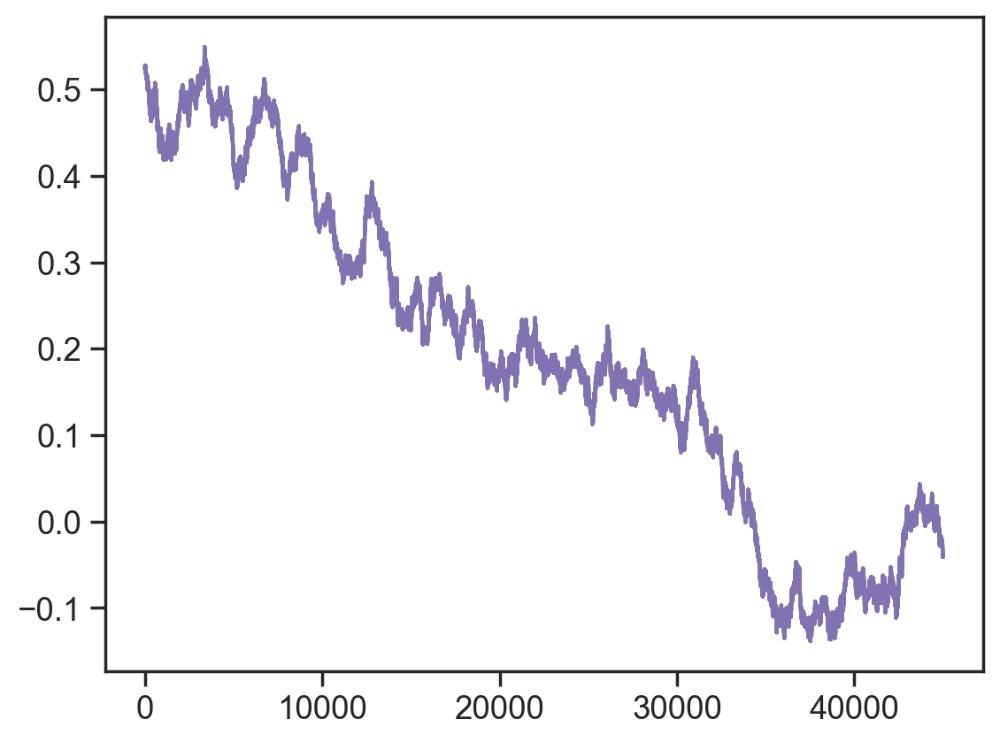

In [9907]:
l=0
for b in np.arange(0,n_noisy_betas):
    plt.plot(all_noisy_betas[b, l, :])

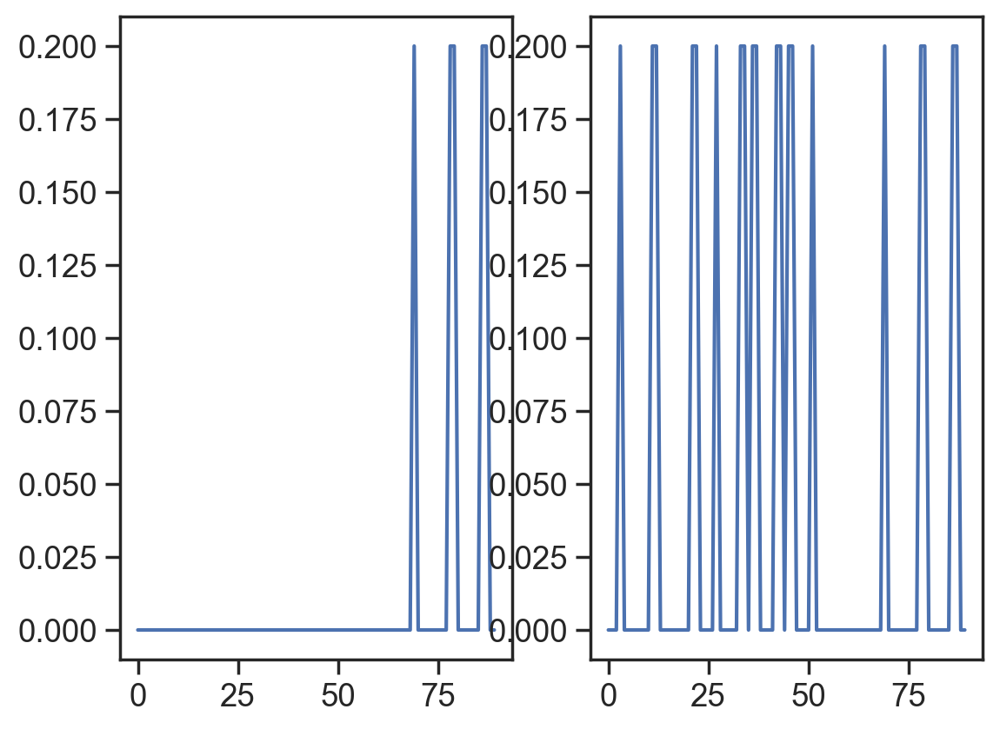

In [9908]:
b=0
l_light = 1
lm_idx = 2
timebin=0

# plt.subplot(121)
# plt.plot(all_W_ls[b, l_light, timebin, lm_idx, :])
# plt.subplot(122)
# plt.plot(np.sum(all_W_ls[b, l_light, timebin, :, :], axis=0))

plt.subplot(121)
plt.plot(W_ls[timebin, lm_idx, :])
plt.subplot(122)
plt.plot(np.sum(W_ls[timebin, :, :], axis=0))

In [9909]:
timebin=0

lm_pinning = np.zeros((n_noisy_betas, n_l_str, n_landmarks, l_pinning_n))

for b in range(n_noisy_betas):    
    for l in range(n_l_str):    
        for lm_idx in range(n_landmarks):
            lm_pinning[b,l,lm_idx,:] = np.where(W_ls[timebin, lm_idx, :] > 0)[0]

            # lm_pinning[b,l,lm_idx,:] = np.where(all_W_ls[b, l, timebin, lm_idx, :] > 0)[0]

# lm0_pinning = np.where(all_W_ls[b, l_light, timebin, 0, :] > 0)[0]
# lm1_pinning = np.where(all_W_ls[b, l_light, timebin, 1, :] > 0)[0]
# lm2_pinning = np.where(all_W_ls[b, l_light, timebin, 2, :] > 0)[0]
# lm3_pinning = np.where(all_W_ls[b, l_light, timebin, 3, :] > 0)[0]

print(lm_pinning[0,0,:,:])
# print(lm0_pinning, lm1_pinning, lm2_pinning, lm3_pinning)

[[33. 34. 42. 43. 51.]
 [ 3. 11. 12. 21. 22.]
 [69. 78. 79. 86. 87.]
 [27. 36. 37. 45. 46.]]


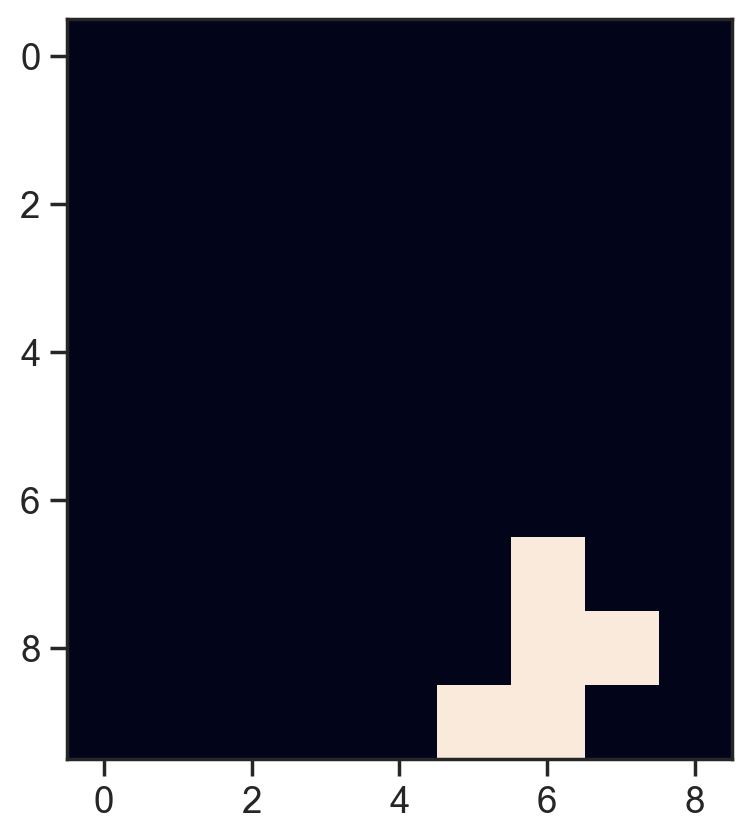

In [9910]:
A_test = np.zeros((N,))
lm_pinning_cells = lm_pinning[0, -1, 2, :]
for i in range(lm_pinning_cells.size):
    this_cell = int(lm_pinning_cells[i])
    A_test[this_cell] = 1

plt.imshow(A_test.reshape(n_x, n_y))

In [9911]:
# post processing of experiment
n_bins = 20

# all_mean_maps = np.zeros((n_alphas, n_noisy_betas, n_l_str, N, n_bins, n_bins))
all_mean_maps = np.zeros((n_noisy_betas, n_l_str, N, n_bins, n_bins))
all_mean_lmaps = np.zeros((n_noisy_betas, n_l_str, n_landmarks, n_bins, n_bins))

all_spikes = np.zeros((all_As.shape))
all_lspikes = np.zeros((all_A_ls.shape))

norm_factor = 10

for b in range(n_noisy_betas):
    
    for l in range(n_l_str):
    
        this_A = all_As[b,l]
        this_A_l = all_A_ls[b,l]        

        this_pos = all_poss[b,l]
        
        all_mean_maps[b,l] = calc_2d_maps(this_A, this_pos, n_bins)
        all_spikes[b,l] = calc_spikes(this_A, norm_factor)
    
        all_mean_lmaps[b,l] = calc_2d_maps(this_A_l, this_pos, n_bins)
        all_lspikes[b,l] = calc_spikes(this_A_l, norm_factor)

In [9912]:
# post processing of experiment
n_bins = 20

idxs_use = np.array([0, int(n_timebins//3), int(2*n_timebins//3), n_timebins])
n_parts = idxs_use.size-1
all_mean_partial_maps = np.zeros((n_parts, n_noisy_betas, n_l_str, N, n_bins, n_bins))

for b in range(n_noisy_betas):
    for l in range(n_l_str):
        for idx in range(n_parts):
            this_A = all_As[b,l,idxs_use[idx]:idxs_use[idx+1]]
            this_pos = all_poss[b,l, idxs_use[idx]:idxs_use[idx+1]]
            all_mean_partial_maps[idx,b,l] = calc_2d_maps(this_A, this_pos, n_bins)

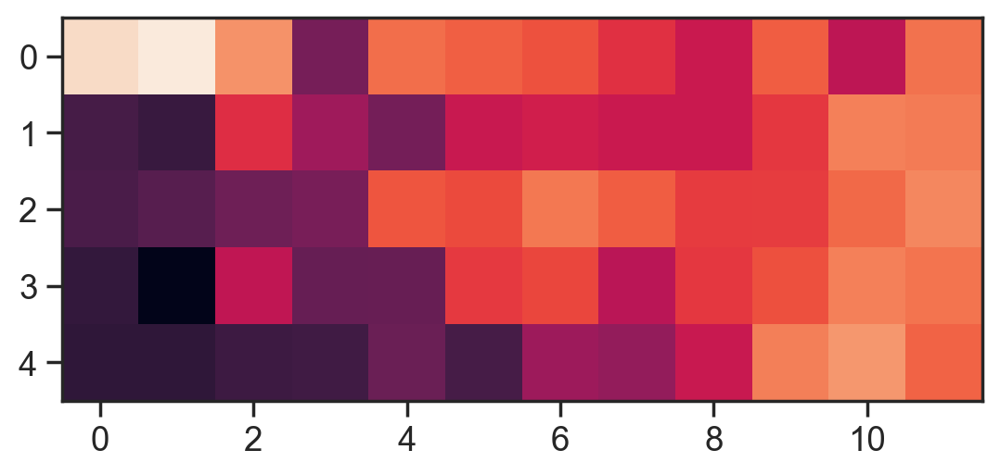

In [9913]:
stability = np.zeros((n_parts, n_parts, n_noisy_betas, n_l_str, N))

for b in range(n_noisy_betas):
    for l in range(n_l_str):
        for i in range(n_parts):
            map0=all_mean_partial_maps[i,b,l,:,:].reshape(-1)
            for j in range(n_parts):
                map1=all_mean_partial_maps[j,b,l,:,:].reshape(-1)
                stability[i,j,b,l]=np.corrcoef(map0,map1)[0,1]

# use only the comparisons that don't use the same data and don't double count
stability_use = []
for i in range(n_parts):
    for j in range(n_parts):
        if (i<j):
            stability_use.append(stability[i, j])

stability_use = np.stack(stability_use)
mean_stability = np.mean(stability_use, axis=0)
plt.imshow(np.mean(mean_stability, axis=-1))

In [9914]:
mean_stability.shape

(5, 12, 90)

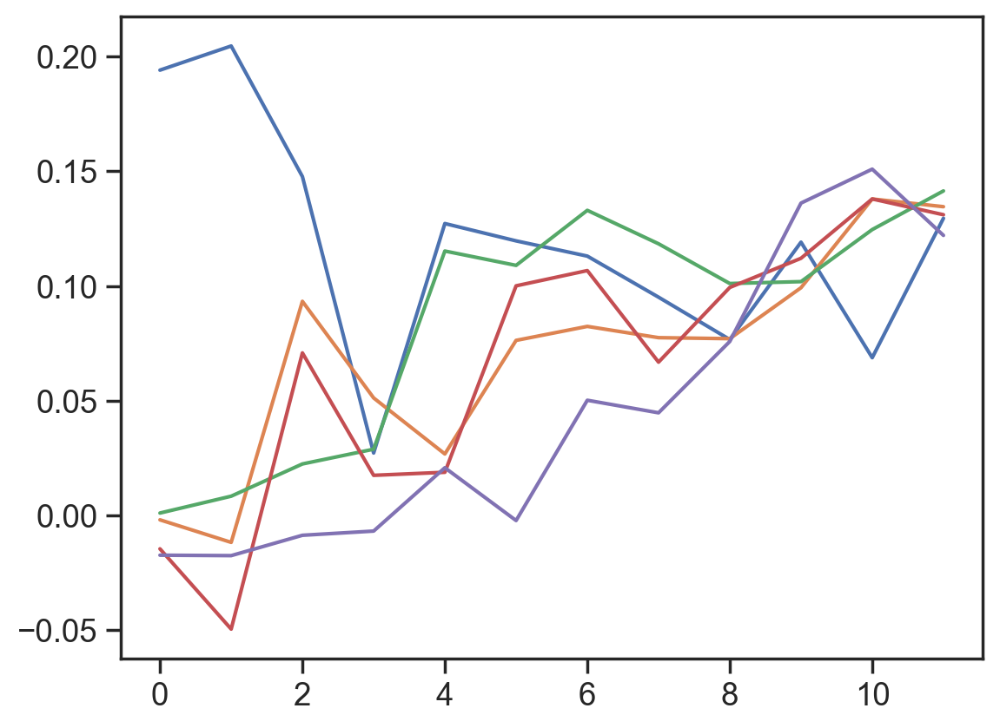

In [9915]:
for i in range(mean_stability.shape[0]):
    # plt.plot(np.mean(mean_stability[i, :, :] - mean_stability[i, 0, :], axis=-1))
    plt.plot(np.mean(mean_stability[i, :, :], axis=-1))

In [9916]:
n_spatial_bins = all_mean_maps.shape[-1]
sacs = np.zeros((n_noisy_betas, n_l_str, N, n_spatial_bins*2-1, n_spatial_bins*2-1))
for b in range(n_noisy_betas):
    for l in range(n_l_str):
        for c in range(N):
            sacs[b,l,c] = correlate2d(all_mean_maps[b,l,c], all_mean_maps[b,l,c])

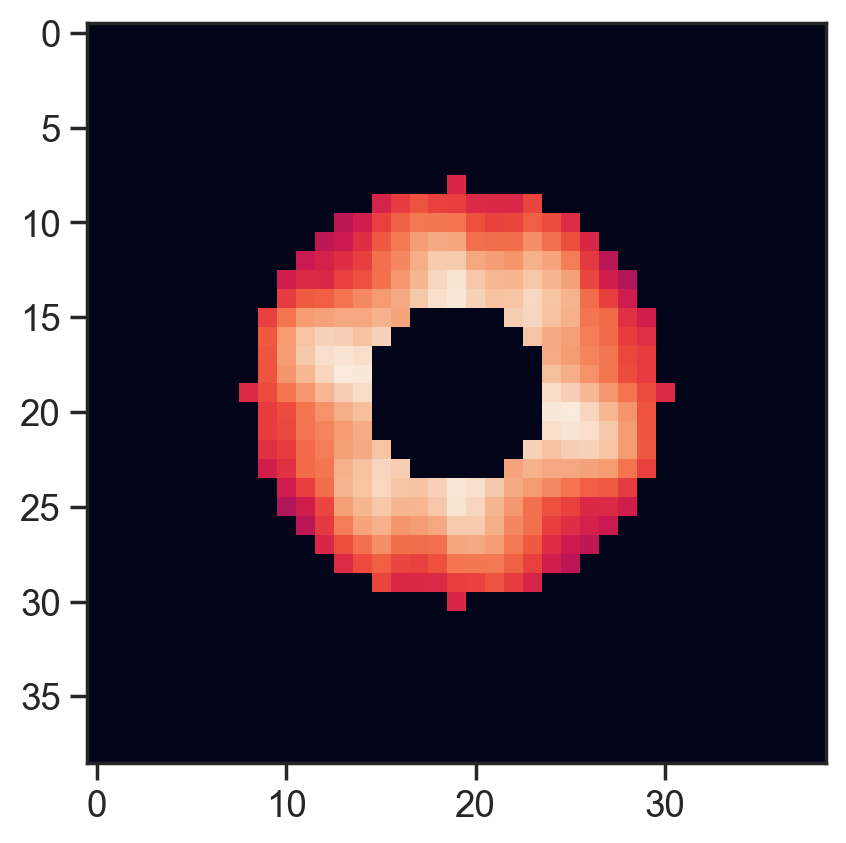

In [10027]:
mask = np.ones(sacs.shape)

inner_rad = 5
outer_rad = 11

dist_from_center = np.zeros((2, mask.shape[-1], mask.shape[-1]))
dist_from_center[0] = np.arange(-mask.shape[-1]//2+1, mask.shape[-1]//2+1)
dist_from_center[1] = np.arange(-mask.shape[-1]//2+1, mask.shape[-1]//2+1)
dist_from_center[1] = dist_from_center[1].T

dist_from_center = np.linalg.norm(dist_from_center, axis=0)

idxs_out_inner0 = np.where(dist_from_center<inner_rad)[0]
idxs_out_inner1 = np.where(dist_from_center<inner_rad)[1]
idxs_out_outer0 = np.where(dist_from_center>outer_rad)[0]
idxs_out_outer1 = np.where(dist_from_center>outer_rad)[1]

mask[:,:,:, idxs_out_inner0, idxs_out_inner1] = 0
mask[:,:,:, idxs_out_outer0, idxs_out_outer1] = 0

masked_sacs = sacs * mask

plt.imshow(masked_sacs[2,3,0])

In [10028]:
test_sac = np.copy(masked_sacs[0,0,0])
test_rot_sac = np.copy(rotated_masked_sacs[0,0,0,0])

test_sac[np.where(dist_from_center<inner_rad)[0], np.where(dist_from_center<inner_rad)[1]] = np.nan
test_sac[np.where(dist_from_center>outer_rad)[0], np.where(dist_from_center>outer_rad)[1]] = np.nan
test_rot_sac[np.where(dist_from_center<inner_rad)[0], np.where(dist_from_center<inner_rad)[1]] = np.nan
test_rot_sac[np.where(dist_from_center>outer_rad)[0], np.where(dist_from_center>outer_rad)[1]] = np.nan

a = ma.corrcoef(ma.masked_invalid(test_sac.reshape(-1)), ma.masked_invalid(test_rot_sac.reshape(-1)))
a

masked_array(
  data=[[1.0, 0.8036853068110283],
        [0.8036853068110283, 1.0]],
  mask=[[False, False],
        [False, False]],
  fill_value=1e+20)

In [10029]:
rotations = np.array([60, 120, 30, 90, 150]) # first two are grid angles, the last three are anti-grid
n_rotations = rotations.size
rotated_masked_sacs = np.zeros((n_rotations, 
                                masked_sacs.shape[0], masked_sacs.shape[1], masked_sacs.shape[2], 
                                masked_sacs.shape[3], masked_sacs.shape[4]))
cross_sxcs = np.zeros((n_rotations, masked_sacs.shape[0], masked_sacs.shape[1], masked_sacs.shape[2]))

for r in range(n_rotations):
    this_rotation = rotations[r]
    for b in range(n_noisy_betas):
        for l in range(n_l_str):
            for c in range(N):
                # first rotate, and then set nans. the rotation doesn't seem to work with the nans in place
                this_masked_sac = np.copy(masked_sacs[b,l,c])
                rotated_masked_sacs[r,b,l,c,:,:] = rotate(this_masked_sac, this_rotation, reshape=False)
                this_rotated_masked_sac = np.copy(rotated_masked_sacs[r,b,l,c,:,:])

                this_masked_sac[idxs_out_inner0, idxs_out_inner1] = np.nan
                this_masked_sac[idxs_out_outer0, idxs_out_outer1] = np.nan
                this_rotated_masked_sac[idxs_out_inner0, idxs_out_inner1] = np.nan
                this_rotated_masked_sac[idxs_out_outer0, idxs_out_outer1] = np.nan

                cross_sxcs[r,b,l,c] = ma.corrcoef(ma.masked_invalid(this_masked_sac.reshape(-1)), 
                                                  ma.masked_invalid(this_rotated_masked_sac.reshape(-1)))[0,1]
                # cross_sxcs[r,b,l,c] = np.corrcoef(this_masked_sac.reshape(-1), rotated_masked_sacs[r,b,l,c].reshape(-1))[0,1]

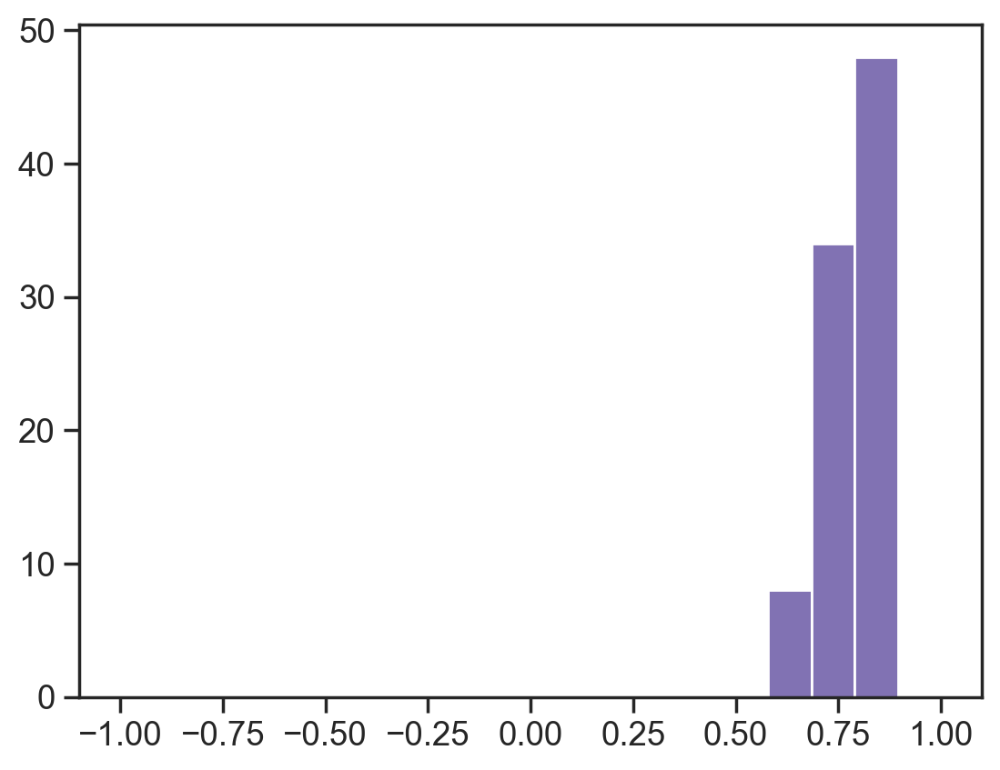

In [10030]:
for i in range(5):
    plt.hist(cross_sxcs[1,0,0], np.linspace(-1,1,20))

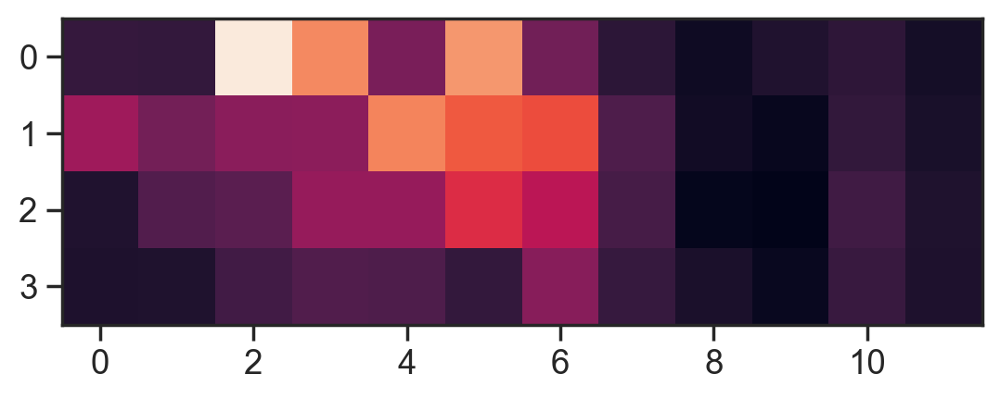

In [10031]:
min_vals = np.min(cross_sxcs[0:2], axis=0)
max_vals = np.max(cross_sxcs[2:], axis=0)
# min_vals = np.nanmean(cross_sxcs[0:2], axis=0)
# max_vals = np.nanmean(cross_sxcs[2:], axis=0)
grid_scores = min_vals - max_vals

plt.imshow(np.mean(grid_scores[1:], axis=-1))

In [10032]:
mean_grid_scores = np.mean(grid_scores, axis=-1)
std_grid_scores = np.std(grid_scores, axis=-1)
# sem_grid_scores = np.std(grid_scores, axis=-1) / np.sqrt(grid_scores.shape[-1])

Text(0, 0.5, 'grid score')

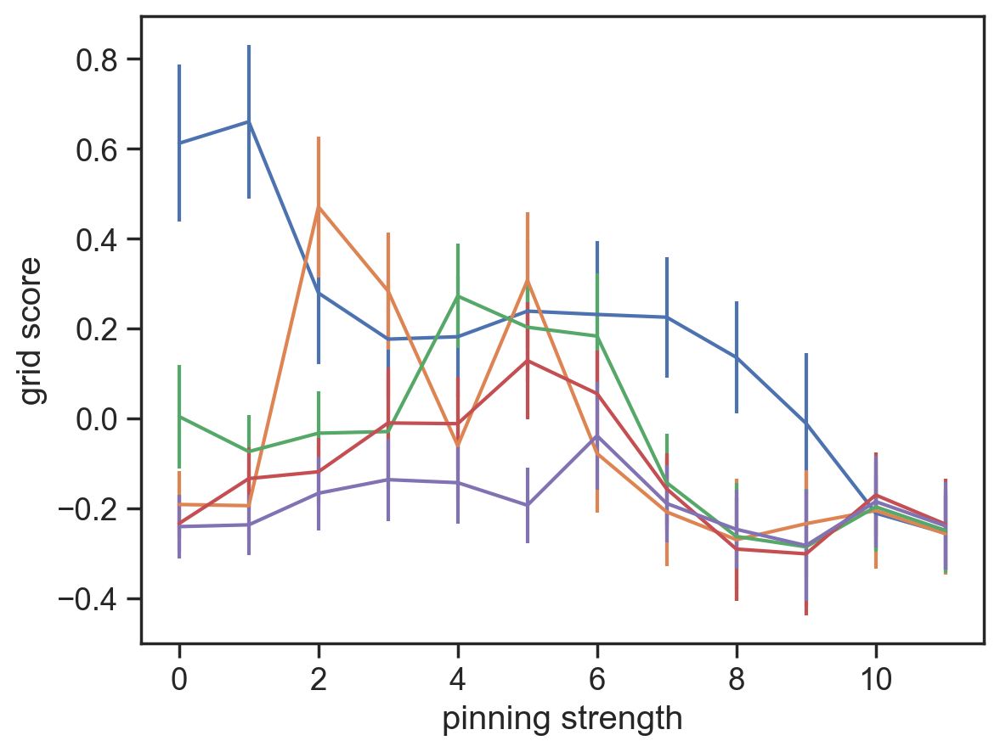

In [10033]:
for b in range(n_noisy_betas):
    # plt.plot(mean_grid_scores[b])
    plt.errorbar(np.arange(mean_grid_scores[b].shape[0]), mean_grid_scores[b], yerr=std_grid_scores[b])
    
plt.xlabel('pinning strength')
plt.ylabel('grid score')

Text(0, 0.5, 'change in grid score')

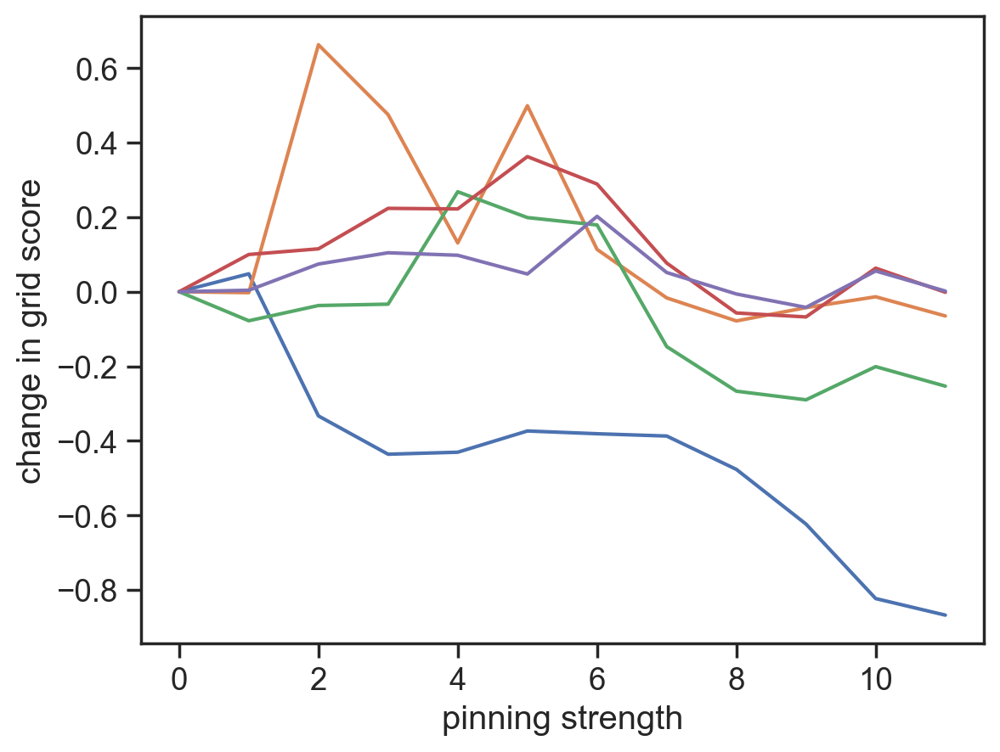

In [10034]:
for b in range(n_noisy_betas):
    plt.plot(mean_grid_scores[b,:] - mean_grid_scores[b,0])
    # plt.plot(np.mean(grid_scores[b, :, :], axis=-1) - np.mean(grid_scores[b, 0, :], axis=-1))
    
plt.xlabel('pinning strength')
plt.ylabel('change in grid score')

In [10035]:
rotated_masked_sacs.shape

(5, 5, 12, 90, 39, 39)

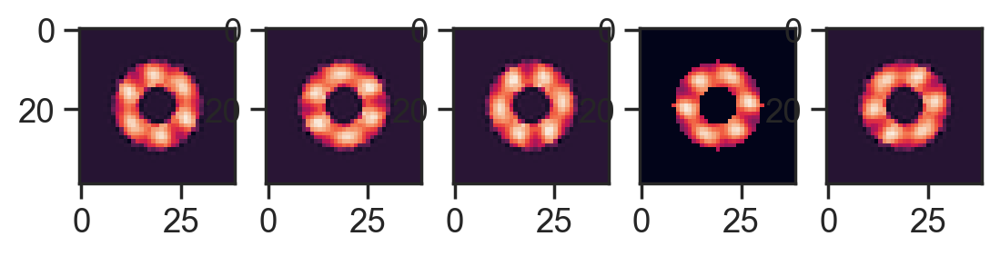

In [10036]:
for r in range(n_rotations):
    plt.subplot(1, n_rotations, r+1)
    plt.imshow(rotated_masked_sacs[r,0,0,0])

In [10037]:
# a = np.zeros((20))
# a[10]=1
# a[9]=0.5
# b = np.copy(a)
# b[9]=0.25

# print(np.corrcoef(a,b))

# abig = np.zeros((40))
# abig[20]=1
# abig[19]=0.5
# bbig =np.copy(abig)
# bbig[19]=0.25

# print(np.corrcoef(abig,bbig))

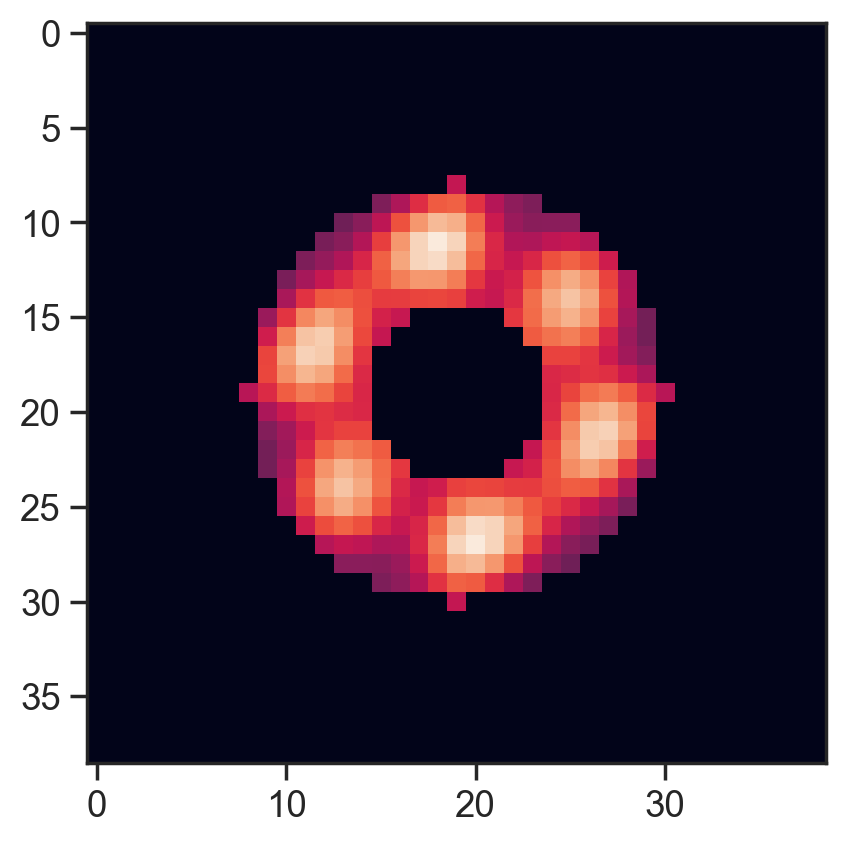

In [10043]:
plt.imshow(mean_masked_sacs[0,0])

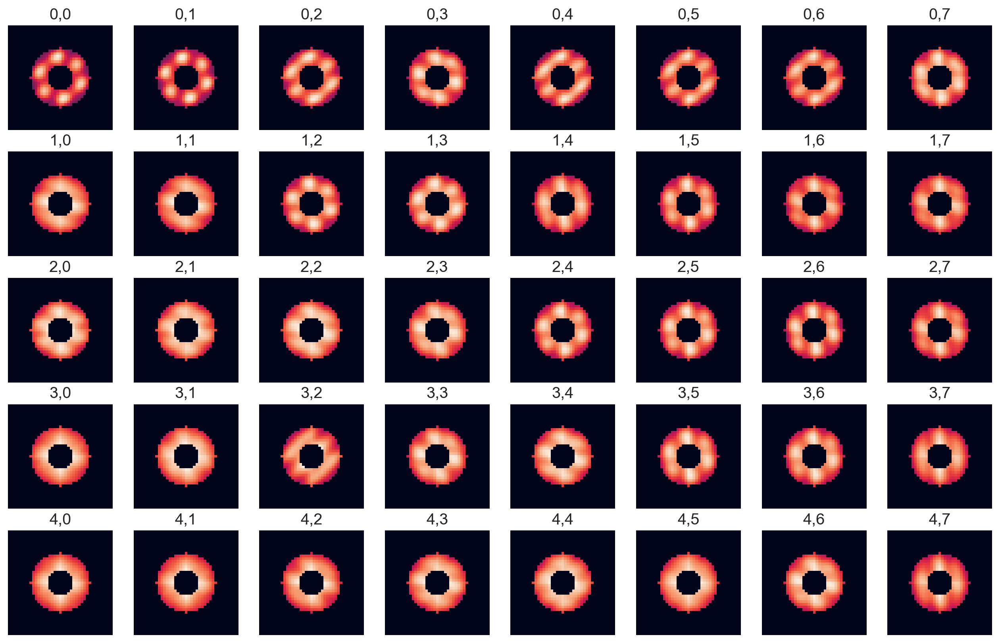

In [10044]:
mean_masked_sacs = np.mean(masked_sacs, axis=2)
n_ls_plot = 8
plt.figure(figsize=(2*n_ls_plot, 2*n_noisy_betas))
             
for b in range(n_noisy_betas):
    for l in range(n_ls_plot):
        plt.subplot(n_noisy_betas, n_ls_plot, b*n_ls_plot+l+1)
        plt.imshow(mean_masked_sacs[b,l])
        plt.title(f'{b},{l}')
        plt.axis('off')


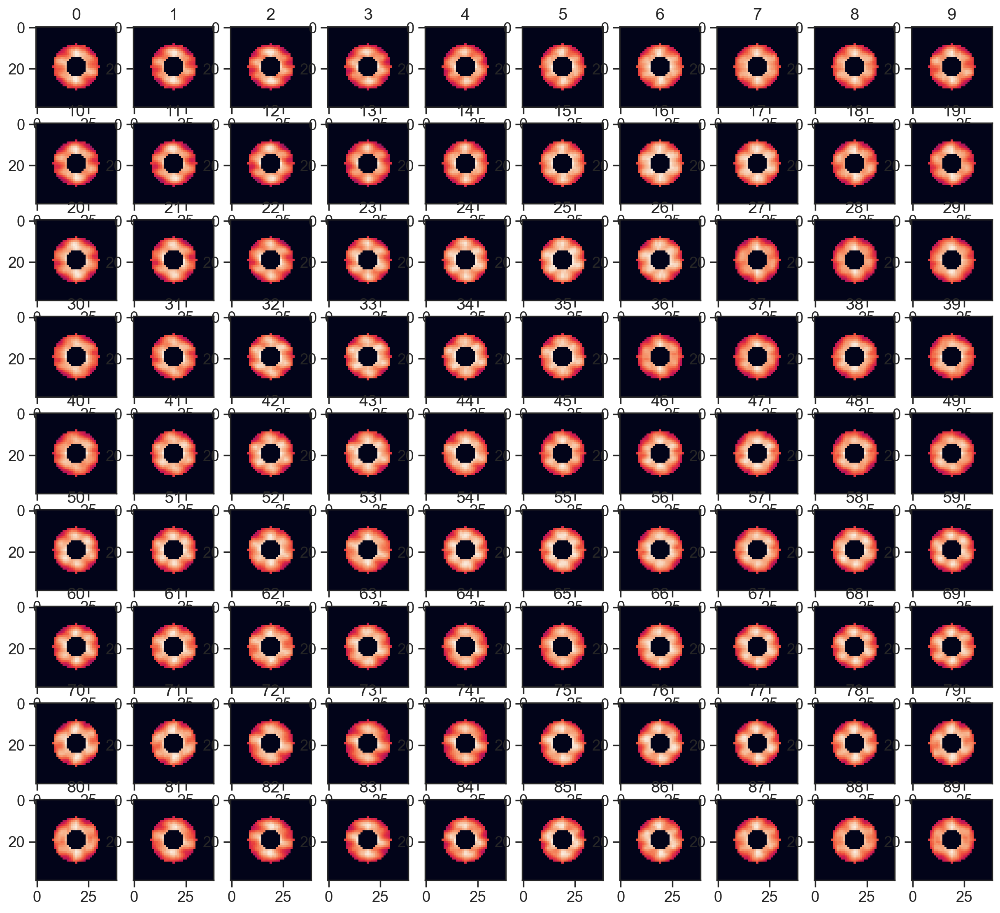

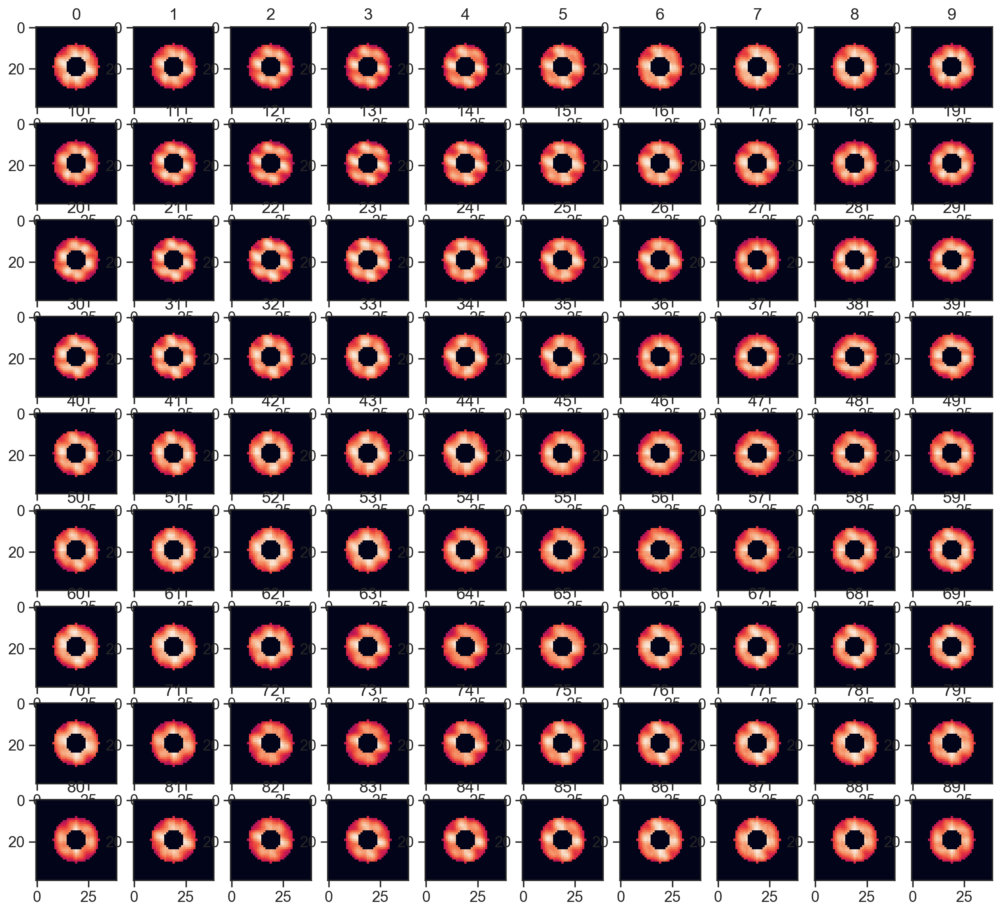

In [10045]:
b=2
l0=0
l1=3

n_rows = int(np.ceil(np.sqrt(N)))
plt.figure(figsize=(1.5*n_rows, 1.5*n_rows))
             
for c in range(N):
    plt.subplot(n_rows, n_rows, c+1)
    plt.imshow(masked_sacs[b,l0,c])
    plt.title(f'{c}')

plt.figure(figsize=(1.5*n_rows, 1.5*n_rows))
for c in range(N):
    plt.subplot(n_rows, n_rows, c+1)
    plt.imshow(masked_sacs[b,l1,c])
    plt.title(f'{c}')

In [10041]:
# pickle_bool = True

# if pickle_bool:
#     filename = 'D:/Code/bump_video/sim/2d/dark_vs_lm.pkl'
    
#     data_dict = {"all_As":all_As,
#                  "all_Ws":all_Ws,
#                  "all_A_ls":all_A_ls,
#                  "all_poss":all_poss,
#                  "all_mean_maps":all_mean_maps,
#                  "all_spikes":all_spikes,
#                  "all_mean_lmaps":all_mean_lmaps,
#                  "all_lspikes":all_lspikes,
#                  "alpha":alpha,
#                  "beta":beta,
#                  "all_beta_noises":all_beta_noises,
#                  "l_pos":l_pos,
#                  "all_l_str":all_l_str,
#                  "l_lookahead":l_lookahead,
#                  "l_pinning_n":l_pinning_n,
#                  "velocity":velocity,
#                  "n_timebins":n_timebins,
#                  "init_state":init_state,
#                  "cell_position_diffs":cell_position_diffs,
#                  "n_y":n_y, "n_x":n_x, "I":I,
#                  "sigma_sim":sigma_sim, "T_sim":T_sim, "tau":tau, "velocity_gain":velocity_gain,
#                  "weight_noise":weight_noise,
#                  "n_warmup_bins":n_warmup_bins
#                  }
    
#     with open(filename, 'wb') as file:
#         pickle.dump(data_dict, file)

#     file.close()
    
#     # with open(filename, 'rb') as file:
#     #   data = pickle.load(file)


(-128.95, 177.95, -128.95, 177.95)

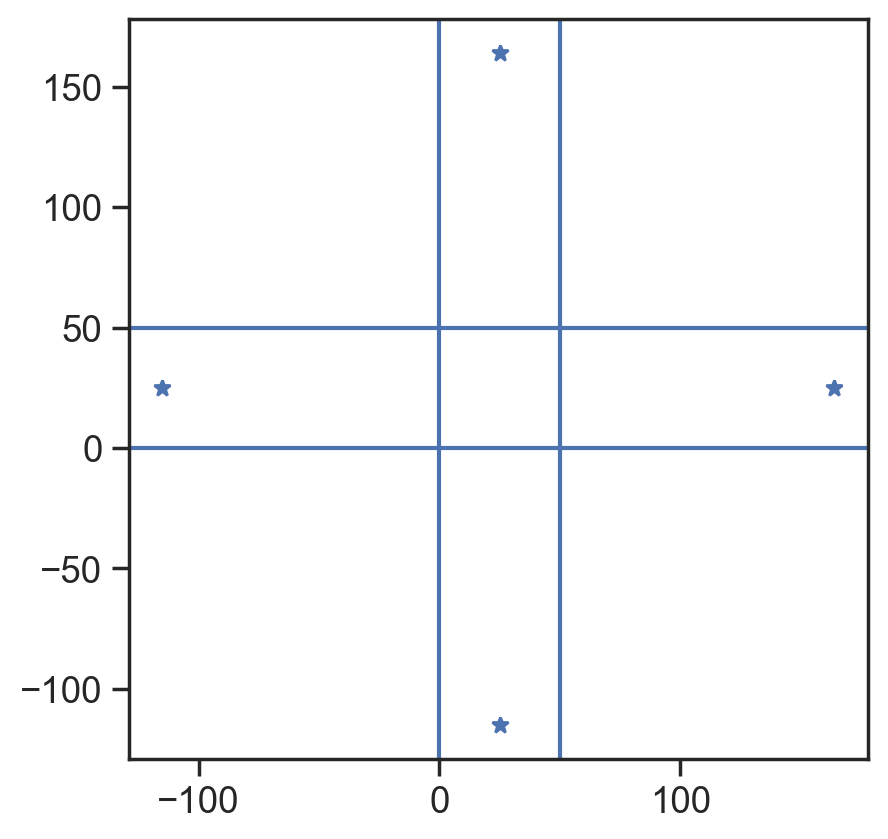

In [10042]:
plt.plot(l_pos[:, 0], l_pos[:, 1], '*')
plt.axvline(0)
plt.axvline(50)
plt.axhline(0)
plt.axhline(50)
plt.axis('square')

In [10023]:
l_pos

array([[  25, -115],
       [  25,  164],
       [-115,   25],
       [ 164,   25]])

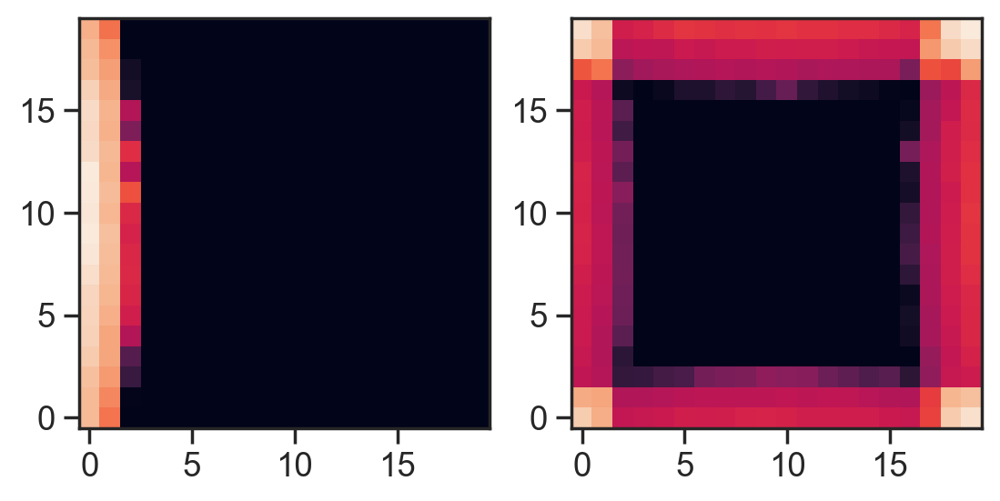

In [10024]:
lm_idx = 2
plt.subplot(121)
plt.imshow(all_mean_lmaps[0,1,lm_idx,:,:], origin='lower')
plt.subplot(122)
plt.imshow(np.sum(all_mean_lmaps[0,1,:,:,:], axis=0), origin='lower')

In [10025]:
noisy_rotation = np.moveaxis(calc_rot_mat(all_noisy_betas[-1,0,:]-beta), 2, 0)
noisy_rotation2 = np.moveaxis(calc_rot_mat(all_noisy_betas[0,0,:]-beta), 2, 0)

noisy_velocity = np.zeros((noisy_rotation.shape[:2]))
noisy_velocity2 = np.zeros((noisy_rotation.shape[:2]))

for t in range(noisy_rotation.shape[0]):
    noisy_velocity[t,:] = noisy_rotation[t,:,:] @ velocity[t]
    noisy_velocity2[t,:] = (noisy_rotation2[t,:,:]) @ velocity[t]

noisy_pos = start_pos + np.cumsum(noisy_velocity, axis=0)
noisy_pos2 = start_pos + np.cumsum(noisy_velocity2, axis=0)


Text(0.5, 1.0, 'diff in brain paths')

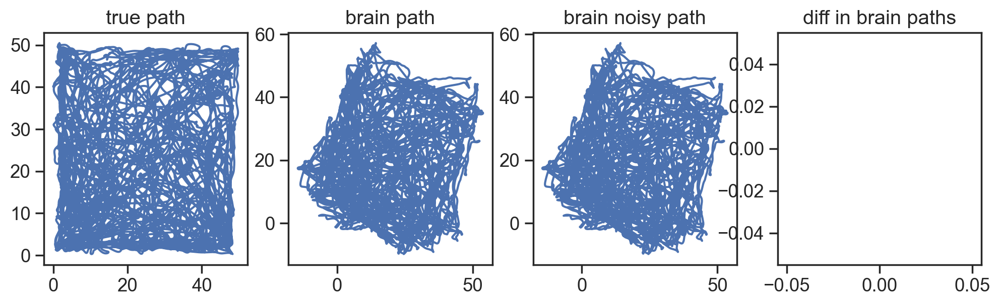

In [10026]:
plt.figure(figsize=(12,3))
plt.subplot(141)
plt.plot(all_poss[0,0,:,0],all_poss[0,0,:,1])
plt.title('true path')

plt.subplot(142)
plt.plot(noisy_pos2[:,0], noisy_pos2[:,1])
plt.title('brain path')

plt.subplot(143)
plt.plot(noisy_pos[:,0], noisy_pos[:,1])
plt.title('brain noisy path')

plt.subplot(144)
plt.plot(noisy_pos[:,0]-noisy_pos2[:,0], noisy_pos[:,1]-noisy_pos2[:,1])
plt.title('diff in brain paths')


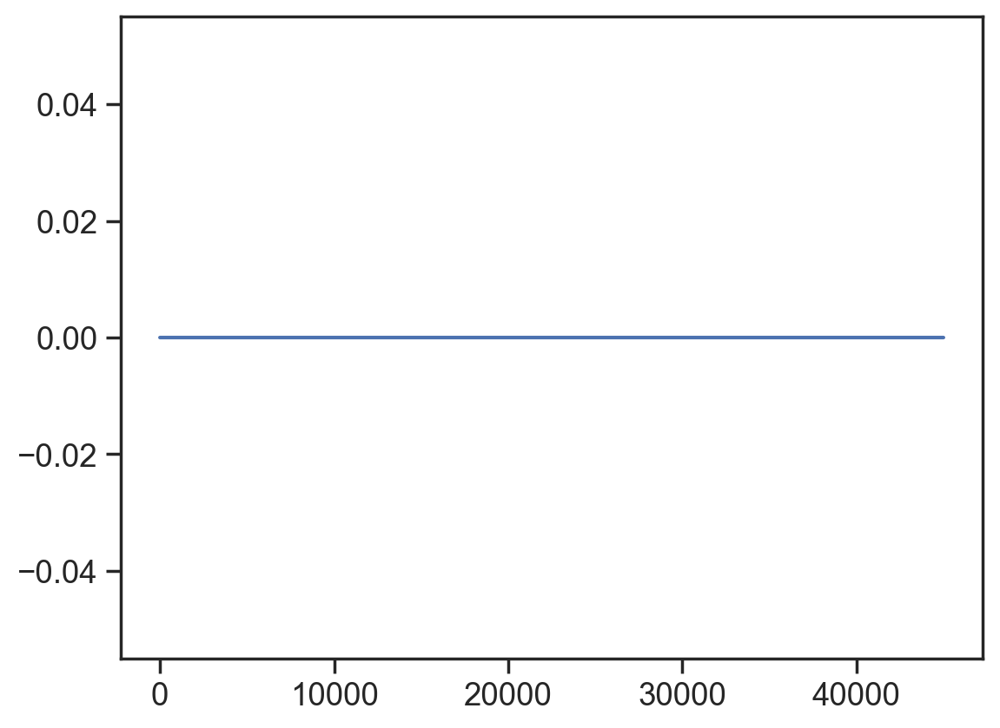

In [9935]:
diff_in_pos = np.linalg.norm(noisy_pos - noisy_pos2, axis=-1)
plt.plot(diff_in_pos)

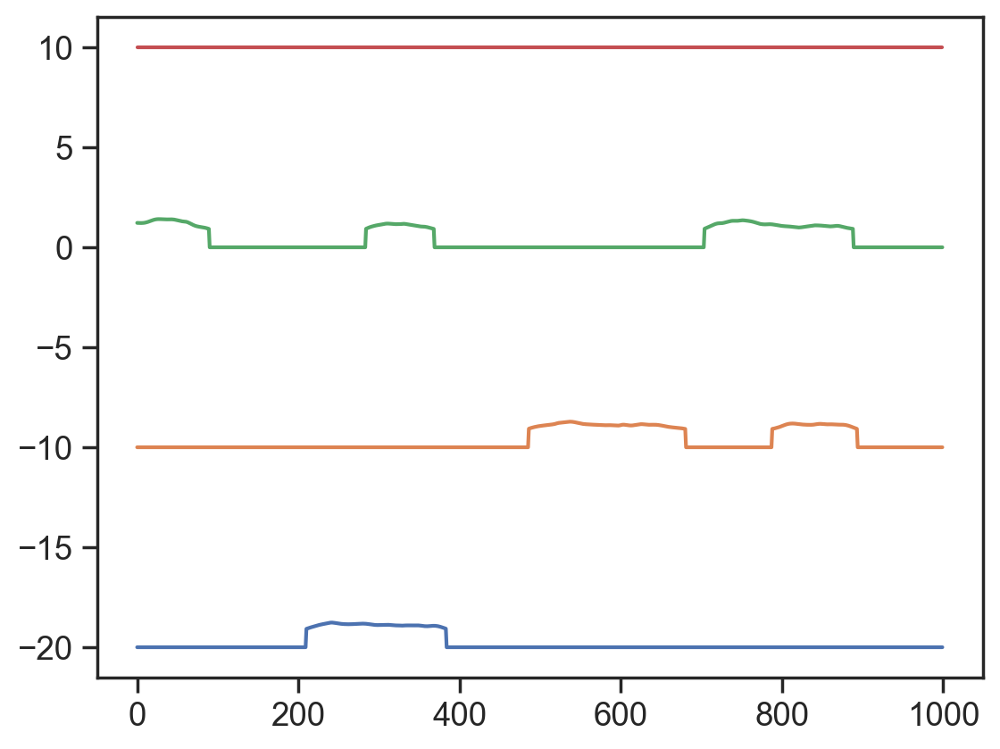

In [9936]:
# plt.plot(np.sum(l_pinning_n*all_A_ls[0,1,:,:], axis=-1))
b=1
l=1
bins_plot = np.arange(0,1000)
plt.plot(l_pinning_n*all_A_ls[b,l,bins_plot,0]-20)
plt.plot(l_pinning_n*all_A_ls[b,l,bins_plot,1]-10)
plt.plot(l_pinning_n*all_A_ls[b,l,bins_plot,2])
plt.plot(l_pinning_n*all_A_ls[b,l,bins_plot,3]+10)

# plt.plot(all_As[b,l,bins_plot,69]+20)

Text(0.5, 1.0, 'with lm - no lm')

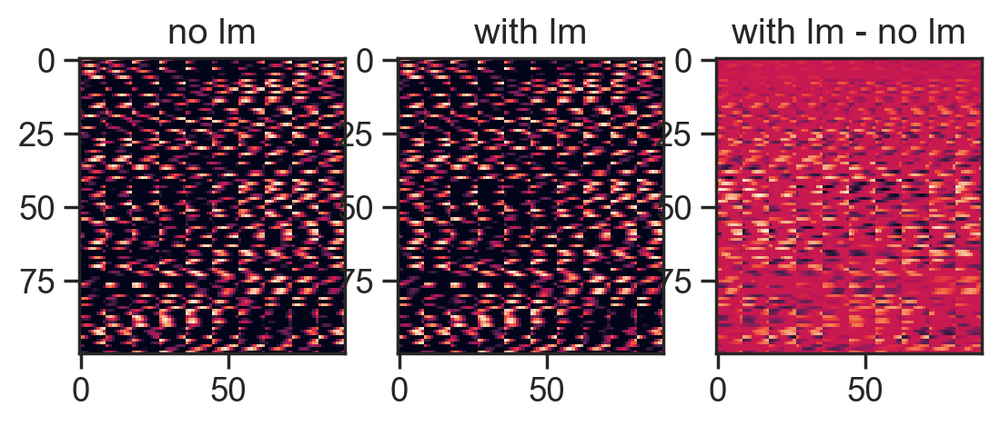

In [9937]:
plt.subplot(131)
plt.imshow(all_As[0,0,0:10000:100,:])
plt.title('no lm')
plt.subplot(132)
plt.imshow(all_As[0,1,0:10000:100,:])
plt.title('with lm')
plt.subplot(133)
plt.imshow(all_As[0,1,0:10000:100,:] - all_As[0,0,0:10000:100,:])
plt.title('with lm - no lm')

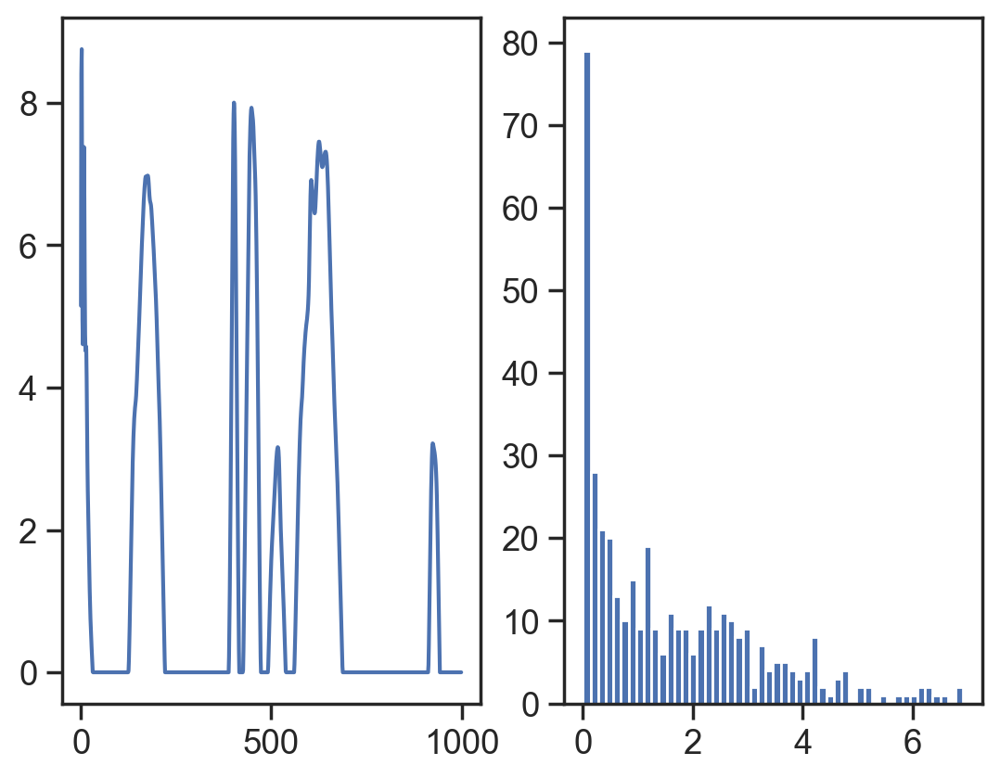

In [9938]:
cell_idx=13
plt.subplot(121)
plt.plot(all_As[0,0,:1000,cell_idx])
plt.subplot(122)
h=plt.hist(all_mean_maps[0,0,cell_idx, :, :].reshape(-1), 50)

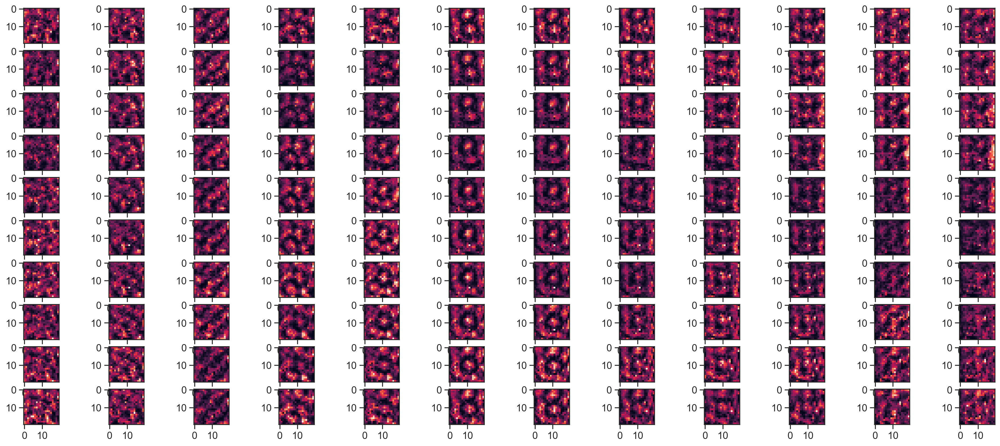

In [9964]:
# fields get clenaer with increased l_str
n_cells_plot = 10
b=3

plt.figure(figsize=(n_l_str*2, n_cells_plot))
for c in range(n_cells_plot):
    cell_idx = c*9
    
    for l in range(n_l_str):
        plt.subplot(n_cells_plot, n_l_str, l+1 + c*n_l_str)
        plt.imshow(all_mean_maps[b,l, cell_idx])

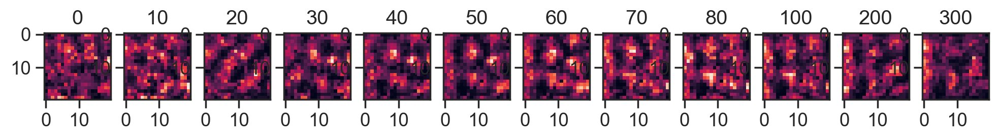

In [9965]:
cell_idx = 69
b = 3

plt.figure(figsize=(n_l_str, 2))
for l in range(n_l_str):
    plt.subplot(1, n_l_str, l+1)
    plt.imshow(all_mean_maps[b,l, cell_idx])
    plt.title(f'{all_l_str[l]}')

In [9966]:
all_mean_maps.shape

(5, 12, 90, 20, 20)

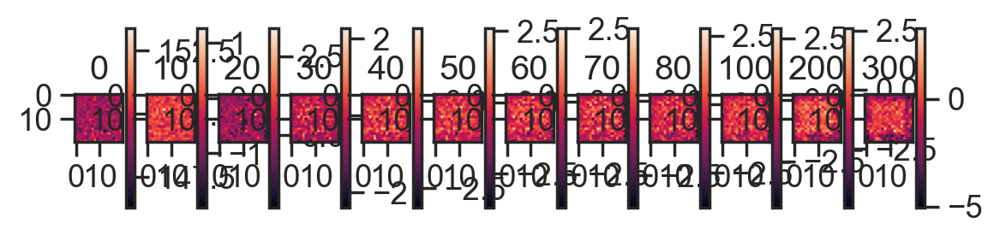

In [9942]:
# population level
b = -1
l_dark = 0
for l in range(n_l_str):
    plt.subplot(1, n_l_str, l+1)
    if l > 0:
        plt.imshow(np.sum(all_mean_maps[b,l], axis=0)-np.sum(all_mean_maps[b,l_dark], axis=0))
        plt.colorbar()
    else:
        plt.imshow(np.sum(all_mean_maps[b,l_dark], axis=0))
        plt.colorbar()

    plt.title(f'{all_l_str[l]}')

In [9943]:
# pos_from_l = np.tile(np.expand_dims(all_poss[1, 3], 1), (1,4,1)) - np.tile(np.expand_dims(l_pos, 0), (n_timebins, 1, 1))
# dist_from_l = np.linalg.norm(pos_from_l, axis=-1)

# plt.plot(dist_from_l[:,0])

In [9944]:
all_l_str

array([  0,  10,  20,  30,  40,  50,  60,  70,  80, 100, 200, 300])

In [9945]:
all_A_ls.shape

(5, 12, 45000, 4)

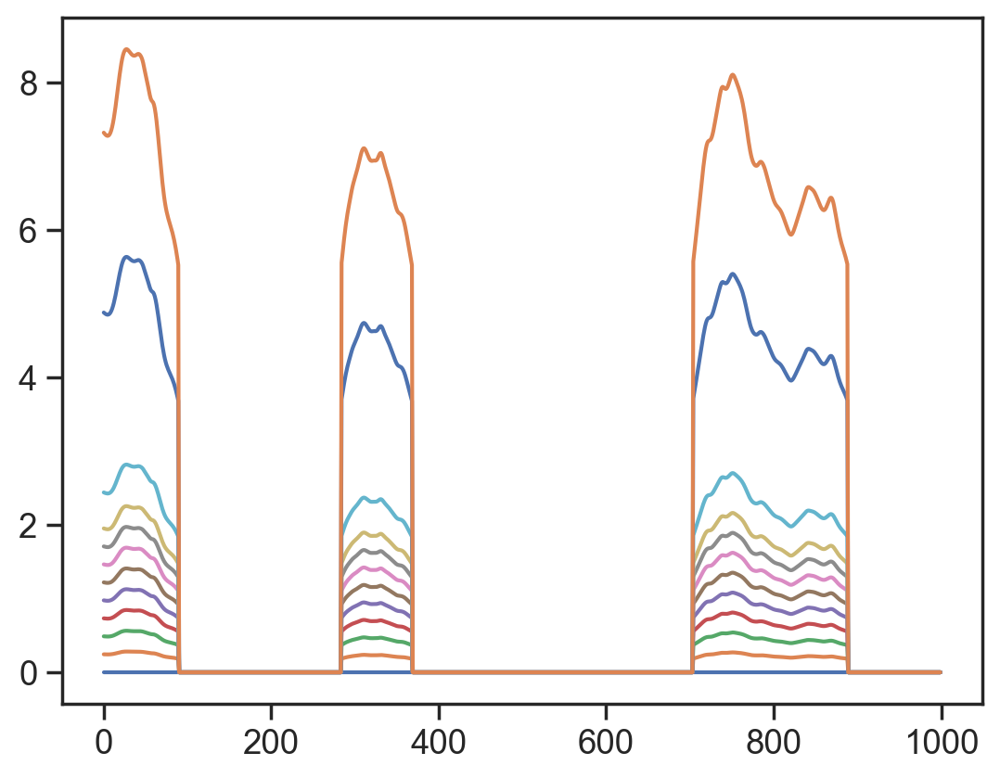

In [9946]:
b = 0
for l in range(all_l_str.size):
    plt.plot(all_A_ls[b,l, :1000, 2])


In [9947]:
# h=plt.hist((this_A[bins_use, :] - dark_A[bins_use,:]).reshape(-1), 10)

(0.11896808164727912,
 10.235589936802713,
 21.40760953991776,
 31.524231395073194)

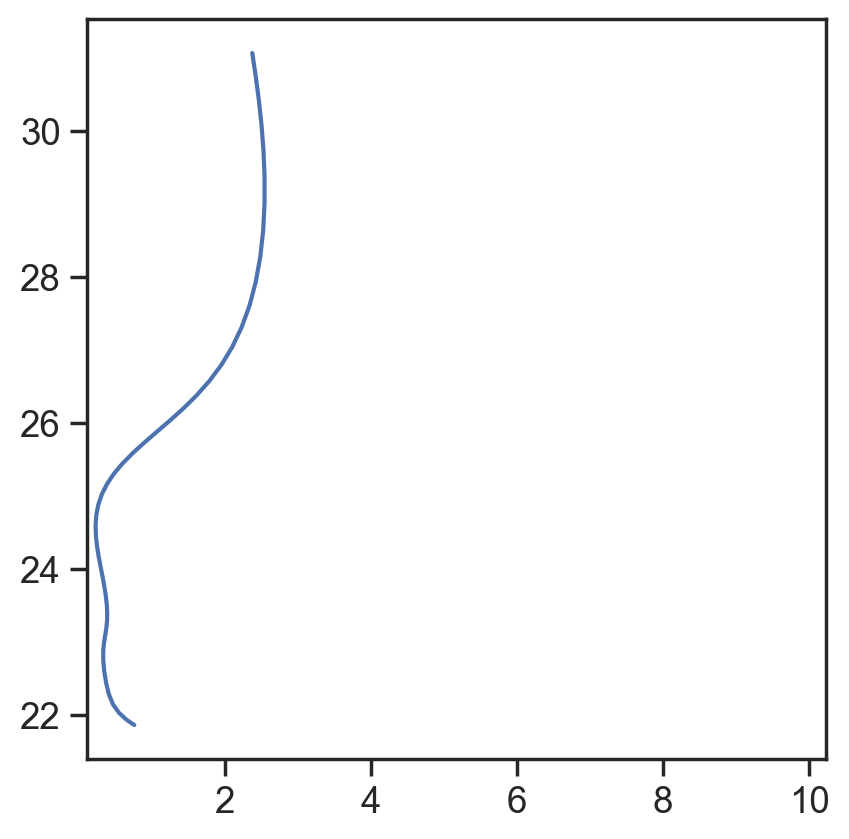

In [9948]:
plt.plot(all_poss[0,0,:50,0],all_poss[0,0,:50,1])
plt.xlim([0, 50])
plt.ylim([0, 50])
plt.axis('square')

In [9949]:
all_As.shape

(5, 12, 45000, 90)

In [9950]:
lm_pinning[0,0,:,:]

array([[33., 34., 42., 43., 51.],
       [ 3., 11., 12., 21., 22.],
       [69., 78., 79., 86., 87.],
       [27., 36., 37., 45., 46.]])

Text(0.5, 1.0, 'with lm - no lm')

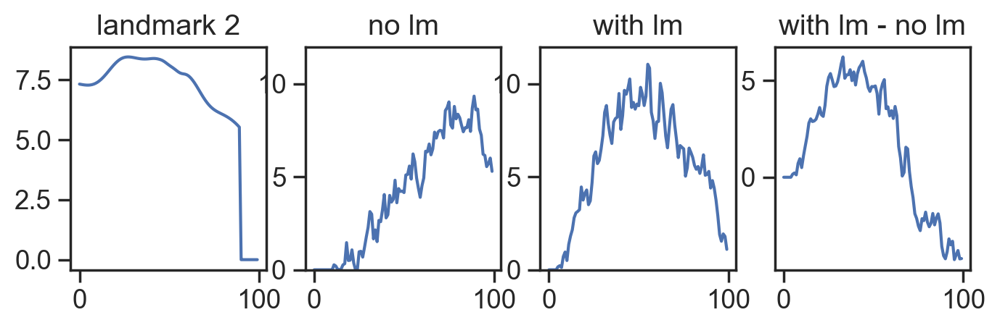

In [9951]:
b=-1
lm_idx = 2 # associated with cells _____
l_dark=0
l_light=-1
cell_idx = 69
bins_plot = np.arange(0,100)
yl_max = 12

plt.figure(figsize=(8,2))

plt.subplot(141)
plt.plot(all_A_ls[b,l_light,bins_plot,lm_idx])
plt.title(f'landmark {lm_idx}')

plt.subplot(142)
plt.plot(all_As[b,l_dark,bins_plot,cell_idx])
plt.ylim([0,yl_max])
plt.title('no lm')

plt.subplot(143)
plt.plot(all_As[b,l_light,bins_plot,cell_idx])
plt.ylim([0,yl_max])
plt.title('with lm')

plt.subplot(144)
plt.plot(all_As[b,l_light,bins_plot,cell_idx]-all_As[b,l_dark,bins_plot,cell_idx])
plt.title('with lm - no lm')


Text(0.5, 1.0, 'with lm - no lm')

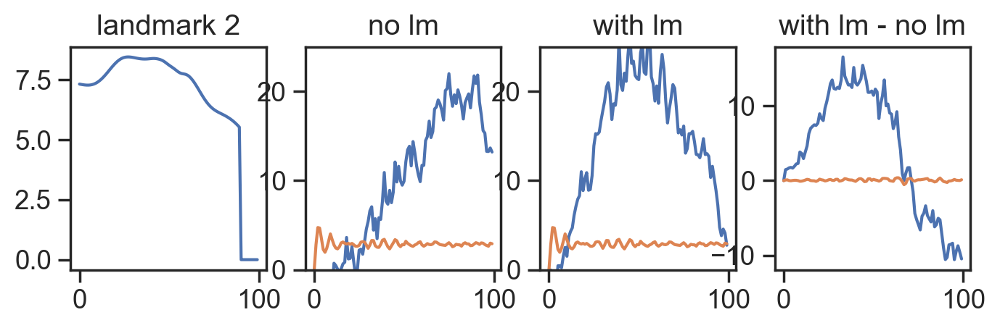

In [9952]:
b=-1
lm_idx = 2 # associated with cells ____
l_dark=0
l_light=-1
cell_idx = 69
bins_plot = np.arange(0,100)
yl_max = 25

plt.figure(figsize=(8,2))

plt.subplot(141)
plt.plot(all_A_ls[b,l_light,bins_plot,lm_idx])
plt.title(f'landmark {lm_idx}')

plt.subplot(142)
plt.plot(all_Bs[b,l_dark,bins_plot,cell_idx])
plt.plot(np.mean(all_Bs[b,l_dark,bins_plot,:], axis=-1))

plt.ylim([0,yl_max])
plt.title('no lm')

plt.subplot(143)
plt.plot(all_Bs[b,l_light,bins_plot,cell_idx])
plt.plot(np.mean(all_Bs[b,l_dark,bins_plot,:], axis=-1))
plt.ylim([0,yl_max])
plt.title('with lm')

plt.subplot(144)
plt.plot(all_Bs[b,l_light,bins_plot,cell_idx]-all_Bs[b,l_dark,bins_plot,cell_idx])
plt.plot(np.mean(all_Bs[b,l_light,bins_plot,:], axis=-1) - np.mean(all_Bs[b,l_dark,bins_plot,:], axis=-1))

plt.title('with lm - no lm')


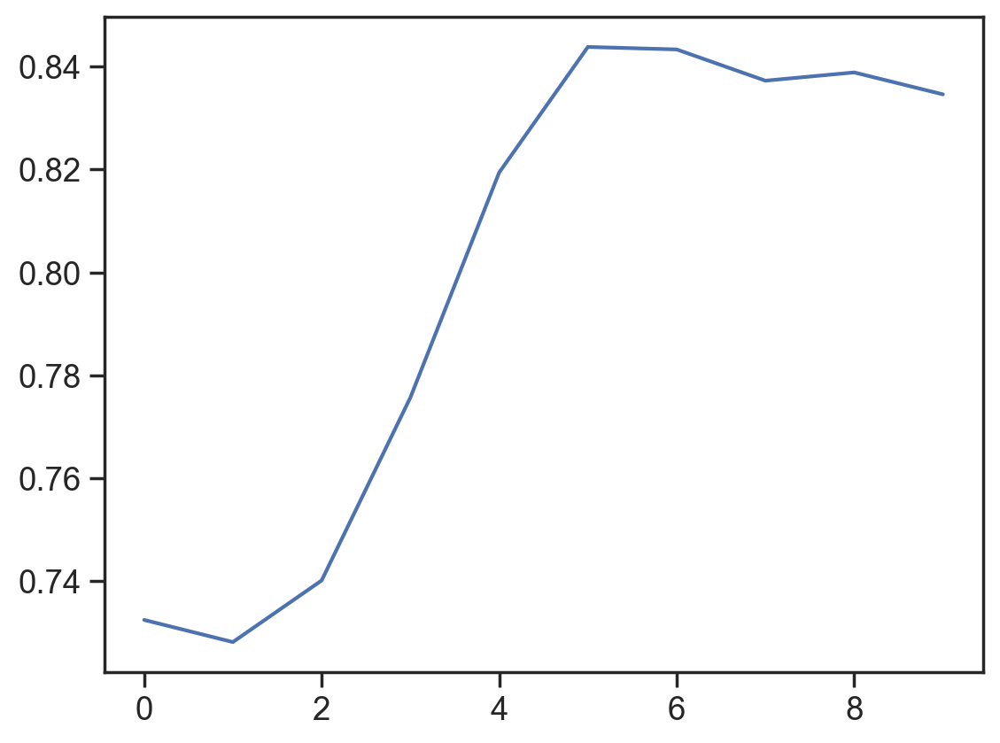

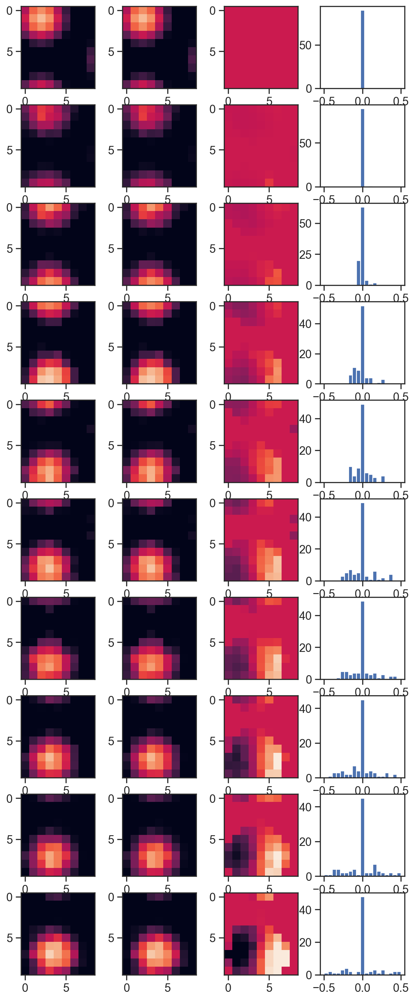

In [9953]:
# fascinating counter-intuitive result here. 
# was confused by decrease of activity near boundaries. I thought there'd be increase in activity of grid cells with fields near boundary.
# I think: because of the inhibition normalization, activation of a set of neurons causes a corresponding decrease in activity in other neurons in later timesteps.
# but what's strange is that looking at when pinning is stronger (larger l_str and hence larger A_l), the difference in effects is smaller??

b=2# b=0 no noise, b=1 slight noise, b=2 stronger noise, b=3 strong noise
l=3 # l=0 no pinning, l=1 slight pinning, l=2 stronger pinning, l=3 strong pinning
lm_idx=2
this_A_l = all_A_ls[b,l] 
this_A = all_As[b,l]
dark_A = all_As[b,0]

bins_use = np.arange(0, 50, 5) # these are the first bins when the animal first encountered any landmark (lm2)

plt.figure()
plt.plot(this_A_l[bins_use, lm_idx]) #lm2 firing. use grid cell in lm_pinning for single cell look at the data

n_bins = bins_use.size
# min_diff = -4
# max_diff = 2
min_diff = -0.5
max_diff = 0.5
hist_bins = np.linspace(min_diff, max_diff, 20)
plt.figure(figsize=(8,n_bins*2))
for i in range(n_bins):
    plt.subplot(n_bins,4,4*i+1)
    plt.imshow(dark_A[bins_use[i], :].reshape(n_x, n_y), vmin=0, vmax=10)
    
    plt.subplot(n_bins,4,4*i+2)
    plt.imshow(this_A[bins_use[i], :].reshape(n_x, n_y), vmin=0, vmax=10)

    plt.subplot(n_bins,4,4*i+3)
    plt.imshow(this_A[bins_use[i], :].reshape(n_x, n_y) - dark_A[bins_use[i],:].reshape(n_x,n_y), vmin=min_diff, vmax=max_diff)

    plt.subplot(n_bins,4,4*(i+1))
    h=plt.hist(this_A[bins_use[i], :] - dark_A[bins_use[i],:], hist_bins)


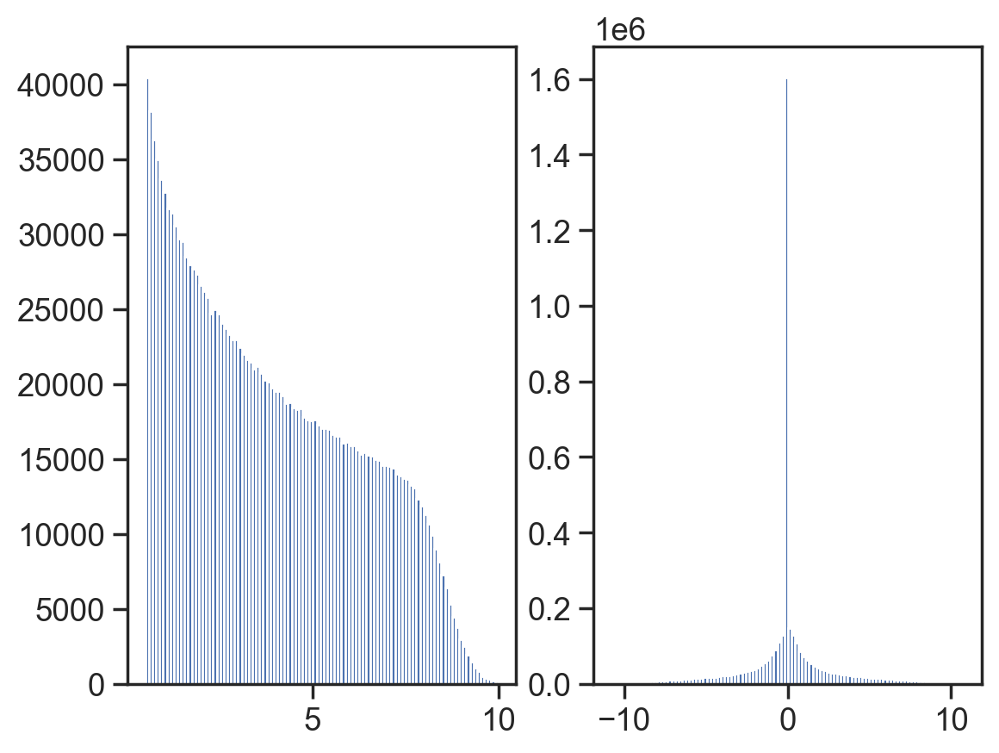

In [9954]:
plt.subplot(121)
h=plt.hist(this_A.reshape(-1),np.linspace(0.5,10,100))
plt.subplot(122)
h=plt.hist(this_A.reshape(-1)-dark_A.reshape(-1),100)

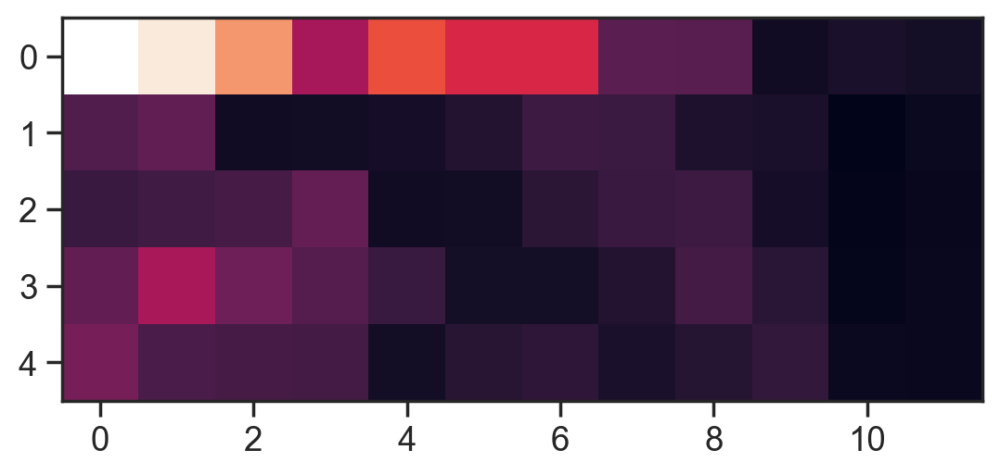

In [9955]:
template_maps = all_mean_maps[0, 0, :].reshape(-1)
corr_vals = np.zeros((n_noisy_betas, n_l_str, N))

for b in range(n_noisy_betas):
    for l in range(n_l_str):
        corr_vals[b,l]=np.corrcoef(template_maps, all_mean_maps[b,l].reshape(-1))[0,1]

corr_vals[0,0] = np.nan
plt.imshow(np.mean(corr_vals, axis=-1))

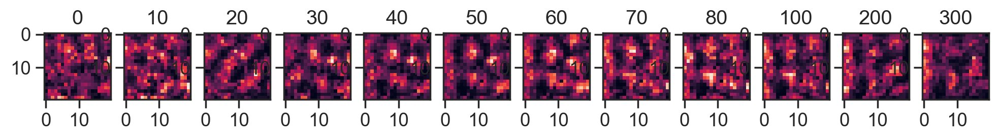

In [9967]:
# compare no lm to with lm. first plot is just baseline condition
cell_idx = 69
b=3
l_dark=0

plt.figure(figsize=(n_l_str, 2))
for l in range(n_l_str):
    plt.subplot(1, n_l_str, l+1)
    plt.imshow(all_mean_maps[b,l, cell_idx])

    # if l > 0:
    #     # plt.imshow(all_mean_maps[b,l, cell_idx]-all_mean_maps[b,l_dark, cell_idx])
    #     plt.imshow(all_mean_maps[b,l, cell_idx])
    # else:
    #     plt.imshow(all_mean_maps[b,l_dark, cell_idx])

    plt.title(f'{all_l_str[l]}')

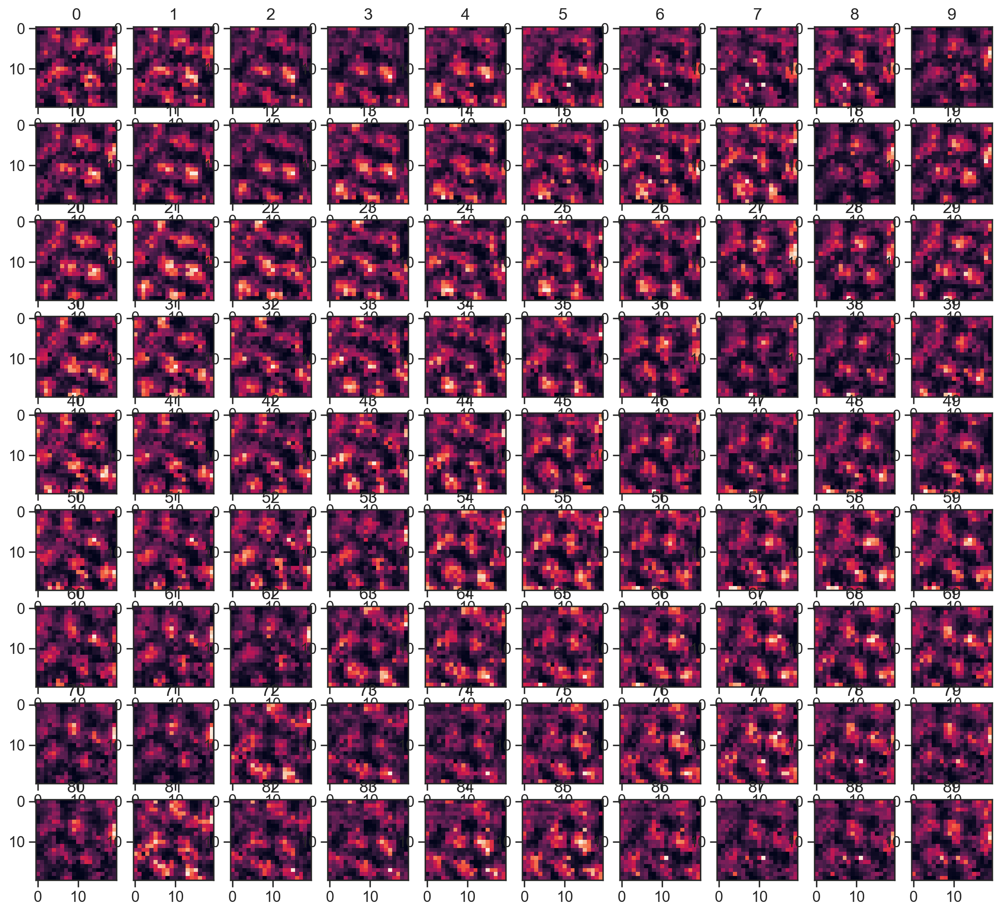

In [9968]:
# find cells with increased firing near one of the boundaries (strong landmark pinning, no noise)
b=3
l=3

n_rows = int(np.ceil(np.sqrt(N)))
plt.figure(figsize=(n_rows*1.5, n_rows*1.5))
for i in range(N):
    plt.subplot(n_rows, n_rows, i+1)
    plt.imshow(all_mean_maps[b,l, i])
    plt.title(f'{i}')

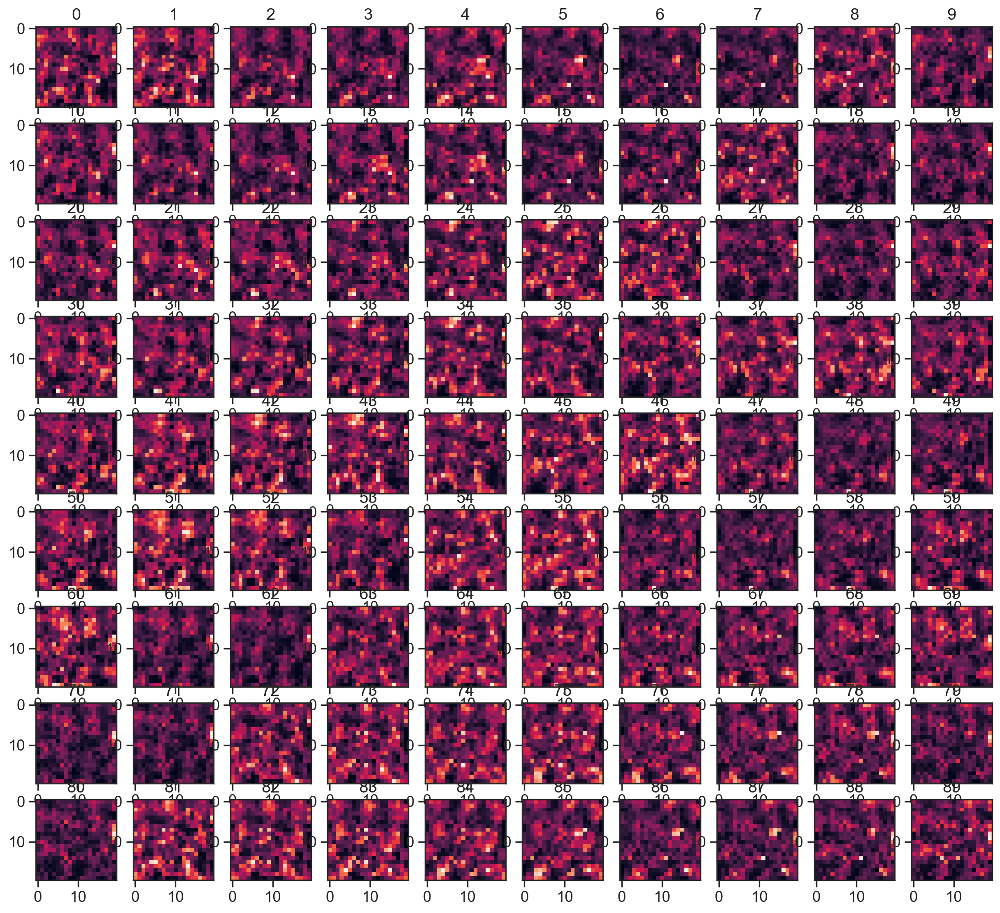

In [9969]:
# find cells with increased firing near one of the boundaries (strong landmark pinning, no noise)
b=3
l=0

n_rows = int(np.ceil(np.sqrt(N)))
plt.figure(figsize=(n_rows*1.5, n_rows*1.5))
for i in range(N):
    plt.subplot(n_rows, n_rows, i+1)
    plt.imshow(all_mean_maps[b,l, i])
    plt.title(f'{i}')

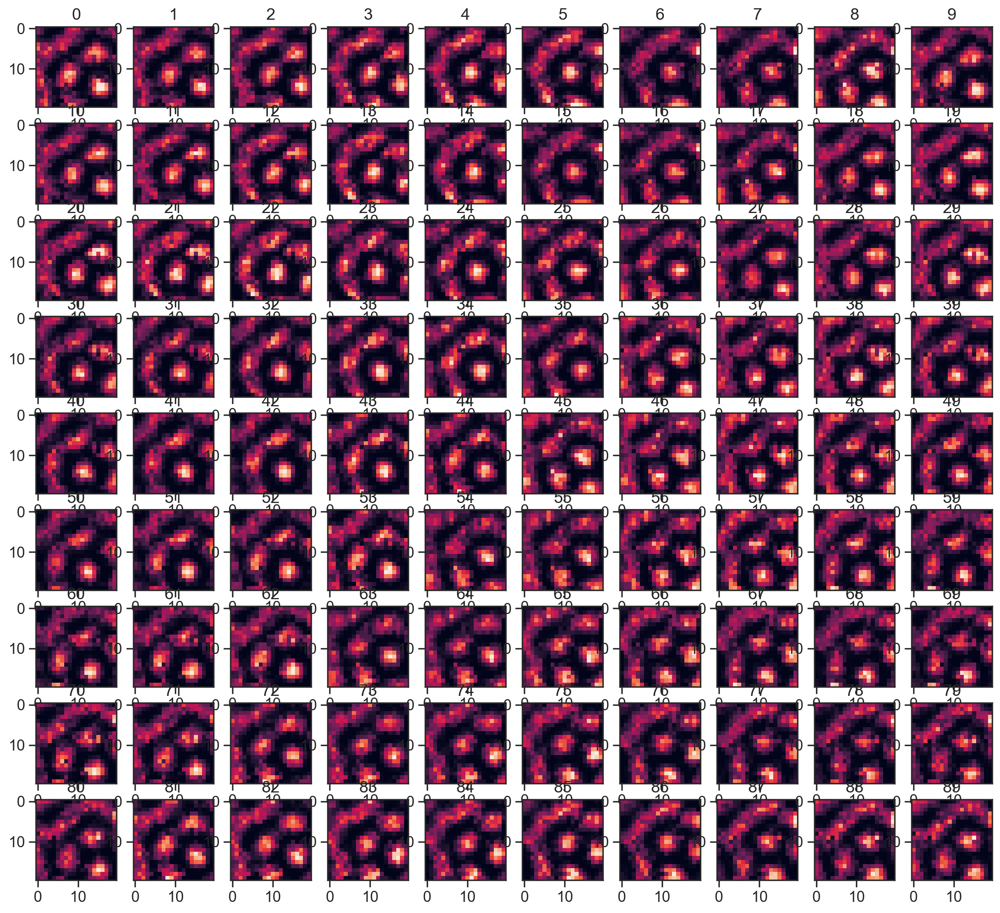

In [9959]:
# find cells with increased firing near one of the boundaries (strong landmark pinning, no noise)
b=0
l=0

n_rows = int(np.ceil(np.sqrt(N)))
plt.figure(figsize=(n_rows*1.5, n_rows*1.5))
for i in range(N):
    plt.subplot(n_rows, n_rows, i+1)
    plt.imshow(all_mean_maps[b,l, i])
    plt.title(f'{i}')

# FOR 1D SIMULATION MAKE SURE TO ADD THE BETA NOISE AND WEIGHT NOISE INTO FUNCTIONS AND SAVE THEM OUT TOO! ALTHOUGH, THE 1D VERSION CAN PROBABLY RUN ON THE 2D ONE TOO. JUST NEED TO FIGURE OUT HOW TO TRIAL STRUCTURE IT.

In [1812]:
# plt.figure(figsize=(20,20))
# for i in range(20*20):
#     plt.subplot(20,20,i+1)
#     plt.imshow(A[i*100].reshape(n_x, n_y))

In [1813]:
# plt.imshow(np.sum(A.reshape(-1,n_y, n_x), 0))

In [7307]:
def calc_2d_maps(A, pos, n_bins):
    # H,xedges,yedges=np.histogram2d(pos[:,0], pos[:,1], bins=10)
    n_timebins, N = np.shape(A)
    H=np.digitize(pos, np.linspace(0, np.max(pos), n_bins+1), right=True)
    
    wherebins = []
    for xi in range(n_bins):
        tempx = np.where(H[:, 0] == xi+1)[0]
        for yi in range(n_bins):
            tempy = np.where(H[:,1]==yi+1)[0]
    
            wherebins.append(np.intersect1d(tempx,tempy))
    
    mean_maps = np.zeros((N, n_bins, n_bins))
    
    for xi in range(n_bins):
        
        for yi in range(n_bins):
            these_bins = wherebins[xi+yi*n_bins] # this way indexes so that bins are counted along rows and then columns
            
            if these_bins.size>0:
                mean_maps[:, xi, yi] = np.mean(A[these_bins, :], axis=0)
    return mean_maps

In [5222]:
def calc_spikes(A, norm_factor=1): # get spikes from the firing rates
    rng = np.random.default_rng(seed=3)
    n_timebins, N = np.shape(A)
    spikes = np.zeros((n_timebins, N))

    for i in range(n_timebins):
        fr = A[i, :] / norm_factor
        try:
            spikes[i, :] = rng.poisson(lam = fr, size=(N,))
        except:
            spikes[i, :] = rng.poisson(lam = 0, size=(N,)) # for when fr is nan

    return spikes

In [5223]:
# n_bins=20
# mean_maps = calc_2d_maps(A, pos, n_bins)
# spikes = calc_spikes(A, 10)

In [5224]:
# plt.imshow(mean_maps[0,:,:])

In [5225]:
# plt.plot(spikes[:, 0])

In [5226]:
# this_cell = 0
# this_cell_spikes = np.where(spikes[:,this_cell] > 2)[0]


In [5227]:
# plt.subplot(1,2,1)
# plt.scatter(pos[this_cell_spikes, 0], pos[this_cell_spikes, 1], c='r', marker='o')
# plt.axis('equal')
# plt.xlim([0,50])
# plt.ylim([50,0])
# plt.subplot(1,2,2)
# plt.imshow(mean_maps[this_cell].T)
# plt.axis('equal')

# VIDEO OF GRID CELL LIKE JEFFERY LAB VIDEO

In [3216]:
def plot_pos_and_spikes(spikes, pos, minx, maxx, miny, maxy, plot_bins, mean_maps, pil_use, save_fig, save_dir, dpi_val, color_val):

    if not os.path.isdir(save_dir):
        os.makedirs(save_dir, exist_ok=True)

    if pil_use:
        mpl.rcParams['figure.dpi'] = dpi_val
        
    try:
        plt.close('all')
        if save_fig:
            matplotlib.use('agg')
        else:
            %matplotlib inline

        pid=0
        
        for i in np.arange(plot_bins.shape[0]):
            fig=plt.figure(figsize=(5,5))

            this_frame = plot_bins[i]
            #plt.plot(pos[:this_frame, 0], pos[:this_frame, 1], c='grey', linewidth=1)
            plt.plot(pos[:this_frame, 0], pos[:this_frame, 1], c='grey', linewidth=2)

        
            spikes_to_now = np.where(this_cell_spikes < this_frame)[0]
            
            if spikes_to_now.size > 0:
                # plt.plot(pos[this_cell_spikes[spikes_to_now], 0], pos[this_cell_spikes[spikes_to_now], 1], marker='o', c='r', ms=4, linestyle='None')
                plt.plot(pos[this_cell_spikes[spikes_to_now], 0], pos[this_cell_spikes[spikes_to_now], 1], marker='o', mec=color_val,
                         mfc=color_val, ms=6, linestyle='None')


            plt.title(this_frame)
            plt.ylim([maxy, miny])
            plt.xlim([minx, maxx])
            # plt.axis('square')
            # plt.axis('off')
            # plt.xticks([minx, maxx])
            # plt.yticks([miny, maxy])
            plt.xticks([minx, maxx], labels=[0,1])
            plt.yticks([miny, maxy], labels=[0,1])
            
            if save_fig:
                if pil_use:
                    img = fig2img(fig)
                    img.save(os.path.join(save_dir,f'{pid:04d}.png'), quality=dpi_val)
                    plt.close(fig)
                else:
                    plt.savefig(os.path.join(save_dir,f'{pid:04d}.jpg'), dpi=dpi_val)
                    # fig.savefig(os.path.join(save_dir,f'{pid:03d}.png'), dpi=dpi_val)
                    plt.close(fig)

            pid += 1
            if np.mod(i, 320)==0:
                print(f'{i}')
                
        if np.max(mean_maps) > 0:
            fig=plt.figure(figsize=(5,5))

            plt.imshow(mean_maps.T, cmap='jet') 
            plt.axis('off')
            plt.axis('equal')
            plt.title('Rate Map')
            if save_fig:
                if pil_use:
                    img = fig2img(fig)
                    img.save(os.path.join(save_dir,f'rate_map.png'), quality=dpi_val)
                    plt.close(fig)
                else:
                    plt.savefig(os.path.join(save_dir,f'rate_map.jpg'), dpi=dpi_val)
                    # fig.savefig(os.path.join(save_dir,f'{pid:03d}.png'), dpi=dpi_val)
                    plt.close(fig)

    except KeyboardInterrupt:
        print("\nProgram terminated by user.")
        plt.close('all')
        %matplotlib inline     
        mpl.rcParams['figure.dpi'] = 100
    
    finally:
        print("\nProgram finished.")
        plt.close('all')
        %matplotlib inline       
        mpl.rcParams['figure.dpi'] = 100

In [1912]:
# pil_use = True
# save_fig = False
# dpi_val = 300

# this_cell = 0
# save_dir = f'D:/Code/bump_video/sim/2d/jeffrey_like/cell_{this_cell}'

# this_cell_spikes = np.where(spikes[:,this_cell] > 2)[0]
# frame_skips = 2
# plot_bins = np.concatenate((np.arange(1, 400, frame_skips), np.arange(400, 800, frame_skips*2), 
#                             np.arange(800, 3200, frame_skips*5), 
#                             np.arange(3200, 9200, frame_skips*10),
#                             np.arange(9200, 18640, frame_skips*25),
#                             np.arange(18640, n_timebins, frame_skips*100)))

# # plot_bins = np.arange(1,n_timebins, frame_skips)
# rate_map = mean_maps[this_cell,:,:]
# save_name = this_cell

# plot_pos_and_spikes(this_cell_spikes, pos*2, minx/5 - 0.025*maxx/5, 1.025*maxx/5, miny/5 - 0.025*maxy/5, 1.025*maxy/5, plot_bins, rate_map, pil_use, save_fig, save_dir, dpi_val)

# WRITE VIDEO FUNCTION

## SET PHASES AND EXTRACT BUMP LOCATION

In [5228]:
# convert from coordinates of xs and ys to circular coordinates theta0 theta1 between -pi to pi
# not sure this actually works because it treats x and y as being periodic, when they're not really the important axes. 
# need to actually calculate the impt axes

def calc_bump_plot_variables_from_xy(A, n_x, n_y, disc_smooth_sigma=5):
    # A should be shape N x n_timebins
    x1,y1 = np.mgrid[:n_x, :n_y]
    # theta0 = (2*np.pi * x1 / np.max(x1) - np.pi).reshape(-1) # get between -pi to pi
    # theta1 = (2*np.pi * y1 / np.max(y1) - np.pi).reshape(-1)
    # phases_all = np.stack((theta0, theta1))

    u,v = coord_from_phase(x1, y1)
    u=u.reshape(-1)
    v=v.reshape(-1)
    u_range = np.max(u)-np.min(u)
    v_range = np.max(v)-np.min(v)
    phases_all = np.stack((2*np.pi*u/u_range-np.pi, 2*np.pi*v/v_range-np.pi))
    
    (all_angles, all_u, all_v, 
     all_angles_unw, discs, 
     all_angles_unw_smooth, all_angles_smooth, discs_smooth, all_angles_smooth_norm)=calc_bump_plot_variables(A, phases_all, disc_smooth_sigma)

    all_angles_smooth_norm_xy = np.copy(all_angles_smooth_norm) 
    all_angles_smooth_norm_xy[0, :] = all_angles_smooth_norm_xy[0, :] * (n_x-1)
    all_angles_smooth_norm_xy[1, :] = all_angles_smooth_norm_xy[1, :] * (n_y-1)
    
    return (phases_all, all_angles, all_u, all_v, all_angles_unw, discs, all_angles_unw_smooth, all_angles_smooth, discs_smooth, 
            all_angles_smooth_norm, all_angles_smooth_norm_xy)

In [5229]:
# b=1
# l=2
# (phases_all2d, all_angles, all_u, all_v, all_angles_unw, discs, 
#  all_angles_unw_smooth, all_angles_smooth, 
#  discs_smooth, all_angles_smooth_norm, all_angles_smooth_norm_xy)=calc_bump_plot_variables_from_xy(all_mean_maps[b,l,:,:,:].reshape(90,-1), n_x, n_y)

# plt.imshow(all_angles[0,:].reshape(20,20))
# # plt.imshow(all_angles[1,:].reshape(10,10))

In [5230]:
# get the bump location across all the experiments
n_angles = 2
all_angles_unw_smooth = np.zeros((n_noisy_betas, n_l_str, n_angles, n_timebins))
all_angles_smooth_norm_xy = np.zeros(all_angles_unw_smooth.shape)

disc_smooth_sigma=25
for b in range(n_noisy_betas):
    for l in range(n_l_str):
        this_A = all_As[b,l,:,:].T
        
        # (all_angles, all_u, all_v, 
        #  all_angles_unw, discs, 
        #  all_angles_unw_smooth[b,l,:,:], all_angles_smooth, 
        #  discs_smooth, all_angles_smooth_norm[b,l,:,:])=calc_bump_plot_variables(this_A, phases_all_1d, disc_smooth_sigma)

        (phases_all, all_angles, all_u, all_v,
         all_angles_unw, discs, all_angles_unw_smooth[b,l,:,:], all_angles_smooth, 
         discs_smooth, all_angles_smooth_norm, 
         all_angles_smooth_norm_xy[b,l,:,:])=calc_bump_plot_variables_from_xy(this_A, n_x, n_y, disc_smooth_sigma)


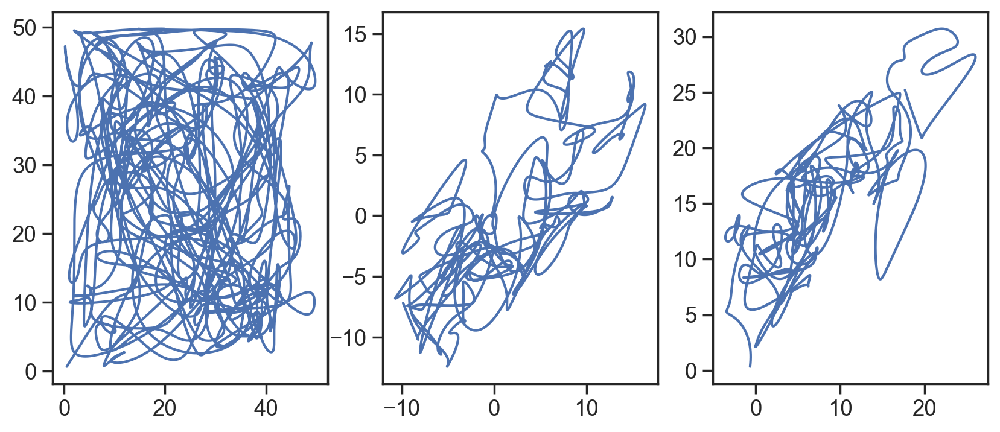

In [5231]:
# a = 0
b = 1 #n_noisy_betas-1
bins_plot=np.arange(0, n_timebins)
plt.figure(figsize=(n_l_str*5,4))
plt.subplot(1,n_l_str+1, 1)

plt.plot(all_poss[0,0, bins_plot, 0], all_poss[0,0, bins_plot, 1])
for l in range(n_l_str):
    plt.subplot(1,n_l_str+1, l+2)
    plt.plot(all_angles_unw_smooth[b,l,1, bins_plot], all_angles_unw_smooth[b,l, 0, bins_plot])

In [4905]:
# poscat = np.concatenate((all_poss[0,0,:,0],all_poss[0,0,:,1]))

# b=1
# all_angles_unw_smooth_cats = []
# for l in range(n_l_str):
#     all_angles_unw_smooth_cats.append(np.concatenate((all_angles_unw_smooth[b,l,0,:], all_angles_unw_smooth[b,l,1,:])))

# coefs = np.zeros((n_l_str,))
# for l in range(n_l_str):
#     coefs[l] = np.corrcoef(poscat, all_angles_unw_smooth_cats[l])[0,1]

# coefs

In [4906]:
# fig = plt.figure()
# ax = fig.add_subplot(111, projection='3d')

# b=1
# l=2
# angle_axis = 0
# bins_plot = np.arange(500)
# plt.plot(all_poss[0,0,bins_plot,0], all_poss[0,0,bins_plot, 1], all_angles_unw_smooth[b,l,angle_axis,bins_plot])

In [5232]:
# Dark condition is l_str = 0
b=1
l=0
dark_A = np.squeeze(all_As[b, l, :, :])

b=1
l=1
light_A = np.squeeze(all_As[b, l, :, :])
light_A.shape

(10000, 90)

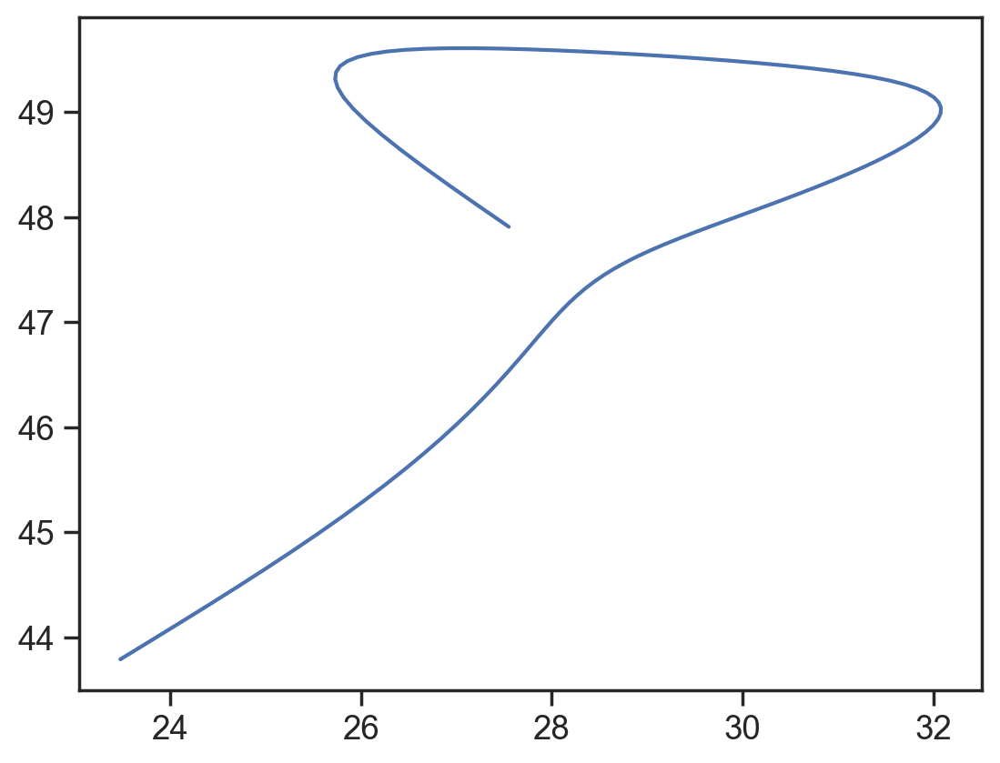

In [5233]:
plt.plot(all_poss[0,0,200:298,0], all_poss[0,0,200:298,1])

In [5234]:
all_angles_smooth_norm_xy[0,0,0,:].max(0)

8.999912697869613

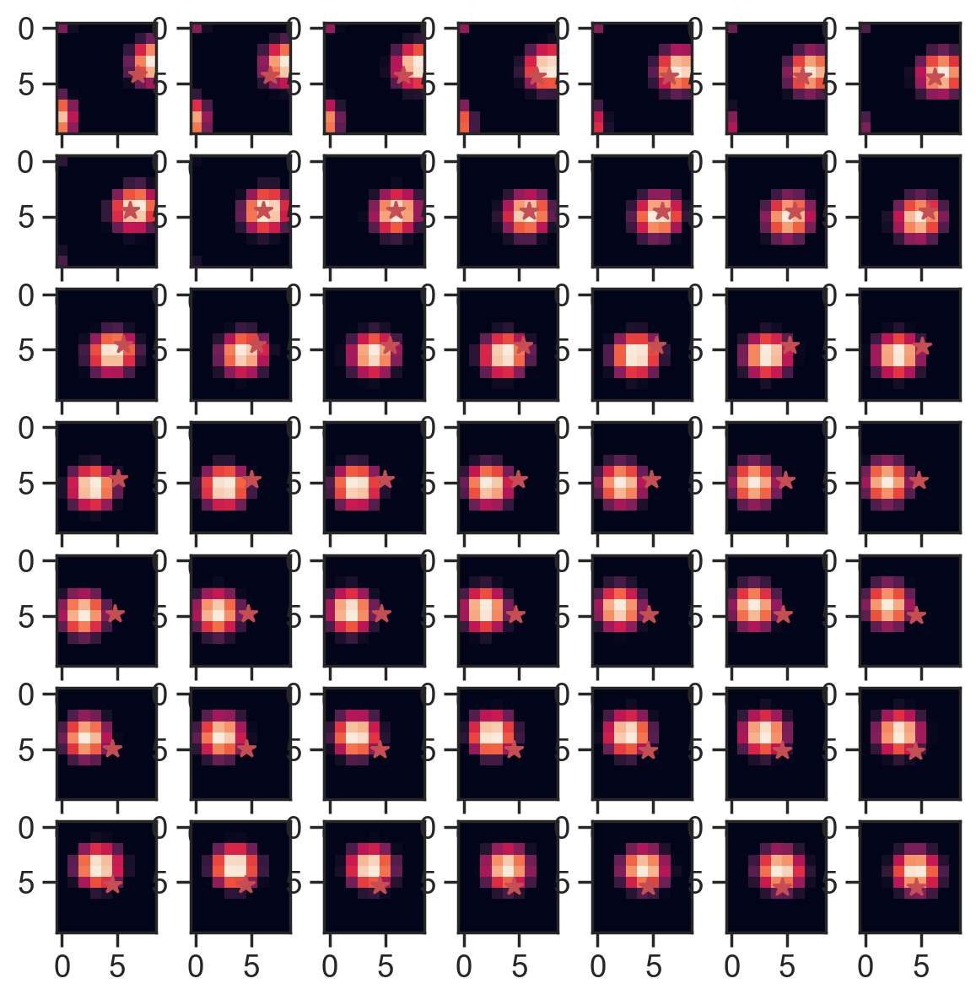

In [5235]:
plt.figure(figsize=(7,7))
for t in range(49):
    plt.subplot(7,7,t+1)
    plt.imshow(all_As[0,0,1*t+80,:].reshape(n_x,n_y))
    # plt.plot(n_y*all_angles_smooth_norm[0,0, 1, 1*t+130], n_x*all_angles_smooth_norm[0,0,0, 1*t+130], 'r*', markersize=8)
    plt.plot(all_angles_smooth_norm_xy[0,0, 1, 1*t+80], all_angles_smooth_norm_xy[0,0,0, 1*t+80], 'r*', markersize=8)

## Computing weighted circular mean carefully (might not need this for our purposes)

See here for source material: https://www.mathworks.com/matlabcentral/fileexchange/132118-true-circular-mean?s_tid=FX_rc1_behav

The mean $M$ of a discrete set $a=\{a_i\}$ is formally defined as

 
$M = \underset{x}{\arg\min} \underset{i}\sum f(a_i,m) \quad\quad (1)$           
        
 
where the distance function $f(a_i,m)$ is some metric appropriate to the set.

To solve for the mean using Eq. (1), we take the derivative and set it to
zero. 

The conventional method has the advantage of being easily 
differentiable. The average angle distance metric $(1-\cos(a_i-m))$ yields 
the conventional formula for an "average angle" $M_a$ given by:

 $M_a = \text{atan2} \bigg( \sum\sin(a*\pi/180), \space \sum\cos(a*\pi/180) \bigg)$ -equivalent to-
 
 $M_a = \text{atan2} \bigg( \text{mean}(\sin(a*\pi/180), \space \text{mean}(\cos(a*\pi/180) \bigg)$ -or-
 
 $M_a = \text{angle}(\exp(j*a*\pi/180))$ (in Matlab)


This works where the arctangent of its input arguments are defined. Note
that it involves transcendential functions and that the distance function is 
related to the cosine of the angle difference. Further, when using circular
sets such as day of year, the value (which might be an integer) has to be
converted to the range [0..2*pi), which involves the irrational number pi.

However, when considering the difference between two angles, the distance
function can be better defined as what might called the minimum arc distance,
i.e., the minimum of the two possible angles or arcs between the two angles.
That is, the minimum angle moving clockwise or counterclockwise from
one angle to the other.  This minimum arc distance is between $0$ and $360$.
This is the linear distance as defined on a circular set. Computationally,
this is the minimum of $\big\lvert(a_i-m)\big\rvert$, $\big\lvert(a_i-m-360)\big\rvert$, and $\big\lvert(a_i-m+360)\big\rvert$, which
can be written succintly as

 $f(a_i,m)= 180-\bigg\lvert 180-\big\lvert\text{modulo}(a_i-m, \space 360)\big\rvert \bigg\rvert \quad \quad (2)$

Note: the signed (+CCW vs -CW) distance function $f$ for two angles $a_i$ and $m$ can be written as

$f(a_i,m)=\text{modulo}(m-a_i+180, \space 360)-180  \quad \quad (3)$

Eq. (2) appears hard to differentiate. However, by dividing the modulo and
absolute value functions into sets, the derivative of the distance function
can be determined [1], which can be used to solve Eq. (1) for the true 
circular mean. This is computationally a little complicated since it 
requires sorting parts of the data, but it involves no transcendential 
functions.  Further, Kogan's implementation [1] avoids the angle sampling 
limitations required by Matsuti's method [2]. Computation in degrees avoids 
irrational numbers such as pi and so is well-suited for other circular data
sets. Note that Kogan's method is not a "single-pass" algorithm [2,3], i.e.,
it requires the entire list of input angles at start. 

TO DO: WRITE OUT THE FUNCTIONS FROM MATPLOT HERE TO PYTHON.
FOR NOW, WILL JUST SORT THE NEURONS ONTO THE SHEET BY EXTRACTING PHASES FROM PSD.

In [4305]:
# will need to subset the data earlier myself before passing through plot bump over time

In [4310]:
# def plot_landmark_pinning

In [5236]:
def disc_finder(data, threshold):
    diff = np.diff(data)
    discs = np.where((diff >= threshold) + (diff <= -threshold))[0]+1
    if discs.size>0:
        discs_sign = np.sign(diff[discs])
    else:
        discs_sign = []
    return discs, discs_sign

In [5237]:
def calc_sheet_idx(data, threshold):
    n_bins = data.shape[0]

    discs,discs_sign=disc_finder(data, threshold)
    discs_temp=np.zeros((data.shape))
    discs_temp[discs]=discs_sign
    sheet_idx = np.cumsum(discs_temp)
    
    return sheet_idx

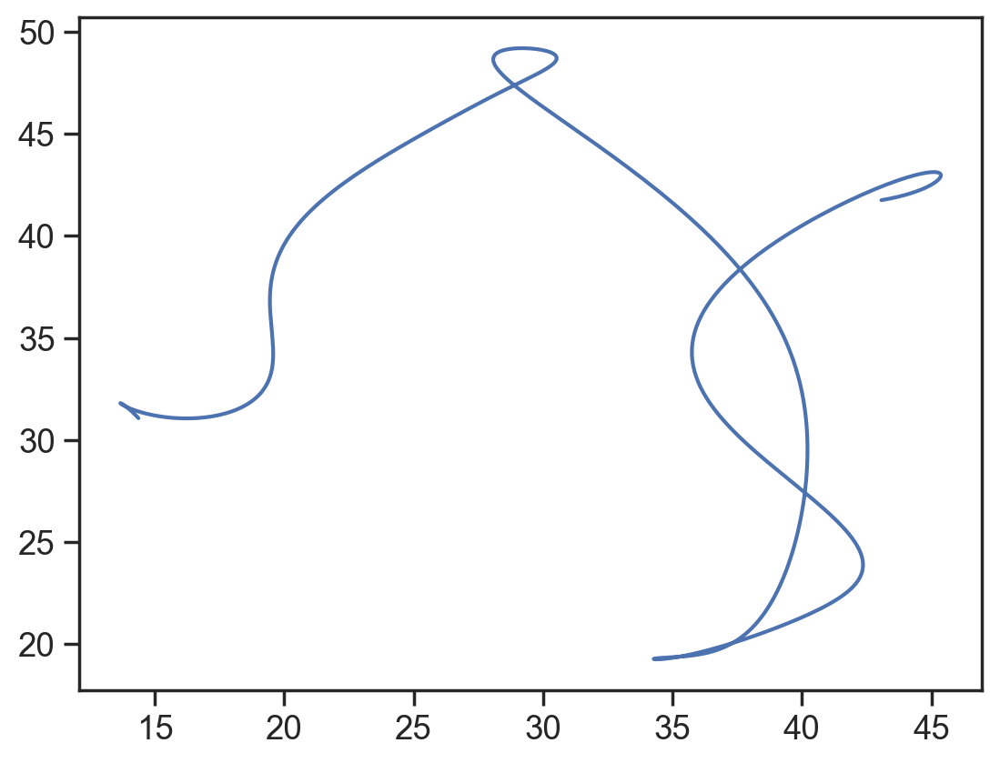

In [5238]:
plt.plot(this_pos[:,0], this_pos[:,1])

In [4922]:
bins_plot = np.arange(100,600,1) # skip first few bins that are going very fast

n_bins = bins_plot.shape[0]
b=1
l=0

smooth_sigma_plot = 10
this_A = gaussian_filter1d(all_As[b,l,bins_plot,:], smooth_sigma_plot, axis=0)
this_pos= all_poss[b,l,bins_plot,:]
n_copies=7 # MUST USE ODD NUMBER OF COPIES
bump_loc = all_angles_smooth_norm_xy[b,l]

# calculate sheet index if the trajectory were infinitely long
sheet_idx = np.zeros((2, n_bins))
for a in range(2):
    angle_a = bump_loc[a, bins_plot]
    if a == 0:
        threshold = n_x//2
    else:
        threshold = n_y//2
    sheet_idx[a, :] = calc_sheet_idx(angle_a, threshold)

start_sheet = 3
copy_idx = np.mod(np.copy(sheet_idx + start_sheet), n_copies) 

save_fig=True
save_dir = 'D:/Code/bump_video/sim/2d/dark_v_lm/dark'
dpi_val = 50
plot_bump_over_time(this_A, n_x, n_y, bump_loc, n_copies, copy_idx, save_fig, save_dir, dpi_val)


Program finished.


In [4919]:
all_angles_smooth_norm_xy.shape

(2, 2, 2, 20000)

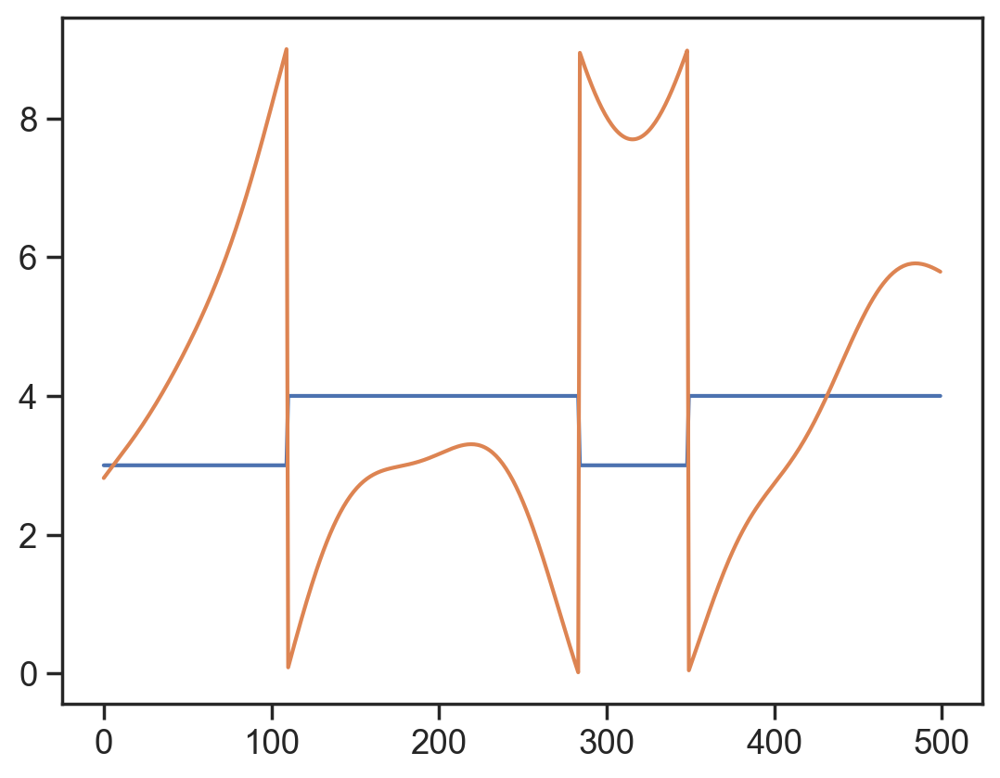

In [4924]:
plt.plot(copy_idx[0])
plt.plot(all_angles_smooth_norm_xy[b,l,0,bins_plot])

In [4672]:
this_A.shape

(1000, 90)

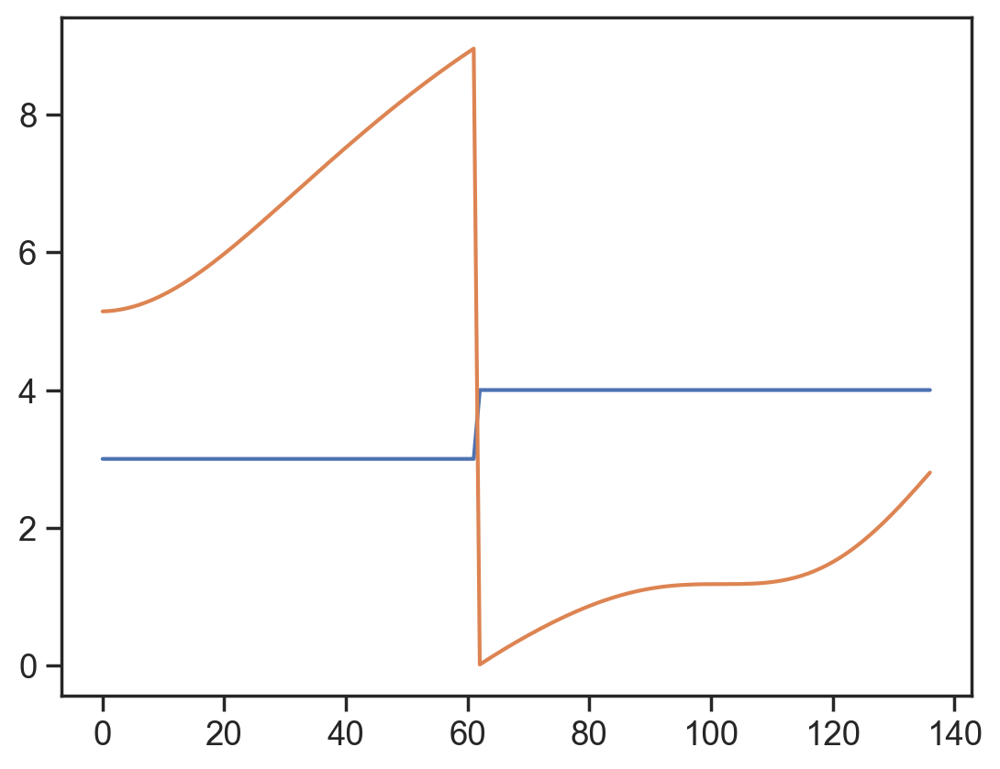

In [4785]:
plt.plot(copy_idx[0,:137])
plt.plot(all_angles_smooth_norm_xy[b,l,0,:137])

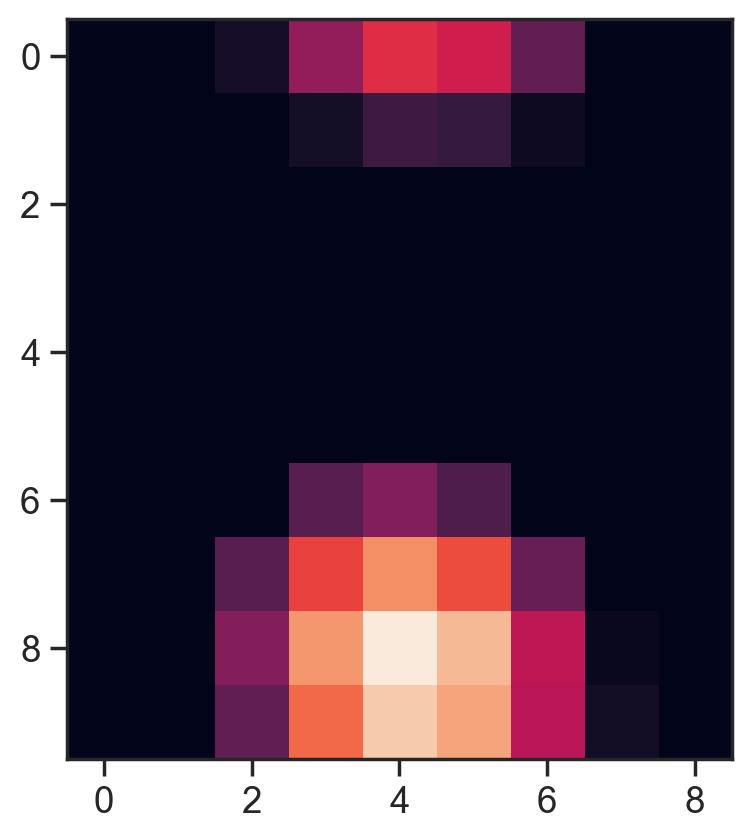

In [4628]:
plt.imshow(this_A[135, :].reshape(n_x,n_y))

In [4230]:
copy_idx.shape

(2, 10)

In [4046]:
def check_and_make_dir(save_dir):
    if not os.path.isdir(save_dir):
        os.makedirs(save_dir, exist_ok=True)

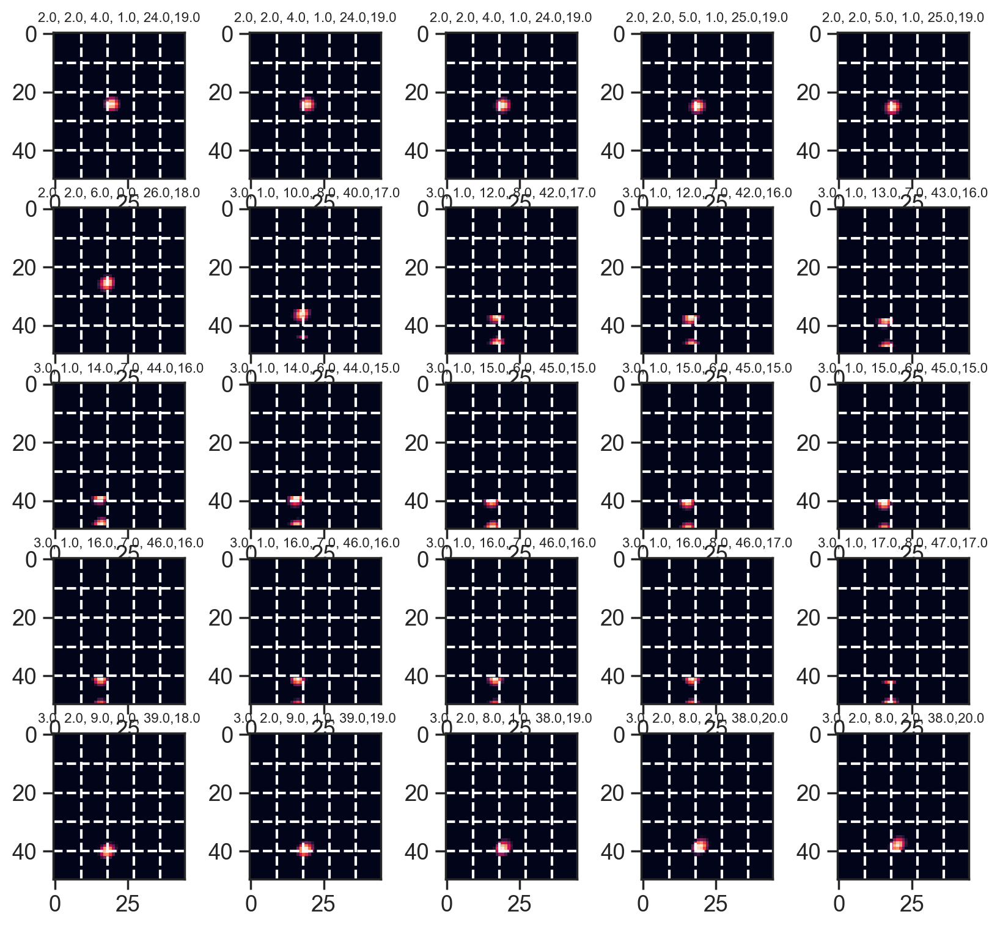

In [4167]:
A=this_A


fig=plt.figure(figsize=(n_x,n_y))

for ti in range(25):
    t=130+ti

    plt.subplot(5,5,ti+1)
    # n_copies=5
    
    x, y = np.mgrid[:n_copies*resx,:n_copies*resy]/resy
    u, v = coord_from_phase(x+1,y+1)
    
    im = A[t,:].reshape(n_x,n_y)
    im_copies = np.tile(im, (n_copies, n_copies))
    
    n_flips = n_copies // 2
    for flip_idx in range(n_flips):
        idxs_flip = np.arange((flip_idx*2+1)*n_y,(flip_idx*2+2)*n_y)
        im_copies[:, idxs_flip] = np.roll(im_copies[:, idxs_flip], n_x//2, axis=0)
    
    copy_idx_t = copy_idx[:,t]
    bump_loc_t = bump_loc[:,t]
    
    # this is where the bump is
    this_loc = copy_idx_t * np.array([n_x, n_y])  + np.round(bump_loc_t)
    this_loc_unmod = np.copy(this_loc)
    
    # however, if on every other copy along dimension two then, need to flip the n_x values if the two dimensions are two apart
    # currently only works for even numbers of n_copies
    # if np.mod((copy_idx_t[1]-1), 2)==0:
    #     this_loc[0] -= n_x//2 # is this right? 

    mask = mask_out_copies(n_x, n_y, n_copies, copy_idx_t, bump_loc_t)
    
    # plt.imshow(mask)
    plt.imshow(im_copies*mask)

    # plt.imshow(im_copies * mask)
    plt.title(f'{copy_idx_t[0]}, {copy_idx_t[1]}, {np.round(bump_loc_t[0])}, {np.round(bump_loc_t[1])}, {this_loc[0]},{this_loc[1]}', fontsize=8)

    for ii in np.arange(1,n_copies):
        plt.axvline(n_y*ii, c='w', linestyle='dashed')
        plt.axhline(n_x*ii, c='w', linestyle='dashed')
    # now put the bump on the sheet
    # plt.pcolormesh(u, v, im_copies*mask, shading='auto')
    # plt.axis('off')

In [4166]:
def mask_out_copies(n_x, n_y, n_copies, copy_idx_t, bump_loc_t):
    n_dim0 = n_x*n_copies
    n_dim1 = n_y*n_copies
    mask = np.ones((n_dim0, n_dim1))

    # fix dim1
    bump_loc_dim1 = int(np.round(bump_loc_t[1]) + copy_idx_t[1]*n_y)
    if copy_idx_t[1] == n_copies-1: # bump is on the rightmost copy
        mask[:, np.arange(bump_loc_dim1 + n_y//2, n_dim1)] = 0
        mask[:, np.arange(n_y//2, bump_loc_dim1 - n_y//2)] = 0 # use np.arange because of neg idx

    elif copy_idx_t[1] == 0: # bump is on the leftmost copy # tested
        mask[:, np.arange(0, bump_loc_dim1 - n_y//2)] = 0
        mask[:, np.arange(bump_loc_dim1 + n_y//2, n_dim1-n_y//2)] = 0
    else: # bump is on one of the middle sheets  # didn't get to test yet because bump didn't make it out here
        mask[:, np.arange(bump_loc_dim1 + n_y//2, n_dim1)] = 0
        mask[:, np.arange(0, bump_loc_dim1 - n_y//2)] = 0

    # fix dim0
    # check if dim1 copy index is on one of the flipped axes. if so, it'll affect dim0 indexing
    # if np.mod(copy_idx_t[1]-1, 2)==0:
    #     bump_loc_t[0] += n_x//2 # not sure if this is right
    bump_loc_dim0 = int(np.round(bump_loc_t[0]) + copy_idx_t[0]*n_x)
    if copy_idx_t[0] == n_copies-1: # bump is on the bottom copy # not tested
        mask[np.arange(0, bump_loc_dim0 - n_x//2), :] = 0
        mask[np.arange(bump_loc_dim0 + n_x//2, n_dim0), :] = 0 
    elif copy_idx_t[0] == 0: # bump is on the top copy # not tested
        mask[np.arange(0, bump_loc_dim0 - n_x//2), :] = 0
        mask[np.arange(bump_loc_dim0 + n_x//2, n_dim0), :] = 0
    else: # bump is on one of the middle sheets  # not tested
        mask[np.arange(bump_loc_dim0 + n_x//2, n_dim0), :] = 0
        mask[np.arange(0, bump_loc_dim0 - n_x//2), :] = 0

    return mask

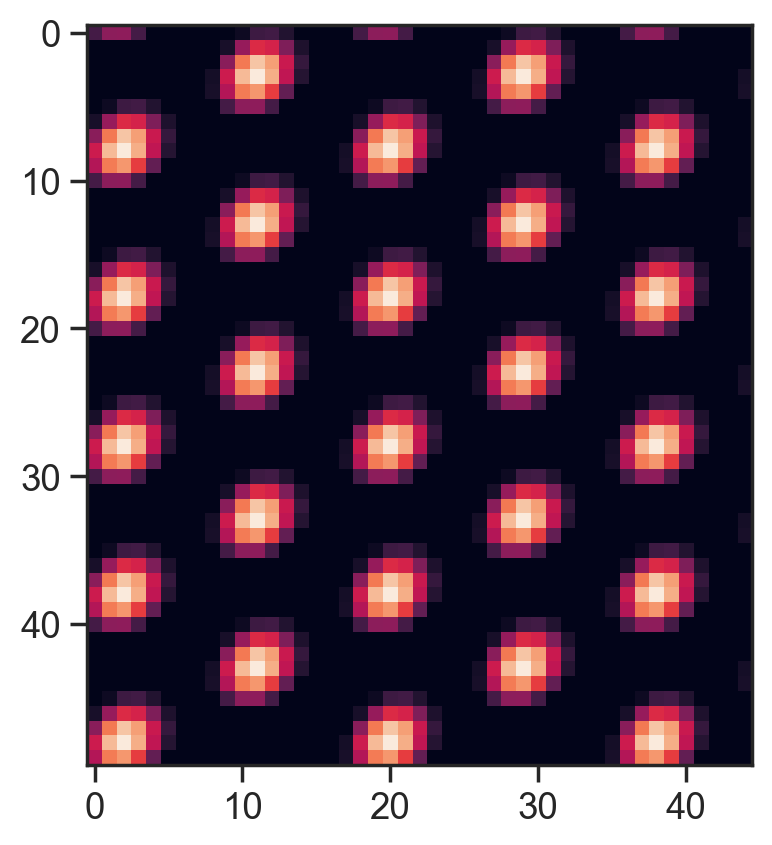

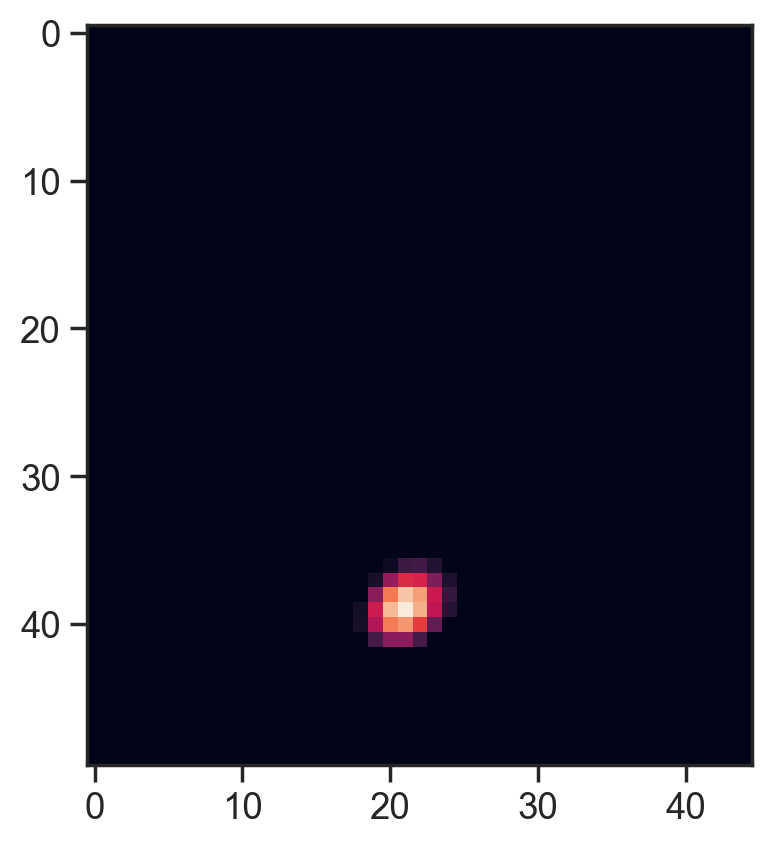

In [4181]:
# new idea: make a larger sheet so don't have to worry about boundaries of x and y
# then, find where to place the bump using copy idx and bump_loc 
# then convolve with a zeros matrix with a one at the bump location

mat = np.zeros((5*n_x, 5*n_y))
bump_loc_x = int(np.round(bump_loc_t[0]) + copy_idx_t[0]*n_x)
bump_loc_y = int(np.round(bump_loc_t[1]) + copy_idx_t[1]*n_y)

mat[bump_loc_x, bump_loc_y] = 1

template_bump = im_copies[bump_loc_x-n_x//2:bump_loc_x+n_x//2,bump_loc_y-n_y//2:bump_loc_y+n_y//2]
plt.figure()
plt.imshow(im_copies)

plt.figure()
# convolve2d(mat, template_bump, mode='full', boundary='fill', fillvalue=0).shape
plt.imshow(convolve2d(mat, template_bump, mode='same', boundary='fill', fillvalue=0))

In [4798]:
def plot_bump_over_time(A, n_x, n_y, bump_loc, n_copies, copy_idx, save_fig=True, save_dir='/', dpi_val=100):
    # this function will plot the bump of activity at each of the timepoints in A
    check_and_make_dir(save_dir)
    if save_fig:
        mpl.rcParams['figure.dpi'] = dpi_val

    n_timebins, N = A.shape
    
    x, y = np.mgrid[:n_copies*resx,:n_copies*resy]/resy
    u, v = coord_from_phase(x+1,y+1)

    # all_colors = np.array([[0.8, 0.25, 0.5, 1],[0.25, 0.8, 0.5, 1], [0.25,0.5,0.8,1]])
    
    try:
        plt.close('all')
        if save_fig:
            matplotlib.use('agg')
        else:
            %matplotlib inline
        
        pid=0
        for t in range(n_timebins):

            fig=plt.figure(figsize=(2*n_x,n_y))

            im = A[t].reshape(n_x,n_y)
            im_copies = np.tile(im, (n_copies, n_copies))
            
            n_flips = n_copies // 2
            for flip_idx in range(n_flips):
                idxs_flip = np.arange((flip_idx*2+1)*n_y,(flip_idx*2+2)*n_y)
                im_copies[:, idxs_flip] = np.roll(im_copies[:, idxs_flip], n_x//2, axis=0)

            bump_loc_t = bump_loc[:,t]
            copy_idx_t = copy_idx[:,t]
            # get template bump 
            # if np.mod(copy_idx_t[1]-1, 2) == 0:
            #     bump_loc_t[0] += n_x // 2 # might need to subtract sometimes?

            bump_loc_x = int(np.round(bump_loc_t[0]) + copy_idx_t[0]*n_x)
            bump_loc_y = int(np.round(bump_loc_t[1]) + copy_idx_t[1]*n_y)
            
            # if np.mod(copy_idx_t[1]-1,2)==0 and t==0:
            #     bump_loc_x += n_x//2

            if t > 0 and np.mod(copy_idx_t[1]-1,2)==0:
                bump_loc_x_candidate1 = bump_loc_x + n_x // 2
                bump_loc_x_candidate2 = bump_loc_x - n_x // 2

                idx_use = np.argmin(np.array([np.abs(bump_loc_x - bump_loc_x_t_minus1),
                                              np.abs(bump_loc_x_candidate1 - bump_loc_x_t_minus1),
                                              np.abs(bump_loc_x_candidate2 - bump_loc_x_t_minus1)]))

                bump_loc_x = [bump_loc_x,bump_loc_x_candidate1,bump_loc_x_candidate2][idx_use]

                bump_loc_y_candidate1 = bump_loc_y + n_y // 2
                bump_loc_y_candidate2 = bump_loc_y - n_y // 2

                idx_use = np.argmin(np.array([np.abs(bump_loc_y - bump_loc_y_t_minus1),
                                              np.abs(bump_loc_y_candidate1 - bump_loc_y_t_minus1),
                                              np.abs(bump_loc_y_candidate2 - bump_loc_y_t_minus1)]))

                bump_loc_y = [bump_loc_y,bump_loc_y_candidate1,bump_loc_y_candidate2][idx_use]


            
            # if np.mod(copy_idx_t[1]-1, 2)==0: # either half shift down or up
            #     if t > 0:
            #         bump_loc_x_candidate1 = bump_loc_x + n_x//2
            #         bump_loc_x_candidate2 = bump_loc_x - n_x//2
            #         idx_use = np.argmin(np.array([np.abs(bump_loc_x - bump_loc_x_t_minus1),
            #                                       np.abs(bump_loc_x_candidate1 - bump_loc_x_t_minus1), 
            #                                       np.abs(bump_loc_x_candidate2 - bump_loc_x_t_minus1)]))
            #         bump_loc_x = [bump_loc_x_unmod,bump_loc_x_candidate1,bump_loc_x_candidate2][idx_use]
                
            # else:
            
            template_bump1 = im_copies[bump_loc_x-n_x//2:bump_loc_x+n_x//2, bump_loc_y-n_y//2:bump_loc_y+n_y//2]
            
            # the maximum of the bump should be at the center of the template
            newx, newy = np.unravel_index(np.argmax(template_bump1), (template_bump1.shape))

            # bump should have been at template_bump.shape//2
            x_center = template_bump1.shape[0]//2
            y_center = template_bump1.shape[1]//2
            diffx = x_center - newx
            diffy = y_center - newy

            bump_loc_x2 = bump_loc_x-diffx
            bump_loc_y2 = bump_loc_y-diffy

            template_bump2 = im_copies[bump_loc_x2-n_x//2:bump_loc_x2+n_x//2, bump_loc_y2-n_y//2:bump_loc_y2+n_y//2]
            
            one_hot = np.zeros((n_copies*n_x, n_copies*n_y))
            one_hot[bump_loc_x2, bump_loc_y2] = 1
            im_one_bump = convolve2d(one_hot, template_bump2, mode='same', boundary='fill', fillvalue=0)

            plt.subplot(1,2,1)
            plt.pcolormesh(u, v, im_one_bump, shading='auto')
            # plt.imshow(template_bump1)
            # plt.title(f'{bump_loc_x, bump_loc_y, x_center, y_center, newx, newy, diffx, diffy}')
            # plt.pcolormesh(u, v, A[t, :].reshape(n_x,n_y), shading='auto')
            plt.axis('off')

            # UNHARDCODE THIS LATER AND CHANGE FIG SIZE BACK TO N_X, N_Y
            plt.subplot(1,2,2)
            # plt.imshow(template_bump2)
            # plt.title(f'{bump_loc_x2, bump_loc_y2}')

            plt.plot(all_poss[0,0,:t, 0], all_poss[0,0,:t,1])
            plt.xlim([0, 50])
            plt.ylim([0, 50])

            # plt.imshow(im_copies)
            # plt.title(f'{copy_idx_t}, {np.round(bump_loc_t)}, bump_loc_x={bump_loc_x}, bump_loc_y={bump_loc_y}')
            # plt.plot(bump_loc_y, bump_loc_x, 'w*', ms=20)
            # for ii in np.arange(1, n_copies):
            #     plt.axvline(n_y*ii, c='w', linestyle='dashed')
            #     plt.axhline(n_x*ii, c='w', linestyle='dashed')

            bump_loc_x_t_minus1 = np.copy(bump_loc_x2)
            bump_loc_y_t_minus1 = np.copy(bump_loc_y2)

            if save_fig:
                img = fig2img(fig)
                img.save(os.path.join(save_dir,f'{pid:04d}.png'), quality=dpi_val)
                plt.close(fig)
            pid+=1
        
    except KeyboardInterrupt:
        print("\nProgram terminated by user.")
        plt.close('all')
        %matplotlib inline     
        mpl.rcParams['figure.dpi'] = 100
    finally:
        print("\nProgram finished.")
        plt.close('all')
        %matplotlib inline       
        mpl.rcParams['figure.dpi'] = 100

In [ ]:
# pickle the variables here!!
# 1 trial each of: dark, 1lm, 2lm, 3lm

start_trial = 0
n_trials_pb_plot = 1

n_trials_plot = 4
# cmap_list = ['Greys', 'Reds', 'Greens', 'Blues', 'Purples']

track_length_plot = 1*track_length

n_windows = n_trials_plot * track_length_plot

n_skip = 1
sigma1 = 2
sigma2 = 2

n_max_copies = 6
distance_counter = 0
star_ms = np.maximum(30/(n_max_copies+1), 4) # might want to change this too if n_max_copies is small like 1 or 2
l_ms = np.maximum(250/(n_max_copies+1), 4) # might want to change this too if n_max_copies is small like 1 or 2

try:
    plt.close('all')
    if save_fig:
        matplotlib.use('agg')
    else:
        %matplotlib inline

    pid=0
    # cmap = mpl.colormaps[cmap_list[t]]
    cmap = mpl.colormaps['Reds']
    colors = cmap(np.linspace(0.2, 0.75, n_trials_plot))

    start_frame = start_trial*track_length
        
    trial_counter = 0

    for i in np.arange(n_windows):
        fig,ax=plt.subplots(1,1,figsize=(3,7.5))
        # plt.imshow(np.zeros((3, 2)), vmin=0, vmax=0)

        # LANDMARK 1
        # can color this cell by A_l (when the neuron is active)
        this_lm_pos=130
        lookahead=40
        shift_factor=0
        if ((i > 960+this_lm_pos-lookahead)):
            val = np.minimum(np.exp(-np.power(0.02*(960+this_lm_pos-i+lookahead-shift_factor),2)), 1)
            plt.plot(0.5, 0.5, 'o', ms=l_ms, mfc=[0.7,0,0,val], mew=1, mec=[0.5, 0.5, 0.5, 1])
            plt.plot(0.5, 0.5, 'o', ms=l_ms*1.25, mfc=[0.7,0,0,val], mew=1, mec=[0.5, 0.5, 0.5, 1])
        elif ((i > 640+this_lm_pos-lookahead)):
            val = np.minimum(np.exp(-np.power(0.02*(640+this_lm_pos-i+lookahead-shift_factor),2)), 1)
            plt.plot(0.5, 0.5, 'o', ms=l_ms, mfc=[0.7,0,0,val], mew=1, mec=[0.5, 0.5, 0.5, 1])
            plt.plot(0.5, 0.5, 'o', ms=l_ms*1.25, mfc=[0.7,0,0,val], mew=1, mec=[0.5, 0.5, 0.5, 1])
        elif ((i > 320+this_lm_pos-lookahead)):
            val = np.minimum(np.exp(-np.power(0.02*(320+this_lm_pos-i+lookahead-shift_factor),2)), 1)
            plt.plot(0.5, 0.5, 'o', ms=l_ms, mfc=[0.7,0,0,val], mew=1, mec=[0.5, 0.5, 0.5, 1])
            plt.plot(0.5, 0.5, 'o', ms=l_ms*1.25, mfc=[0.7,0,0,val], mew=1, mec=[0.5, 0.5, 0.5, 1])
        else:
            plt.plot(0.5, 0.5, 'o', ms=l_ms, mfc=[0,0,0,0], mew=1, mec=[0.5, 0.5, 0.5, 1])
            plt.plot(0.5, 0.5, 'o', ms=l_ms*1.25, mfc=[0,0,0,0], mew=1, mec=[0.5, 0.5, 0.5, 1])


        # LANDMARK 2
        g_lm = 3*(n_x+n_y)
        glm21, glm22 = coord_from_phase((4*resx + phases_all[phase1_use][g_lm])/resx+1, 
                                      (5.5*resy+phases_all[phase2_use][g_lm])/resy+1) 
        # can color this cell by A_l (when the neuron is active)
        this_lm_pos=100
        lookahead=40
        shift_factor=0
        if ((i > 960+this_lm_pos-lookahead)):
            val = np.minimum(np.exp(-np.power(0.02*(960+this_lm_pos-i+lookahead-shift_factor),2)), 1)
            plt.plot(0.5, 2, 'wo', ms=l_ms*1.25, mfc=[0.7,0,0,val], mew=4, mec=[0.75, 0.75, 0.75, 1])
        elif ((i > 640+this_lm_pos-lookahead)):
            val = np.minimum(np.exp(-np.power(0.02*(640+this_lm_pos-i+lookahead-shift_factor),2)), 1)
            plt.plot(0.5, 2, 'wo', ms=l_ms*1.25, mfc=[0.7,0,0,val], mew=4, mec=[0.75, 0.75, 0.75, 1])
        else:
            plt.plot(0.5, 2, 'wo', ms=l_ms*1.25, mfc=[0,0,0,0], mew=4, mec=[0.75, 0.75, 0.75, 1])

        # LANDMARK 3
        g_lm = 3*(n_x+n_y)
        glm31, glm32 = coord_from_phase((5.6*resx + phases_all[phase1_use][g_lm])/resx+1, 
                                      (3.8*resy+phases_all[phase2_use][g_lm])/resy+1) 
        # can color this cell by A_l (when the neuron is active)
        this_lm_pos=40
        lookahead=40
        shift_factor=0
        if ((i > 960+this_lm_pos-lookahead)):
            val = np.minimum(np.exp(-np.power(0.02*(960+this_lm_pos-i+lookahead-shift_factor),2)), 1)
            plt.plot(0.75, 1.25, 'wo', ms=l_ms*1.25, mfc=[0.7,0,0,val], mew=4, mec=[0.5, 0.5, 0.5, 1])
        else:
            plt.plot(0.75, 1.25, 'wo', ms=l_ms*1.25, mfc=[0,0,0,0], mew=4, mec=[0.5, 0.5, 0.5, 1])
            
        plt.axis('off')
        ax.spines[['left','top','right','bottom']].set_visible(False)
        plt.xticks([])
        plt.yticks([])
        plt.title(f'{start}')
        ax.set_xlim([0,1])
        ax.set_ylim([0,2.5])

                     
        if save_fig:
            if pil_use:
                img = fig2img(fig)
                img.save(os.path.join(save_dir,f'{pid:04d}.png'), quality=dpi_val)
                plt.close(fig)
            else:
                plt.savefig(os.path.join(save_dir,f'{pid:04d}.jpg'), dpi=dpi_val)
                # fig.savefig(os.path.join(save_dir,f'{pid:03d}.png'), dpi=dpi_val)
                plt.close(fig)
            
        pid += 1
        if np.mod(i, 320)==0:
            print(f'{i}')

except KeyboardInterrupt:
    print("\nProgram terminated by user.")
    plt.close('all')
    %matplotlib inline     
    mpl.rcParams['figure.dpi'] = 100

finally:
    print("\nProgram finished.")
    plt.close('all')
    %matplotlib inline       
    mpl.rcParams['figure.dpi'] = 100
# 

In [1924]:
pickle_bool = True

if pickle_bool:
    filename = 'D:/Code/bump_video/sim/2d/high_frequency_stable.pkl'
    
    data_dict = {"mean_maps":mean_maps,
                 "spikes":spikes,
                 "A":A, "B":B, "W":W,
                 "scaled_velocity":scaled_velocity,
                 "posx_lin":posx_lin, 
                 "pos":pos,
                 "velocity":velocity,
                 "block_timebin_starts":block_timebin_starts,
                 "l_pos_pb":l_pos_pb,
                 "trials_pb":trials_pb,
                 "n_timebins":n_timebins,
                 "init_state":init_state,
                 "cell_position_diffs":cell_position_diffs,
                 "n_y":n_y, "n_x":n_x, "alpha":alpha, "beta":beta, "I":I,
                 "sigma":sigma_sim, "T_sim":T_sim, "tau":tau, "velocity_gain":velocity_gain,
                 "l_str":l_str, "n_warmup_bins":n_warmup_bins
                 }
    
    
    with open(filename, 'wb') as file:
        pickle.dump(data_dict, file)

    file.close()
    
    # with open(filename, 'rb') as file:
    #   data = pickle.load(file)

In [1914]:
# # cells_use = np.array([n_x*3 + n_y//2, n_x*5 + n_y//4, n_x*5 + n_y//2])

# cells_use = np.array([24, 69, 47])
# x, y = np.mgrid[:n_x,:n_y]/n_y
# u, v = coord_from_phase(x+1,y+1)

# plt.pcolormesh(u, v, A[0,:].reshape(n_x,n_y), shading='auto')
# plt.axis('off')

# all_colors = np.array([[0.8, 0.25, 0.5, 1],[0.25, 0.8, 0.5, 1], [0.25,0.5,0.8,1]])

# for c in range(cells_use.shape[0]):
#     this_cell = cells_use[c]
#     plt.plot(u.reshape(-1)[this_cell], v.reshape(-1)[this_cell], 'o', mec=all_colors[c], mew=6, ms=49, mfc=[0,0,0,0])


In [1925]:
# A version that's generally faster and allows for bump to be tracked simultaneously
pil_use = True
save_fig = True
dpi_val = 100
frame_skips = 15
plot_bins = np.arange(1, n_timebins, frame_skips)
cells_use = np.array([24, 69, 47])
all_colors = np.array([[0.8, 0.25, 0.5, 1],[0.25, 0.8, 0.5, 1], [0.25,0.5,0.8,1]])

spike_thr = 1
for c in range(cells_use.size):
    this_cell = cells_use[c]
    save_dir = f'D:/Code/bump_video/sim/2d/jeffrey_like/fast/cell_{this_cell}'
    
    this_cell_spikes = np.where(spikes[:,this_cell] > spike_thr)[0]
    this_cell_color = all_colors[c]
    
    # plot_bins = np.arange(1,n_timebins, frame_skips)
    rate_map = mean_maps[this_cell,:,:]
    rate_map = np.zeros((2,1))
    
    plot_pos_and_spikes(this_cell_spikes, pos*2, minx/5 - 0.025*maxx/5, 1.025*maxx/5, miny/5 - 0.025*maxy/5, 1.025*maxy/5, plot_bins, rate_map, pil_use, save_fig, save_dir, dpi_val, this_cell_color)

# plt.pcolormesh(u_copies, v_copies, im_copies, shading='auto')

0

Program finished.
0

Program finished.
0

Program finished.


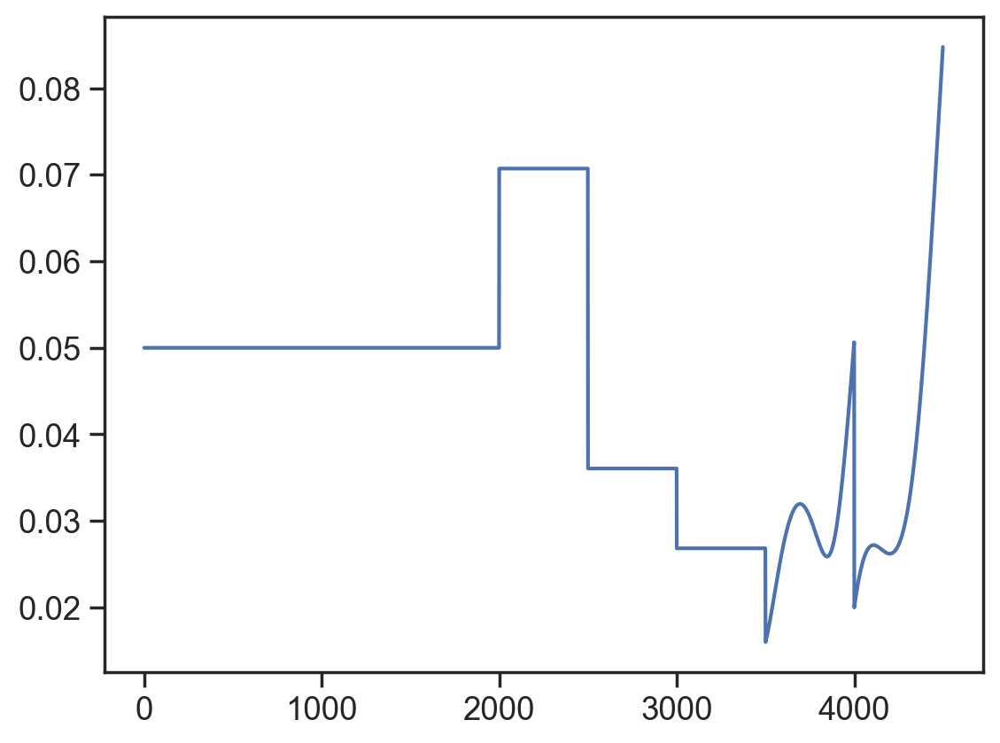

In [1926]:
plt.plot(np.linalg.norm(velocity, axis=1))

In [1927]:
# cells_use = np.array([n_x*3 + n_y//2, n_x*5 + n_y//4, n_x*5 + n_y//2])
x, y = np.mgrid[:n_x,:n_y]/n_y
u, v = coord_from_phase(x+1,y+1)

all_colors = np.array([[0.8, 0.25, 0.5, 1],[0.25, 0.8, 0.5, 1], [0.25,0.5,0.8,1]])

save_dir = f'D:/Code/bump_video/sim/2d/jeffrey_like/fast/bump'

if not os.path.isdir(save_dir):
    os.makedirs(save_dir, exist_ok=True)

pil_use = True
save_fig= True

if pil_use:
    mpl.rcParams['figure.dpi'] = dpi_val
    
try:
    plt.close('all')
    if save_fig:
        matplotlib.use('agg')
    else:
        %matplotlib inline
    
    pid=0
    for t in range(plot_bins.shape[0]):
        pil_use = True
        save_fig = True
        
        this_cell = cells_use[c]

        
        fig=plt.figure(figsize=(n_x,n_y))
        plt.pcolormesh(u, v, A[plot_bins[t],:].reshape(n_x,n_y), shading='auto')
        plt.axis('off')

        for c in range(cells_use.shape[0]):
            this_cell = cells_use[c]
            plt.plot(u.reshape(-1)[this_cell], v.reshape(-1)[this_cell], 'o', mec=all_colors[c], mew=6, ms=49, mfc=[0,0,0,0])
    
        plt.axis('off')
    
        if save_fig:
            if pil_use:
                img = fig2img(fig)
                img.save(os.path.join(save_dir,f'{pid:04d}.png'), quality=dpi_val)
                plt.close(fig)
            else:
                plt.savefig(os.path.join(save_dir,f'{pid:04d}.jpg'), dpi=dpi_val)
                # fig.savefig(os.path.join(save_dir,f'{pid:03d}.png'), dpi=dpi_val)
                plt.close(fig)

        pid+=1
    
except KeyboardInterrupt:
    print("\nProgram terminated by user.")
    plt.close('all')
    %matplotlib inline     
    mpl.rcParams['figure.dpi'] = 100
finally:
    print("\nProgram finished.")
    plt.close('all')
    %matplotlib inline       
    mpl.rcParams['figure.dpi'] = 100


Program finished.


In [1959]:
# cells_use = np.array([n_x*3 + n_y//2, n_x*5 + n_y//4, n_x*5 + n_y//2])
x, y = np.mgrid[:n_x,:n_y]/n_y
u, v = coord_from_phase(x+1,y+1)

all_colors = np.array([[0.8, 0.25, 0.5, 1],[0.25, 0.8, 0.5, 1], [0.25,0.5,0.8,1]])


pil_use = True
save_fig= True

if pil_use:
    mpl.rcParams['figure.dpi'] = dpi_val
    
try:
    plt.close('all')
    if save_fig:
        matplotlib.use('agg')
    else:
        %matplotlib inline
    

    for c in range(cells_use.shape[0]):
        pid=0
        this_cell = cells_use[c]
        
        save_dir = f'D:/Code/bump_video/sim/2d/jeffrey_like/fast/cell_quads/cell_{this_cell}'
        
        if not os.path.isdir(save_dir):
            os.makedirs(save_dir, exist_ok=True)
        
        for t in range(plot_bins.shape[0]):
            pil_use = True
            save_fig = True
            
            fig=plt.figure(figsize=(n_x,n_y))
            zero_mat = np.zeros((n_x, n_y))
            zero_mat[:] = np.nan
            
            a,b = one_to_two_index(this_cell, n_y)
            zero_mat[b,a] = A[plot_bins[t], this_cell]
            plt.pcolormesh(u, v, zero_mat, vmin=0, vmax=45)

            plt.axis('off')
        
            if save_fig:
                if pil_use:
                    img = fig2img(fig)
                    img.save(os.path.join(save_dir,f'{pid:04d}.png'), quality=dpi_val)
                    plt.close(fig)
                else:
                    plt.savefig(os.path.join(save_dir,f'{pid:04d}.jpg'), dpi=dpi_val)
                    # fig.savefig(os.path.join(save_dir,f'{pid:03d}.png'), dpi=dpi_val)
                    plt.close(fig)

            pid+=1
    
except KeyboardInterrupt:
    print("\nProgram terminated by user.")
    plt.close('all')
    %matplotlib inline     
    mpl.rcParams['figure.dpi'] = 100
finally:
    print("\nProgram finished.")
    plt.close('all')
    %matplotlib inline       
    mpl.rcParams['figure.dpi'] = 100


Program finished.


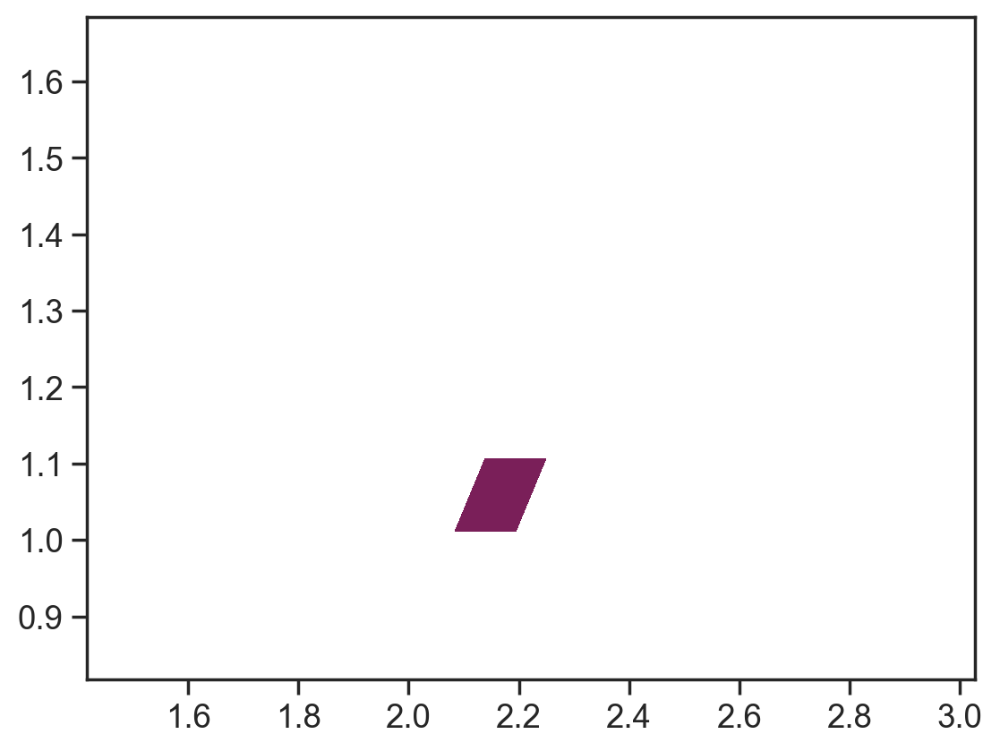

In [1958]:
# plt.pcolormesh(u, v, A[plot_bins[t], :].reshape(n_x,n_y), vmin=0, vmax=45)

zero_mat = np.zeros((n_x, n_y))
zero_mat[:] = np.nan
a,b = one_to_two_index(this_cell, n_y)
zero_mat[b,a] = A[plot_bins[t], this_cell]
plt.pcolormesh(u, v, zero_mat, vmin=0, vmax=45)


# NEED A VERSION WITH DRIFT AND LANDMARK ERROR CORRECTION IN 2D


### Run Simulation

In [704]:
# #1000 x 866
# #100 x 87

# # n_x = 10 # column n
# # n_y = 9 # row n
# n_x = 10 # column n
# n_y = 9 # row n
# # n_x = 6 # column n
# # n_y = 5 # row n
# N = n_x * n_y

# # Update function
# # tau = 0.8 # original
# tau = 0.8 # higher value to stabilize activity. might be necessary for larger N
# I = 0.3
# alpha = 0.08
# # T = 0.05 # original
# T = 0.04
# # sigma = 0.24 # original
# sigma = 0.24

# # if get matmul overflow, try lowering T. might also want to try lowering I? and try increasing tau.

# n_timebins = 10000
# cell_positions = calc_cell_positions(n_y, n_x)
# cell_position_diffs = calc_cell_position_diffs(cell_positions)
# init_state = initialize_network(n_y, n_x, seed=1)
# init_state = init_state.reshape(-1)

# velocity = np.ones((n_timebins, 2))
# # velocity[:, 0] = 0.2*np.sin(np.arange(n_timebins)/1000)+0.4
# velocity[:, 0] = np.sqrt(0.2)/2*np.sin(np.arange(n_timebins)/4000)+np.sqrt(0.2)
# velocity[:, 1] = np.sqrt(np.sqrt(0.4)-np.power(velocity[:, 0], 2))
# s=np.linalg.norm(velocity, axis=1)
# velocity = velocity / (2*s[0])
# # velocity = 0.65*velocity

# velocity_gain = 4
# track_length = 320
# n_warmup_bins = 100
# beta = np.pi/4

# l_pos = np.array([50, 120, 190, 260, 319])
# l_str=5

In [7101]:
# # range can be [0, pi/3) for beta, but better to use [pi/6, pi/3=2pi/6)
# rng = np.random.default_rng(seed=3)

# # beta = np.pi/12 * (np.sin(np.arange(n_timebins,)/1000)) + np.pi/4 # this is drifting too quickly
# # beta = np.pi/12 * (np.sin(np.arange(n_timebins,)/2000)) + np.pi/4 # this is still too fast drift
# # beta = np.pi/12 * (np.sin(np.arange(n_timebins,)/4000)) + np.pi/4 # THIS IS GOOD. WANT TO TRY 0 TO PI/3 NOW THAT PARAMETERS ARE WORKING BETTER
# # beta = np.pi/6.2 * (np.sin(np.arange(n_timebins,)/4000)) + np.pi/6 # THIS IS GOOD WHEN NO NOISE ADDED. MIGHT NEED TO SLOW DOWN STILL THOUGH.
# # beta = np.pi/6.2 * (np.sin(np.arange(n_timebins,)/4000)) + np.pi/6 # THIS IS GOOD WHEN NO NOISE ADDED. MIGHT NEED TO SLOW DOWN STILL THOUGH.

# beta = np.pi/30 * (np.sin(np.arange(n_timebins,)/3031)) + np.pi/20
# beta2 = np.pi/30 * (np.sin(np.arange(n_timebins,)/2489)) + np.pi/20
# beta3 = np.pi/60 * (np.sin(np.arange(n_timebins,)/1285)) + np.pi/20
# beta4 = np.pi/120 * (np.sin(np.arange(n_timebins,)/523)) + np.pi/21
# beta5 = np.pi/150 * (np.sin(np.arange(n_timebins,)/337)) + np.pi/20

# beta = beta+beta2+beta3+beta4+beta5

# timestep_noise = 0.001*rng.standard_normal(size=(n_timebins,))
# # # cumulative_noise = np.cumsum(timestep_noise, axis=0)
# # # cumulative_noise = cumulative_noise.clip(min=-0.15, max=0.75)
# beta = beta+timestep_noise
# beta = beta.clip(min=np.pi/6, max=np.pi/3.05)
# beta = gaussian_filter1d(beta, 50)

# # velocity = velocity + cumulative_noise
# plt.plot(beta)
# plt.plot((1/n_timebins) * np.cumsum(beta, axis=0))
# plt.yticks([0, 0.25, np.pi/6, np.pi/3])
# plt.axhline(0)
# plt.axhline(np.pi/6)
# plt.axhline(np.pi/3)
# # plt.yticks([np.pi/6, np.pi/4, np.pi/3])

In [7102]:
# if not np.isscalar(beta):
#     beta_coeff = np.mean(np.power(np.diff(beta),2))
#     beta_coeff

In [7103]:
# use_profiler = False
# if use_profiler:
#     with Profile() as profile:
#         (A, B, W, 
#          scaled_velocity, posx_lin, posx) = run_sim(n_timebins, init_state, cell_position_diffs, 
#                                                     n_y, n_x, alpha, beta, I, sigma, T, tau, velocity, velocity_gain, 
#                                                     track_length, l_pos, l_str, n_warmup_bins) 
#         (Stats(profile)
#          .strip_dirs()
#          .sort_stats(SortKey.CUMULATIVE)
#          .print_stats(20) # print top 20 functions
#         )
# else:
#         (A, B, W, 
#          scaled_velocity, posx_lin, posx) = run_sim(n_timebins, init_state, cell_position_diffs, 
#                                                     n_y, n_x, alpha, beta, I, sigma, T, tau, velocity, velocity_gain, 
#                                                     track_length, l_pos, l_str, n_warmup_bins) 

### Demonstrate Pinning

(-77.41051487039806,
 1633.3989868714111,
 -77.41051487039806,
 1633.3989868714111)

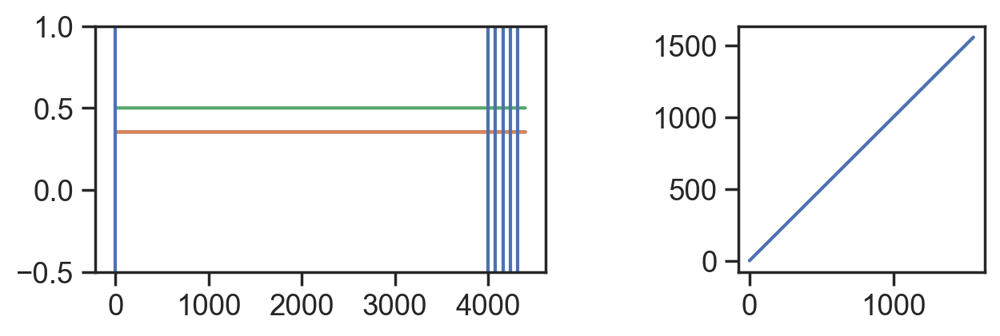

In [5095]:
# run full experiment
n_x = 10 # column n
n_y = 9 # row n
N = n_x * n_y

T_sim = 0.04
sigma_sim = 0.24

cell_positions = calc_cell_positions(n_y, n_x)
cell_position_diffs = calc_cell_position_diffs(cell_positions)
init_state = initialize_network(n_y, n_x, seed=1)
init_state = init_state.reshape(-1)

track_length = 320

# speed of 0.5cm/timebin, with gain of 4, get to 2cm/timebin or gain of 8 to get 4cm/timebin
velocity_gain = 8

trials_pb = np.array([50, 1, 1, 1, 1, 1])
n_timebins_pb = (int(track_length) // (velocity_gain //2)) * trials_pb

# l_pos_pb=np.array([[], [80], [80, 180], [80, 180, 320]], dtype='object')
l_pos_pb=np.array([[], [90], [120], [150], [180], [210]], dtype='object')
# l_pos_pb=np.array([40,80,120,160], dtype='object')


block_timebin_starts = np.concatenate((np.array([0]), np.cumsum(n_timebins_pb)))
n_total_timebins = np.cumsum(n_timebins_pb)[-1]
# velocity_all = np.ones((n_total_timebins, 2))
def relu(x):
    return np.maximum(x, 0)

velocity = np.ones((n_total_timebins,2))*0.5
# velocity[:n_timebins_pb[0]-160, 0] = (-0.5*np.sin(np.arange(n_timebins_pb[0]-160)/320)-0.1) + np.arange(n_timebins_pb[0]-160)/5000
# velocity[:n_timebins_pb[0]-160, 1] = (0.3*np.sin(np.arange(n_timebins_pb[0]-160)/800)+0.4)


# velocity[n_timebins_pb[0]-160:, 0] = 0.3
# velocity[np.cumsum(n_timebins_pb)[1]+42:, 0] = 0.25
# velocity[np.cumsum(n_timebins_pb)[1]+60:, 1] = 

s = np.expand_dims(np.linalg.norm(velocity, axis=1),1)
velocity = np.divide(velocity, 2*s)

mpl.rcParams['figure.dpi'] = 100
plt.figure(figsize=(8,2))
plt.subplot(1,2,1)
plt.plot(velocity[:, 0])
plt.plot(velocity[:, 1])

plt.plot(np.linalg.norm(velocity, axis=1))
# plt.axvline(19200)
plt.ylim([-0.5, 1])
for b in range(block_timebin_starts.shape[0]-1):
    plt.axvline(block_timebin_starts[b])

plt.subplot(1,2,2)
plt.plot(np.cumsum(velocity[:, 0]), np.cumsum(velocity[:, 1]))
plt.axis('square')

In [5096]:
l_pos_pb

array([list([]), list([90]), list([120]), list([150]), list([180]),
       list([210])], dtype=object)

In [5097]:
n_timebins_pb

array([4000,   80,   80,   80,   80,   80])

In [5098]:
# a1,a2=coord_from_phase(phases_all[phase1_use][3*(n_y+n_x)], phases_all[phase2_use][3*(n_y+n_x)])
# atemp=np.array([a1,a2])
# print(atemp)

# bdiff=np.zeros((90,2))
# for i in range(90):
#     b1,b2=coord_from_phase(phases_all[phase1_use][i], phases_all[phase2_use][i]) 
#     bdiff[i] = np.array([b2,b2])- atemp
# plt.plot(bdiff[:,0])
# plt.plot(bdiff[:,1])
# # need a second pinning phase that is larger in phase 1 and 2 (because phases decreasing for this module as goes down track)
# # and the second landmark will be near end of the track like 260
# # cell 48 looks good
# b1,b2=coord_from_phase(phases_all[phase1_use][48], phases_all[phase2_use][48])
# print(b1,b2)

80
block 1 complete
80
block 2 complete
80
block 3 complete
80
block 4 complete
80
block 5 complete


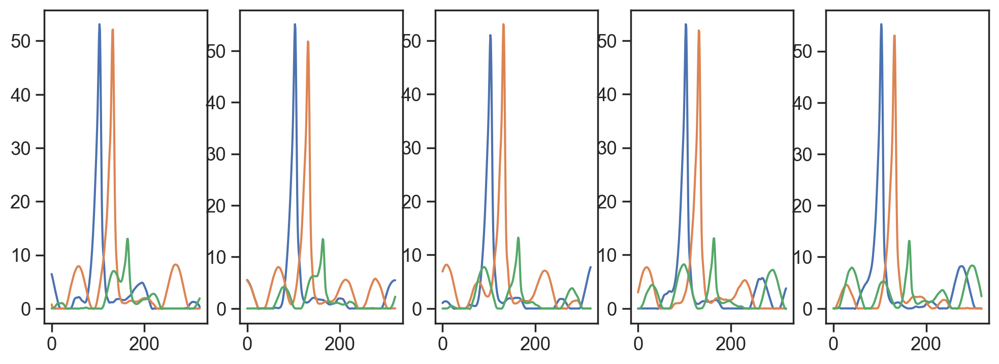

In [5099]:
run_dark = False

A_pb = []
B_pb = []
W_pb = []
A_l_pb = []
W_l_pb = []
posx_pb = []
posx_lin_pb = []
beta_noise = 0.08
weight_noise = 0.05

if run_dark:
    start_block = 0
else:
    start_block = 1
    A_dark=np.copy(A[:n_timebins_pb[0], :])
    B_dark=np.copy(B[:n_timebins_pb[0], :])
    W_dark=np.copy(W[:n_timebins_pb[0], :, :])
    
    A_pb.append(A_dark)
    B_pb.append(B_dark)
    W_pb.append(W_dark)

for block in np.arange(start_block, trials_pb.shape[0]):

    if (block==0):
        init_state = initialize_network(n_y, n_x, seed=1)
        init_state = init_state.reshape(-1)
        init_state = init_state
        n_warmup_bins = 100
        B0 = np.zeros((N,))
    else:
        init_state = A_pb[block-1][-1, :]
        n_warmup_bins = 0
        B0 = B_pb[block-1][-1, :]


    block_v = velocity[block_timebin_starts[block]:block_timebin_starts[block+1], :]
    l_pos = np.array(l_pos_pb[block])
    
    l_str_block = 10
        
    # n_timebins = n_timebins_pb[block]

    # if (block == 0):
    #     alpha = 0.165
    #     tau = 0.85
    #     T_sim = 0.04
    #     I = 0.27
    # elif (block==2):
    #     tau = 0.85
    #     beta = 0
    #     I = 0.27
    # else:
    #     alpha = 0.165
    #     tau = 0.85
    #     T_sim = 0.04
    #     I= 0.27

    (A, B, W, 
     scaled_velocity, 
     posx_lin, posx, A_l, W_l) = run_sim(n_timebins_pb[block], init_state, cell_position_diffs, 
                                         n_y, n_x, alpha, beta, I, sigma_sim, T_sim, tau, block_v, velocity_gain, 
                                         track_length, l_pos, l_str_block, n_warmup_bins, B0, beta_noise, weight_noise)
    A_pb.append(A)
    B_pb.append(B)
    W_pb.append(W)
    A_l_pb.append(A_l)
    W_l_pb.append(W_l)
    posx_pb.append(posx)
    posx_lin_pb.append(posx_lin)
    
    print(f'block {block} complete')

A = np.vstack(A_pb)
B = np.vstack(B_pb)
W = np.vstack(W_pb)
# A_l_pb = np.vstack(A_l_pb)
# W_l_pb = np.vstack(W_l_pb)

tpb_cs = np.cumsum(trials_pb)
spatial_bin = 1
n_total_timebins = A.shape[0]
raw_maps, posx_lin, posx = calc_maps(A, track_length, spatial_bin, velocity_gain)


plt.figure(figsize=(12,4))
for c in range(5):
    plt.subplot(1,5,c+1)
    for i in range(3):
        plt.plot(raw_maps[c*2, tpb_cs[1]-1+i, :])



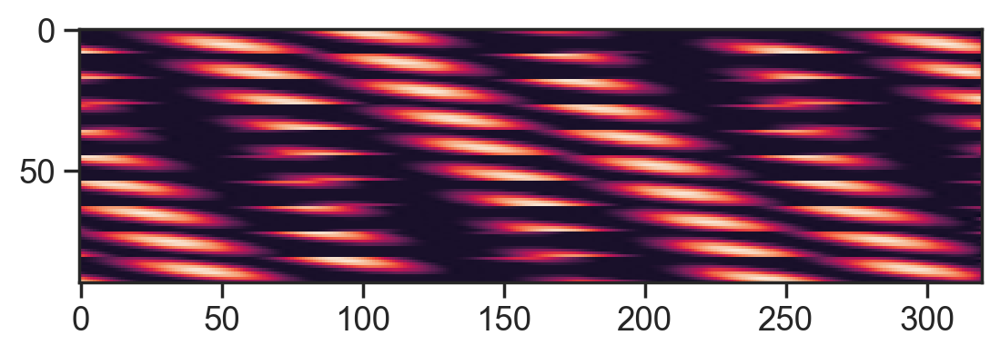

In [5100]:
# look at cells activity for a given trial
plt.imshow(raw_maps[:,4,:])

In [5092]:
# # plt.plot(np.sum(W_l[:, 0, :], axis=0))
# # plt.plot(np.sum(W_l[:, 1, :], axis=0))
# plt.plot(A_l[:80, 0])
# plt.plot(A_l[:80, 1])
# plt.plot(A_l[:80, 2])

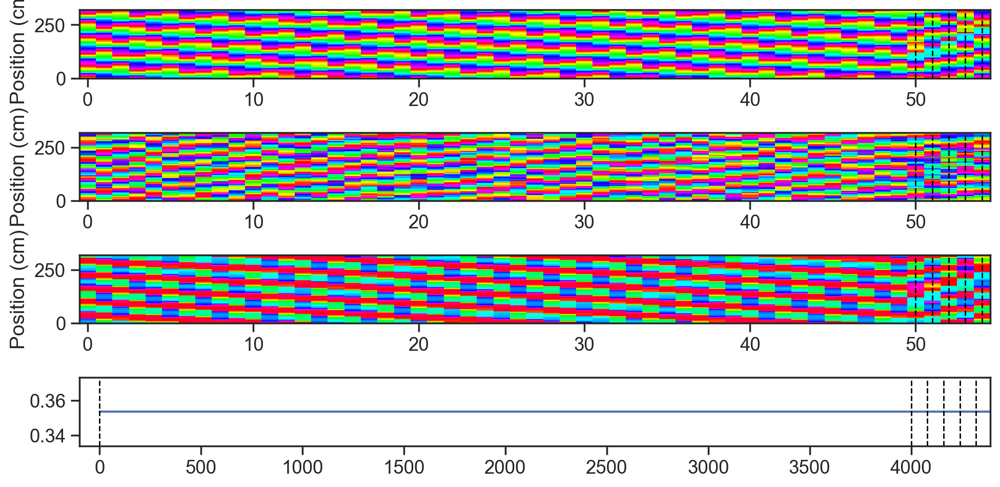

In [5101]:
if not run_dark:
    N, n_trials, L = raw_maps.shape
    sigma=2/spatial_bin
    smooth_times=1
    flattened_maps = raw_maps.reshape(N, -1)
    
    for smooth_time in np.arange(smooth_times):
      flattened_maps = gaussian_filter1d(flattened_maps, sigma)
    
    mean = np.expand_dims(np.nanmean(flattened_maps, axis=1), axis=1)
    std = np.expand_dims(np.nanstd(flattened_maps, axis=1), axis=1)
    std[std==0] = 1
    zmaps = (((flattened_maps-mean)/std).reshape(N, raw_maps.shape[1], -1))

    sigma = 0
    # sigma = 3
    n_smooth_times = 1
    trial_starts = np.array([0, n_trials])
    vr_maps = np.copy(zmaps.reshape(Ng,-1))
    
    plt.figure(figsize=(10,5))
    n_trials_per_period = 1
    # vr_maps = demo_zmaps[grid_cell_idxs].reshape(Ng,-1)
    
    all_angles = []
    
    all_u = []
    all_v = []
    
    for i,phases in enumerate(phases_all):
      plt.subplot(4,1,i+1)
      u = np.cos(phases)@vr_maps
      v = np.sin(phases)@vr_maps
    
      u = u.reshape(-1,n_trials_per_period*raw_maps.shape[2])
      v = v.reshape(-1,n_trials_per_period*raw_maps.shape[2])
    
      angle = np.arctan2(v,u)
      all_angles.append(angle)
    
      all_u.append(u)
      all_v.append(v)
    
      plt.pcolormesh(np.arange(n_trials//n_trials_per_period),np.arange(n_trials_per_period*raw_maps.shape[2]),angle.T,cmap='hsv',)
      # plt.pcolormesh(np.arange(n_trials//n_trials_per_period),np.arange(n_trials_per_period*L*2),angle.T,cmap='hsv',)
    
    
      plt.ylabel('Position (cm)')
    
      for j,trial in enumerate(np.cumsum(trials_pb[:-1])):
        plt.axvline(trial//n_trials_per_period,c='black',linestyle='dashed',linewidth=1)
    
    plt.subplot(4,1,4)
    plt.plot(velocity[:, 0])
    for b in range(trials_pb.shape[0]):
        plt.axvline(block_timebin_starts[b], c='black',linestyle='dashed',linewidth=1)
    plt.xlim([-100, velocity.shape[0]-10])
      # # Plot landmarks
      # for j in range(len(landmark_positions)):
      #   for a,lm in enumerate(landmark_positions[j]):
      #     plt.axhline(lm,trial_starts[j]/(n_trials*n_trials_per_period),
      #                 trial_starts[j+1]/(n_trials*n_trials_per_period),
      #                 c='C'+str(a),linewidth=1,linestyle='dashed')
      #     plt.axhline(lm,trial_starts[j]/(2*n_trials),
      #           trial_starts[j+1]/(2*n_trials),
      #           c='C'+str(a),linewidth=1,linestyle='dashed')
    
    # plt.suptitle(fname)
    plt.tight_layout()
    
    all_angles = np.stack(all_angles)
    all_u = np.stack(all_u)
    all_v = np.stack(all_v)

### Run Experiment Simulation

In [ ]:
# run full experiment

n_x = 10 # column n
n_y = 9 # row n
N = n_x * n_y

tau = 0.86 # higher value to stabilize activity. might be necessary for larger N
I = 0.3
alpha = 0.091
T_sim = 0.04
sigma_sim = 0.24

cell_positions = calc_cell_positions(n_y, n_x)
cell_position_diffs = calc_cell_position_diffs(cell_positions)
init_state = initialize_network(n_y, n_x, seed=1)
init_state = init_state.reshape(-1)

track_length = 320
beta_base = 0
# beta_base = np.pi/4

# blocks to include:
# 0. dark; 1. reward; 2. reward T1; 3. reward T2; 4. reward T3; 5. reward T2a


# speed of 0.5cm/timebin, with gain of 4, get to 2cm/timebin or gain of 8 to get 4cm/timebin
velocity_gain = 8

trials_pb = np.array([60, 10, 10, 10, 10, 10])
n_timebins_pb = (int(track_length) // (velocity_gain //2)) * trials_pb

l_pos_pb=np.array([[], [319], [50, 319], 
                   [50, 120, 319], 
                   [50, 120, 190, 319], 
                   [50, 120, 190, 260, 319], 
                   [50, 120, 190, 319]], dtype='object')

block_timebin_starts = np.concatenate((np.array([0]), np.cumsum(n_timebins_pb)))
n_total_timebins = np.cumsum(n_timebins_pb)[-1]
# velocity_all = np.ones((n_total_timebins, 2))
def relu(x):
    return np.maximum(x, 0)

v0 = np.zeros((block_timebin_starts[3], 2))
# v0[:, 0] = np.sqrt(0.2)/2*np.sin(np.arange(block_timebin_starts[3])/1600)+np.sqrt(0.2) # ORIGINAL
v0[:, 0] = np.power(np.arctan(np.exp(np.sqrt(1.1)/2*np.sin(np.arange(9000, block_timebin_starts[3]+9000)/2000)+np.sqrt(0.3))),2)
v0[:, 1] = np.sqrt(2.5-np.power(v0[:, 0], 2))
# v0[:, 1] = np.sqrt(np.sqrt(0.2)-np.power(v0[:, 0], 2)) # ORIGINAL
v0[:, :] = v0[:, :] + np.expand_dims(0.05*np.power(2*np.sin(relu(np.arange(-block_timebin_starts[3]//2, block_timebin_starts[3]//2)/800)), 2), 1)
v0[:, :] = v0[:, :] + np.expand_dims(0.05*np.power(2*np.cos(np.arange(block_timebin_starts[3])/500), 2), 1)

# s=np.linalg.norm(v0, axis=1)
# v0 = v0 / (2*s[0])

# v1 = np.zeros((block_timebin_starts[4]+80-block_timebin_starts[3], 2))
# v1[:, 0] = np.sqrt(0.2)/2*np.sin(np.linspace((block_timebin_starts[6]+800)/730+0.45,(block_timebin_starts[6]+800)/730+0.452, v1.shape[0]))+np.sqrt(0.43)
# v1[:, 1] = np.sqrt(np.sqrt(0.4)-np.power(v1[:, 0], 2))

# # still depends on heading stabilizatino by landmarks
# v2=np.ones((block_timebin_starts[5]-block_timebin_starts[4], 2))
# v2[:, 0] = np.sqrt(0.2)/2*np.sin(np.linspace((block_timebin_starts[6]+800)/730+0.45,(block_timebin_starts[6]+800)/730+0.452, v2.shape[0]))+np.sqrt(0.44)
# v2[:, 1] = np.sqrt(np.sqrt(0.4)-np.power(v2[:, 0], 2))

# v3=np.ones((block_timebin_starts[6]-block_timebin_starts[5]-80, 2))
# v3[:, 0] = np.sqrt(0.2)/2*np.sin(np.linspace((block_timebin_starts[6]+800)/730+0.45,(block_timebin_starts[6]+800)/730+0.452, v3.shape[0]))+np.sqrt(0.45)
# v3[:, 1] = np.sqrt(np.sqrt(0.4)-np.power(v3[:, 0], 2))

v1 = np.ones((n_total_timebins - block_timebin_starts[3], 2))*v0[-1, :]
velocity = np.concatenate((v0, v1))

# velocity = np.concatenate((v0, v1, v2, v3))

s = np.expand_dims(np.linalg.norm(velocity, axis=1),1)
velocity = np.divide(velocity, 2*s)



plt.figure(figsize=(10,4))
plt.subplot(1,2,1)
plt.plot(velocity[:, 0])
plt.plot(velocity[:, 1])

plt.plot(np.linalg.norm(velocity, axis=1))
# plt.axvline(19200)
plt.ylim([0, 1])
for b in range(block_timebin_starts.shape[0]-1):
    plt.axvline(block_timebin_starts[b])

plt.subplot(1,2,2)
plt.plot(np.cumsum(velocity[:, 0]), np.cumsum(velocity[:, 1]))
plt.axis('square')

In [7084]:
# # Check out landmark activity matrix 
# l_pos = np.array(l_pos_pb[5])

# n_landmarks = l_pos.shape[0]
# posx_test = np.arange(0, 320, 4.)
# n_bins = posx_test.shape[0]
# l_pos_all = np.tile(np.expand_dims(l_pos, 0), (n_bins,1))
# posx_all = np.tile(np.expand_dims(posx_test, 1), (1,n_landmarks))
# pos_from_l = posx_all - l_pos_all

# a=(pos_from_l>-20)*(pos_from_l<10)
# b=(pos_from_l<=-20)+(pos_from_l>=10)
# pos_from_l[b] = -np.inf
# A_l = l_str * np.exp(-np.power(0.1*(pos_from_l),2))

# for l in range(n_landmarks):
#     plt.plot(posx_test, A_l[:, l])

In [7085]:
# plt.figure(figsize=(4,2))
# plt.plot(np.arange(block_timebin_starts[3], velocity.shape[0]), velocity[block_timebin_starts[3]:, 0])
# plt.plot(np.arange(block_timebin_starts[3], velocity.shape[0]), velocity[block_timebin_starts[3]:, 1])

# # plt.plot(np.linalg.norm(velocity, axis=1))
# # plt.axvline(19200)
# # plt.ylim([0, 1])
# for b in range(4):
#     plt.axvline(block_timebin_starts[3+b])
#     plt.axvline(block_timebin_starts[3+b]+80)


block 1 complete
block 2 complete
block 3 complete
block 4 complete
block 5 complete


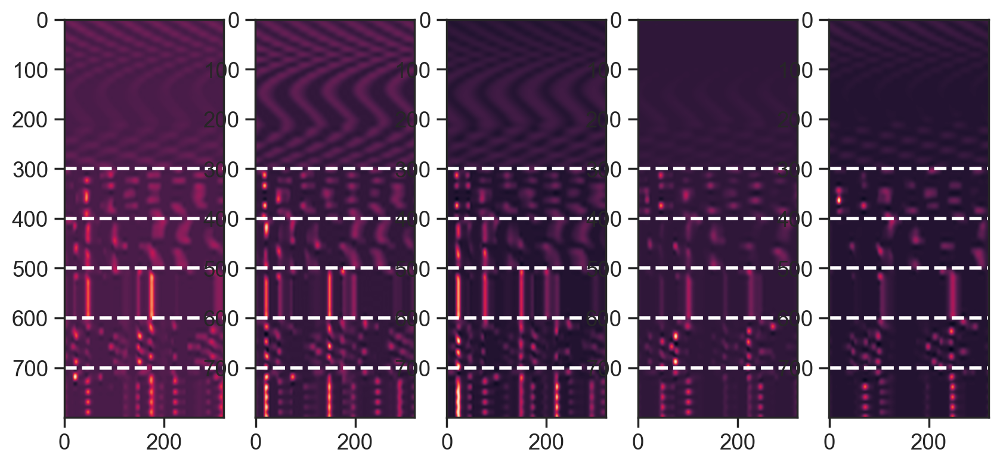

In [7562]:
run_dark = False

A_pb = []
B_pb = []
W_pb = []
A_l_pb = []
W_l_pb = []
posx_pb = []
posx_lin_pb = []

if run_dark:
    start_block = 0
else:
    start_block = 1
    A_dark=np.copy(A[:n_timebins_pb[0], :])
    B_dark=np.copy(B[:n_timebins_pb[0], :])
    W_dark=np.copy(W[:n_timebins_pb[0], :, :])
    
    A_pb.append(A_dark)
    B_pb.append(B_dark)
    W_pb.append(W_dark)

for block in np.arange(start_block, 6):

    if (block==0):
        init_state = initialize_network(n_y, n_x, seed=1)
        init_state = init_state.reshape(-1)
        init_state = init_state
        n_warmup_bins = 100
    else:
        init_state = A_pb[block-1][-1, :]
        n_warmup_bins = 0

    block_v = velocity[block_timebin_starts[block]:block_timebin_starts[block+1], :]
    l_pos = np.array(l_pos_pb[block])
    
    # modulate strength of landmarks by # of landmarks
    l_str = 14
    if l_pos.size > 3:
        l_str_block = l_str - (l_pos.size-1)
        # l_str_block = l_str
    else:
        l_str_block = l_str
        
    n_timebins = n_timebins_pb[block]

    if (block == 0):
        alpha = 0.2
        beta = 0.003
        tau = 0.9
        T_sim = 0.04
        I = 0.31
    elif (block == 4):
        alpha=0.3
        beta=0.0001
        tau = 0.95
        T_sim = 0.04
        I = 0.2
    else:
        alpha = 0.275
        beta = 0
        tau = 0.95
        T_sim = 0.04
        I= 0.2

    (A, B, W, 
     scaled_velocity, 
     posx_lin, posx, A_l, W_l) = run_sim(n_timebins, init_state, cell_position_diffs, 
                                         n_y, n_x, alpha, beta, I, sigma_sim, T_sim, tau, block_v, velocity_gain, 
                                         track_length, l_pos, l_str_block, n_warmup_bins) 
    A_pb.append(A)
    B_pb.append(B)
    W_pb.append(W)
    A_l_pb.append(A_l)
    W_l_pb.append(W_l)
    posx_pb.append(posx)
    posx_lin_pb.append(posx_lin)
    
    print(f'block {block} complete')

A = np.vstack(A_pb)
B = np.vstack(B_pb)
W = np.vstack(W_pb)
# A_l_pb = np.vstack(A_l_pb)
# W_l_pb = np.vstack(W_l_pb)

tpb_cs = np.cumsum(trials_pb)
spatial_bin = 1
n_total_timebins = A.shape[0]
raw_maps, posx_lin, posx = calc_maps(A, track_length, spatial_bin, velocity_gain)

plt.figure(figsize=(10,5))
for i in range(5):
    zoom_factor=10
    start_trial=30
    plt.subplot(1,5,i+1)
    plt.imshow(zoom(raw_maps[12*i,start_trial:,:], (zoom_factor,1)))

    for j,trial in enumerate(zoom_factor*(tpb_cs-start_trial)[:-1]):
        plt.axhline(trial,c='white',linestyle='dashed',linewidth=2)

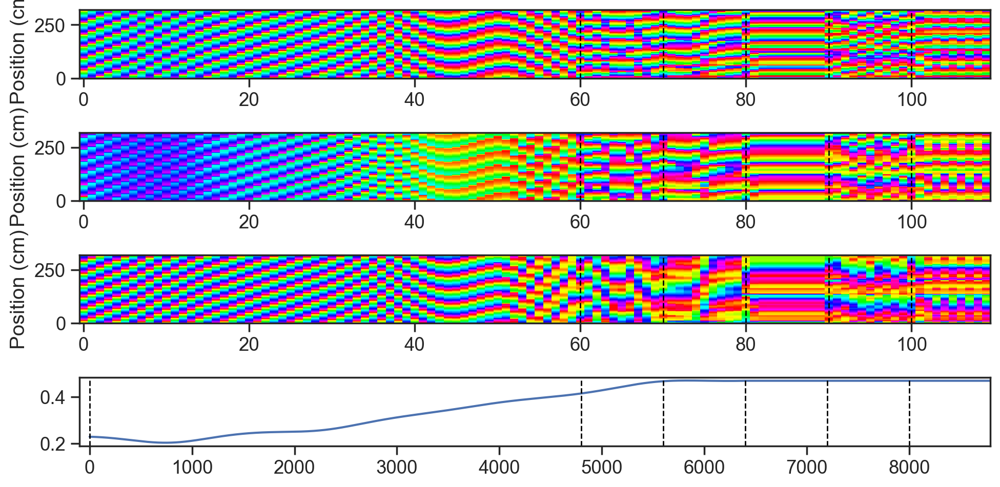

In [7563]:
if not run_dark:
    N, n_trials, L = raw_maps.shape
    sigma=2/spatial_bin
    smooth_times=1
    flattened_maps = raw_maps.reshape(N, -1)
    
    for smooth_time in np.arange(smooth_times):
      flattened_maps = gaussian_filter1d(flattened_maps, sigma)
    
    mean = np.expand_dims(np.nanmean(flattened_maps, axis=1), axis=1)
    std = np.expand_dims(np.nanstd(flattened_maps, axis=1), axis=1)
    std[std==0] = 1
    zmaps = (((flattened_maps-mean)/std).reshape(N, raw_maps.shape[1], -1))

    sigma = 0
    # sigma = 3
    n_smooth_times = 1
    trial_starts = np.array([0, n_trials])
    vr_maps = np.copy(zmaps.reshape(Ng,-1))
    
    plt.figure(figsize=(10,5))
    n_trials_per_period = 1
    # vr_maps = demo_zmaps[grid_cell_idxs].reshape(Ng,-1)
    
    all_angles = []
    
    all_u = []
    all_v = []
    
    for i,phases in enumerate(phases_all):
      plt.subplot(4,1,i+1)
      u = np.cos(phases)@vr_maps
      v = np.sin(phases)@vr_maps
    
      u = u.reshape(-1,n_trials_per_period*raw_maps.shape[2])
      v = v.reshape(-1,n_trials_per_period*raw_maps.shape[2])
    
      angle = np.arctan2(v,u)
      all_angles.append(angle)
    
      all_u.append(u)
      all_v.append(v)
    
      plt.pcolormesh(np.arange(n_trials//n_trials_per_period),np.arange(n_trials_per_period*raw_maps.shape[2]),angle.T,cmap='hsv',)
      # plt.pcolormesh(np.arange(n_trials//n_trials_per_period),np.arange(n_trials_per_period*L*2),angle.T,cmap='hsv',)
    
    
      plt.ylabel('Position (cm)')
    
      for j,trial in enumerate(np.cumsum(trials_pb[:-1])):
        plt.axvline(trial//n_trials_per_period,c='black',linestyle='dashed',linewidth=1)
    
    plt.subplot(4,1,4)
    plt.plot(velocity[:, 0])
    for b in range(6):
        plt.axvline(block_timebin_starts[b], c='black',linestyle='dashed',linewidth=1)
    plt.xlim([-100, velocity.shape[0]-10])
      # # Plot landmarks
      # for j in range(len(landmark_positions)):
      #   for a,lm in enumerate(landmark_positions[j]):
      #     plt.axhline(lm,trial_starts[j]/(n_trials*n_trials_per_period),
      #                 trial_starts[j+1]/(n_trials*n_trials_per_period),
      #                 c='C'+str(a),linewidth=1,linestyle='dashed')
      #     plt.axhline(lm,trial_starts[j]/(2*n_trials),
      #           trial_starts[j+1]/(2*n_trials),
      #           c='C'+str(a),linewidth=1,linestyle='dashed')
    
    # plt.suptitle(fname)
    plt.tight_layout()
    
    all_angles = np.stack(all_angles)
    all_u = np.stack(all_u)
    all_v = np.stack(all_v)

In [7364]:
# # run with dark block
# A_pb = []
# B_pb = []
# W_pb = []

# for block in np.arange(0,6):
#     if (block==0):
#         init_state = init_state
#         n_warmup_bins = 100
#     else:
#         init_state = A_pb[block-1][-1, :]
#         n_warmup_bins = 0

#     block_v = velocity[block_timebin_starts[block]:block_timebin_starts[block+1], :]
#     l_pos = np.array(l_pos_pb[block])
#     n_timebins = n_timebins_pb[block]

#     if (block == 3):
#         alpha = 0.086
#         beta = beta_base
#     if (block == 4):
#         alpha = 0.085
#         # beta = beta_base

#         # alpha = 0.09
#         beta = beta_base+0.1
#     else:
#         alpha = 0.087
#         beta = beta_base
        
#     (A, B, W, 
#              scaled_velocity, posx_lin, posx) = run_sim(n_timebins, init_state, cell_position_diffs, 
#                                                         n_y, n_x, alpha, beta, I, sigma_sim, T_sim, tau, block_v, velocity_gain, 
#                                                         track_length, l_pos, l_str, n_warmup_bins) 
#     A_pb.append(A)
#     B_pb.append(B)
#     W_pb.append(W)
#     print(f'block {block} complete')

# A = np.vstack(A_pb)
# B = np.vstack(B_pb)
# W = np.vstack(W_pb)

In [7365]:
# plt.figure(figsize=(6, 6))
# for block in range(6):
#     plt.subplot(3,2,block+1)
#     dat=A_pb[block]
#     plt.imshow(dat[::20,:].T)

C:\Users\johnh\.conda\envs\si_env\Lib\site-packages\matplotlib\_tight_bbox.py:67: RuntimeWarning: divide by zero encountered in scalar divide
  fig.patch.set_bounds(x0 / w1, y0 / h1,
C:\Users\johnh\.conda\envs\si_env\Lib\site-packages\matplotlib\_tight_bbox.py:68: RuntimeWarning: divide by zero encountered in scalar divide
  fig.bbox.width / w1, fig.bbox.height / h1)
C:\Users\johnh\.conda\envs\si_env\Lib\site-packages\matplotlib\patches.py:786: RuntimeWarning: invalid value encountered in scalar add
  x1 = self.convert_xunits(self._x0 + self._width)
C:\Users\johnh\.conda\envs\si_env\Lib\site-packages\matplotlib\transforms.py:2048: RuntimeWarning: invalid value encountered in scalar add
  self._mtx[0, 2] += tx


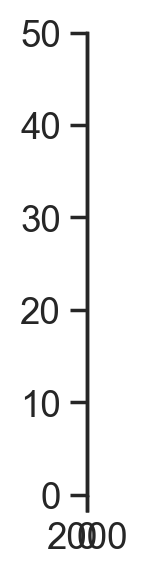

In [11180]:
plt.figure(figsize=(n_timebins//200,3))
for i in range(9):
    plt.plot(A[0:, 10*i])
plt.ylim([0,50])
plt.plot(beta*5)
# plt.plot(np.diff(beta)*10000+5)

In [7565]:
# plt.figure(figsize=(5,4))
# for i in range(25):
#     plt.subplot(5, 5,i+1)
#     plt.imshow(A[i*20,:].reshape(n_y, n_x))

In [7566]:
# h=plt.hist(raw_maps.reshape(-1), 100)

In [7567]:
# first, try adding landmark inputs, see if can still stabilize activity (sweep across some tau and alpha values). make sure they work for non-landmark input conditions too
# then, run simulation with smaller set of those parameters, store in array containing all experiments, and pickle that at the end

# PSDs and Grid Cells

In [5070]:
# raw_maps = np.copy(A_1d)
n_trials = raw_maps.shape[1]
n_bins = raw_maps.shape[0]
# n_trials = n_bins//320
raw_maps = raw_maps[:n_trials*320, :].T
raw_maps = raw_maps.reshape(90, n_trials, 320)

In [5071]:
N, n_trials, L = raw_maps.shape
spatial_bin=1
sigma=2/spatial_bin
smooth_times=1

flattened_maps = raw_maps.reshape(N, -1)

for smooth_time in np.arange(smooth_times):
  flattened_maps = gaussian_filter1d(flattened_maps, sigma)

mean = np.expand_dims(np.nanmean(flattened_maps, axis=1), axis=1)
std = np.expand_dims(np.nanstd(flattened_maps, axis=1), axis=1)
std[std==0] = 1
zmaps = (((flattened_maps-mean)/std).reshape(N, raw_maps.shape[1], -1))

dat = np.copy(zmaps)
print(f'N={N}, n_trials={n_trials}, L={L}')

N=90, n_trials=53, L=320


Keeping 1 of 1 modules
90 grid cells


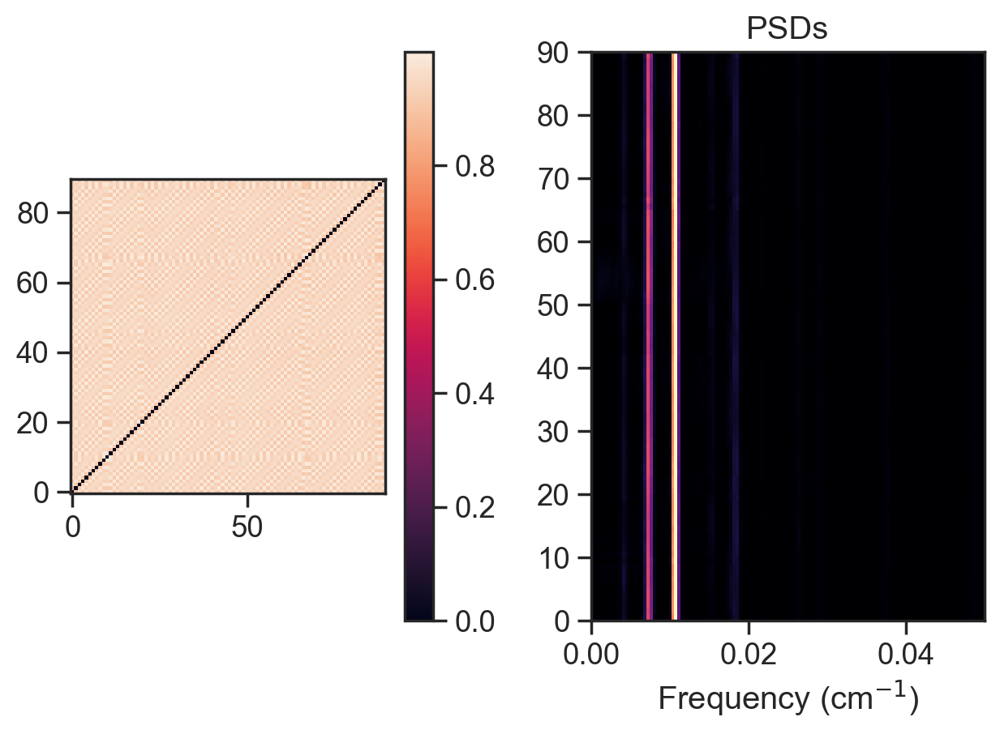

In [5072]:
# These first two are most sensitive, try different values
k=1 # max num clusters
n_trialsperseg=8
n_trialsoverlap=6

nperseg=n_trialsperseg*L//spatial_bin  # spectrogram resolution (higher means )
noverlap=n_trialsoverlap*L//spatial_bin

start_trial=0
end_trial=trials_pb[0]

# Thes
min_freq = 1/1000   # cm^-1
max_freq = 1/20 # cm^-1

# Spectrograms
Sxs = []
phase_grams = []
for mp in dat:
    f,t,Sxx = spectrogram(mp.ravel(),nperseg=nperseg,noverlap=noverlap, fs=1/spatial_bin)
    _,_,phase_gram = spectrogram(mp.ravel(),nperseg=nperseg,mode='angle',noverlap=noverlap, fs=1/spatial_bin)

    Sxs.append(Sxx[(min_freq<f)*(f<max_freq)])
    phase_grams.append(phase_gram[(min_freq<f)*(f<max_freq)])
phase_grams = np.stack(phase_grams).T
Sxs = np.stack(Sxs)
Sxs /= (np.linalg.norm(Sxs,axis=1,keepdims=True)+1e-5)
Sxs = np.nan_to_num(Sxs)
fvalid = f[(min_freq<f)*(f<max_freq)]
cutoff_idx = np.where(min_freq<f)[0][0]

dark_idxs = np.concatenate([np.where((t/L>start_trial)*(t/L<end_trial))[0]])
RR = np.corrcoef(Sxs[:,:,dark_idxs].reshape(N,-1))
np.fill_diagonal(RR,0)

# Cluster by spectrograms
kmeans = KMeans(n_clusters=k)
kmeans.fit(Sxs[:,:,dark_idxs].reshape(N,-1))
counts = [np.sum(kmeans.labels_==i) for i in np.arange(k)]
sort = np.argsort(kmeans.labels_)

# Keep only the modules w high similarity in the dark
avg_corrs = []
for mi in np.arange(k):
    grid_cell_idxs = np.where(kmeans.labels_==mi)[0]
    avg_corrs.append(RR[grid_cell_idxs][:,grid_cell_idxs].mean())
avg_corrs = np.stack(avg_corrs)
module_idxs = np.where(avg_corrs>0.20)[0] # lower this 0.20 threshold if not getting any grid cells
print('Keeping {} of {} modules'.format(len(module_idxs),k))
kvalid = len(module_idxs)

# PSDs
from scipy.signal import welch
PSDs = []

for mp in dat[:,start_trial:end_trial,:].reshape(N,-1):
#for mp in maps[:,trials_use].reshape(N,-1):
    # f,Pxx = welch(mp,fs=1/spatial_bin)
    f,Pxx = welch(mp,nperseg=nperseg,fs=1/spatial_bin)

    PSDs.append(Pxx)
PSDs = np.stack(PSDs)
PSDs /= (np.linalg.norm(PSDs,axis=-1,keepdims=True)+1e-5)
PSDs = np.nan_to_num(PSDs)

plt.subplot(121)
plt.imshow(RR[sort][:,sort],origin='lower')
for i in np.cumsum(counts)[:-1]:
    plt.axvline(i,c='red',linestyle='dashed')
    plt.axhline(i,c='red',linestyle='dashed')
plt.colorbar()

plt.subplot(122)
plt.imshow(PSDs[sort][:,f<max_freq],aspect='auto',extent=(0,max_freq,0,N),
           cmap='magma',vmax=0.5,origin='lower')
for i in np.cumsum(counts)[:-1]:
    plt.axhline(i,c='red',linestyle='dashed')
plt.title('PSDs')
plt.xlabel(r'Frequency (cm$^{-1}$)');
plt.tight_layout()
# for i in range(1,8):
#   plt.axvline(i/L,c='red',linestyle='dashed',linewidth=1)

all_grid_cell_idxs_list = []
Ng_per_mod = []
mi_per_mod = []
for grid_module in np.arange(len(module_idxs)):
  mi = module_idxs[grid_module]
  grid_cell_idxs = np.where(kmeans.labels_==mi)[0]
  all_grid_cell_idxs_list.append(grid_cell_idxs)
  Ng_per_mod.append(grid_cell_idxs.shape[0])
  mi_per_mod.append(module_idxs[grid_module])

all_grid_cell_idxs = np.hstack(all_grid_cell_idxs_list)
Ng_per_mod = np.array(Ng_per_mod)
mi_per_mod = np.array(mi_per_mod)
mi=mi_per_mod[np.argmax(Ng_per_mod)]
grid_cell_idxs = np.where(kmeans.labels_==mi)[0]
Ng = len(grid_cell_idxs)
print(f'{Ng} grid cells')

scale=49.295324903658695


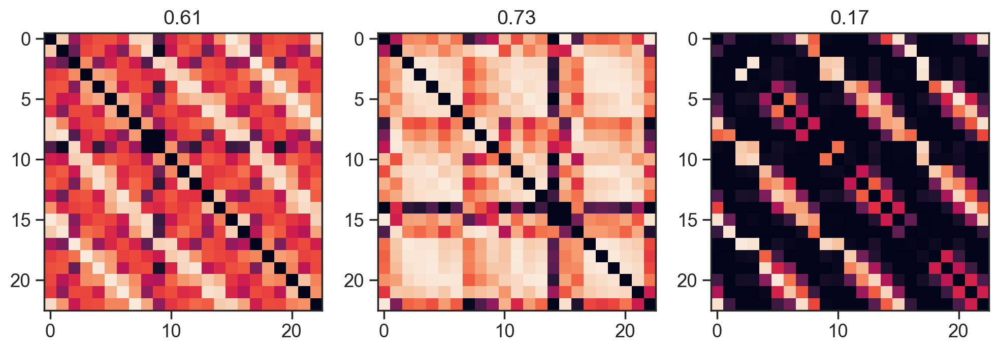

In [5073]:
Ng = len(grid_cell_idxs)
S = Sxs[grid_cell_idxs].mean(0).reshape(-1,len(t)).T

peak1s = []
peak2s = []
peak3s = []
f1s = []
f2s = []
f3s = []
phi1s,phi2s,phi3s = [],[],[]
colinearity_scores = []
for phase_gram,s in zip(phase_grams,S):
    peaks, props = find_peaks(s,distance=1)
    proms,_,_ = peak_prominences(s, peaks)
    top_peaks = peaks[np.argsort(proms)][-2:]
    if len(top_peaks)>0:
        peak1,peak2 = np.min(top_peaks),np.max(top_peaks)
        if peak1+peak2+cutoff_idx >= len(fvalid):
            peak3 = np.abs(peak1-peak2)-cutoff_idx
        elif np.abs(peak1-peak2)-cutoff_idx < 0:
            peak3 = peak1+peak2+cutoff_idx
        else:
            peak3_options = [peak1+peak2+cutoff_idx,np.abs(peak1-peak2)-cutoff_idx]
            peak3 = peak3_options[np.argmax(s[peak3_options])]
        peak1s.append(peak1)
        peak2s.append(peak2)
        peak3s.append(peak3)
        f1s.append(fvalid[peak1])
        f2s.append(fvalid[peak2])
        f3s.append(fvalid[peak3])
        phi1s.append(phase_gram[peak1])
        phi2s.append(phase_gram[peak2])
        phi3s.append(phase_gram[peak3])
        uniq_peaks = np.unique([peak1,peak2,peak3])
        colinearity_scores.append(100*(s[uniq_peaks]**2).sum()/(s**2).sum())
    else:
        peak1s.append(np.nan)
        peak2s.append(np.nan)
        peak3s.append(np.nan)
        f1s.append(np.nan)
        f2s.append(np.nan)
        f3s.append(np.nan)
        phi1s.append(np.nan)
        phi2s.append(np.nan)
        phi3s.append(np.nan)
        colinearity_scores.append(np.nan)
f1s = np.stack(f1s)
f2s = np.stack(f2s)
f3s = np.stack(f3s)
phi1s = np.stack(phi1s)
phi2s = np.stack(phi2s)
phi3s = np.stack(phi3s)

phi1_dark = phi1s[dark_idxs][:,grid_cell_idxs]
phi1_dark = (phi1_dark - circ_mean(phi1_dark,axis=-1,keepdims=True))%(2*np.pi)
phi2_dark = phi2s[dark_idxs][:,grid_cell_idxs]
phi2_dark = (phi2_dark - circ_mean(phi2_dark,axis=-1,keepdims=True))%(2*np.pi)
phi3_dark = phi3s[dark_idxs][:,grid_cell_idxs]
phi3_dark = (phi3_dark - circ_mean(phi3_dark,axis=-1,keepdims=True))%(2*np.pi)

xy1 = np.hstack([np.cos(phi1_dark),np.sin(phi1_dark)])
xy2 = np.hstack([np.cos(phi2_dark),np.sin(phi2_dark)])
xy3 = np.hstack([np.cos(phi3_dark),np.sin(phi3_dark)])
xy = [xy1,xy2,xy3]

kmeans_phases = KMeans(n_clusters=3)
kmeans_phases.fit(np.vstack(xy))
labels = np.stack(np.split(kmeans_phases.labels_,3)).T

phi_all = [phi1_dark,phi2_dark,phi3_dark]

phi1_hat = []
fs_all = [f1s,f2s,f3s]
fs = {}
phis = {}
for j in np.arange(3):
    phis[j] = []
    fs[j] = []
for i in np.arange(len(dark_idxs)):
    for j in np.arange(3):
        label = np.where(labels[i]==j)[0]
        if len(label)>0:
            phis[j].append(phi_all[label[0]][i])
            fs[j].append(fs_all[label[0]][i])
        else:
            min_label = ((np.stack(xy)[:,i] - kmeans_phases.cluster_centers_[j])**2).sum(-1).argmin()
            fs[j].append(fs_all[min_label][i])
            phis[j].append(phi_all[min_label][i])

for j in np.arange(3):
    phis[j] = np.stack(phis[j])
    fs[j] = np.stack(fs[j])

scale = 1/np.sqrt(fs[0]**2+fs[1]**2+fs[2]**2)
angle = np.arcsin(np.sqrt(3)*scale/2*fs[0])

phases_all = []
plt.figure(figsize=(12,4))
for j in np.arange(3):
    plt.subplot(1,3,j+1)
    r = np.corrcoef(np.sin(phis[j]))
    np.fill_diagonal(r,0)
    phases_all.append(circ_mean(phis[j][r.max(0)>0.5],axis=0))
    plt.imshow(r,vmin=0,vmax=1)
    plt.title('{:.2f}'.format(np.mean(r)))

phases1,phases2,phases3 = phases_all
print(f'scale={np.mean(scale)}')

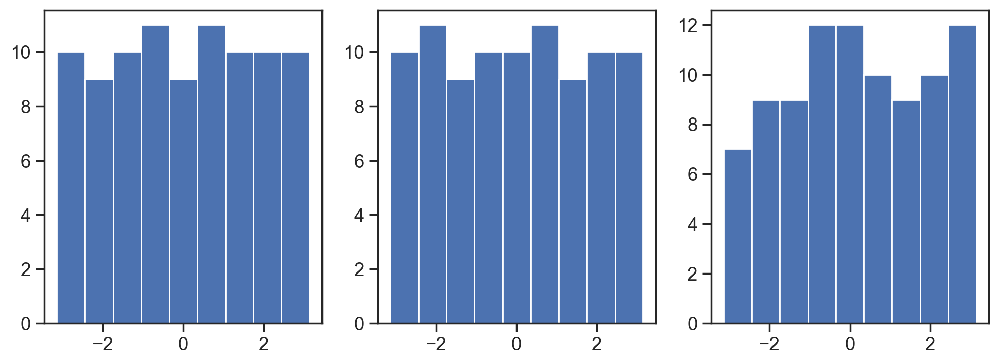

In [5074]:
plt.figure(figsize=(12,4))
for i in range(3):
    plt.subplot(1,3,i+1)
    plt.hist(phases_all[i], np.linspace(-np.pi, np.pi, 10))

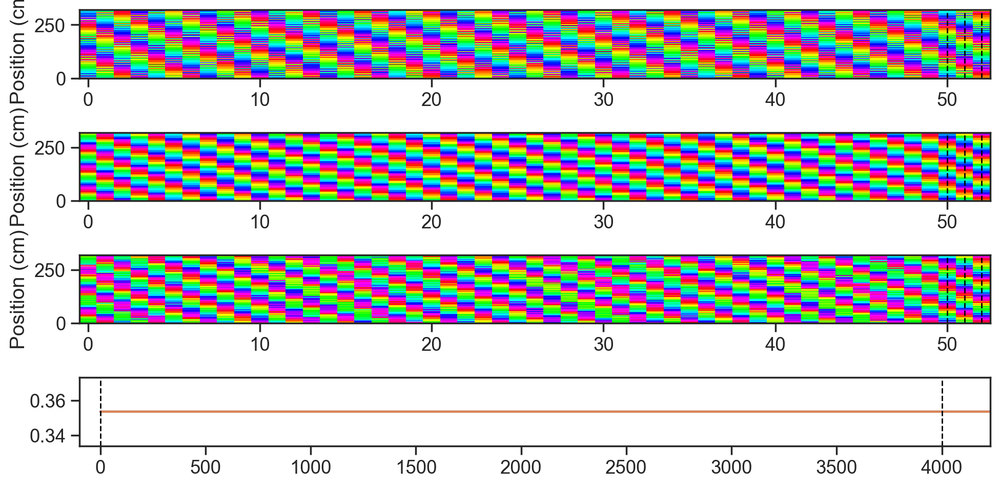

In [5075]:
zscore_by_block = False
interp_maps = False
sigma = 0
# sigma = 3
n_smooth_times = 1
trial_starts = np.array([0, n_trials])
vr_maps = np.copy(zmaps.reshape(Ng,-1))

plt.figure(figsize=(10,5))

n_trials_per_period = 1
# vr_maps = demo_zmaps[grid_cell_idxs].reshape(Ng,-1)

all_angles = []

all_u = []
all_v = []

for i,phases in enumerate(phases_all):
  plt.subplot(4,1,i+1)
  u = np.cos(phases)@vr_maps
  v = np.sin(phases)@vr_maps

  u = u.reshape(-1,n_trials_per_period*raw_maps.shape[2])
  v = v.reshape(-1,n_trials_per_period*raw_maps.shape[2])

  angle = np.arctan2(v,u)
  all_angles.append(angle)

  all_u.append(u)
  all_v.append(v)

  plt.pcolormesh(np.arange(n_trials//n_trials_per_period),np.arange(n_trials_per_period*raw_maps.shape[2]),angle.T,cmap='hsv',)
  # plt.pcolormesh(np.arange(n_trials//n_trials_per_period),np.arange(n_trials_per_period*L*2),angle.T,cmap='hsv',)


  plt.ylabel('Position (cm)')

  for j,trial in enumerate(np.cumsum(trials_pb[:-1])):
    plt.axvline(trial//n_trials_per_period,c='black',linestyle='dashed',linewidth=1)

plt.subplot(4,1,4)
plt.plot(velocity[:, 0])
plt.plot(velocity[:, 1])

for b in range(2):
    plt.axvline(block_timebin_starts[b], c='black',linestyle='dashed',linewidth=1)
plt.xlim([-100, velocity.shape[0]-10])
  # # Plot landmarks
  # for j in range(len(landmark_positions)):
  #   for a,lm in enumerate(landmark_positions[j]):
  #     plt.axhline(lm,trial_starts[j]/(n_trials*n_trials_per_period),
  #                 trial_starts[j+1]/(n_trials*n_trials_per_period),
  #                 c='C'+str(a),linewidth=1,linestyle='dashed')
  #     plt.axhline(lm,trial_starts[j]/(2*n_trials),
  #           trial_starts[j+1]/(2*n_trials),
  #           c='C'+str(a),linewidth=1,linestyle='dashed')

# plt.suptitle(fname)
plt.tight_layout()

all_angles = np.stack(all_angles)
all_u = np.stack(all_u)
all_v = np.stack(all_v)

In [4950]:
all_angles_unw_smooth_original.shape

NameError: name 'all_angles_unw_smooth_original' is not defined

In [12311]:
# fig = plt.figure()
# # ax = fig.add_subplot(111, projection='3d')
# ax=fig.add_subplot(111)
# bins_plot = np.arange(24*320, 25*320)
# # ax.scatter(bins_plot,all_angles_unw_smooth_original[phase1_use, bins_plot],all_angles_unw_smooth_original[phase2_use, bins_plot])
# ax.scatter(all_angles_unw_smooth_original[phase1_use, bins_plot],all_angles_unw_smooth_original[phase2_use, bins_plot])

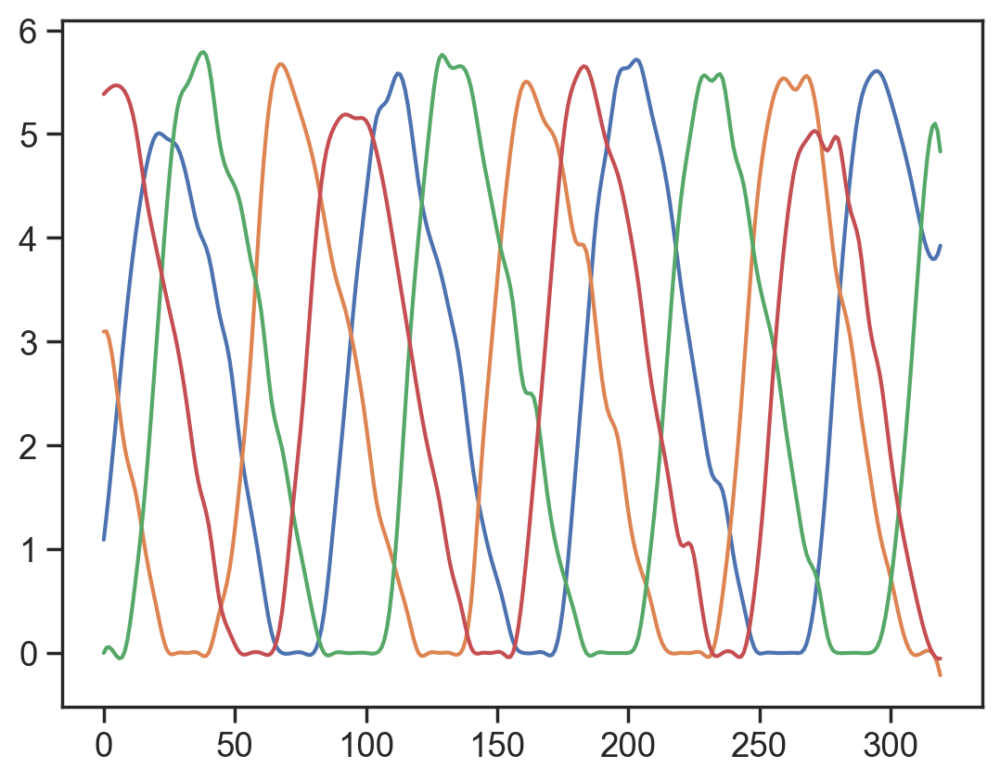

In [11618]:
plt.plot(raw_maps[0,4,:])
plt.plot(raw_maps[0,5,:])
plt.plot(raw_maps[0,6,:])
plt.plot(raw_maps[0,7,:])

## NEEDED SOME HD DRIFT AT EACH TIMESTEP! AND NOT TOO MUCH CELL NOISE

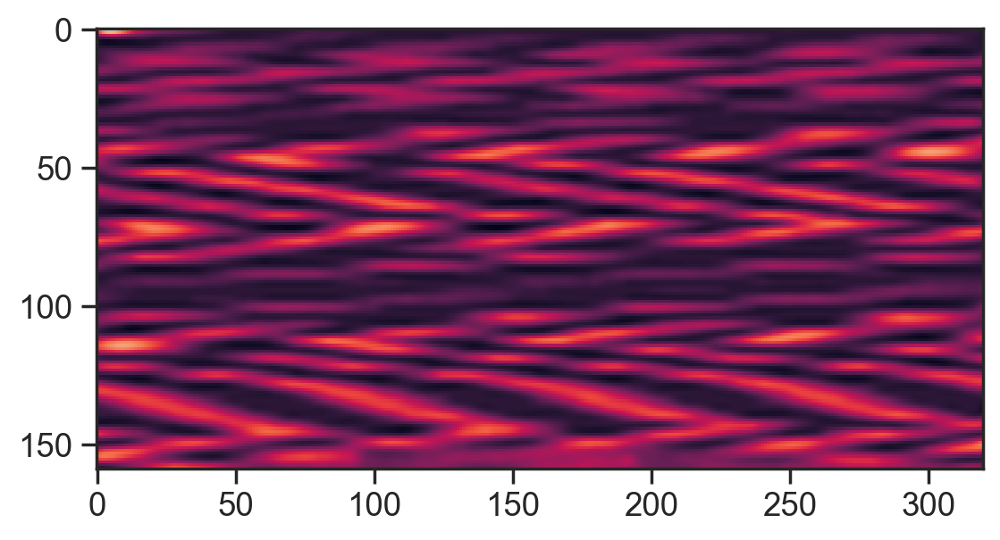

In [11619]:
plt.imshow(zoom(raw_maps[0,:,:], (3,1)))

In [11583]:
# REDUCE THE ALPHA!!!! AND ADD MORE NOISE!!!

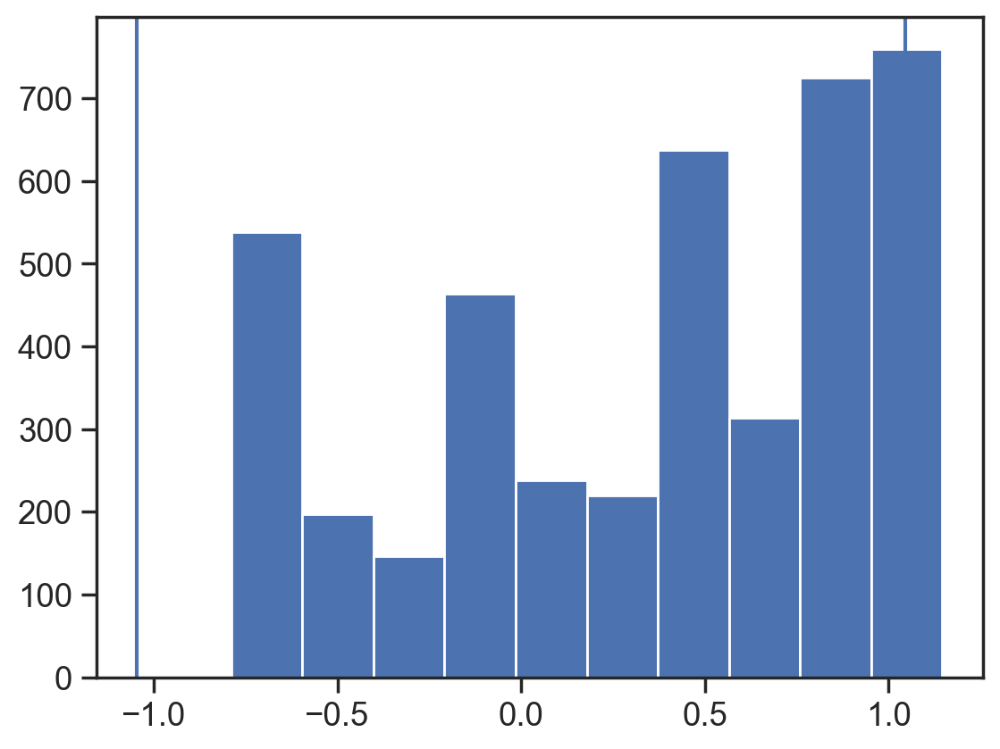

In [11584]:
plt.hist(np.arctan2(velocity[:,0], velocity[:,1]))
plt.axvline(-np.pi/3)
plt.axvline(np.pi/3)

### Sometimes the bump takes an angle that ends up just making only a subset of neurons active. if that happens for too long then it'll appear that nothing is changing when individual cells might still have some differences. Need a way to counteract this. It looks like it helped to reduce both T and Intensity. Reducing T alone did not help. Reducing Intensity alongside the T did help. Wanted to reduce T to allow more cells to be active. Maybe can also just add some noise at each timestep

In [11540]:
velocity[1500, :]

array([0.40683632, 0.29066167])

In [11667]:
def plot_sheet3d(x,y,z):
    fig=plt.figure()
    ax=fig.add_subplot(111, projection='3d')
    
    ax.scatter(x,y,z, c=cm.turbo(z))
    ax.view_init(60, -90, 0)
    return fig

In [11651]:
np.max(A)

19.02315058868414

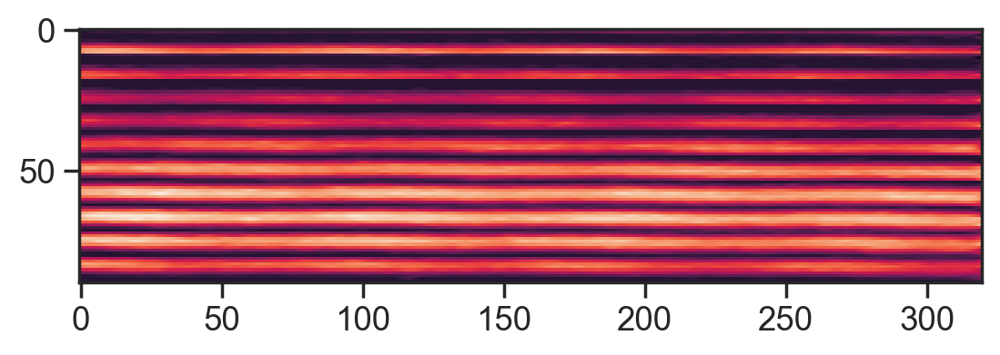

In [11521]:
plt.imshow(raw_maps[:,2,:])

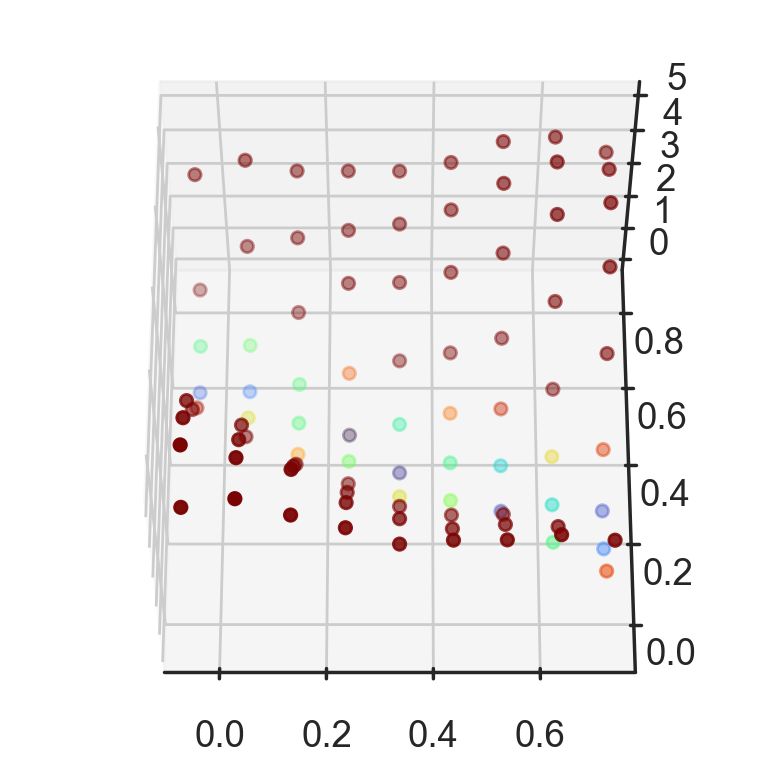

In [11668]:
a=plot_sheet3d(x,y,A[4200+i,:])


In [11672]:
np.max(raw_maps)

19.730357865410785

In [11673]:
raw_maps.shape

(90, 53, 320)

In [11674]:
320 * 5

1600

In [11676]:
save_fig=True
x = cell_positions[0, :, :].reshape(-1)
y = cell_positions[1, :, :].reshape(-1)
maps_linearized = raw_maps.reshape(N, -1)
pid=0
save_dir = 'D:/Code/bump_video/sim/sheet3d/'
dpi_val = 25
pil_use = True
for i in range(1600):
    # fig=plot_sheet3d(x,y,A[3600+i,:])
    fig=plot_sheet3d(x,y,maps_linearized[:, 48*320+i])

    ax.view_init(45, -90, 0)
    ax.set_xlim(0, 1)
    ax.set_ylim(0, 1)
    ax.set_zlim(0, 20)
    
    plt.axis('off')
    if save_fig:
        if pil_use:
            img = fig2img(fig)
            img.save(os.path.join(save_dir,f'{pid:04d}.png'), quality=dpi_val)
            plt.close(fig)
        else:
            plt.savefig(os.path.join(save_dir,f'{pid:04d}.jpg'), dpi=dpi_val)
            # fig.savefig(os.path.join(save_dir,f'{pid:03d}.png'), dpi=dpi_val)
            plt.close(fig)
        
    pid += 1
    # save figure 
    # close figure


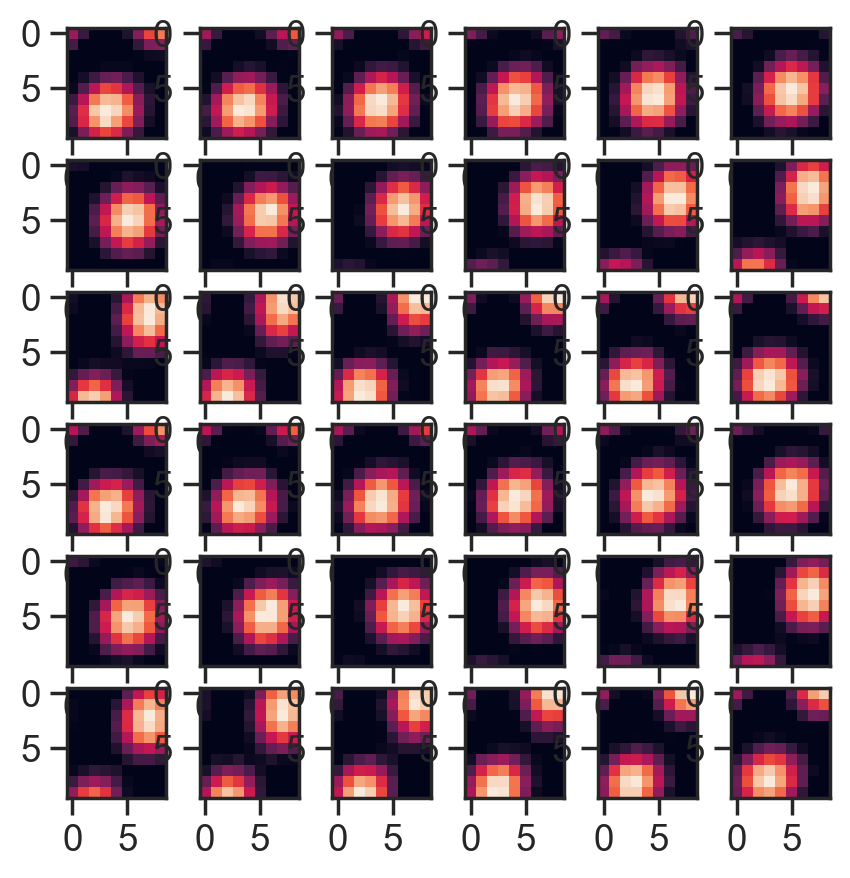

In [11644]:
plt.figure(figsize=(5,5))
for i in range(36):
    plt.subplot(6,6,i+1)
    # plt.scatter(x,y,c=B[0+i,:])
    plt.imshow(A[190+i,:].reshape(n_x, n_y))
    plt.box('off')

In [11643]:
# plt.figure(figsize=(20,20))
# for i in range(36):
#     plt.subplot(6,6,i+1)
#     # plt.scatter(x,y,c=B[0+i,:])
#     plt.imshow(B[190+i,:].reshape(n_x, n_y))
#     plt.box('off')

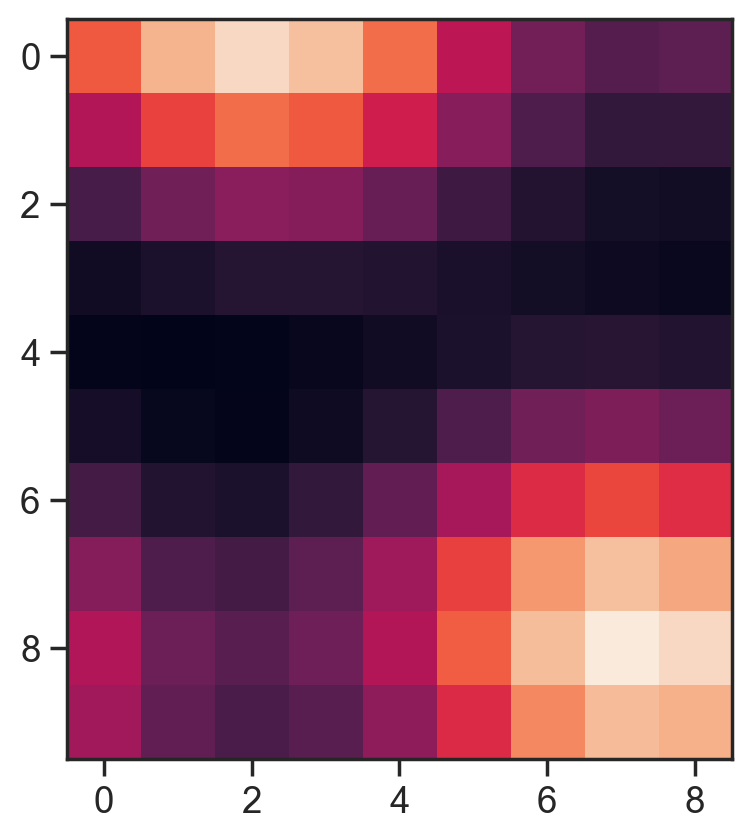

In [11284]:
plt.imshow(B[250,:].reshape(n_x,n_y))


In [11146]:
velocity[-1,:]

array([0.35355339, 0.35355339])

In [11147]:
rot_mat @ velocity

ValueError: matmul: Input operand 1 has a mismatch in its core dimension 0, with gufunc signature (n?,k),(k,m?)->(n?,m?) (size 4240 is different from 2)

In [ ]:
all_angles.shape

In [ ]:
rot_mat = calc_rot_mat(beta) 
factor = np.zeros((velocity.shape[0], 2))
for i in range(velocity.shape[0]):
    factor[i, :] = rot_mat @ velocity[i,:]

In [ ]:
rot_mat @ velocity[100, :]

In [ ]:
plt.plot(factor[:, 0])
plt.plot(factor[:, 1])

In [4951]:
def angle_unwrapper(all_angles):
    # all_angles of shape n_features x n_bins 
    
    # now look for when each phase crosses boundary and make everything monotonically increasing so that it can be properly smoothed
    all_angles_unw = np.zeros((all_angles.shape[0], all_angles.shape[-1]))
    
    discs = []
    for a in np.arange(all_angles.shape[0]):
        angle_lin = np.copy(all_angles[a, :])

        discs_temp = []
        for s in np.arange(1, len(angle_lin)):
            diff = angle_lin[s] - angle_lin[s-1]
            if diff >= np.pi:
                angle_lin[s:] = angle_lin[s:] - 2*np.pi
                discs_temp.append(s)
            elif diff < -np.pi:
                angle_lin[s:] = angle_lin[s:] + 2*np.pi
                discs_temp.append(s)
            
        all_angles_unw[a,:] = angle_lin
        discs.append(np.array(discs_temp))
    
    discs = np.array(discs, dtype='object')
    
    return all_angles_unw, discs

In [4952]:
def angle_wrapper(all_angles_unw):
    
    all_angles = np.zeros((all_angles_unw.shape[0], all_angles_unw.shape[-1]))
    discs = []
    
    for a in np.arange(all_angles_unw.shape[0]):
        angle_lin = np.copy(all_angles_unw[a, :])
        discs_temp = []
        
        for s in np.arange(1, len(angle_lin)):
            
            if angle_lin[s] >= np.pi:
                angle_lin[s:] = angle_lin[s:] - 2*np.pi
                discs_temp.append(s)
            elif angle_lin[s] < -np.pi: # SHOULD THIS BE IF AND NOT ELIF?
                angle_lin[s:] = angle_lin[s:] + 2*np.pi
                discs_temp.append(s)
    
        all_angles[a,:] = angle_lin
        discs.append(np.array(discs_temp))
    
    discs = np.array(discs, dtype='object')

    return all_angles, discs

In [4953]:
def calc_bump_plot_variables(g_fr, phases_all, disc_smooth_sigma):
    # maps already linearized and smoothed as needed

    all_angles = []
    all_u = []
    all_v = []
    
    for i,phases in enumerate(phases_all):
        u = np.cos(phases)@g_fr
        v = np.sin(phases)@g_fr
        
        u = u.reshape(-1,)
        v = v.reshape(-1,)
        
        angle = np.arctan2(v,u)
        all_angles.append(angle)
        
        all_u.append(u)
        all_v.append(v)

    all_angles = np.stack(all_angles)
    all_u = np.stack(all_u)
    all_v = np.stack(all_v)

    # unwrap angle for proper smoothing 
    all_angles_unw, discs = angle_unwrapper(all_angles)
    
    # smooth
    all_angles_unw_smooth = np.zeros_like(all_angles_unw)
    for a,_ in enumerate(phases_all):
        if disc_smooth_sigma > 0:
            all_angles_unw_smooth[a, :] = gaussian_filter1d(all_angles_unw[a,:], disc_smooth_sigma)
        else:
            all_angles_unw_smooth[a, :] = all_angles_unw[a, :]
   # unwrap angle for proper smoothing 
    all_angles_smooth, discs_smooth = angle_wrapper(all_angles_unw_smooth)
    all_angles_smooth_norm = (all_angles_smooth - (-np.pi)) / (2*np.pi)

    return (all_angles, all_u, all_v, 
            all_angles_unw, discs, 
            all_angles_unw_smooth, all_angles_smooth, discs_smooth, 
            all_angles_smooth_norm)

In [5103]:
g_fr = vr_maps.reshape(N,-1)
disc_smooth = 25
(all_angles, all_u, all_v, 
 all_angles_unw, discs, 
 all_angles_unw_smooth, all_angles_smooth, discs_smooth, all_angles_smooth_norm)=calc_bump_plot_variables(g_fr, phases_all, disc_smooth)

# save the full dataset first 
all_angles_original = np.copy(all_angles)
all_u_original = np.copy(all_u)
all_v_original = np.copy(all_v)
all_angles_unw_original = np.copy(all_angles_unw)
discs_original = np.copy(discs)
all_angles_unw_smooth_original = np.copy(all_angles_unw_smooth)
all_angles_smooth_original = np.copy(all_angles_smooth)
discs_smooth_original = np.copy(discs_smooth)
all_angles_smooth_norm_original = np.copy(all_angles_smooth_norm)


In [5104]:
corr_temp = np.corrcoef(phases_all)
phase_corrvals = np.abs(np.array([corr_temp[0,1], corr_temp[0,2], corr_temp[1,2]]))
phase_comps = np.array([[0, 1], [0, 2], [1, 2]])
phases_use = phase_comps[np.argmin(phase_corrvals)]

(array([ 7.,  9.,  8., 16.,  7., 10.,  6.,  9.,  9.,  9.]),
 array([0.04608456, 0.35397167, 0.66185878, 0.9697459 , 1.27763301,
        1.58552012, 1.89340723, 2.20129434, 2.50918146, 2.81706857,
        3.12495568]),
 <BarContainer object of 10 artists>)

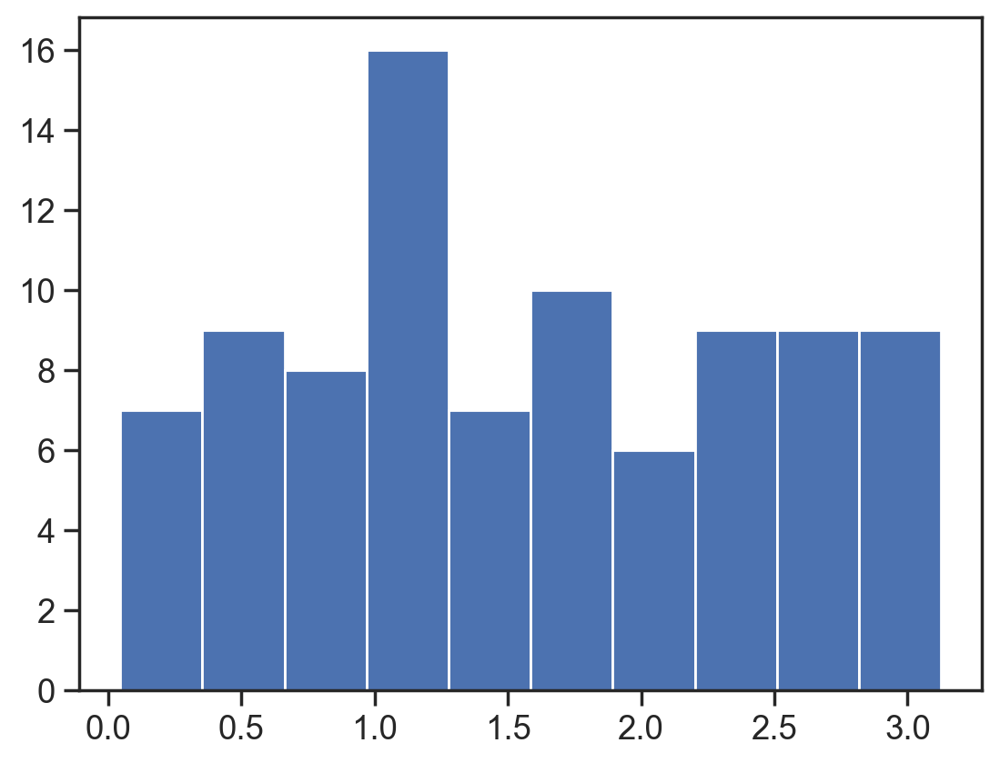

In [5105]:
# plt.hist(circ_dist(phases_all[0], phases_all[1]))
plt.hist(circ_dist(phases_all[0], phases_all[2]))

(-3.409896103092085,
 3.4308747429726347,
 -3.3727655653355635,
 3.468005280729156)

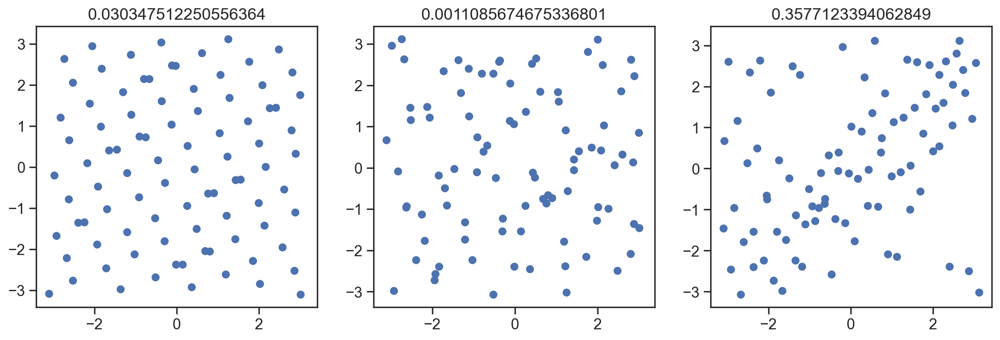

In [5106]:
plt.figure(figsize=(15, 5))

plt.subplot(1,3,1)
plt.scatter(phases_all[0],phases_all[1])
plt.title(f'{phase_corrvals[0]}')
plt.axis('square')

plt.subplot(1,3,2)
plt.scatter(phases_all[0],phases_all[2])
plt.title(f'{phase_corrvals[1]}')
plt.axis('square')

plt.subplot(1,3,3)
plt.scatter(phases_all[1],phases_all[2])
plt.title(f'{phase_corrvals[2]}')
plt.axis('square')


(-77.41051487039806,
 1633.3989868714111,
 -77.41051487039806,
 1633.3989868714111)

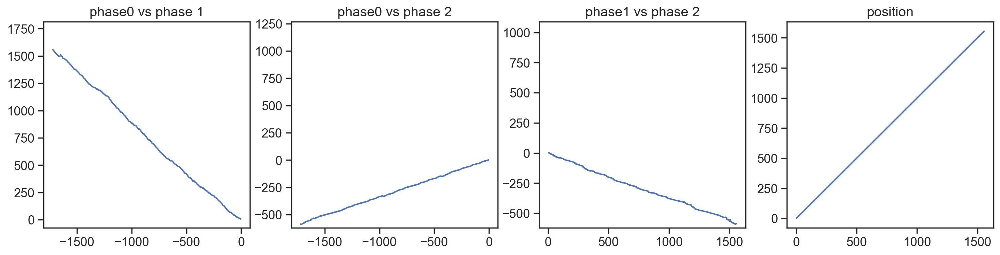

In [5107]:
plt.figure(figsize=(18, 4))

plt.subplot(1,4,1)
plt.plot(all_angles_unw_smooth[0],all_angles_unw_smooth[1])
plt.title('phase0 vs phase 1')
plt.axis('square')

plt.subplot(1,4,2)
plt.plot(all_angles_unw_smooth[0],all_angles_unw_smooth[2])
plt.title('phase0 vs phase 2')
plt.axis('square')

plt.subplot(1,4,3)
plt.plot(all_angles_unw_smooth[1],all_angles_unw_smooth[2])
plt.title('phase1 vs phase 2')
plt.axis('square')

plt.subplot(1,4,4)
plt.plot(np.cumsum(velocity[:,0]), np.cumsum(velocity[:,1]))
plt.title('position')
plt.axis('square')

In [5108]:
# resx,resy = n_x,n_y
resx,resy = n_x,n_y

phase1_use = phases_use[0]
phase2_use = phases_use[1]
phase1_use=1
phase2_use=2

print(f'phase1_use={phase1_use}, phase2_use={phase2_use}')
gridsort = get_2d_sort(phases_all[phase1_use][:resx*resy],phases_all[phase2_use][:resx*resy],resx,resy)

phase1_use=1, phase2_use=2


In [5109]:
# total_in = np.sum(W, axis= -1)

# plt.figure(figsize=(8, 10))
# for i in range(20):
#     plt.subplot(5,4, i+1)
#     plt.imshow(total_in[4270+i, :].reshape(n_y, n_x))

In [5110]:
print(f'phase1 discs = {discs[phase1_use].size}')
print(f'phase2 discs = {discs[phase2_use].size}')

phase1 discs = 438
phase2 discs = 353


In [5111]:
tpb_cs = np.concatenate((np.array([0]), np.cumsum(trials_pb)))
tpb_cs

array([ 0, 50, 51, 52, 53, 54, 55])

In [5112]:
n_discs_pt = np.zeros((n_trials, 2))

bins_per_trial = 320
for t in range(n_trials):
    min_bin = t*bins_per_trial
    max_bin = (t+1)*bins_per_trial
    
    n_discs_pt[t, 0] = np.sum((discs[phase1_use] >= min_bin) * (discs[phase1_use] < max_bin))
    n_discs_pt[t, 1] = np.sum((discs[phase2_use] >= min_bin) * (discs[phase2_use] < max_bin))

n_discs_pb = np.zeros((tpb_cs.size-1, 2))
u_discs_pb = np.zeros((tpb_cs.size-1, 2))
tpb_cs = np.concatenate((np.array([0]), np.cumsum(trials_pb)))
for b in range(tpb_cs.size-1):
    min_trial = tpb_cs[b]+1 # excluding the first trial
    max_trial = tpb_cs[b+1]
                    
    n_discs_pb[b, :] = np.sum(n_discs_pt[min_trial:max_trial, :], axis=0)
    u_discs_pb[b, :] = np.mean(n_discs_pt[min_trial:max_trial, :], axis=0)

print(u_discs_pb)
#how many copies of the sheet needed per trial
print(np.ceil(np.max(u_discs_pb, axis=1)))

[[7.97959184 6.44897959]
 [       nan        nan]
 [       nan        nan]
 [       nan        nan]
 [       nan        nan]
 [       nan        nan]]
[ 8. nan nan nan nan nan]


C:\Users\johnh\.conda\envs\si_env\Lib\site-packages\numpy\core\fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\johnh\.conda\envs\si_env\Lib\site-packages\numpy\core\_methods.py:121: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(


In [5113]:
# subset of the data
# g_fr2 = np.copy(vr_maps.reshape(N, n_trials, 320))
# g_fr2 = g_fr2[:, np.array([tpb_cs[0]-16, tpb_cs[0]-16, tpb_cs[0]-16, tpb_cs[0], tpb_cs[0]+1, tpb_cs[0]+2]), :]
g_fr2 = vr_maps.reshape(N,n_trials,320)[:, tpb_cs[1]:, :]

# for i in range(90):
#     g_fr2[i, 2, :] = gaussian_filter1d(g_fr2[i,2,:], 8)
# for i in range(110):
#     g_fr2[:, 3, i] = g_fr2[:, 2, i]

disc_smooth = 10
(all_angles, all_u, all_v, 
 all_angles_unw, discs, 
 all_angles_unw_smooth, all_angles_smooth, discs_smooth, all_angles_smooth_norm)=calc_bump_plot_variables(g_fr2.reshape(N,-1), phases_all, disc_smooth)

In [11635]:
# n_bins=80
# mean_vals_bins = np.zeros((len(A_pb), n_bins))

# for i in range(len(A_pb)):
#     mean_vals_bins[i, :] = np.mean(A_pb[i][:n_bins, :], axis=1)

# plt.imshow(mean_vals_bins)

In [11636]:
# # plt.plot(all_angles_smooth_norm[0,:1000])
# idxs_plot = np.arange(block_timebin_starts[4]*2,block_timebin_starts[5]*2)
# plt.figure(figsize=(idxs_plot.size/200, 5))
# plt.plot(all_angles_smooth_norm[phase1_use, idxs_plot])
# plt.plot(all_angles_smooth_norm[phase2_use, idxs_plot])

# # plt.scatter(all_angles_smooth_norm[phase1_use, idxs_plot], all_angles_smooth_norm[phase2_use, idxs_plot])


In [5114]:
pickle_bool = True

if pickle_bool:
    filename = 'D:/Code/bump_video/sim/pinning_random_rearragement.pkl'
    
    data_dict = {"g_fr":g_fr,
                 "g_fr2":g_fr2,
                 "raw_maps":raw_maps,
                 "gridsort":gridsort,
                 "resx":resx,
                 "resy":resy,
                 "phases_all":phases_all,
                 "discs_smooth":discs_smooth,
                 "all_angles_smooth":all_angles_smooth,
                 "all_angles_smooth_norm":all_angles_smooth_norm,
                 "phase1_use":phase1_use,
                 "phase2_use":phase2_use,
                 "A":A, "B":B, "W":W,
                 "scaled_velocity":scaled_velocity,
                 "posx_lin":posx_lin, 
                 "posx":posx,
                 "velocity":velocity,
                 "block_timebin_starts":block_timebin_starts,
                 "l_pos_pb":l_pos_pb,
                 "trials_pb":trials_pb,
                 "n_timebins":n_timebins,
                 "init_state":init_state,
                 "cell_position_diffs":cell_position_diffs,
                 "n_y":n_y, "n_x":n_x, "alpha":alpha, "beta_noise":beta_noise, "I":I,
                 "sigma":sigma, "T":T, "tau":tau, "velocity_gain":velocity_gain,
                 "track_length":track_length, "l_str":l_str, "n_warmup_bins":n_warmup_bins
                 }
    
    
    with open(filename, 'wb') as file:
        pickle.dump(data_dict, file)

    file.close()
    
    # with open(filename, 'rb') as file:
    #   data = pickle.load(file)

# Video using block data

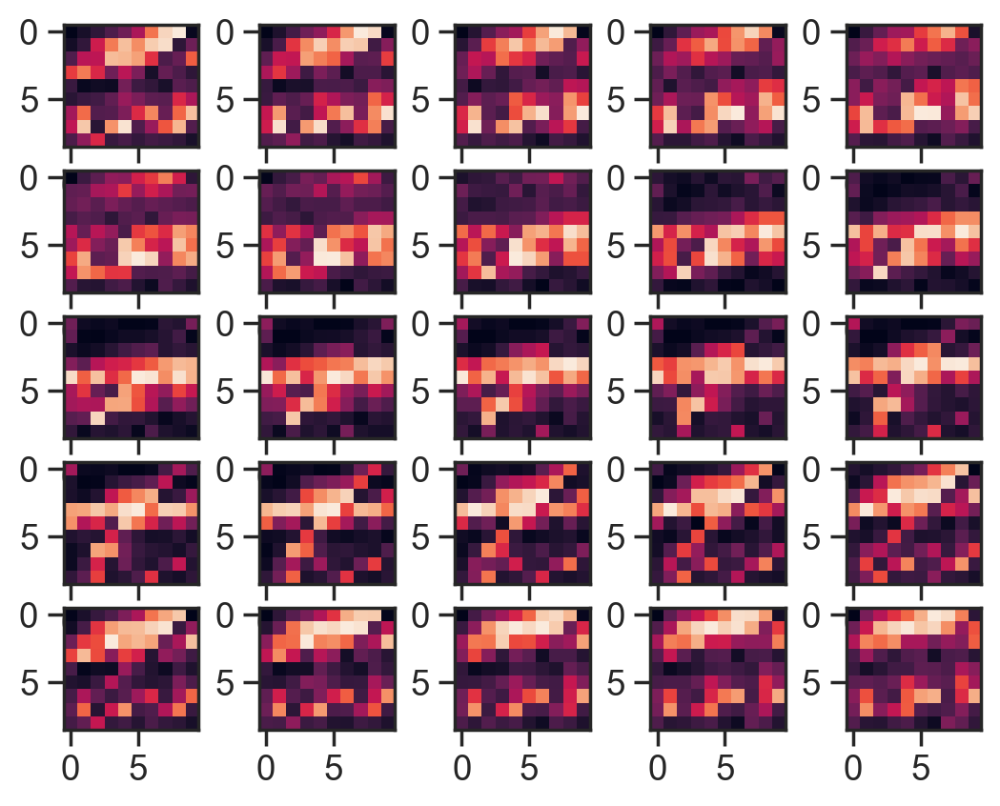

In [9413]:
maps_linearized = g_fr[:resx*resy,:].reshape(resx*resy, -1)

for i in range(25):
    plt.subplot(5,5,i+1)
    start = 320 + i*4
    dat = maps_linearized[:, start:start+spatial_window]
    
    dat = dat.mean(1)
    rm = zscore(dat, axis=0)
    im = rm[gridsort].reshape(resy,resx)
    
    plt.imshow(im)

## TRIAL BASED VIDEO

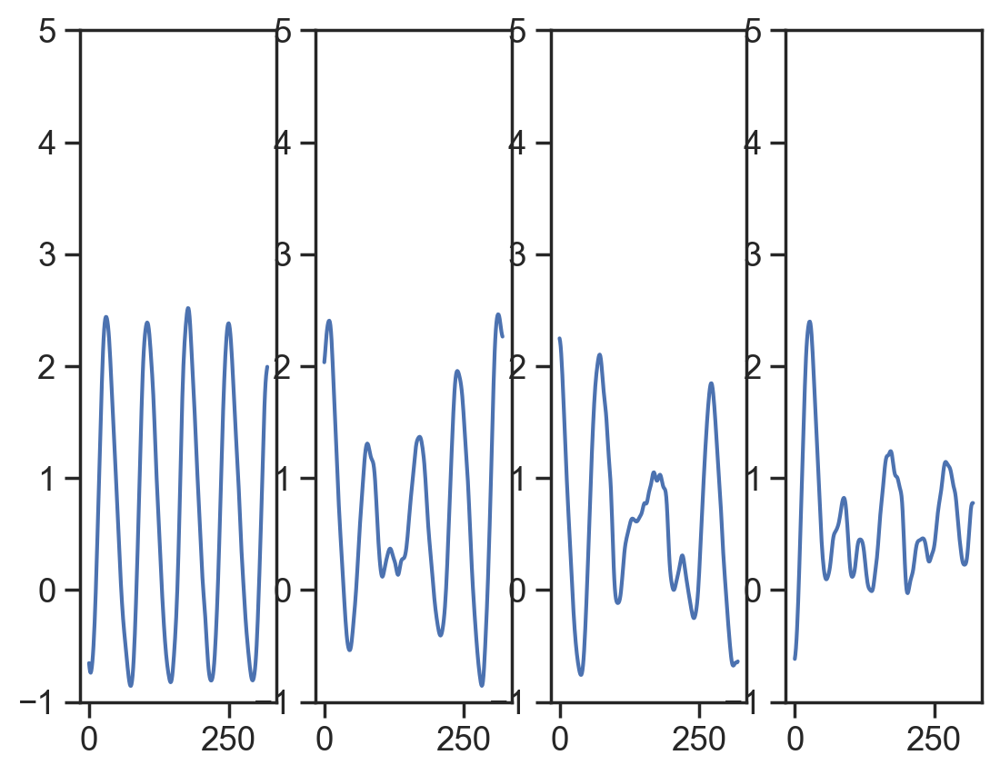

In [11933]:
for i in range(4):
    plt.subplot(1,4,i+1)
    plt.plot(g_fr2[1, i, :])
    plt.ylim([-1, 5])

# VIDEO CLEANLY

In [10704]:
# get the positions of the trajectories to plot ahead of time

In [11698]:
zero_mat = np.zeros((n_x*n_max_copies, n_y*n_max_copies))
zero_mat.shape

(50, 45)

In [11705]:
g_fr2.shape

(90, 5, 320)

In [11712]:
all_angles_unw_smooth_trial.shape

(3, 1600)

In [11886]:
n_bins = all_angles_unw_smooth.shape[1]
all_angles_unw_smooth_trial = np.copy(all_angles_unw_smooth)
# all_angles_smooth_norm_trial = np.copy(all_angles_smooth_norm)

for i in range(n_bins):
    if np.mod(i, track_length)==0:
        all_angles_unw_smooth_trial[:, i:] -= np.expand_dims(all_angles_unw_smooth_trial[:, i], 1)
        # all_angles_smooth_norm_trial[:, i:] -= np.expand_dims(all_angles_smooth_norm_trial[:, i], 1)

sheet_index = (n_max_copies+1)+all_angles_unw_smooth_trial // (2*np.pi)
sheet_index[:, 0] = n_max_copies

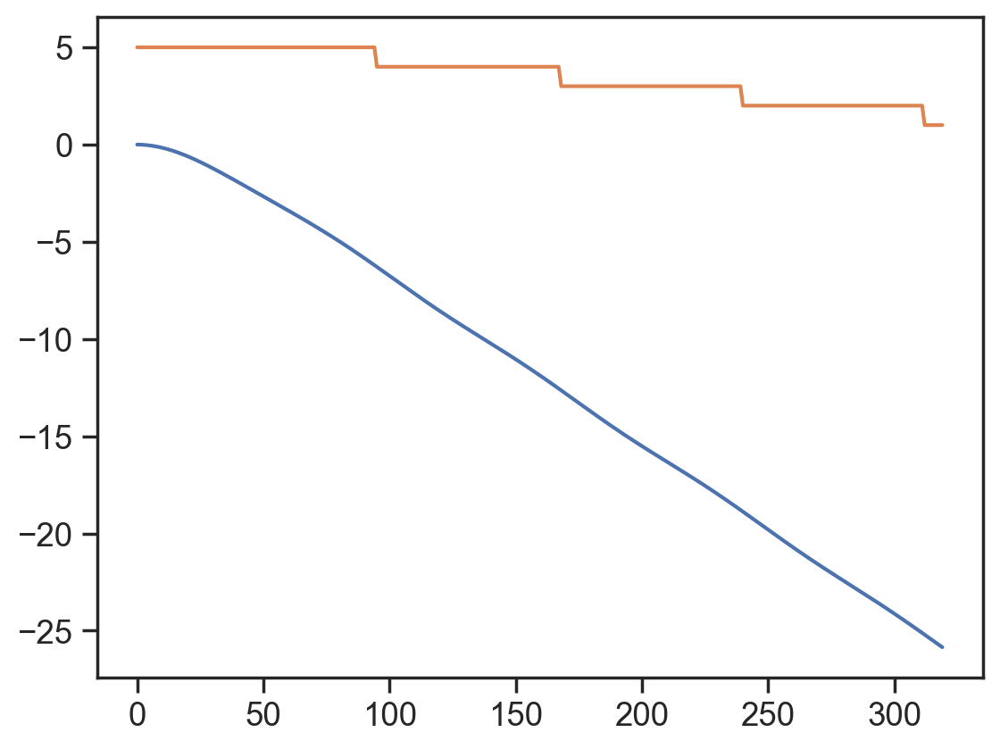

In [11887]:
# get coordinate by combining sheet index using and how much along that sheet using all_angles_smooth_norm 
plt.plot(all_angles_unw_smooth_trial[phase1_use][:320])
plt.plot(sheet_index[phase1_use][:320])

# plt.plot(all_angles_unw_smooth_trial[phase1_use][320:640])
# plt.plot(all_angles_unw_smooth_trial[phase1_use][640:640+320])

In [11893]:
# now we have the phase, we put the template on the sheet using the coordinate.

# template_bump = np.tile(g_fr2[:, 0, 20].reshape(n_x,n_y), (n_max_copies, n_max_copies)) # trial 0, 20th bin is good
template_bump = g_fr2[:, 0, 20].reshape(n_x,n_y) # trial 0, 20th bin is good

# dat_smooth = gaussian_filter(dat, 1)
# plt.pcolormesh(U, V, dat_smooth)

In [11888]:
bin_idx = 0
p1i, p2i = sheet_index[[phase1_use, phase2_use], bin_idx]
p1r, p2r = all_angles_smooth_norm[[phase1_use, phase2_use], bin_idx]

# center of bump on the full copied sheet
bumpx, bumpy = [int(np.round(p1i * n_x - p1r * n_x)), int(np.round(p2i * n_y - p2r * n_y))]
bumpx_start = bumpx - n_x//2
bumpx_end = bumpx_start + n_x
bumpy_start = bumpy - n_y//2
bumpy_end = bumpy_start + n_y


In [11894]:
dat_plot = np.zeros((n_x*n_max_copies, n_y*n_max_copies))

for xi in range(n_x):
    this_idx = bumpx_start + xi
    dat_plot[this_idx, bumpy_start:bumpy_end] = template_bump[0, :]
    
    


ValueError: could not broadcast input array from shape (9,) into shape (4,)

In [11896]:
template_bump.shape

(10, 9)

In [11785]:


n_max_copies = 5
X, Y = np.mgrid[:n_max_copies*resx,:n_max_copies*resy]/resy
U, V = coord_from_phase(X, Y)


# plt.pcolormes(U, V, 

(44, 36)

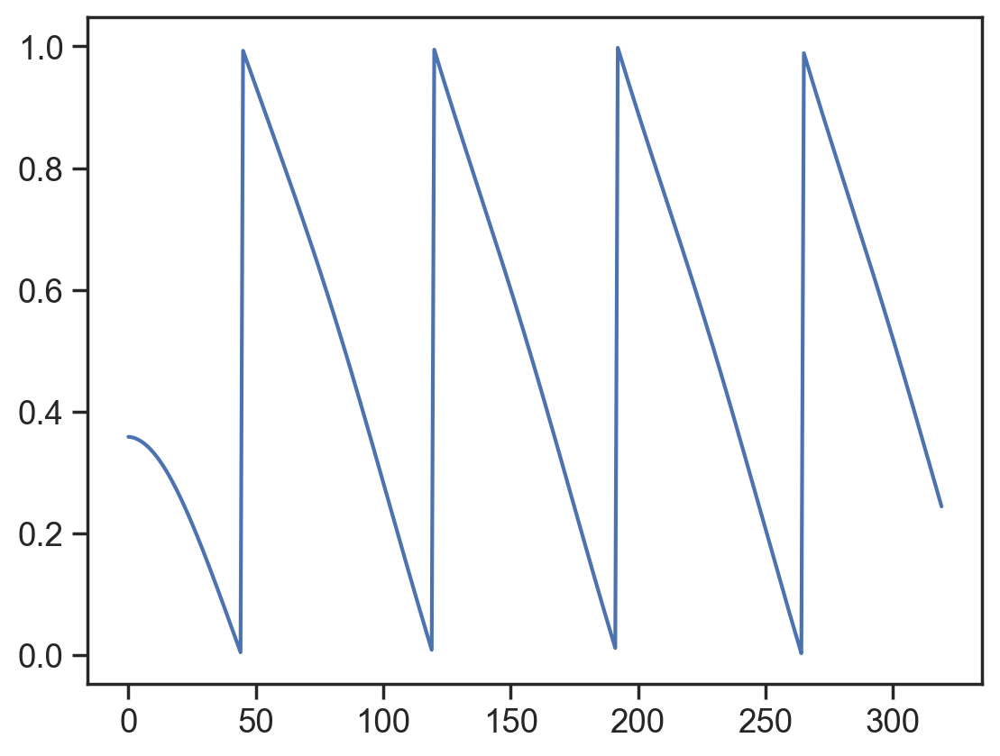

In [11771]:
plt.plot(all_angles_smooth_norm[phase1_use][:320])

In [ ]:
# get the location of the bump and plot it at the coordinate

In [10713]:
320*8

2560

In [10712]:
all_angles_unw_smooth.shape

(3, 2560)

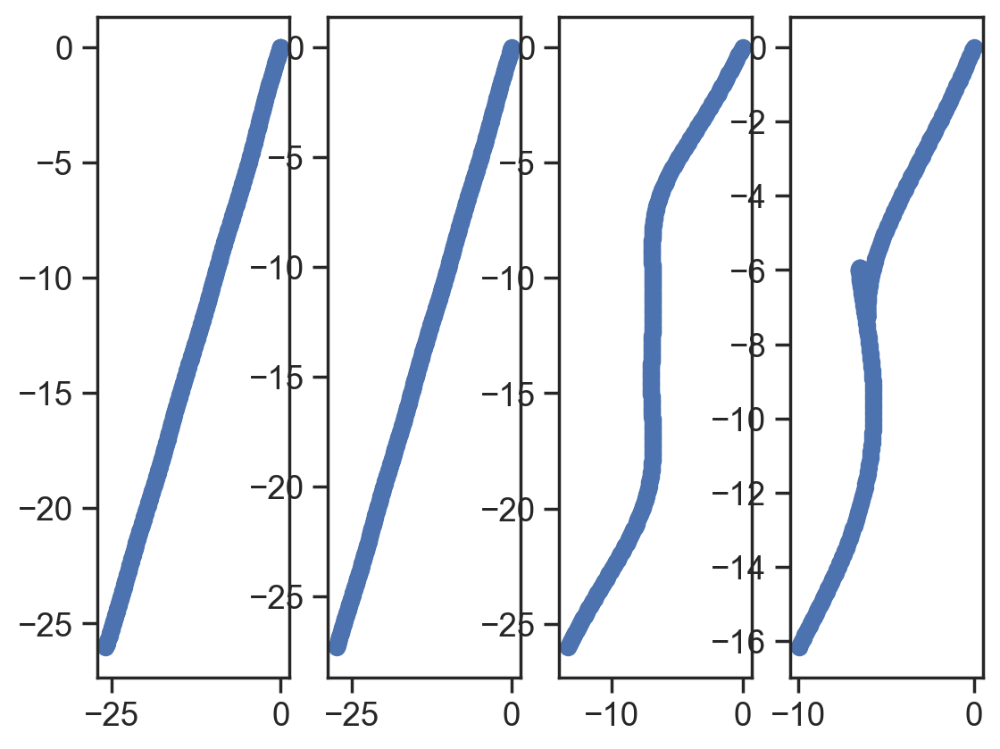

In [11677]:
for b in range(4):
    plt.subplot(1,4,b+1)
    n_trials_block = 1
    bins_plot = np.arange(320*b*n_trials_block, 320*(b+1)*n_trials_block)
    
    for t in range(n_trials_block):
        trial_bins = bins_plot[t*320:(t+1)*320]
        
        phase1_vals = all_angles_unw_smooth[phase1_use, trial_bins]-all_angles_unw_smooth[phase1_use, trial_bins[0]]
        phase2_vals = all_angles_unw_smooth[phase2_use, trial_bins]-all_angles_unw_smooth[phase2_use, trial_bins[0]]
        plt.scatter(phase1_vals, phase2_vals)


In [11680]:
g_fr2.shape

(90, 5, 320)

In [11909]:
l_pos_pb

array([list([]), list([80]), list([80, 180]), list([80, 180, 320])],
      dtype=object)

In [11904]:
n_trials_pb_plot

1

In [11914]:
1600/320

5.0

In [4969]:
def plot_mouse(pos_val, teleport):
    # body
    plt.plot(pos_val, 9.5, 'o', ms=50, mfc=[0.75,0.75,0.75,1], mew=0)

    # nose
    # plt.plot(pos_val + 1*plot_scale, 8.5, 'o', ms=2*plot_scale, mfc=[0.5, 0.25, 0.25, 0.9], mew=0)

    # tail
    tailx_fixed = np.linspace(0, 3*np.pi/4, 50)
    taily = 0.5*np.sin(tailx_fixed*2)+8
    
    tailx = np.linspace(pos_val-6, pos_val-1.5, 50)
    plt.plot(tailx, taily, c=[0.75, 0.75, 0.75, 0.75], lw=4)

    # ears
    plt.plot(pos_val + 1.5, 6, 'o', ms=9, mfc=[0.5, 0.5, 0.5, 0.9], mew=0)

    # eyes
    plt.plot(pos_val+2.25, 7.85, 'o', ms=4, mfc=[0,0,0,1], mew=0)

    if pos_val >= 157:
        start_pos = pos_val-160
         # body
        plt.plot(start_pos, 9.5, 'o', ms=50, mfc=[0.75,0.75,0.75,1], mew=0)
    
        # nose
        # plt.plot(pos_val + 1*plot_scale, 8.5, 'o', ms=2*plot_scale, mfc=[0.5, 0.25, 0.25, 0.9], mew=0)
    
        # tail
        tailx = np.linspace(start_pos-6, start_pos-1.5, 50)
        plt.plot(tailx, taily, c=[0.75, 0.75, 0.75, 0.75], lw=4)
    
        # ears
        plt.plot(start_pos + 1.5, 6, 'o', ms=9, mfc=[0.5, 0.5, 0.5, 0.9], mew=0)
    
        # eyes
        plt.plot(start_pos+2.25, 7.85, 'o', ms=4, mfc=[0,0,0,1], mew=0)
        
    if teleport and pos_val <= 3:
        start_pos = pos_val+160
         # body
        plt.plot(start_pos, 9.5, 'o', ms=50, mfc=[0.75,0.75,0.75,1], mew=0)
    
        # nose
        # plt.plot(pos_val + 1*plot_scale, 8.5, 'o', ms=2*plot_scale, mfc=[0.5, 0.25, 0.25, 0.9], mew=0)
    
        # tail
        tailx = np.linspace(start_pos-6, start_pos-1.5, 50)
        plt.plot(tailx, taily, c=[0.75, 0.75, 0.75, 0.75], lw=4)
    
        # ears
        plt.plot(start_pos + 1.5, 6, 'o', ms=9, mfc=[0.5, 0.5, 0.5, 0.9], mew=0)
    
        # eyes
        plt.plot(start_pos+2.25, 7.85, 'o', ms=4, mfc=[0,0,0,1], mew=0)

In [4970]:
def plot_towers(t_locs, t_heights, t_widths, t_colors):
    n_towers = t_locs.size

    for t in range(n_towers):
        t_loc = t_locs[t]
        t_height = t_heights[t]
        t_width = t_widths[t]
        t_color = t_colors[t]
        x, y = np.mgrid[t_loc-t_width//2:t_loc+t_width//2, 10-t_height:10]
        z = np.zeros((x.shape[0], x.shape[1], 4))
        
        z[:,:,0] = t_color[0]
        z[:,:,1] = t_color[1]
        z[:,:,2] = t_color[2]
        z[:,:,3] = t_color[3]
        
        plt.pcolormesh(x, y, z)

(0.0, 159.5, 9.0, 0.0)

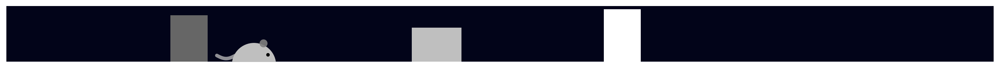

In [12234]:
# # track 
# track = np.zeros((10, 160))

# fig = plt.figure(figsize=(20,2))
# ax = fig.add_subplot(111)
# plt.imshow(track, origin='lower')

# t_locs = np.array([100, 70, 30])
# t_heights = np.array([9, 6, 8])
# t_widths = np.array([6, 8, 6])
# t_colors = np.array([np.array([1, 1, 1, 1]), np.array([0.75, 0.75, 0.75, 1]), np.array([0.4, 0.4, 0.4, 1])])

# if t_locs.size > 0:
#     plot_towers(t_locs, t_heights, t_widths, t_colors)
    
# # plot mouse
# plot_mouse(40, True)

# # plot towers

# plt.ylim([0, 9])
# plt.xlim([0, 159.5])
# ax.invert_yaxis()

# plt.axis('off')

# # save figure
# # close figure

## MOUSE VIDEO

In [4983]:
track = np.zeros((10, 160))

all_t_locs = np.array([100, 70, 30])
all_t_heights = np.array([8, 6, 9])
all_t_widths = np.array([6, 8, 6])
all_t_colors = np.array([np.array([1, 1, 1, 1]), np.array([0.75, 0.75, 0.75, 1]), np.array([0.4, 0.4, 0.4, 1])])

pil_use = True
save_fig = True
save_dir = 'D:/Code/bump_video/sim/pinning_buildup/mouse/'
if not os.path.isdir(save_dir):
    os.makedirs(save_dir, exist_ok=True)
    
dpi_val=100
if pil_use:
    mpl.rcParams['figure.dpi'] = dpi_val

try:
    plt.close('all')
    if save_fig:
        matplotlib.use('agg')
    else:
        %matplotlib inline
    
    pid=0
    
    for t in range(4):
        t_locs = all_t_locs[:t]
        t_heights = all_t_heights[:t]
        t_widths = all_t_widths[:t]
        t_colors = all_t_colors[:t, :]
        if t>0:
            teleport = True
        else:
            teleport = False
    
        for s in range(320):
            fig = plt.figure(figsize=(20,2))
            ax = fig.add_subplot(111)
            plt.imshow(track, origin='lower')
            
            pos = s/2
            plot_mouse(pos, teleport)
            plot_towers(t_locs, t_heights, t_widths, t_colors)
            
            plt.ylim([0, 9])
            plt.xlim([0, 159.5])
            ax.invert_yaxis()
            
            plt.axis('off')
    
            if save_fig:
                if pil_use:
                    img = fig2img(fig)
                    img.save(os.path.join(save_dir,f'{pid:04d}.png'), quality=dpi_val)
                    plt.close(fig)
                else:
                    plt.savefig(os.path.join(save_dir,f'{pid:04d}.jpg'), dpi=dpi_val)
                    # fig.savefig(os.path.join(save_dir,f'{pid:03d}.png'), dpi=dpi_val)
                    plt.close(fig)
                
            pid += 1
            if np.mod(s, 320)==0:
                print(f'{s}')

except KeyboardInterrupt:
    print("\nProgram terminated by user.")
    plt.close('all')
    %matplotlib inline     
    mpl.rcParams['figure.dpi'] = 100

finally:
    print("\nProgram finished.")
    plt.close('all')
    %matplotlib inline       
    mpl.rcParams['figure.dpi'] = 100

0
0
0
0

Program finished.


In [4973]:
l_pos_pb

array([list([]), list([120]), list([150]), list([300])], dtype=object)

In [5115]:
track = np.zeros((10, 160))

all_t_locs = np.array([90, 120, 150, 180, 210])
all_t_heights = np.array([8, 8, 8,8,8])
all_t_widths = np.array([6, 6, 6,6,6])
# all_t_colors = np.array([np.array([1, 1, 1, 1]), np.array([0.75, 0.75, 0.75, 1]), np.array([0.4, 0.4, 0.4, 1])])
all_t_colors = np.array([np.array([1, 1, 1, 1]), np.array([1, 1, 1, 1]), np.array([1, 1, 1, 1]), np.array([1, 1, 1, 1]), np.array([1, 1, 1, 1])])

pil_use = True
save_fig = True
save_dir = 'D:/Code/bump_video/sim/pinning_random_rearrangement/mouse/'
if not os.path.isdir(save_dir):
    os.makedirs(save_dir, exist_ok=True)
    
dpi_val=100
if pil_use:
    mpl.rcParams['figure.dpi'] = dpi_val

try:
    plt.close('all')
    if save_fig:
        matplotlib.use('agg')
    else:
        %matplotlib inline
    
    pid=0
    
    for t in range(5):
        t_locs = all_t_locs[t:t+1] / 2
        t_heights = all_t_heights[t:t+1]
        t_widths = all_t_widths[t:t+1]
        t_colors = all_t_colors[t:t+1, :]
        
        if t>0:
            teleport = True
        else:
            teleport = False
    
        for s in range(320):
            fig = plt.figure(figsize=(20,2))
            ax = fig.add_subplot(111)
            plt.imshow(track, origin='lower')
            
            pos = s/2
            plot_mouse(pos, teleport)
            plot_towers(t_locs, t_heights, t_widths, t_colors)
            
            plt.ylim([0, 9])
            plt.xlim([0, 159.5])
            ax.invert_yaxis()
            
            plt.axis('off')
    
            if save_fig:
                if pil_use:
                    img = fig2img(fig)
                    img.save(os.path.join(save_dir,f'{pid:04d}.png'), quality=dpi_val)
                    plt.close(fig)
                else:
                    plt.savefig(os.path.join(save_dir,f'{pid:04d}.jpg'), dpi=dpi_val)
                    # fig.savefig(os.path.join(save_dir,f'{pid:03d}.png'), dpi=dpi_val)
                    plt.close(fig)
                
            pid += 1
            if np.mod(s, 320)==0:
                print(f'{s}')

except KeyboardInterrupt:
    print("\nProgram terminated by user.")
    plt.close('all')
    %matplotlib inline     
    mpl.rcParams['figure.dpi'] = 100

finally:
    print("\nProgram finished.")
    plt.close('all')
    %matplotlib inline       
    mpl.rcParams['figure.dpi'] = 100

0
0
0
0
0

Program finished.


## LM CELL VIDEO

In [4975]:
l_pos_pb

array([list([]), list([120]), list([150]), list([300])], dtype=object)

In [5118]:
# pickle the variables here!!
# 1 trial each of: dark, 1lm, 2lm, 3lm
    
# # to be used for introduction of one, two, three landmarks compared to dark in pkl file called pinning_buildup.pkl
pil_use = True
save_fig = True
save_dir = 'D:/Code/bump_video/sim/pinning_random_rearrangement/landmark_cells/'
if not os.path.isdir(save_dir):
    os.makedirs(save_dir, exist_ok=True)
    
dpi_val=150
if pil_use:
    mpl.rcParams['figure.dpi'] = dpi_val

start_trial = 0
n_trials_pb_plot = 1

n_trials_plot = 5
# cmap_list = ['Greys', 'Reds', 'Greens', 'Blues', 'Purples']

track_length_plot = 1*track_length

n_windows = n_trials_plot * track_length_plot

n_skip = 1
sigma1 = 2
sigma2 = 2

n_max_copies = 6
distance_counter = 0
star_ms = np.maximum(30/(n_max_copies+1), 4) # might want to change this too if n_max_copies is small like 1 or 2
l_ms = np.maximum(250/(n_max_copies+1), 4) # might want to change this too if n_max_copies is small like 1 or 2

try:
    plt.close('all')
    if save_fig:
        matplotlib.use('agg')
    else:
        %matplotlib inline

    pid=0
    # cmap = mpl.colormaps[cmap_list[t]]
    cmap = mpl.colormaps['Reds']
    colors = cmap(np.linspace(0.2, 0.75, n_trials_plot))

    start_frame = start_trial*track_length
        
    trial_counter = 0

    for i in np.arange(n_windows):
        fig,ax=plt.subplots(1,1,figsize=(3,7.5))
        # plt.imshow(np.zeros((3, 2)), vmin=0, vmax=0)

        # LANDMARK 1
        # can color this cell by A_l (when the neuron is active)
        this_lm_pos=120
        lookahead=40
        shift_factor=0
        # if ((i > 960+this_lm_pos-lookahead)):
        #     val = np.minimum(np.exp(-np.power(0.02*(960+this_lm_pos-i+lookahead-shift_factor),2)), 1)
        #     plt.plot(0.5, 0.5, 'o', ms=l_ms, mfc=[0.7,0,0,val], mew=1, mec=[0.5, 0.5, 0.5, 1])
        #     plt.plot(0.5, 0.5, 'o', ms=l_ms*1.25, mfc=[0.7,0,0,val], mew=1, mec=[0.5, 0.5, 0.5, 1])
        # elif ((i > 640+this_lm_pos-lookahead)):
        #     val = np.minimum(np.exp(-np.power(0.02*(640+this_lm_pos-i+lookahead-shift_factor),2)), 1)
        #     plt.plot(0.5, 0.5, 'o', ms=l_ms, mfc=[0.7,0,0,val], mew=1, mec=[0.5, 0.5, 0.5, 1])
        #     plt.plot(0.5, 0.5, 'o', ms=l_ms*1.25, mfc=[0.7,0,0,val], mew=1, mec=[0.5, 0.5, 0.5, 1])
        if ((i > 210+1080-lookahead)):
            val = np.minimum(np.exp(-np.power(0.02*(210+1080-i+lookahead-shift_factor),2)), 1)
            plt.plot(0.5, 0.5, 'o', ms=l_ms, mfc=[0.7,0,0,val], mew=1, mec=[0.5, 0.5, 0.5, 1])
            plt.plot(0.5, 0.5, 'o', ms=l_ms*1.25, mfc=[0.7,0,0,val], mew=1, mec=[0.5, 0.5, 0.5, 1])
        elif ((i > 180+960-lookahead)):
            val = np.minimum(np.exp(-np.power(0.02*(180+960-i+lookahead-shift_factor),2)), 1)
            plt.plot(0.5, 0.5, 'o', ms=l_ms, mfc=[0.7,0,0,val], mew=1, mec=[0.5, 0.5, 0.5, 1])
            plt.plot(0.5, 0.5, 'o', ms=l_ms*1.25, mfc=[0.7,0,0,val], mew=1, mec=[0.5, 0.5, 0.5, 1])
        elif ((i > 150+640-lookahead)):
            val = np.minimum(np.exp(-np.power(0.02*(150+640-i+lookahead-shift_factor),2)), 1)
            plt.plot(0.5, 0.5, 'o', ms=l_ms, mfc=[0.7,0,0,val], mew=1, mec=[0.5, 0.5, 0.5, 1])
            plt.plot(0.5, 0.5, 'o', ms=l_ms*1.25, mfc=[0.7,0,0,val], mew=1, mec=[0.5, 0.5, 0.5, 1])    
        elif ((i > 120+320-lookahead)):
            val = np.minimum(np.exp(-np.power(0.02*(120+320-i+lookahead-shift_factor),2)), 1)
            plt.plot(0.5, 0.5, 'o', ms=l_ms, mfc=[0.7,0,0,val], mew=1, mec=[0.5, 0.5, 0.5, 1])
            plt.plot(0.5, 0.5, 'o', ms=l_ms*1.25, mfc=[0.7,0,0,val], mew=1, mec=[0.5, 0.5, 0.5, 1])   
        elif ((i > 90-lookahead)):
            val = np.minimum(np.exp(-np.power(0.02*(90-i+lookahead-shift_factor),2)), 1)
            plt.plot(0.5, 0.5, 'o', ms=l_ms, mfc=[0.7,0,0,val], mew=1, mec=[0.5, 0.5, 0.5, 1])
            plt.plot(0.5, 0.5, 'o', ms=l_ms*1.25, mfc=[0.7,0,0,val], mew=1, mec=[0.5, 0.5, 0.5, 1])   
        else:
            plt.plot(0.5, 0.5, 'o', ms=l_ms, mfc=[0,0,0,0], mew=1, mec=[0.5, 0.5, 0.5, 1])
            plt.plot(0.5, 0.5, 'o', ms=l_ms*1.25, mfc=[0,0,0,0], mew=1, mec=[0.5, 0.5, 0.5, 1])


        # # LANDMARK 2
        # g_lm = 3*(n_x+n_y)
        # glm21, glm22 = coord_from_phase((4*resx + phases_all[phase1_use][g_lm])/resx+1, 
        #                               (5.5*resy+phases_all[phase2_use][g_lm])/resy+1) 
        # # can color this cell by A_l (when the neuron is active)
        # this_lm_pos=100
        # lookahead=40
        # shift_factor=0
        # if ((i > 960+this_lm_pos-lookahead)):
        #     val = np.minimum(np.exp(-np.power(0.02*(960+this_lm_pos-i+lookahead-shift_factor),2)), 1)
        #     plt.plot(0.5, 2, 'wo', ms=l_ms*1.25, mfc=[0.7,0,0,val], mew=4, mec=[0.75, 0.75, 0.75, 1])
        # elif ((i > 640+this_lm_pos-lookahead)):
        #     val = np.minimum(np.exp(-np.power(0.02*(640+this_lm_pos-i+lookahead-shift_factor),2)), 1)
        #     plt.plot(0.5, 2, 'wo', ms=l_ms*1.25, mfc=[0.7,0,0,val], mew=4, mec=[0.75, 0.75, 0.75, 1])
        # else:
        #     plt.plot(0.5, 2, 'wo', ms=l_ms*1.25, mfc=[0,0,0,0], mew=4, mec=[0.75, 0.75, 0.75, 1])

        # # LANDMARK 3
        # g_lm = 3*(n_x+n_y)
        # glm31, glm32 = coord_from_phase((5.6*resx + phases_all[phase1_use][g_lm])/resx+1, 
        #                               (3.8*resy+phases_all[phase2_use][g_lm])/resy+1) 
        # # can color this cell by A_l (when the neuron is active)
        # this_lm_pos=40
        # lookahead=40
        # shift_factor=0
        # if ((i > 960+this_lm_pos-lookahead)):
        #     val = np.minimum(np.exp(-np.power(0.02*(960+this_lm_pos-i+lookahead-shift_factor),2)), 1)
        #     plt.plot(0.75, 1.25, 'wo', ms=l_ms*1.25, mfc=[0.7,0,0,val], mew=4, mec=[0.5, 0.5, 0.5, 1])
        # else:
        #     plt.plot(0.75, 1.25, 'wo', ms=l_ms*1.25, mfc=[0,0,0,0], mew=4, mec=[0.5, 0.5, 0.5, 1])
            
        plt.axis('off')
        ax.spines[['left','top','right','bottom']].set_visible(False)
        plt.xticks([])
        plt.yticks([])
        plt.title(f'{i}')
        ax.set_xlim([0,1])
        ax.set_ylim([0,2.5])

                     
        if save_fig:
            if pil_use:
                img = fig2img(fig)
                img.save(os.path.join(save_dir,f'{pid:04d}.png'), quality=dpi_val)
                plt.close(fig)
            else:
                plt.savefig(os.path.join(save_dir,f'{pid:04d}.jpg'), dpi=dpi_val)
                # fig.savefig(os.path.join(save_dir,f'{pid:03d}.png'), dpi=dpi_val)
                plt.close(fig)
            
        pid += 1
        if np.mod(i, 320)==0:
            print(f'{i}')

except KeyboardInterrupt:
    print("\nProgram terminated by user.")
    plt.close('all')
    %matplotlib inline     
    mpl.rcParams['figure.dpi'] = 100

finally:
    print("\nProgram finished.")
    plt.close('all')
    %matplotlib inline       
    mpl.rcParams['figure.dpi'] = 100
# 

0
320
640
960
1280

Program finished.


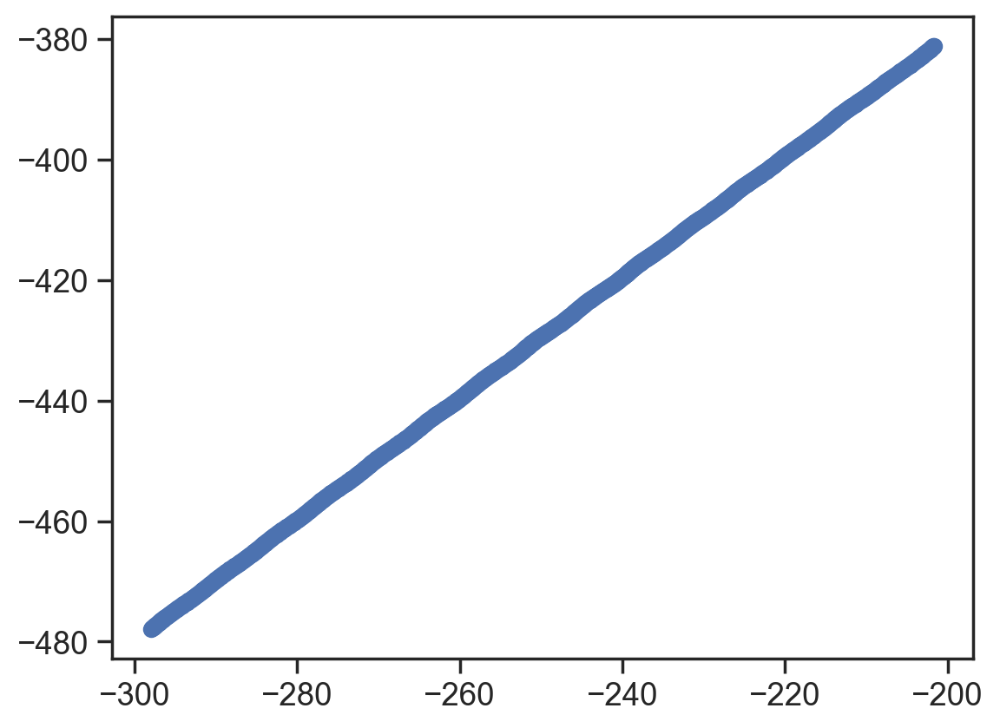

In [12341]:
bins_plot=np.arange(21*320, 25*320)
plt.scatter(all_angles_unw_smooth_original[1, bins_plot],all_angles_unw_smooth_original[2, bins_plot])

In [12322]:
discs_smooth_original[0]

array([ 3529,  3670,  3808,  3943,  4083,  4400,  4472,  4544,  4617,
        4690,  4765,  4840,  4917,  4996,  5078,  5166,  5261,  5356,
        5441,  5536,  5617,  5707,  5787,  5877,  5958,  6045,  6128,
        6215,  6303,  6389,  6472,  6559,  6642,  6731,  6810,  6903,
        6985,  7078,  7163,  7258,  7352,  7441,  7525,  7605,  7682,
        7758,  7834,  7908,  7981,  8056,  8130,  8203,  8279,  8640,
        8778,  8913,  9048,  9183,  9319,  9457,  9598,  9739,  9883,
       10030, 10185, 10327, 10466, 10604, 10739, 10874, 11010, 11151,
       11544, 11615, 11688, 11760, 11832, 11907, 11983, 12062, 12146,
       12239, 12334, 12429, 12518, 12603, 12686, 12778, 12865, 12956,
       13046, 13135, 13224, 13311, 13398, 13485, 13571, 13655, 13739,
       13823, 13906, 13990, 14073, 14155, 14237, 14320, 14402, 14485,
       14568, 14652, 14735, 14817, 14901, 14985, 15070, 15155, 15242,
       15330, 15406, 15480, 15552, 15625, 15697, 15770, 15843, 15915,
       15990, 16066,

In [12347]:
g_fr3 = np.copy(np.hstack((g_fr[:, 21*320:24*320], g_fr[:, 22*320:24*320])))


In [12355]:
1600/320

5.0

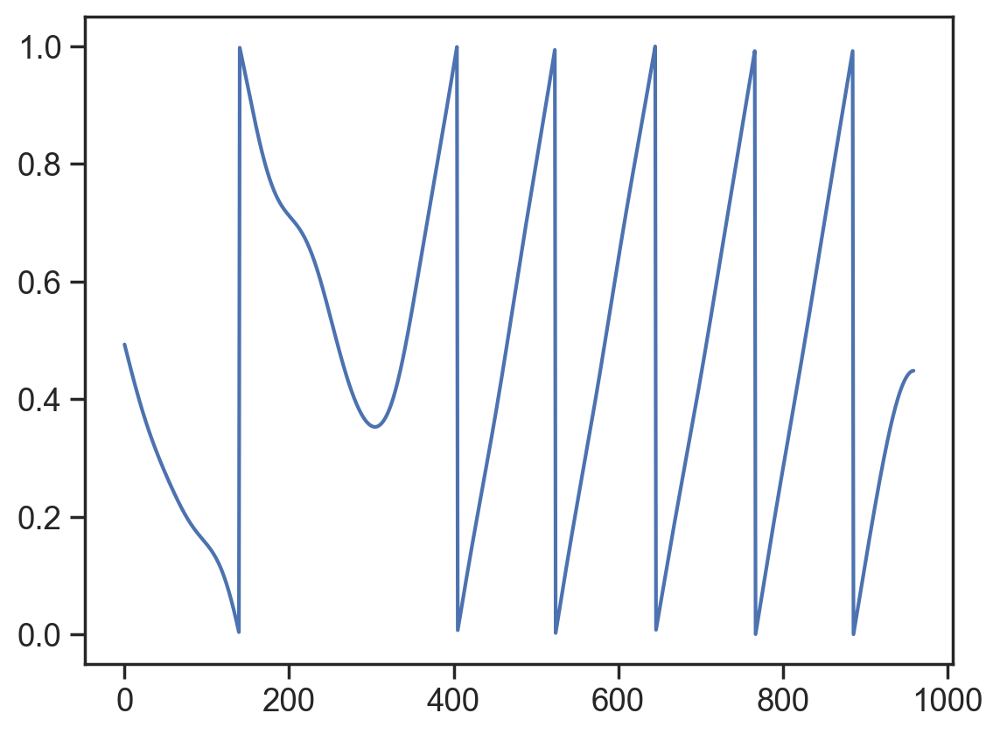

In [4998]:
plt.plot(all_angles_smooth_norm_original[2, 50*320:])

In [5117]:
# Good pinning example

# just use repeated dark trials and add pinning along the trajectory
# g_fr3=np.tile(np.expand_dims(g_fr2[:, 1, :], 1), (1,4,1))
# g_fr3 = np.copy(np.hstack((g_fr[:, 21*320:24*320], g_fr[:, 22*320:24*320])))

# pickle the variables here!!
# 1 trial each of: dark, 1lm, 2lm, 3lm

pil_use = True
save_fig = True
# base_save_dir = 'D:/Code/bump_video/sim/pinning_buildup_learned/'
base_save_dir = 'D:/Code/bump_video/sim/pinning_random_rearrangement/'

dpi_val=50
if pil_use:
    mpl.rcParams['figure.dpi'] = dpi_val

start_trial = 0
n_trials_pb_plot = 1

n_trials_plot = 5
# cmap_list = ['Greys', 'Reds', 'Greens', 'Blues', 'Purples']

# l_pos_pb 
sigma_smooth = 7
# maps_linearized = gaussian_filter1d(g_fr3[:resx*resy,:].reshape(resx*resy, -1), sigma_smooth)
maps_linearized = gaussian_filter1d(g_fr2[:resx*resy,:].reshape(resx*resy, -1), sigma_smooth)

spatial_window = 2
dist_per_seg = 20
track_length_plot = 1*track_length

n_windows = n_trials_plot * track_length_plot
save_dir = base_save_dir + f'{n_max_copies}'

n_skip = 1
sigma1 = 2
sigma2 = 2

n_max_copies = 6
distance_counter = 0
star_ms = np.maximum(60/(n_max_copies+1), 9) # might want to change this too if n_max_copies is small like 1 or 2
l_ms = np.maximum(250/(n_max_copies+1), 4) # might want to change this too if n_max_copies is small like 1 or 2
cmap_list = ['Greys', 'Reds', 'Greens', 'Blues']
try:
    plt.close('all')
    if save_fig:
        matplotlib.use('agg')
    else:
        %matplotlib inline

    pid=0
    old1=[]
    old2=[]
    aa_counter = [0]
    
    # cmap = mpl.colormaps[cmap_list[t]]
    # cmap = mpl.colormaps['Reds']
    # colors = cmap(np.linspace(0.2, n_trials_plot))

    # plot this block's data
    phase1_copy_idx = n_max_copies - 1
    phase2_copy_idx = n_max_copies
    
    start_frame = start_trial*track_length
    
    if not os.path.isdir(save_dir):
        os.makedirs(save_dir, exist_ok=True)
        
    trial_counter = 0

    for i in np.arange(n_windows):
        fig,ax=plt.subplots(1,1,figsize=(6,4))
        
        if ((i>0) and (np.mod(i, track_length_plot)==0)):
            trial_counter += 1
            phase1_copy_idx = n_max_copies -1 # reset back to top of sheet
            phase2_copy_idx = n_max_copies # reset back to top of sheet
            aa_counter.append(len(old1))


            
        start = i*n_skip+start_frame

        if trial_counter==3:
            start = i*n_skip+start_frame - 320*2
            
        dat = maps_linearized[:, start:start+spatial_window]


        
        dat = dat.mean(1)
        rm = zscore(dat, axis=0)
        # DOUBLE CHECK THIS IS THE CORRECT ORDER OF RESX RESY
        im = rm[gridsort].reshape(resx,resy) # original THIS IS RIGHT!!!!
        range_val = np.max(im)-np.min(im)
        im = np.divide(im - np.min(im), range_val)

        phase1_copies_added = []
        phase2_copies_added = []
        if start in discs_smooth_original[phase1_use]:
            if phase1_copy_idx - 1 < 1:
                phase1_copy_idx = n_max_copies-1
            else:
                phase1_copy_idx -= 1
    
        if (start in discs_smooth_original[phase2_use]): # or (trial_counter > 1 and start-640*trial_counter in discs_smooth_original[phase2_use])):
            if phase2_copy_idx - 1 < 1:
                phase2_copy_idx = n_max_copies
            else:
                phase2_copy_idx -= 1

        im_copies = np.tile(im, (n_max_copies, n_max_copies))
    
        if n_max_copies > 1:
            phase1_val = all_angles_smooth_norm_original[phase1_use, start]
            phase2_val = all_angles_smooth_norm_original[phase2_use, start]

            # if trial_counter ==1: # or trial_counter == 3:
            #     phase1_val = all_angles_smooth_norm_original[phase1_use, start] + 0.5
            # else:
                # phase2_val = all_angles_smooth_norm_original[phase2_use, start]

            # phase 1 will be associated with resx               
            phase1_loc = resx * (phase1_copy_idx-1) + int(np.round(phase1_val*resx))
            phase2_loc = resy * (phase2_copy_idx-1) + int(np.round(phase2_val*resy))
    
            if phase1_copy_idx == n_max_copies and phase1_val > 0.5:
                phase1_left_thr = int(np.round(phase1_val*resx)) - resx//2
                im_copies[phase1_left_thr:phase1_loc - resx//2, :] = 0
                phase1_right_thr = phase1_loc + resx//2
                im_copies[phase1_right_thr:, :] = 0
            elif phase1_copy_idx == 1 and phase1_val < 0.5:
                phase1_left_thr = phase1_loc + resx//2
                phase1_right_thr = (n_max_copies * resx) - resx // 4
                im_copies[phase1_left_thr:phase1_right_thr, :] = 0
            else:
                phase1_left_thr = phase1_loc - resx//2
                im_copies[0:phase1_left_thr, :] = 0
                phase1_right_thr = phase1_loc + resx//2
                im_copies[phase1_right_thr:, :] = 0
        
            if phase2_copy_idx == n_max_copies and phase2_val > 0.5:
                phase2_left_thr = int(np.round(phase2_val*resy)) - resy//2
                im_copies[:, phase2_left_thr:phase2_loc - resy//2] = 0
                phase2_right_thr = phase2_loc + resy//2
                im_copies[:, phase2_right_thr:] = 0
            elif phase2_copy_idx == 1 and phase2_val < 0.5:
                phase2_left_thr = phase2_loc + resy//2
                phase2_right_thr = (n_max_copies * resy) - resy // 4
                im_copies[:, phase2_left_thr:phase2_right_thr] = 0
            else:
                phase2_left_thr = phase2_loc - resy//2
                im_copies[:, 0:phase2_left_thr] = 0
                phase2_right_thr = phase2_loc + resy//2
                im_copies[:, phase2_right_thr:] = 0

            im_copies = gaussian_filter(im_copies, (sigma1, sigma2))
    
        x_copies, y_copies = np.mgrid[:n_max_copies*resx,:n_max_copies*resy]/resy
        u_copies, v_copies = coord_from_phase(x_copies+1,y_copies+1)
    
        plt.pcolormesh(u_copies, v_copies, im_copies, shading='auto')

        # # LANDMARK 1
        # g_lm = 3*(n_x+n_y)
        # glm1, glm2 = coord_from_phase((5*resx + phases_all[phase1_use][g_lm])/resx+1, 
        #                               (3.8*resy+phases_all[phase2_use][g_lm])/resy+1) 
        # # can color this cell by A_l (when the neuron is active)
        # this_lm_pos=130
        # lookahead=40
        # shift_factor=0
        # if ((i > 960+this_lm_pos-lookahead)):
        #     val = np.minimum(np.exp(-np.power(0.02*(960+this_lm_pos-i+lookahead-shift_factor),2)), 1)
        #     plt.plot(glm1, glm2, 'wo', ms=l_ms, mfc=[0.7,0,0,val], mew=4, mec='w')
        # elif ((i > 640+this_lm_pos-lookahead)):
        #     val = np.minimum(np.exp(-np.power(0.02*(640+this_lm_pos-i+lookahead-shift_factor),2)), 1)
        #     plt.plot(glm1, glm2, 'wo', ms=l_ms, mfc=[0.7,0,0,val], mew=4, mec='w')
        # elif ((i > 320+this_lm_pos-lookahead)):
        #     val = np.minimum(np.exp(-np.power(0.02*(320+this_lm_pos-i+lookahead-shift_factor),2)), 1)
        #     plt.plot(glm1, glm2, 'wo', ms=l_ms, mfc=[0.7,0,0,val], mew=4, mec='w')
        # else:
        #     plt.plot(glm1, glm2, 'wo', ms=l_ms, mfc=[0,0,0,0], mew=4, mec='w')

        # # LANDMARK 2
        # g_lm = 3*(n_x+n_y)
        # glm21, glm22 = coord_from_phase((5*resx + phases_all[phase1_use][g_lm])/resx+1, 
        #                               (4.75*resy+phases_all[phase2_use][g_lm])/resy+1) 
        # # can color this cell by A_l (when the neuron is active)
        # this_lm_pos=100
        # lookahead=40
        # shift_factor=0
        # if ((i > 960+this_lm_pos-lookahead)):
        #     val = np.minimum(np.exp(-np.power(0.02*(960+this_lm_pos-i+lookahead-shift_factor),2)), 1)
        #     plt.plot(glm21, glm22, 'wo', ms=l_ms, mfc=[0.7,0,0,val], mew=4, mec=[0.75, 0.75, 0.75, 0.75])
        # elif ((i > 640+this_lm_pos-lookahead)):
        #     val = np.minimum(np.exp(-np.power(0.02*(640+this_lm_pos-i+lookahead-shift_factor),2)), 1)
        #     plt.plot(glm21, glm22, 'wo', ms=l_ms, mfc=[0.7,0,0,val], mew=4, mec=[0.75, 0.75, 0.75, 0.75])
        # else:
        #     plt.plot(glm21, glm22, 'wo', ms=l_ms, mfc=[0,0,0,0], mew=4, mec=[0.75, 0.75, 0.75, 0.75])

        # # LANDMARK 3
        # g_lm = 3*(n_x+n_y)
        # glm31, glm32 = coord_from_phase((5*resx + phases_all[phase1_use][g_lm])/resx+1, 
        #                               (5.7*resy+phases_all[phase2_use][g_lm])/resy+1) 
        # # can color this cell by A_l (when the neuron is active)
        # this_lm_pos=40
        # lookahead=40
        # shift_factor=0
        # if ((i > 960+this_lm_pos-lookahead)):
        #     val = np.minimum(np.exp(-np.power(0.02*(960+this_lm_pos-i+lookahead-shift_factor),2)), 1)
        #     plt.plot(glm31, glm32, 'wo', ms=l_ms, mfc=[0.7,0,0,val], mew=4, mec=[0.5, 0.5, 0.5, 0.5])
        # else:
        #     plt.plot(glm31, glm32, 'wo', ms=l_ms, mfc=[0,0,0,0], mew=4, mec=[0.5, 0.5, 0.5, 0.5])
            
        
        if n_max_copies >= 0:
            if ((np.mod(i, dist_per_seg)==0) and (i>-1)): # every 40cm plot a star
                distance_counter+=1
                old1_temp, old2_temp = coord_from_phase((phase1_loc)/resy+1,(phase2_loc)/resy+1) # original THIS DOESN'T SEEM RIGHT NOW
                # old1_temp, old2_temp = coord_from_phase((phase2_loc)/resy+1,(phase1_loc)/resx+1) 
                old1.append(old1_temp)
                old2.append(old2_temp)
    
        if len(old1)>0: 
            aa=np.array(old1)
            bb=np.array(old2)
            
            if len(aa_counter) > 1:
                for trial_idx_plot in range(len(aa_counter)-1):
                    cmap = mpl.colormaps[cmap_list[trial_idx_plot]]

                    if trial_idx_plot==0:
                        colors = cmap(np.linspace(0.3, 0.6, 2))
                    else:
                        colors = cmap(np.linspace(0.4, 0.6, 2))
                        
                    plt.plot(aa[aa_counter[trial_idx_plot]:aa_counter[trial_idx_plot+1]],
                             bb[aa_counter[trial_idx_plot]:aa_counter[trial_idx_plot+1]],
                             color=colors[0], ms=star_ms, marker='*', linestyle='None')

                             #color=colors[trial_idx_plot], ms=star_ms, marker='*', linestyle='None')
                    
                # current incomplete trial to plot   
                # plt.plot(aa[aa_counter[trial_idx_plot+1]:],bb[aa_counter[trial_idx_plot+1]:],color=colors[trial_idx_plot+1], ms=star_ms, marker='*', linestyle='None')
                cmap = mpl.colormaps[cmap_list[trial_idx_plot+1]]
                if trial_idx_plot==0:
                    colors = cmap(np.linspace(0.3, 0.6, 2))
                else:
                    colors = cmap(np.linspace(0.4, 0.6, 2))
                plt.plot(aa[aa_counter[trial_idx_plot+1]:],bb[aa_counter[trial_idx_plot+1]:],color=colors[0], ms=star_ms, marker='*', linestyle='None')

            else:
                cmap = mpl.colormaps[cmap_list[0]]
                colors = cmap(np.linspace(0.3, 0.6, 2))

                plt.plot(aa,bb, color=colors[0], linestyle='None', marker='*',ms=star_ms)

            # trial_idxs_plot = np.concatenate((np.array([-1]), np.where(np.diff(aa) > 1)[0]))
            # if trial_idxs_plot.size > 1:
            #     trial_idxs_plot+=1
            #     for trial_idx in range(trial_idxs_plot.size-1):
            #         plt.plot(aa[trial_idxs_plot[trial_idx]+1:trial_idxs_plot[trial_idx+1]],
            #                  bb[trial_idxs_plot[trial_idx]+1:trial_idxs_plot[trial_idx+1]], 
            #                  linestyle='dashed', color=colors[trial_idx], ms=10)
                    
            # else:
            #         plt.plot(aa,bb,linestyle='dashed', color=colors[0], ms=10)
            
        plt.axis('off')
        ax.spines[['left','top','right','bottom']].set_visible(False)
        plt.xticks([])
        plt.yticks([])
        plt.title(f'{start}')

        if save_fig:
            if pil_use:
                img = fig2img(fig)
                img.save(os.path.join(save_dir,f'{pid:04d}.png'), quality=dpi_val)
                plt.close(fig)
            else:
                plt.savefig(os.path.join(save_dir,f'{pid:04d}.jpg'), dpi=dpi_val)
                # fig.savefig(os.path.join(save_dir,f'{pid:03d}.png'), dpi=dpi_val)
                plt.close(fig)
            
        pid += 1
        if np.mod(i, 320)==0:
            print(f'{i}')

except KeyboardInterrupt:
    print("\nProgram terminated by user.")
    plt.close('all')
    %matplotlib inline     
    mpl.rcParams['figure.dpi'] = 100

finally:
    print("\nProgram finished.")
    plt.close('all')
    %matplotlib inline       
    mpl.rcParams['figure.dpi'] = 100
# 

0
320
640
960

Program finished.


IndexError: list index out of range

In [12287]:
# pickle the variables here!!
# 1 trial each of: dark, 1lm, 2lm, 3lm
    
# # to be used for introduction of one, two, three landmarks compared to dark in pkl file called pinning_buildup.pkl
pil_use = True
save_fig = True
base_save_dir = 'D:/Code/bump_video/sim/pinning_buildup/'
dpi_val=300
if pil_use:
    mpl.rcParams['figure.dpi'] = dpi_val

start_trial = 0
n_trials_pb_plot = 1

n_trials_plot = 4
# cmap_list = ['Greys', 'Reds', 'Greens', 'Blues', 'Purples']

# l_pos_pb 
sigma_smooth = 7
maps_linearized = gaussian_filter1d(g_fr2[:resx*resy,:].reshape(resx*resy, -1), sigma_smooth)
spatial_window = 2
dist_per_seg = 20
track_length_plot = 1*track_length

n_windows = n_trials_plot * track_length_plot
save_dir = base_save_dir + f'{n_max_copies}_3'

n_skip = 1
sigma1 = 2
sigma2 = 2

n_max_copies = 6
distance_counter = 0
star_ms = np.maximum(60/(n_max_copies+1), 9) # might want to change this too if n_max_copies is small like 1 or 2
l_ms = np.maximum(250/(n_max_copies+1), 4) # might want to change this too if n_max_copies is small like 1 or 2
cmap_list = ['Greys', 'Reds', 'Greens', 'Blues']
try:
    plt.close('all')
    if save_fig:
        matplotlib.use('agg')
    else:
        %matplotlib inline

    pid=0
    old1=[]
    old2=[]
    aa_counter = [0]
    
    # cmap = mpl.colormaps[cmap_list[t]]
    # cmap = mpl.colormaps['Reds']
    # colors = cmap(np.linspace(0.2, n_trials_plot))

    # plot this block's data
    phase1_copy_idx = n_max_copies
    phase2_copy_idx = n_max_copies
    
    start_frame = start_trial*track_length
    
    if not os.path.isdir(save_dir):
        os.makedirs(save_dir, exist_ok=True)
        
    trial_counter = 0

    for i in np.arange(n_windows):
        fig,ax=plt.subplots(1,1,figsize=(6,4))
        
        if ((i>0) and (np.mod(i, track_length_plot)==0)):
            trial_counter += 1
            phase1_copy_idx = n_max_copies # reset back to top of sheet
            phase2_copy_idx = n_max_copies # reset back to top of sheet
            aa_counter.append(len(old1))


            
        start = i*n_skip+start_frame
        dat = maps_linearized[:, start:start+spatial_window]
        
        dat = dat.mean(1)
        rm = zscore(dat, axis=0)
        # DOUBLE CHECK THIS IS THE CORRECT ORDER OF RESX RESY
        im = rm[gridsort].reshape(resx,resy) # original THIS IS RIGHT!!!!
        range_val = np.max(im)-np.min(im)
        im = np.divide(im - np.min(im), range_val)

        phase1_copies_added = []
        phase2_copies_added = []
        if start in discs_smooth[phase1_use]:
            if phase1_copy_idx - 1 < 1:
                phase1_copy_idx = n_max_copies
            else:
                phase1_copy_idx -= 1
    
        if start in discs_smooth[phase2_use]:
            if phase2_copy_idx - 1 < 1:
                phase2_copy_idx = n_max_copies
            else:
                phase2_copy_idx -= 1

        im_copies = np.tile(im, (n_max_copies, n_max_copies))
    
        if n_max_copies > 1:
            phase1_val = all_angles_smooth_norm[phase1_use, start]
            phase2_val = all_angles_smooth_norm[phase2_use, start]
            
            # phase 1 will be associated with resx               
            phase1_loc = resx * (phase1_copy_idx-1) + int(np.round(phase1_val*resx))
            phase2_loc = resy * (phase2_copy_idx-1) + int(np.round(phase2_val*resy))
    
            if phase1_copy_idx == n_max_copies and phase1_val > 0.5:
                phase1_left_thr = int(np.round(phase1_val*resx)) - resx//2
                im_copies[phase1_left_thr:phase1_loc - resx//2, :] = 0
                phase1_right_thr = phase1_loc + resx//2
                im_copies[phase1_right_thr:, :] = 0
            elif phase1_copy_idx == 1 and phase1_val < 0.5:
                phase1_left_thr = phase1_loc + resx//2
                phase1_right_thr = (n_max_copies * resx) - resx // 4
                im_copies[phase1_left_thr:phase1_right_thr, :] = 0
            else:
                phase1_left_thr = phase1_loc - resx//2
                im_copies[0:phase1_left_thr, :] = 0
                phase1_right_thr = phase1_loc + resx//2
                im_copies[phase1_right_thr:, :] = 0
        
            if phase2_copy_idx == n_max_copies and phase2_val > 0.5:
                phase2_left_thr = int(np.round(phase2_val*resy)) - resy//2
                im_copies[:, phase2_left_thr:phase2_loc - resy//2] = 0
                phase2_right_thr = phase2_loc + resy//2
                im_copies[:, phase2_right_thr:] = 0
            elif phase2_copy_idx == 1 and phase2_val < 0.5:
                phase2_left_thr = phase2_loc + resy//2
                phase2_right_thr = (n_max_copies * resy) - resy // 4
                im_copies[:, phase2_left_thr:phase2_right_thr] = 0
            else:
                phase2_left_thr = phase2_loc - resy//2
                im_copies[:, 0:phase2_left_thr] = 0
                phase2_right_thr = phase2_loc + resy//2
                im_copies[:, phase2_right_thr:] = 0

            im_copies = gaussian_filter(im_copies, (sigma1, sigma2))
    
        x_copies, y_copies = np.mgrid[:n_max_copies*resx,:n_max_copies*resy]/resy
        u_copies, v_copies = coord_from_phase(x_copies+1,y_copies+1)
    
        plt.pcolormesh(u_copies, v_copies, im_copies, shading='auto')

        # LANDMARK 1
        g_lm = 3*(n_x+n_y)
        glm1, glm2 = coord_from_phase((5.3*resx + phases_all[phase1_use][g_lm])/resx+1, 
                                      (2*resy+phases_all[phase2_use][g_lm])/resy+1) 
        # can color this cell by A_l (when the neuron is active)
        this_lm_pos=130
        lookahead=40
        shift_factor=0
        if ((i > 960+this_lm_pos-lookahead)):
            val = np.minimum(np.exp(-np.power(0.02*(960+this_lm_pos-i+lookahead-shift_factor),2)), 1)
            plt.plot(glm1, glm2, 'wo', ms=l_ms, mfc=[0.7,0,0,val], mew=4, mec='w')
        elif ((i > 640+this_lm_pos-lookahead)):
            val = np.minimum(np.exp(-np.power(0.02*(640+this_lm_pos-i+lookahead-shift_factor),2)), 1)
            plt.plot(glm1, glm2, 'wo', ms=l_ms, mfc=[0.7,0,0,val], mew=4, mec='w')
        elif ((i > 320+this_lm_pos-lookahead)):
            val = np.minimum(np.exp(-np.power(0.02*(320+this_lm_pos-i+lookahead-shift_factor),2)), 1)
            plt.plot(glm1, glm2, 'wo', ms=l_ms, mfc=[0.7,0,0,val], mew=4, mec='w')
        else:
            plt.plot(glm1, glm2, 'wo', ms=l_ms, mfc=[0,0,0,0], mew=4, mec='w')

        # LANDMARK 2
        g_lm = 3*(n_x+n_y)
        glm21, glm22 = coord_from_phase((4*resx + phases_all[phase1_use][g_lm])/resx+1, 
                                      (5.5*resy+phases_all[phase2_use][g_lm])/resy+1) 
        # can color this cell by A_l (when the neuron is active)
        this_lm_pos=100
        lookahead=40
        shift_factor=0
        if ((i > 960+this_lm_pos-lookahead)):
            val = np.minimum(np.exp(-np.power(0.02*(960+this_lm_pos-i+lookahead-shift_factor),2)), 1)
            plt.plot(glm21, glm22, 'wo', ms=l_ms, mfc=[0.7,0,0,val], mew=4, mec=[0.75, 0.75, 0.75, 0.75])
        elif ((i > 640+this_lm_pos-lookahead)):
            val = np.minimum(np.exp(-np.power(0.02*(640+this_lm_pos-i+lookahead-shift_factor),2)), 1)
            plt.plot(glm21, glm22, 'wo', ms=l_ms, mfc=[0.7,0,0,val], mew=4, mec=[0.75, 0.75, 0.75, 0.75])
        else:
            plt.plot(glm21, glm22, 'wo', ms=l_ms, mfc=[0,0,0,0], mew=4, mec=[0.75, 0.75, 0.75, 0.75])

        # LANDMARK 3
        g_lm = 3*(n_x+n_y)
        glm31, glm32 = coord_from_phase((5.6*resx + phases_all[phase1_use][g_lm])/resx+1, 
                                      (3.8*resy+phases_all[phase2_use][g_lm])/resy+1) 
        # can color this cell by A_l (when the neuron is active)
        this_lm_pos=40
        lookahead=40
        shift_factor=0
        if ((i > 960+this_lm_pos-lookahead)):
            val = np.minimum(np.exp(-np.power(0.02*(960+this_lm_pos-i+lookahead-shift_factor),2)), 1)
            plt.plot(glm31, glm32, 'wo', ms=l_ms, mfc=[0.7,0,0,val], mew=4, mec=[0.5, 0.5, 0.5, 0.5])
        else:
            plt.plot(glm31, glm32, 'wo', ms=l_ms, mfc=[0,0,0,0], mew=4, mec=[0.5, 0.5, 0.5, 0.5])
            
        
        if n_max_copies >= 0:
            if ((np.mod(i, dist_per_seg)==0) and (i>-1)): # every 40cm plot a star
                distance_counter+=1
                old1_temp, old2_temp = coord_from_phase((phase1_loc)/resy+1,(phase2_loc)/resy+1) # original THIS DOESN'T SEEM RIGHT NOW
                # old1_temp, old2_temp = coord_from_phase((phase2_loc)/resy+1,(phase1_loc)/resx+1) 
                old1.append(old1_temp)
                old2.append(old2_temp)
    
        if len(old1)>0: 
            aa=np.array(old1)
            bb=np.array(old2)
            
            if len(aa_counter) > 1:
                for trial_idx_plot in range(len(aa_counter)-1):
                    cmap = mpl.colormaps[cmap_list[trial_idx_plot]]

                    if trial_idx_plot==0:
                        colors = cmap(np.linspace(0.3, 0.6, 2))
                    else:
                        colors = cmap(np.linspace(0.4, 0.6, 2))
                        
                    plt.plot(aa[aa_counter[trial_idx_plot]:aa_counter[trial_idx_plot+1]],
                             bb[aa_counter[trial_idx_plot]:aa_counter[trial_idx_plot+1]],
                             color=colors[0], ms=star_ms, marker='*', linestyle='None')

                             #color=colors[trial_idx_plot], ms=star_ms, marker='*', linestyle='None')
                    
                # current incomplete trial to plot   
                # plt.plot(aa[aa_counter[trial_idx_plot+1]:],bb[aa_counter[trial_idx_plot+1]:],color=colors[trial_idx_plot+1], ms=star_ms, marker='*', linestyle='None')
                cmap = mpl.colormaps[cmap_list[trial_idx_plot+1]]
                if trial_idx_plot==0:
                    colors = cmap(np.linspace(0.3, 0.6, 2))
                else:
                    colors = cmap(np.linspace(0.4, 0.6, 2))
                plt.plot(aa[aa_counter[trial_idx_plot+1]:],bb[aa_counter[trial_idx_plot+1]:],color=colors[0], ms=star_ms, marker='*', linestyle='None')

            else:
                cmap = mpl.colormaps[cmap_list[0]]
                colors = cmap(np.linspace(0.3, 0.6, 2))

                plt.plot(aa,bb, color=colors[0], linestyle='None', marker='*',ms=star_ms)

            # trial_idxs_plot = np.concatenate((np.array([-1]), np.where(np.diff(aa) > 1)[0]))
            # if trial_idxs_plot.size > 1:
            #     trial_idxs_plot+=1
            #     for trial_idx in range(trial_idxs_plot.size-1):
            #         plt.plot(aa[trial_idxs_plot[trial_idx]+1:trial_idxs_plot[trial_idx+1]],
            #                  bb[trial_idxs_plot[trial_idx]+1:trial_idxs_plot[trial_idx+1]], 
            #                  linestyle='dashed', color=colors[trial_idx], ms=10)
                    
            # else:
            #         plt.plot(aa,bb,linestyle='dashed', color=colors[0], ms=10)
            
        plt.axis('off')
        ax.spines[['left','top','right','bottom']].set_visible(False)
        plt.xticks([])
        plt.yticks([])
        plt.title(f'{start}')

        if save_fig:
            if pil_use:
                img = fig2img(fig)
                img.save(os.path.join(save_dir,f'{pid:04d}.png'), quality=dpi_val)
                plt.close(fig)
            else:
                plt.savefig(os.path.join(save_dir,f'{pid:04d}.jpg'), dpi=dpi_val)
                # fig.savefig(os.path.join(save_dir,f'{pid:03d}.png'), dpi=dpi_val)
                plt.close(fig)
            
        pid += 1
        if np.mod(i, 320)==0:
            print(f'{i}')

except KeyboardInterrupt:
    print("\nProgram terminated by user.")
    plt.close('all')
    %matplotlib inline     
    mpl.rcParams['figure.dpi'] = 100

finally:
    print("\nProgram finished.")
    plt.close('all')
    %matplotlib inline       
    mpl.rcParams['figure.dpi'] = 100
# 

0
320
640
960

Program finished.


In [10313]:
# pickle the variables here

# filename = 'D:/Code/bump_video/sim/sim_pinning_at_80_180_not_harmonious_good_for_80_alone.pkl'
    
# with open(filename, 'rb') as file:
#     pickle_dat = pickle.load(file)
    
# file.close()

# g_fr2 = pickle_dat["g_fr2"]
# raw_maps = pickle_dat["raw_maps"]
# gridsort=pickle_dat["gridsort"]
# resx=pickle_dat["resx"]
# resy=pickle_dat["resy"]
# phases_all=pickle_dat["phases_all"]
# discs_smooth=pickle_dat["discs_smooth"]
# all_angles_smooth=pickle_dat["all_angles_smooth"]
# all_angles_smooth_norm=pickle_dat["all_angles_smooth_norm"]
# phase1_use=pickle_dat["phase1_use"]
# phase2_use=pickle_dat["phase2_use"]
# A=pickle_dat["A"]
# B=pickle_dat["B"]
# W=pickle_dat["W"]
# scaled_velocity=pickle_dat["scaled_velocity"]
# posx_lin=pickle_dat["posx_lin"]
# posx=pickle_dat["posx"]
# velocity=pickle_dat["velocity"]
# block_timebin_starts=pickle_dat["block_timebin_starts"]
# l_pos_pb=pickle_dat["l_pos_pb"]
# trials_pb=pickle_dat["trials_pb"]
# n_timebins=pickle_dat["n_timebins"]
# init_state=pickle_dat["init_state"]
# cell_position_diffs=pickle_dat["cell_position_diffs"]
# n_y=pickle_dat["n_y"]
# n_x=pickle_dat["n_x"]
# pickle_dat["n_y"]
    
# # to be used for introduction of one landmark compared to dark in pkl file called sim_pinning_at_80_180_not_harmonious_80_only.pkl
pil_use = True
save_fig = True
base_save_dir = 'D:/Code/bump_video/sim/pinning_80_no_copies/'

dpi_val=50
if pil_use:
    mpl.rcParams['figure.dpi'] = dpi_val


tpb_cs_all = np.array([2, 2])

n_trials_plot = 2
cmap_list = ['Reds']

# cmap_list = ['Greys', 'Reds', 'Oranges', 'Greens', 'Blues', 'Purples',
#             'Greys', 'Reds', 'Oranges', 'Greens', 'Blues', 'Purples']

# bins_plot = []
# for b in range(tpb_cs_all.shape[0]-1):
#     bins_plot.append(np.arange(track_length * tpb_cs_all[b], n_trials_plot * track_length + track_length * tpb_cs_all[b]))                
# bins_plot = np.array(bins_plot, dtype='object')
 
sigma_smooth = 4
# maps_linearized = gaussian_filter1d(g_fr[:resx*resy,:].reshape(resx*resy, -1), sigma_smooth)
maps_linearized = gaussian_filter1d(g_fr2[:resx*resy,:].reshape(resx*resy, -1), sigma_smooth)
# maps_linearized = g_fr2[:resx*resy,:].reshape(resx*resy, -1)


spatial_window = 2
dist_per_seg = 20
track_length_plot = 1*track_length

n_skip = 1
sigma1 = 2
sigma2 = 2

n_max_copies = 5
distance_counter = 0
star_ms = np.maximum(50/(n_max_copies+1), 5) # might want to change this too if n_max_copies is small like 1 or 2
l_ms = np.maximum(250/(n_max_copies+1), 5) # might want to change this too if n_max_copies is small like 1 or 2

try:
    plt.close('all')
    if save_fig:
        matplotlib.use('agg')
    else:
        %matplotlib inline
       

    for b in np.arange(tpb_cs_all.shape[0]-1):
        pid = 0
        phase1_copy_idx = n_max_copies
        phase2_copy_idx = n_max_copies
        old1=[]
        old2=[]
        n_windows = track_length_plot * n_trials_plot

        start_frame = track_length * tpb_cs_all[b] 
        save_dir = base_save_dir + f'{n_max_copies}_block{b}'
        
        if not os.path.isdir(save_dir):
            os.makedirs(save_dir, exist_ok=True)
            
        trial_counter = 0
        aa_counter = [0]
        cmap = mpl.colormaps[cmap_list[b]]
        # colors = cmap(np.linspace(0.4, 0.8, n_trials_plot)) # 1 is less white, 0 is white
        colors = cmap(np.linspace(0.2, 0.6, n_trials_plot))

                
        for i in np.arange(n_windows):
            fig,ax=plt.subplots(1,1,figsize=(6,4))
            
            if ((i>0) and (np.mod(i, track_length_plot)==0)):
                trial_counter += 1
                phase1_copy_idx = n_max_copies # reset back to top of sheet
                phase2_copy_idx = n_max_copies # reset back to top of sheet
                aa_counter.append(len(old1))
                
            start = i*n_skip+start_frame
            dat = maps_linearized[:, start:start+spatial_window]
            
            dat = dat.mean(1)
            rm = zscore(dat, axis=0)
            # DOUBLE CHECK THIS IS THE CORRECT ORDER OF RESX RESY
            im = rm[gridsort].reshape(resx,resy) # original THIS IS RIGHT!!!!
            range_val = np.max(im)-np.min(im)
            im = np.divide(im - np.min(im), range_val)
            # im = rm[gridsort].reshape(resy,resx) # TRYING THIS, BUT MIGHT BE FLIPPED ACTUALLY # resy in dim0, resx in dim1. THIS IS WRONG!!!

            # # MAYBE JUST DON'T DO THE COPIES. IF THE SORT WAS RIGHT, IT SHOULD WRAP AROUND BY ITSELF.
            # im_weak=1*im
            # im_exp_full=np.tile(im_weak,(3,3))
            # im_exp_full[resx:2*resx,resy:2*resy]=im

            # im_exp_full_smooth = gaussian_filter(im_exp_full, (sigma1, sigma2))
    
            # range_val = (np.max(im_exp_full_smooth.reshape(-1)) -
            #         np.min(im_exp_full_smooth.reshape(-1)))
            # im_exp_full_smooth = np.divide(im_exp_full_smooth
            #                               - np.min(im_exp_full_smooth.reshape(-1)),
            #                               range_val)
            
            # im=im_exp_full_smooth[resx:2*resx,resy:2*resy]
        
            phase1_copies_added = []
            phase2_copies_added = []
            if start in discs_smooth[phase1_use]:
                if phase1_copy_idx - 1 < 1:
                    phase1_copy_idx = n_max_copies
                else:
                    phase1_copy_idx -= 1
        
            if start in discs_smooth[phase2_use]:
                if phase2_copy_idx - 1 < 1:
                    phase2_copy_idx = n_max_copies
                else:
                    phase2_copy_idx -= 1
   
            im_copies = np.tile(im, (n_max_copies, n_max_copies))
        
            if n_max_copies > 1:

                phase1_val = all_angles_smooth_norm[phase1_use, start]
                phase2_val = all_angles_smooth_norm[phase2_use, start]
                
                # phase 1 will be associated with resx               
                phase1_loc = resx * (phase1_copy_idx-1) + int(np.round(phase1_val*resx))
                phase2_loc = resy * (phase2_copy_idx-1) + int(np.round(phase2_val*resy))
        
                if phase1_copy_idx == n_max_copies and phase1_val > 0.5:
                    phase1_left_thr = int(np.round(phase1_val*resx)) - resx//2
                    im_copies[phase1_left_thr:phase1_loc - resx//2, :] = 0
                    phase1_right_thr = phase1_loc + resx//2
                    im_copies[phase1_right_thr:, :] = 0
                elif phase1_copy_idx == 1 and phase1_val < 0.5:
                    phase1_left_thr = phase1_loc + resx//2
                    phase1_right_thr = (n_max_copies * resx) - resx // 4
                    im_copies[phase1_left_thr:phase1_right_thr, :] = 0
                else:
                    phase1_left_thr = phase1_loc - resx//2
                    im_copies[0:phase1_left_thr, :] = 0
                    phase1_right_thr = phase1_loc + resx//2
                    im_copies[phase1_right_thr:, :] = 0
            
                if phase2_copy_idx == n_max_copies and phase2_val > 0.5:
                    phase2_left_thr = int(np.round(phase2_val*resy)) - resy//2
                    im_copies[:, phase2_left_thr:phase2_loc - resy//2] = 0
                    phase2_right_thr = phase2_loc + resy//2
                    im_copies[:, phase2_right_thr:] = 0
                elif phase2_copy_idx == 1 and phase2_val < 0.5:
                    phase2_left_thr = phase2_loc + resy//2
                    phase2_right_thr = (n_max_copies * resy) - resy // 4
                    im_copies[:, phase2_left_thr:phase2_right_thr] = 0
                else:
                    phase2_left_thr = phase2_loc - resy//2
                    im_copies[:, 0:phase2_left_thr] = 0
                    phase2_right_thr = phase2_loc + resy//2
                    im_copies[:, phase2_right_thr:] = 0
    
                im_copies = gaussian_filter(im_copies, (sigma1, sigma2))
        
            x_copies, y_copies = np.mgrid[:n_max_copies*resx,:n_max_copies*resy]/resy
            u_copies, v_copies = coord_from_phase(x_copies+1,y_copies+1)
        
            plt.pcolormesh(u_copies, v_copies, im_copies, shading='auto')
            
            g_lm = 3*(n_x+n_y)
            glm1, glm2 = coord_from_phase((5*resx + phases_all[phase1_use][g_lm])/resx+1, 
                                          (2*resy+phases_all[phase2_use][g_lm])/resy+1) 


            
            # can color this cell by A_l (when the neuron is active)
            this_lm_pos=120
            lookahead=80
            shift_factor=80
            if ((i > 320+this_lm_pos-lookahead)):
                val = np.minimum(np.exp(-np.power(0.015*(320+this_lm_pos-i+lookahead-shift_factor),2)), 1)
                plt.plot(glm1, glm2, 'wo', ms=l_ms, mfc=[0.7,0,0,val], mew=5, mec='w')
            else:
                plt.plot(glm1, glm2, 'wo', ms=l_ms, mfc=[0,0,0,0], mew=5, mec='w')
                
            
            if n_max_copies >= 0:
                if ((np.mod(i, dist_per_seg)==0) and (i>-1)): # every 40cm plot a star
                    distance_counter+=1
                    old1_temp, old2_temp = coord_from_phase((phase1_loc)/resy+1,(phase2_loc)/resy+1) # original THIS DOESN'T SEEM RIGHT NOW
                    # old1_temp, old2_temp = coord_from_phase((phase2_loc)/resy+1,(phase1_loc)/resx+1) 
                    old1.append(old1_temp)
                    old2.append(old2_temp)
        
            if len(old1)>0: 
                aa=np.array(old1)
                bb=np.array(old2)
                
                if len(aa_counter) > 1:
                    for trial_idx_plot in range(len(aa_counter)-1):
                        plt.plot(aa[aa_counter[trial_idx_plot]:aa_counter[trial_idx_plot+1]],
                                 bb[aa_counter[trial_idx_plot]:aa_counter[trial_idx_plot+1]],
                                 color=colors[trial_idx_plot], ms=star_ms, marker='*', linestyle='None')
                        
                    # current incomplete trial to plot   
                    plt.plot(aa[aa_counter[trial_idx_plot+1]:],bb[aa_counter[trial_idx_plot+1]:],color=colors[trial_idx_plot+1], ms=star_ms, marker='*', linestyle='None')
                else:
                    plt.plot(aa,bb, color=colors[0], linestyle='None', marker='*',ms=star_ms)

                # trial_idxs_plot = np.concatenate((np.array([-1]), np.where(np.diff(aa) > 1)[0]))
                # if trial_idxs_plot.size > 1:
                #     trial_idxs_plot+=1
                #     for trial_idx in range(trial_idxs_plot.size-1):
                #         plt.plot(aa[trial_idxs_plot[trial_idx]+1:trial_idxs_plot[trial_idx+1]],
                #                  bb[trial_idxs_plot[trial_idx]+1:trial_idxs_plot[trial_idx+1]], 
                #                  linestyle='dashed', color=colors[trial_idx], ms=10)
                        
                # else:
                #         plt.plot(aa,bb,linestyle='dashed', color=colors[0], ms=10)
                
            plt.axis('off')
            ax.spines[['left','top','right','bottom']].set_visible(False)
            plt.xticks([])
            plt.yticks([])
            plt.title(f'{start}')
    
            if save_fig:
                if pil_use:
                    img = fig2img(fig)
                    img.save(os.path.join(save_dir,f'{pid:04d}.png'), quality=dpi_val)
                    plt.close(fig)
                else:
                    plt.savefig(os.path.join(save_dir,f'{pid:04d}.jpg'), dpi=dpi_val)
                    # fig.savefig(os.path.join(save_dir,f'{pid:03d}.png'), dpi=dpi_val)
                    plt.close(fig)
                
            pid += 1
            if np.mod(i, 320)==0:
                print(f'{i}')

except KeyboardInterrupt:
    print("\nProgram terminated by user.")
    plt.close('all')
    %matplotlib inline     
    mpl.rcParams['figure.dpi'] = 100

finally:
    print("\nProgram finished.")
    plt.close('all')
    %matplotlib inline       
    mpl.rcParams['figure.dpi'] = 100
# 

FileNotFoundError: [Errno 2] No such file or directory: 'D:/Code/bump_video/sim/sim_pinning_at_80_180_not_harmonious_80_only.pkl'

## DON'T NEED TO HAVE THE COPIES IN VIDEO MAKING FOR SIM. BUT MIGHT NEED IT FOR REAL DATA WHERE IT'S MESSIER?

In [10314]:
# pickle the variables here
# to be used for two landmarks fighting each other in pkl file called sim_pinning_at_80_180_not_harmonious_good_for_80_alone


filename = 'D:/Code/bump_video/sim/sim_pinning_at_80_180_not_harmonious_good_for_80_alone.pkl'
    
with open(filename, 'rb') as file:
    pickle_dat = pickle.load(file)
    
file.close()

g_fr2 = pickle_dat["g_fr2"]
raw_maps = pickle_dat["raw_maps"]
gridsort=pickle_dat["gridsort"]
resx=pickle_dat["resx"]
resy=pickle_dat["resy"]
phases_all=pickle_dat["phases_all"]
discs_smooth=pickle_dat["discs_smooth"]
all_angles_smooth=pickle_dat["all_angles_smooth"]
all_angles_smooth_norm=pickle_dat["all_angles_smooth_norm"]
phase1_use=pickle_dat["phase1_use"]
phase2_use=pickle_dat["phase2_use"]
A=pickle_dat["A"]
B=pickle_dat["B"]
W=pickle_dat["W"]
scaled_velocity=pickle_dat["scaled_velocity"]
posx_lin=pickle_dat["posx_lin"]
posx=pickle_dat["posx"]
velocity=pickle_dat["velocity"]
block_timebin_starts=pickle_dat["block_timebin_starts"]
l_pos_pb=pickle_dat["l_pos_pb"]
trials_pb=pickle_dat["trials_pb"]
n_timebins=pickle_dat["n_timebins"]
init_state=pickle_dat["init_state"]
cell_position_diffs=pickle_dat["cell_position_diffs"]
n_y=pickle_dat["n_y"]
n_x=pickle_dat["n_x"]
pickle_dat["n_y"]

pil_use = True
save_fig = True
base_save_dir = 'D:/Code/bump_video/sim/pinning_80_180_no_copies/'

dpi_val=20
if pil_use:
    mpl.rcParams['figure.dpi'] = dpi_val


# tpb_cs_all = np.concatenate((np.array([0]), tpb_cs))
# tpb_cs_all = np.array([49, 60, 70, 80, 90, 110]) 
# tpb_cs_all = np.array([60, 70, 80, 90, 110]) 

# tpb_cs_all = np.arange(40, 110, 10)
# tpb_cs_all = np.arange(85, 110, 1)
tpb_cs_all = np.array([2, 2])

phase1_use=0 # un hard code
phase2_use=2 # un hard code


n_trials_plot = 2
cmap_list = ['Reds']

# cmap_list = ['Greys', 'Reds', 'Oranges', 'Greens', 'Blues', 'Purples',
#             'Greys', 'Reds', 'Oranges', 'Greens', 'Blues', 'Purples']

# bins_plot = []
# for b in range(tpb_cs_all.shape[0]-1):
#     bins_plot.append(np.arange(track_length * tpb_cs_all[b], n_trials_plot * track_length + track_length * tpb_cs_all[b]))                
# bins_plot = np.array(bins_plot, dtype='object')
 
sigma_smooth = 2
# maps_linearized = gaussian_filter1d(g_fr[:resx*resy,:].reshape(resx*resy, -1), sigma_smooth)
maps_linearized = gaussian_filter1d(g_fr2[:resx*resy,:].reshape(resx*resy, -1), sigma_smooth)
# maps_linearized = g_fr2[:resx*resy,:].reshape(resx*resy, -1)


spatial_window = 2
dist_per_seg = 20
track_length_plot = 1*track_length

n_skip = 1
sigma1 = 2
sigma2 = 2

n_max_copies = 5
distance_counter = 0
star_ms = np.maximum(50/(n_max_copies+1), 5) # might want to change this too if n_max_copies is small like 1 or 2
l_ms = np.maximum(250/(n_max_copies+1), 5) # might want to change this too if n_max_copies is small like 1 or 2

try:
    plt.close('all')
    if save_fig:
        matplotlib.use('agg')
    else:
        %matplotlib inline
       

    for b in np.arange(tpb_cs_all.shape[0]-1):
        pid = 0
        phase1_copy_idx = n_max_copies
        phase2_copy_idx = n_max_copies
        old1=[]
        old2=[]
        n_windows = track_length_plot * n_trials_plot

        start_frame = track_length * tpb_cs_all[b] 
        save_dir = base_save_dir + f'{n_max_copies}_block{b}'
        
        if not os.path.isdir(save_dir):
            os.makedirs(save_dir, exist_ok=True)
            
        trial_counter = 0
        aa_counter = [0]
        cmap = mpl.colormaps[cmap_list[b]]
        # colors = cmap(np.linspace(0.4, 0.8, n_trials_plot)) # 1 is less white, 0 is white
        colors = cmap(np.linspace(0.2, 0.6, n_trials_plot))

                
        for i in np.arange(n_windows):
            fig,ax=plt.subplots(1,1,figsize=(6,4))
            
            if ((i>0) and (np.mod(i, track_length_plot)==0)):
                trial_counter += 1
                phase1_copy_idx = n_max_copies # reset back to top of sheet
                phase2_copy_idx = n_max_copies # reset back to top of sheet
                aa_counter.append(len(old1))
                
            start = i*n_skip+start_frame
            dat = maps_linearized[:, start:start+spatial_window]
            
            dat = dat.mean(1)
            rm = zscore(dat, axis=0)
            # DOUBLE CHECK THIS IS THE CORRECT ORDER OF RESX RESY
            im = rm[gridsort].reshape(resx,resy) # original THIS IS RIGHT!!!!
            # im = rm[gridsort].reshape(resy,resx) # TRYING THIS, BUT MIGHT BE FLIPPED ACTUALLY # resy in dim0, resx in dim1. THIS IS WRONG!!!

            if i > (320+150):
                phase1_use=2
                phase2_use=0
            
            im_weak=1*im
            im_exp_full=np.tile(im_weak,(3,3))
            im_exp_full[resx:2*resx,resy:2*resy]=im
            im_exp_full_smooth = gaussian_filter(im_exp_full, (sigma1, sigma2))
    
            range_val = (np.max(im_exp_full_smooth.reshape(-1)) -
                    np.min(im_exp_full_smooth.reshape(-1)))
            im_exp_full_smooth = np.divide(im_exp_full_smooth
                                          - np.min(im_exp_full_smooth.reshape(-1)),
                                          range_val)
            im=im_exp_full_smooth[resx:2*resx,resy:2*resy]
        
            phase1_copies_added = []
            phase2_copies_added = []
            if start in discs_smooth[phase1_use]:
                if phase1_copy_idx - 1 < 1:
                    phase1_copy_idx = n_max_copies
                else:
                    phase1_copy_idx -= 1
        
            if start in discs_smooth[phase2_use]:
                if phase2_copy_idx - 1 < 1:
                    phase2_copy_idx = n_max_copies
                else:
                    phase2_copy_idx -= 1
   
            im_copies = np.tile(im, (n_max_copies, n_max_copies))
        
            if n_max_copies > 1:

                phase1_val = all_angles_smooth_norm[phase1_use, start]
                phase2_val = all_angles_smooth_norm[phase2_use, start]
                
                # phase 1 will be associated with resx               
                phase1_loc = resx * (phase1_copy_idx-1) + int(np.round(phase1_val*resx))
                phase2_loc = resy * (phase2_copy_idx-1) + int(np.round(phase2_val*resy))
        
                if phase1_copy_idx == n_max_copies and phase1_val > 0.5:
                    phase1_left_thr = int(np.round(phase1_val*resx)) - resx//2
                    im_copies[phase1_left_thr:phase1_loc - resx//2, :] = 0
                    phase1_right_thr = phase1_loc + resx//2
                    im_copies[phase1_right_thr:, :] = 0
                elif phase1_copy_idx == 1 and phase1_val < 0.5:
                    phase1_left_thr = phase1_loc + resx//2
                    phase1_right_thr = (n_max_copies * resx) - resx // 4
                    im_copies[phase1_left_thr:phase1_right_thr, :] = 0
                else:
                    phase1_left_thr = phase1_loc - resx//2
                    im_copies[0:phase1_left_thr, :] = 0
                    phase1_right_thr = phase1_loc + resx//2
                    im_copies[phase1_right_thr:, :] = 0
            
                if phase2_copy_idx == n_max_copies and phase2_val > 0.5:
                    phase2_left_thr = int(np.round(phase2_val*resy)) - resy//2
                    im_copies[:, phase2_left_thr:phase2_loc - resy//2] = 0
                    phase2_right_thr = phase2_loc + resy//2
                    im_copies[:, phase2_right_thr:] = 0
                elif phase2_copy_idx == 1 and phase2_val < 0.5:
                    phase2_left_thr = phase2_loc + resy//2
                    phase2_right_thr = (n_max_copies * resy) - resy // 4
                    im_copies[:, phase2_left_thr:phase2_right_thr] = 0
                else:
                    phase2_left_thr = phase2_loc - resy//2
                    im_copies[:, 0:phase2_left_thr] = 0
                    phase2_right_thr = phase2_loc + resy//2
                    im_copies[:, phase2_right_thr:] = 0
    
                im_copies = gaussian_filter(im_copies, (sigma1, sigma2))
        
            x_copies, y_copies = np.mgrid[:n_max_copies*resx,:n_max_copies*resy]/resy
            u_copies, v_copies = coord_from_phase(x_copies+1,y_copies+1)
        
            plt.pcolormesh(u_copies, v_copies, im_copies, shading='auto')
            
            g_lm = 3*(n_x+n_y)
            glm1, glm2 = coord_from_phase((5*resx + phases_all[0][g_lm])/resx+1, # un hard code
                                          (2*resy+phases_all[2][g_lm])/resy+1) # un hard code

            g_lm2 = 48
            glm21, glm22 = coord_from_phase((2*resx + phases_all[0][g_lm2])/resx+1,# un hard code
                                            (3*resy+phases_all[2][g_lm2])/resy+1) # un hard code
            
            # can color this cell by A_l (when the neuron is active)
            this_lm_pos=120
            lookahead=80
            shift_factor=80
            if ((i > this_lm_pos-lookahead) and (i <320)):
                val = np.minimum(np.exp(-np.power(0.015*(this_lm_pos-i+lookahead-shift_factor),2)), 1)
                plt.plot(glm1, glm2, 'wo', ms=l_ms, mfc=[0.7,0,0,val], mew=5, mec='w')
            elif(i > 320+this_lm_pos-lookahead):
                val = np.minimum(np.exp(-np.power(0.015*(320+this_lm_pos-i+lookahead-shift_factor),2)), 1)
                plt.plot(glm1, glm2, 'wo', ms=l_ms, mfc=[0.7,0,0,val], mew=5, mec='w')
            else:
                plt.plot(glm1, glm2, 'wo', ms=l_ms, mfc=[0,0,0,0], mew=5, mec='w')

            this_lm_pos=200
            lookahead=120
            shift_factor=140
            if (i > 320+lm_pos-lookahead):
                val = np.minimum(np.exp(-np.power(0.015*(320+this_lm_pos-i+lookahead-shift_factor),2)), 1)
                plt.plot(glm21, glm22, 'o', ms=l_ms, mfc=[0.7,0,0,val], mew=5, mec=[0.5,0.5,0.5,0.5])
            else:
                plt.plot(glm21, glm22, 'o', ms=l_ms, mfc=[0,0,0,0], mew=5,  mec=[0.5,0.5,0.5,0.5])

            # if (i > 640+lm_pos-lookahead):
            #     val = np.minimum(np.exp(-np.power(0.015*(640+lm_pos-i+lookahead-shift_factor),2)), 1)
            #     plt.plot(glm1, glm2, 'wo', ms=l_ms, mfc=[0.7,0,0,val], mew=5, mec='w')
            # else:
            #     plt.plot(glm1, glm2, 'wo', ms=l_ms, mfc=[0,0,0,0], mew=5, mec='w')
                
            
            if n_max_copies >= 0:
                if ((np.mod(i, dist_per_seg)==0) and (i>-1)): # every 40cm plot a star
                    distance_counter+=1
                    old1_temp, old2_temp = coord_from_phase((phase1_loc)/resy+1,(phase2_loc)/resy+1) # original THIS DOESN'T SEEM RIGHT NOW
                    # old1_temp, old2_temp = coord_from_phase((phase2_loc)/resy+1,(phase1_loc)/resx+1) 
                    old1.append(old1_temp)
                    old2.append(old2_temp)
        
            if len(old1)>0: 
                aa=np.array(old1)
                bb=np.array(old2)
                
                if len(aa_counter) > 1:
                    for trial_idx_plot in range(len(aa_counter)-1):
                        plt.plot(aa[aa_counter[trial_idx_plot]:aa_counter[trial_idx_plot+1]],
                                 bb[aa_counter[trial_idx_plot]:aa_counter[trial_idx_plot+1]],
                                 color=colors[trial_idx_plot], ms=star_ms, marker='*', linestyle='None')
                        
                    # current incomplete trial to plot   
                    plt.plot(aa[aa_counter[trial_idx_plot+1]:],bb[aa_counter[trial_idx_plot+1]:],color=colors[trial_idx_plot+1], ms=star_ms, marker='*', linestyle='None')
                else:
                    plt.plot(aa,bb, color=colors[0], linestyle='None', marker='*',ms=star_ms)

                # trial_idxs_plot = np.concatenate((np.array([-1]), np.where(np.diff(aa) > 1)[0]))
                # if trial_idxs_plot.size > 1:
                #     trial_idxs_plot+=1
                #     for trial_idx in range(trial_idxs_plot.size-1):
                #         plt.plot(aa[trial_idxs_plot[trial_idx]+1:trial_idxs_plot[trial_idx+1]],
                #                  bb[trial_idxs_plot[trial_idx]+1:trial_idxs_plot[trial_idx+1]], 
                #                  linestyle='dashed', color=colors[trial_idx], ms=10)
                        
                # else:
                #         plt.plot(aa,bb,linestyle='dashed', color=colors[0], ms=10)
                
            plt.axis('off')
            ax.spines[['left','top','right','bottom']].set_visible(False)
            plt.xticks([])
            plt.yticks([])
            plt.title(f'{start}')
    
            if save_fig:
                if pil_use:
                    img = fig2img(fig)
                    img.save(os.path.join(save_dir,f'{pid:04d}.png'), quality=dpi_val)
                    plt.close(fig)
                else:
                    plt.savefig(os.path.join(save_dir,f'{pid:04d}.jpg'), dpi=dpi_val)
                    # fig.savefig(os.path.join(save_dir,f'{pid:03d}.png'), dpi=dpi_val)
                    plt.close(fig)
                
            pid += 1
            if np.mod(i, 320)==0:
                print(f'{i}')

except KeyboardInterrupt:
    print("\nProgram terminated by user.")
    plt.close('all')
    %matplotlib inline     
    mpl.rcParams['figure.dpi'] = 100

finally:
    print("\nProgram finished.")
    plt.close('all')
    %matplotlib inline       
    mpl.rcParams['figure.dpi'] = 100


0
320

Program finished.


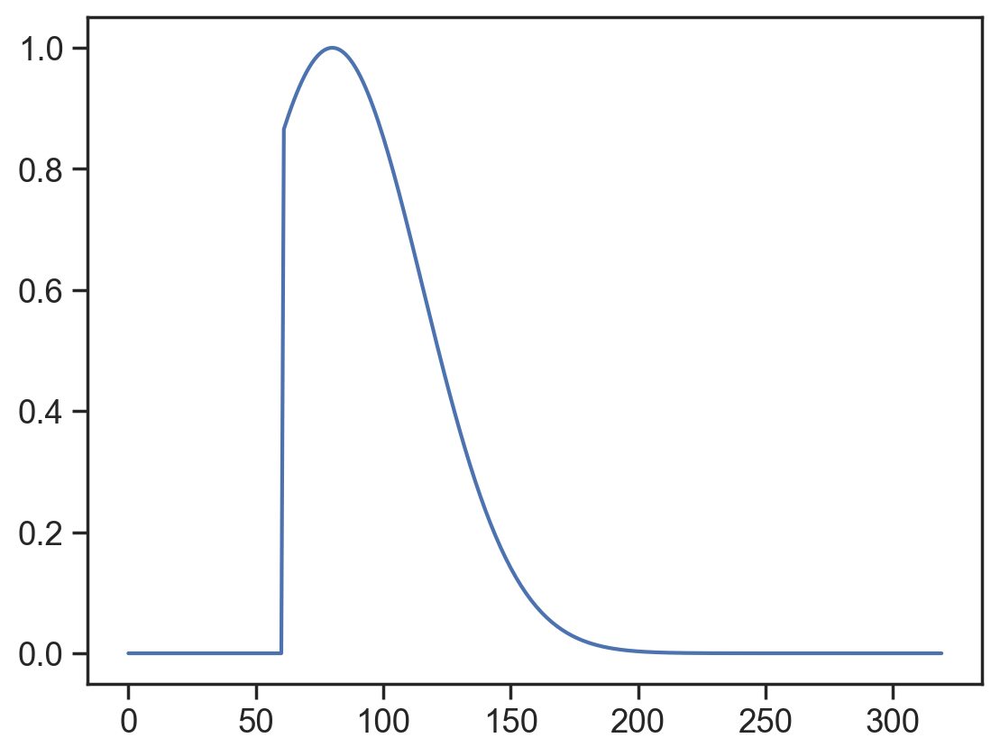

In [8507]:
temp=np.zeros((640,))

lm_pos=120
lookahead=60
shift_factor = 100

for i in range(640):
    if (i > 320+lm_pos-lookahead):
        temp[i] = np.minimum(np.exp(-np.power(0.02*(320+lm_pos-i+lookahead-shift_factor),2)), 1)
        
plt.plot(temp[320:])

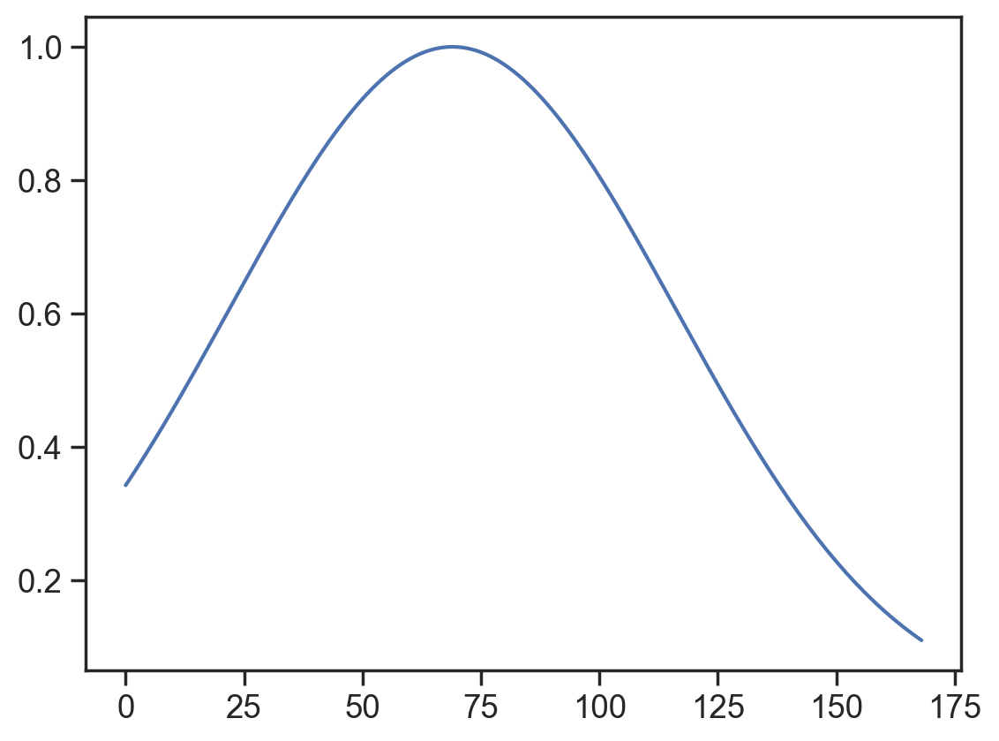

In [8097]:
temp=[]
for i in range(640):
    if (i > 320+150):
        temp.append(np.minimum(np.exp(-np.power(0.015*(320+150-i+70),2)), 1))
temp = np.array(temp, dtype='object')
plt.plot(temp)

    # A_l = l_str * np.exp(-np.power(0.1*(pos_from_l),2))


In [8064]:
A_l.shape

(160, 1)

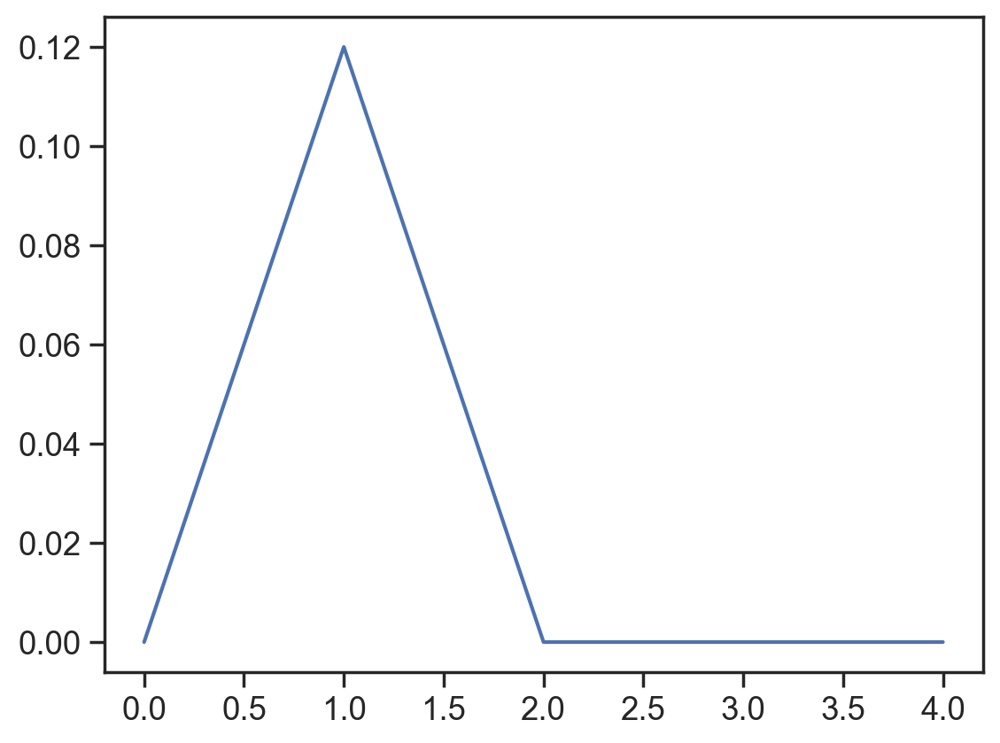

In [8043]:
plt.plot(W_l[-1,0,75:80])
# cell 76 is getting input from landmark

(1.2599756226759933, 0.879219375095568)

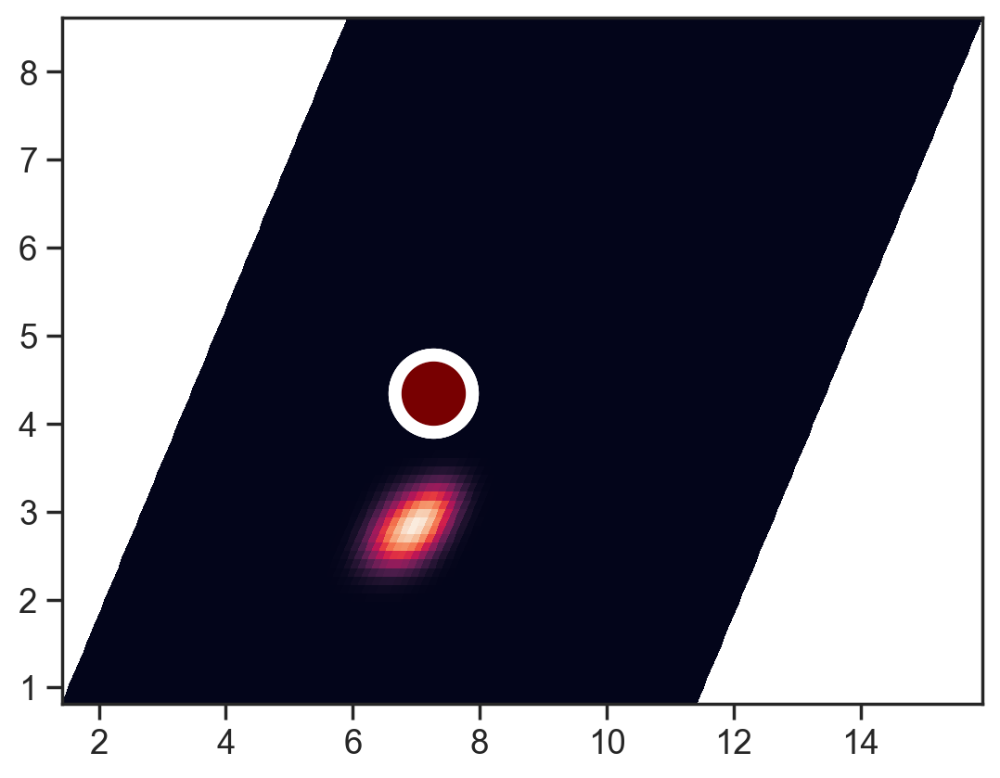

In [8085]:
dpi_val=100
if pil_use:
    mpl.rcParams['figure.dpi'] = dpi_val

plt.pcolormesh(u_copies, v_copies, im_copies, shading='auto')


g_lm = 76
glm1, glm2 = coord_from_phase((4*resx + phases_all[phase1_use][g_lm])/resx+1,(4*resy+phases_all[phase2_use][g_lm])/resy+1) # original
glm1, glm2 # Coordinates for the landmark receiving grid cell

# can color this cell by A_l (when the neuron is active)
# plt.plot(glm1, glm2, 'wo', ms=30, mfc=[0,0,0,0], mew=5, mec='w')
plt.plot(glm1, glm2, 'wo', ms=30, mfc=[0.5,0,0,0.5], mew=5, mec='w')
plt.plot(glm1, glm2, 'wo', ms=30, mfc=[0.5,0,0,0.6], mew=5, mec='w')
plt.plot(glm1, glm2, 'wo', ms=30, mfc=[0.5,0,0,0.7], mew=5, mec='w')


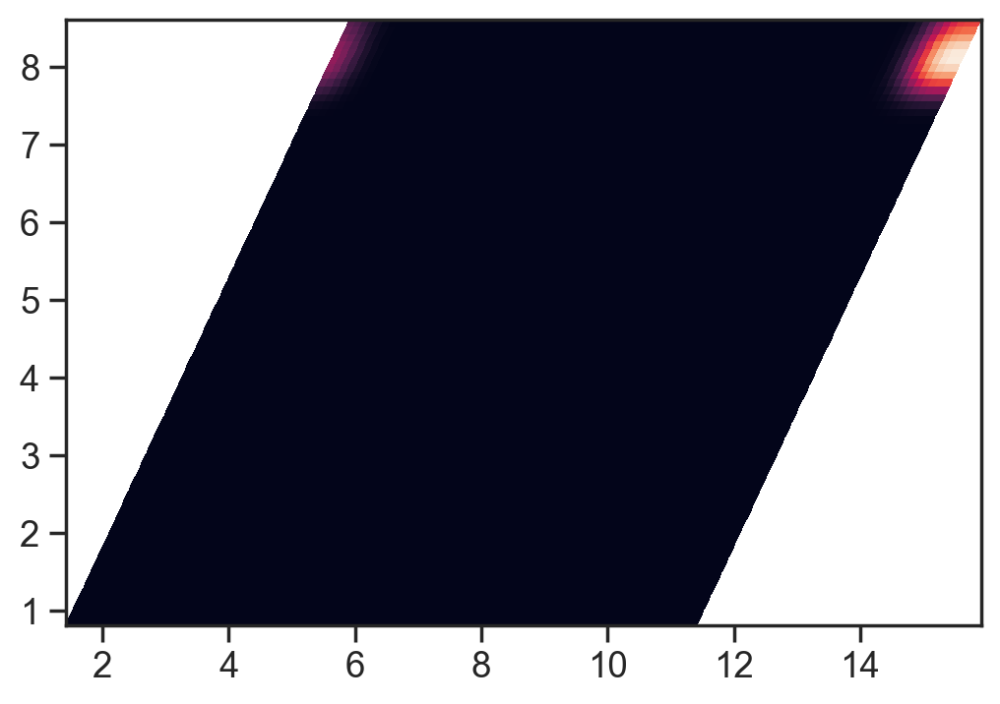

In [6834]:
i=640
start_frame=0
fig,ax=plt.subplots(1,1,figsize=(6,4))

if ((i>0) and (np.mod(i, track_length)==0)):
    trial_counter += 1
    phase1_copy_idx = n_max_copies # reset back to top of sheet
    phase2_copy_idx = n_max_copies # reset back to top of sheet
    aa_counter.append(len(old1))
    
start = i*n_skip+start_frame
dat = maps_linearized[:, start:start+spatial_window]

dat = dat.mean(1)
rm = zscore(dat, axis=0)
# DOUBLE CHECK THIS IS THE CORRECT ORDER OF RESX RESY
# im = rm[gridsort].reshape(resx,resy) # original 
im = rm[gridsort].reshape(resx,resy) # TRYING THIS, BUT MIGHT BE FLIPPED ACTUALLY # resy in dim0, resx in dim1 

im_weak=1*im
im_exp_full=np.tile(im_weak,(3,3))
im_exp_full[resx:2*resx,resy:2*resy]=im
im_exp_full_smooth = gaussian_filter(im_exp_full, (sigma1, sigma2))

range_val = (np.max(im_exp_full_smooth.reshape(-1)) -
        np.min(im_exp_full_smooth.reshape(-1)))
im_exp_full_smooth = np.divide(im_exp_full_smooth
                              - np.min(im_exp_full_smooth.reshape(-1)),
                              range_val)
im=im_exp_full_smooth[resx:2*resx,resy:2*resy]

phase1_copies_added = []
phase2_copies_added = []
if start in discs_smooth[phase1_use]:
    if phase1_copy_idx - 1 < 1:
        phase1_copy_idx = n_max_copies
    else:
        phase1_copy_idx -= 1

if start in discs_smooth[phase2_use]:
    if phase2_copy_idx - 1 < 1:
        phase2_copy_idx = n_max_copies
    else:
        phase2_copy_idx -= 1

im_copies = np.tile(im, (n_max_copies, n_max_copies))

if n_max_copies > 1:
    phase1_val = all_angles_smooth_norm[phase1_use, start] 
    phase2_val = all_angles_smooth_norm[phase2_use, start]
    
    # phase 1 will be associated with resx
    phase1_loc = resx * (phase1_copy_idx-1) + int(np.round(phase1_val*resx))
    phase2_loc = resy * (phase2_copy_idx-1) + int(np.round(phase2_val*resy))

    if phase1_copy_idx == n_max_copies and phase1_val > 0.5:
        phase1_left_thr = int(np.round(phase1_val*resx)) - resx//2
        im_copies[phase1_left_thr:phase1_loc - resx//2, :] = 0
        phase1_right_thr = phase1_loc + resx//2
        im_copies[phase1_right_thr:, :] = 0
    elif phase1_copy_idx == 1 and phase1_val < 0.5:
        phase1_left_thr = phase1_loc + resx//2
        phase1_right_thr = (n_max_copies * resx) - resx // 4
        im_copies[phase1_left_thr:phase1_right_thr, :] = 0
    else:
        phase1_left_thr = phase1_loc - resx//2
        im_copies[0:phase1_left_thr, :] = 0
        phase1_right_thr = phase1_loc + resx//2
        im_copies[phase1_right_thr:, :] = 0

    if phase2_copy_idx == n_max_copies and phase2_val > 0.5:
        phase2_left_thr = int(np.round(phase2_val*resy)) - resy//2
        im_copies[:, phase2_left_thr:phase2_loc - resy//2] = 0
        phase2_right_thr = phase2_loc + resy//2
        im_copies[:, phase2_right_thr:] = 0
    elif phase2_copy_idx == 1 and phase2_val < 0.5:
        phase2_left_thr = phase2_loc + resy//2
        phase2_right_thr = (n_max_copies * resy) - resy // 4
        im_copies[:, phase2_left_thr:phase2_right_thr] = 0
    else:
        phase2_left_thr = phase2_loc - resy//2
        im_copies[:, 0:phase2_left_thr] = 0
        phase2_right_thr = phase2_loc + resy//2
        im_copies[:, phase2_right_thr:] = 0

    im_copies = gaussian_filter(im_copies, (sigma1, sigma2))

x_copies, y_copies = np.mgrid[:n_max_copies*resx,:n_max_copies*resy]/resy
u_copies, v_copies = coord_from_phase(x_copies+1,y_copies+1)
plt.pcolormesh(u_copies, v_copies, im_copies, shading='auto')


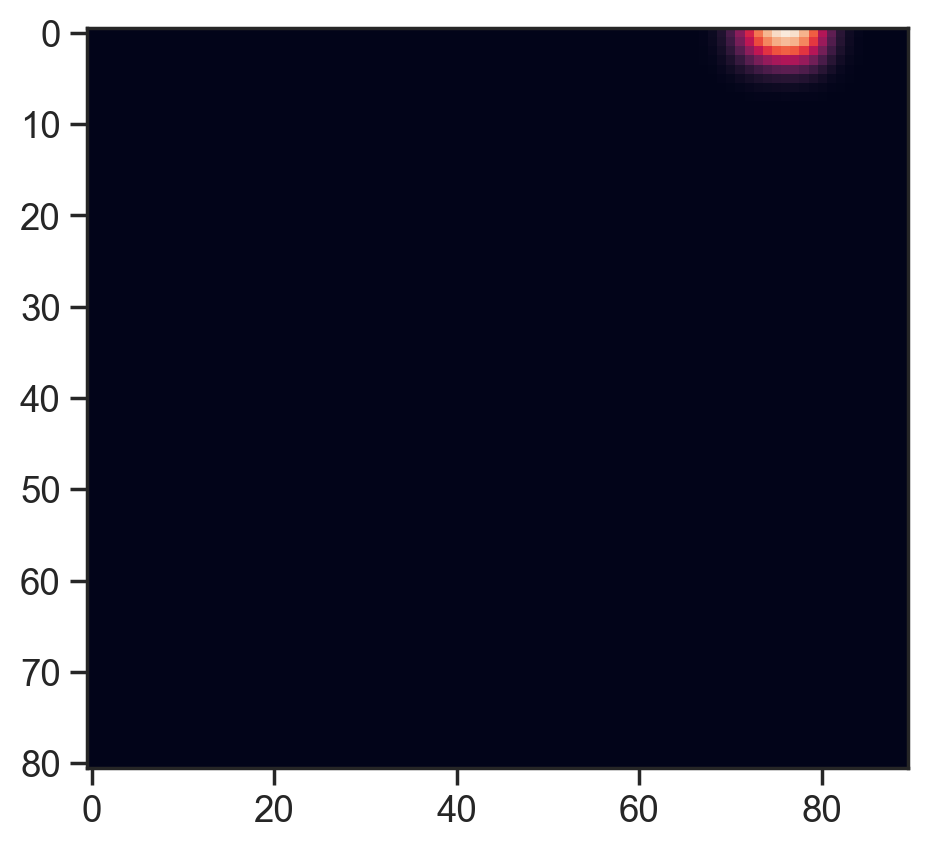

In [6829]:
plt.imshow(im_copies)

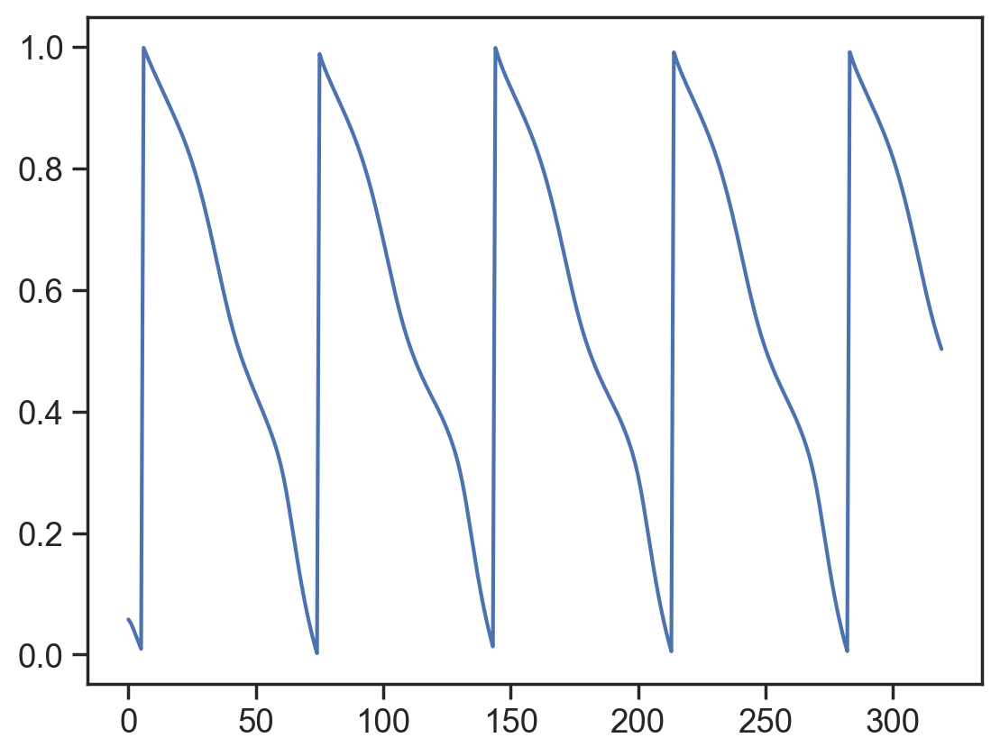

In [6813]:
plt.plot(all_angles_smooth_norm[phase1_use,:320])

In [6799]:
aa_counter

[0, 16, 32, 48]

In [6701]:
# pickle the variables here
pil_use = True
save_fig = True

sigma_smooth = 10
maps_linearized = gaussian_filter1d(g_fr[:resx*resy,:].reshape(resx*resy, -1), sigma_smooth)
spatial_window = 2

n_skip = 1
sigma1 = 2
sigma2 = 2

start_trial = 0
end_trial = n_trials

n_windows=621

dpi_val=25
base_save_dir = 'D:/Code/bump_video/sim/'
n_max_copies = 5
old1=[]
old2=[]
distance_counter = 0

try:
    plt.close('all')
    if save_fig:
        matplotlib.use('agg')
    else:
        %matplotlib inline
        
    save_dir = base_save_dir + f'{n_max_copies}'
    
    if os.path.isdir(save_dir):
        abc=1
    else:
        os.mkdir(save_dir)
    
    pid = 0
    phase1_copy_idx = n_max_copies
    phase2_copy_idx = n_max_copies
    
    for i in np.arange(n_windows):
        fig,ax=plt.subplots(1,1,figsize=(6,4))
        
        start = i*n_skip+start_frame
        dat = maps_linearized[:, start:start+spatial_window]
        
        dat = dat.mean(1)
        rm = zscore(dat, axis=0)
        # DOUBLE CHECK THIS IS THE CORRECT ORDER OF RESX RESY
        # im = rm[gridsort].reshape(resx,resy) # original 
        im = rm[gridsort].reshape(resy,resx) # TRYING THIS, BUT MIGHT BE FLIPPED ACTUALLY
        
        im_weak=1*im
        im_exp_full=np.tile(im_weak,(3,3))
        im_exp_full[resy:2*resy,resx:2*resx]=im
        im_exp_full_smooth = gaussian_filter(im_exp_full, (sigma1, sigma2))

        range_val = (np.max(im_exp_full_smooth.reshape(-1)) -
                np.min(im_exp_full_smooth.reshape(-1)))
    
        im_exp_full_smooth = np.divide(im_exp_full_smooth
                                      - np.min(im_exp_full_smooth.reshape(-1)),
                                      range_val)
    
        im=im_exp_full_smooth[resy:2*resy,resx:2*resx]
    
        phase1_copies_added = []
        phase2_copies_added = []
        if start in discs_smooth[phase1_use]:
          if phase1_copy_idx - 1 < 1:
            phase1_copy_idx = n_max_copies
          else:
            phase1_copy_idx -= 1
    
        if start in discs_smooth[phase2_use]:
          if phase2_copy_idx - 1 < 1:
            phase2_copy_idx = n_max_copies
          else:
            phase2_copy_idx -= 1
    
        im_copies = np.tile(im, (n_max_copies, n_max_copies))
    
        if n_max_copies > 1:
            phase1_val = all_angles_smooth_norm[phase1_use, start] 
            phase2_val = all_angles_smooth_norm[phase2_use, start]
            
            # phase 1 will be associated with resx
            phase1_loc = resx * (phase1_copy_idx-1) + int(np.round(phase1_val*resx))
            phase2_loc = resy * (phase2_copy_idx-1) + int(np.round(phase2_val*resy))
    
            if phase1_copy_idx == n_max_copies and phase1_val > 0.5:
                phase1_left_thr = int(np.round(phase1_val*resx)) - resx//2
                im_copies[phase1_left_thr:phase1_loc - resx//2, :] = 0
                phase1_right_thr = phase1_loc + resx//2
                im_copies[phase1_right_thr:, :] = 0
            elif phase1_copy_idx == 1 and phase1_val < 0.5:
                phase1_left_thr = phase1_loc + resx//2
                phase1_right_thr = (n_max_copies * resx) - resx // 4
                im_copies[phase1_left_thr:phase1_right_thr, :] = 0
            else:
                phase1_left_thr = phase1_loc - resx//2
                im_copies[0:phase1_left_thr, :] = 0
                phase1_right_thr = phase1_loc + resx//2
                im_copies[phase1_right_thr:, :] = 0
        
            if phase2_copy_idx == n_max_copies and phase2_val > 0.5:
                phase2_left_thr = int(np.round(phase2_val*resy)) - resy//2
                im_copies[:, phase2_left_thr:phase2_loc - resy//2] = 0
                phase2_right_thr = phase2_loc + resy//2
                im_copies[:, phase2_right_thr:] = 0
            elif phase2_copy_idx == 1 and phase2_val < 0.5:
                phase2_left_thr = phase2_loc + resy//2
                phase2_right_thr = (n_max_copies * resy) - resy // 4
                im_copies[:, phase2_left_thr:phase2_right_thr] = 0
            else:
                phase2_left_thr = phase2_loc - resy//2
                im_copies[:, 0:phase2_left_thr] = 0
                phase2_right_thr = phase2_loc + resy//2
                im_copies[:, phase2_right_thr:] = 0

            im_copies = gaussian_filter(im_copies, (sigma1, sigma2))
    
        x_copies, y_copies = np.mgrid[:n_max_copies*resy,:n_max_copies*resx]/resy
        u_copies, v_copies = coord_from_phase(x_copies+1,y_copies+1)
    
        plt.pcolormesh(u_copies, v_copies, im_copies, shading='auto')
    
        if n_max_copies >= 5:
            if ((np.mod(start,320)==0) and (i>0)): # 320 is two trials worth
                distance_counter+=1
                old1_temp, old2_temp = coord_from_phase((phase1_loc)/resx+1,(phase2_loc)/resy+1) # original
                # old1_temp, old2_temp = coord_from_phase((phase2_loc)/resy+1,(phase1_loc)/resx+1)

                old1.append(old1_temp)
                old2.append(old2_temp)
    
        if len(old1)>0: # add code to plot the star later
            aa=np.array(old1)
            bb=np.array(old2)
            plt.plot(aa,bb,'w*', ms=10)
        
        plt.axis('off')
        ax.spines[['left','top','right','bottom']].set_visible(False)
        plt.xticks([])
        plt.yticks([])
        plt.title(f'{start}')

        if save_fig:
            if pil_use:
                img = fig2img(fig)
                img.save(os.path.join(save_dir,f'{pid:04d}.png'), quality=dpi_val)
                plt.close(fig)
            else:
                plt.savefig(os.path.join(save_dir,f'{pid:04d}.jpg'), dpi=dpi_val)
                # fig.savefig(os.path.join(save_dir,f'{pid:03d}.png'), dpi=dpi_val)
                plt.close(fig)
            
        pid += 1
        if np.mod(i, 100)==0:
            print(f'{i}')

except KeyboardInterrupt:
    print("\nProgram terminated by user.")
    plt.close('all')
    %matplotlib inline         
finally:
    print("\nProgram finished.")
    plt.close('all')
    %matplotlib inline       


0
100
200
300

Program finished.


# OLD

In [4114]:
# WILL JUST START WITH 3 COPIES OF THE SHEET
# pickle the variables here
pil_use = True
save_fig = False

# maps_linearized = maps[grid_cell_idxs[:resx*resy]].reshape(resx*resy, -1)
maps_linearized = g_fr[:resx*resy,:].reshape(resx*resy, -1)

spatial_window = 2
# n_windows = 470 # no boundary issue
# n_windows = 1 
# start_frame=1585 #1202 start of landmarks for AQ1, 1656 start of demo
# start_frame=900 #1200 is landmarks on (N2 track10)

n_skip = 1
sigma1 = 2
sigma2 = 1.5

start_trial = 0
end_trial = n_trials
start_frame=start_trial*L
end_frame=end_trial*L

# n_windows = end_frame-start_frame
n_windows=3200

# n_windows=(20*160)//n_skip

n_rows = int(np.ceil(np.sqrt(n_windows)))

formatter = plt.FuncFormatter(lambda x, pos: f'{x:03.0f}')
yformatter = plt.FuncFormatter(lambda x, pos: f'{x:04.0f}')
yformatter2 = plt.FuncFormatter(lambda x, pos: f'{x:2.0f}')

dpi_val=100
base_save_dir = 'D:/Code/bump_video/sim/'
copy_vals = np.array([1, 3, 4])
old1=[]
old2=[]
distance_counter = 0

try:
    plt.close('all')
    matplotlib.use('agg')
    for max_i in np.arange(2,copy_vals.shape[0]):
      n_max_copies = copy_vals[max_i]
      save_dir = base_save_dir + f'{n_max_copies}'
    
      if os.path.isdir(save_dir):
        abc=1
      else:
        os.mkdir(save_dir)
    
      pid = 0
      phase1_copy_idx = n_max_copies
      phase2_copy_idx = n_max_copies
    
      for i in np.arange(n_windows):
        fig,ax=plt.subplots(1,1,figsize=(12,8))
    
        start = i*n_skip+start_frame
        dat = maps_linearized[:, start:start+spatial_window]
    
        dat = dat.mean(1)
        rm = zscore(dat, axis=0)
        im = rm[gridsort].reshape(resx,resy)
    
        im_weak=1*im
        im_exp_full=np.tile(im_weak,(3,3))
        im_exp_full[resx:2*resx,resx:2*resx]=im
        im_exp_full_smooth = gaussian_filter(im_exp_full, (sigma1, sigma2))
    
        range_val = (np.max(im_exp_full_smooth.reshape(-1)) -
                np.min(im_exp_full_smooth.reshape(-1)))
    
        im_exp_full_smooth = np.divide(im_exp_full_smooth
                                      - np.min(im_exp_full_smooth.reshape(-1)),
                                      range_val)
    
        im=im_exp_full_smooth[resx:2*resx,resx:2*resx]
    
        phase1_copies_added = []
        phase2_copies_added = []
        if start in discs_smooth[phase1_use]:
          if phase1_copy_idx - 1 < 1:
            phase1_copy_idx = n_max_copies
          else:
            phase1_copy_idx -= 1
    
        if start in discs_smooth[phase2_use]:
          if phase2_copy_idx - 1 < 1:
            phase2_copy_idx = n_max_copies
          else:
            phase2_copy_idx -= 1
    
        im_copies = np.tile(im, (n_max_copies, n_max_copies))
    
        if n_max_copies > 1:
          phase1_val = all_angles_smooth_norm[phase1_use, start]
          phase2_val = all_angles_smooth_norm[phase2_use, start]
    
          phase1_loc = resx * (phase1_copy_idx-1) + int(np.round(phase1_val*resx))
          phase2_loc = resx * (phase2_copy_idx-1) + int(np.round(phase2_val*resx))
    
          if phase1_copy_idx == n_max_copies and phase1_val > 0.5:
            phase1_left_thr = int(np.round(phase1_val*resx)) - resx//2
            im_copies[phase1_left_thr:phase1_loc - resx//2, :] = 0
    
            phase1_right_thr = phase1_loc + resx//2
            im_copies[phase1_right_thr:, :] = 0
          elif phase1_copy_idx == 1 and phase1_val < 0.5:
            phase1_left_thr = phase1_loc + resx//2
            phase1_right_thr = (n_max_copies * resx) - resx // 4
            im_copies[phase1_left_thr:phase1_right_thr, :] = 0
          else:
            phase1_left_thr = phase1_loc - resx//2
            im_copies[0:phase1_left_thr, :] = 0
    
            phase1_right_thr = phase1_loc + resx//2
            im_copies[phase1_right_thr:, :] = 0
    
          if phase2_copy_idx == n_max_copies and phase2_val > 0.5:
            phase2_left_thr = int(np.round(phase2_val*resx)) - resx//2
            im_copies[:, phase2_left_thr:phase2_loc - resx//2] = 0
    
            phase2_right_thr = phase2_loc + resx//2
            im_copies[:, phase2_right_thr:] = 0
          elif phase2_copy_idx == 1 and phase2_val < 0.5:
            phase2_left_thr = phase2_loc + resx//2
            phase2_right_thr = (n_max_copies * resx) - resx // 4
            im_copies[:, phase2_left_thr:phase2_right_thr] = 0
          else:
            phase2_left_thr = phase2_loc - resx//2
            im_copies[:, 0:phase2_left_thr] = 0
    
            phase2_right_thr = phase2_loc + resx//2
            im_copies[:, phase2_right_thr:] = 0
    
          im_copies = gaussian_filter(im_copies, (sigma1, sigma2))
    
        x_copies, y_copies = np.mgrid[:n_max_copies*resx,:n_max_copies*resy]/resy
        u_copies, v_copies = coord_from_phase(x_copies+1,y_copies+1)
    
        plt.pcolormesh(u_copies, v_copies, im_copies, shading='auto')
    
        if n_max_copies >= 5:
            if ((np.mod(start,320)==0) and (i>0)): # 320 is two trials worth
                distance_counter+=1
                old1_temp, old2_temp = coord_from_phase((phase1_loc)/resx+1,(phase2_loc)/resx+1)
                old1.append(old1_temp)
                old2.append(old2_temp)
    
        if len(old1)>0: # add code to plot the star later
            aa=np.array(old1)
            bb=np.array(old2)
            plt.plot(aa,bb,'w*', ms=10)
        
        plt.axis('off')
        ax.spines[['left','top','right','bottom']].set_visible(False)
        plt.xticks([])
        plt.yticks([])
        plt.title(f'{start}')

        if pil_use:
            img = fig2img(fig)
            img.save(os.path.join(save_dir,f'{pid:04d}.png'), quality=dpi_val)
            plt.close()
        else:
            plt.savefig(os.path.join(save_dir,f'{pid:04d}.jpg'), dpi=dpi_val)
            # fig.savefig(os.path.join(save_dir,f'{pid:03d}.png'), dpi=dpi_val)
            plt.close()
          
        # if n_windows > 1:
        #   plt.savefig(os.path.join(save_dir,f'{pid:04d}.jpg'), dpi=dpi_val)
        #   # fig.savefig(os.path.join(save_dir,f'{pid:03d}.png'), dpi=dpi_val)
        #   plt.close()
        pid += 1
        if np.mod(i, 100)==0:
          print(f'{i}')

except KeyboardInterrupt:
    print("\nProgram terminated by user.")
    plt.close('all')
    %matplotlib inline         
finally:
    print("\nProgram finished.")
    plt.close('all')
    %matplotlib inline       



Program finished.


ValueError: could not broadcast input array from shape (10,9) into shape (10,10)

## TEST DIFFERENT IMAGE SAVING SPEEDS

In [756]:
# WILL JUST START WITH 3 COPIES OF THE SHEET
# pickle the variables here
pil_use = True

# if pil_use:
#     plt.close('all')
#     %matplotlib inline   
# else:
#     plt.close('all')
#     matplotlib.use('agg')


use_profiler = False
if use_profiler:
    with Profile() as profile:
        # maps_linearized = maps[grid_cell_idxs[:resx*resy]].reshape(resx*resy, -1)
        maps_linearized = g_fr[:resx*resy,:].reshape(resx*resy, -1)
        
        spatial_window = 2
        # n_windows = 470 # no boundary issue
        # n_windows = 1 
        # start_frame=1585 #1202 start of landmarks for AQ1, 1656 start of demo
        # start_frame=900 #1200 is landmarks on (N2 track10)
        
        n_skip = 1
        sigma1 = 2
        sigma2 = 1.5
        
        start_trial = 0
        end_trial = n_trials
        start_frame=start_trial*L
        end_frame=end_trial*L
        
        # n_windows = end_frame-start_frame
        n_windows=100
        
        # n_windows=(20*160)//n_skip
        
        n_rows = int(np.ceil(np.sqrt(n_windows)))
        
        formatter = plt.FuncFormatter(lambda x, pos: f'{x:03.0f}')
        yformatter = plt.FuncFormatter(lambda x, pos: f'{x:04.0f}')
        yformatter2 = plt.FuncFormatter(lambda x, pos: f'{x:2.0f}')
        
        dpi_val=100
        base_save_dir = 'D:/Code/bump_video/sim/'
        copy_vals = np.array([1, 3, 15])
        old1=[]
        old2=[]
        distance_counter = 0
        
        try:
            plt.close('all')
            matplotlib.use('agg')
            for max_i in np.arange(2,copy_vals.shape[0]):
              n_max_copies = copy_vals[max_i]
              save_dir = base_save_dir + f'{n_max_copies}'
            
              if os.path.isdir(save_dir):
                abc=1
              else:
                os.mkdir(save_dir)
            
              pid = 0
              phase1_copy_idx = n_max_copies
              phase2_copy_idx = n_max_copies
            
            
              for i in np.arange(n_windows):
                fig,ax=plt.subplots(1,1,figsize=(12,8))
            
                start = i*n_skip+start_frame
                dat = maps_linearized[:, start:start+spatial_window]
            
                dat = dat.mean(1)
                rm = zscore(dat, axis=0)
                im = rm[gridsort].reshape(resx,resy)
            
                im_weak=1*im
                im_exp_full=np.tile(im_weak,(3,3))
                im_exp_full[resx:2*resx,resx:2*resx]=im
                im_exp_full_smooth = gaussian_filter(im_exp_full, (sigma1, sigma2))
            
                range_val = (np.max(im_exp_full_smooth.reshape(-1)) -
                        np.min(im_exp_full_smooth.reshape(-1)))
            
                im_exp_full_smooth = np.divide(im_exp_full_smooth
                                              - np.min(im_exp_full_smooth.reshape(-1)),
                                              range_val)
            
                im=im_exp_full_smooth[resx:2*resx,resx:2*resx]
            
                phase1_copies_added = []
                phase2_copies_added = []
                if start in discs_smooth[phase1_use]:
                  if phase1_copy_idx - 1 < 1:
                    phase1_copy_idx = n_max_copies
                  else:
                    phase1_copy_idx -= 1
            
                if start in discs_smooth[phase2_use]:
                  if phase2_copy_idx - 1 < 1:
                    phase2_copy_idx = n_max_copies
                  else:
                    phase2_copy_idx -= 1
            
                im_copies = np.tile(im, (n_max_copies, n_max_copies))
            
                if n_max_copies > 1:
                  phase1_val = all_angles_smooth_norm[phase1_use, start]
                  phase2_val = all_angles_smooth_norm[phase2_use, start]
            
                  phase1_loc = resx * (phase1_copy_idx-1) + int(np.round(phase1_val*resx))
                  phase2_loc = resx * (phase2_copy_idx-1) + int(np.round(phase2_val*resx))
            
                  if phase1_copy_idx == n_max_copies and phase1_val > 0.5:
                    phase1_left_thr = int(np.round(phase1_val*resx)) - resx//2
                    im_copies[phase1_left_thr:phase1_loc - resx//2, :] = 0
            
                    phase1_right_thr = phase1_loc + resx//2
                    im_copies[phase1_right_thr:, :] = 0
                  elif phase1_copy_idx == 1 and phase1_val < 0.5:
                    phase1_left_thr = phase1_loc + resx//2
                    phase1_right_thr = (n_max_copies * resx) - resx // 4
                    im_copies[phase1_left_thr:phase1_right_thr, :] = 0
                  else:
                    phase1_left_thr = phase1_loc - resx//2
                    im_copies[0:phase1_left_thr, :] = 0
            
                    phase1_right_thr = phase1_loc + resx//2
                    im_copies[phase1_right_thr:, :] = 0
            
                  if phase2_copy_idx == n_max_copies and phase2_val > 0.5:
                    phase2_left_thr = int(np.round(phase2_val*resx)) - resx//2
                    im_copies[:, phase2_left_thr:phase2_loc - resx//2] = 0
            
                    phase2_right_thr = phase2_loc + resx//2
                    im_copies[:, phase2_right_thr:] = 0
                  elif phase2_copy_idx == 1 and phase2_val < 0.5:
                    phase2_left_thr = phase2_loc + resx//2
                    phase2_right_thr = (n_max_copies * resx) - resx // 4
                    im_copies[:, phase2_left_thr:phase2_right_thr] = 0
                  else:
                    phase2_left_thr = phase2_loc - resx//2
                    im_copies[:, 0:phase2_left_thr] = 0
            
                    phase2_right_thr = phase2_loc + resx//2
                    im_copies[:, phase2_right_thr:] = 0
            
                  im_copies = gaussian_filter(im_copies, (sigma1, sigma2))
            
                x_copies, y_copies = np.mgrid[:n_max_copies*resx,:n_max_copies*resy]/resy
                u_copies, v_copies = coord_from_phase(x_copies+1,y_copies+1)
            
                plt.pcolormesh(u_copies, v_copies, im_copies, shading='auto')
            
                if n_max_copies >= 5:
                    if ((np.mod(start,160)==0) and (i>0)): # 320 is two trials worth
                        distance_counter+=1
                        old1_temp, old2_temp = coord_from_phase((phase1_loc)/resx+1,(phase2_loc)/resx+1)
                        old1.append(old1_temp)
                        old2.append(old2_temp)
            
                if len(old1)>0: # add code to plot the star later
                    aa=np.array(old1)
                    bb=np.array(old2)
                    plt.plot(aa,bb,'w*', ms=10)
                
                  
                plt.axis('off')
                ax.spines[['left','top','right','bottom']].set_visible(False)
                plt.xticks([])
                plt.yticks([])
            
                plt.title(f'{start}')

                if pil_use:
                    img = fig2img(fig)
                    img.save(os.path.join(save_dir,f'{pid:04d}.png'), quality=dpi_val)
                    plt.close()
                else:
                    plt.savefig(os.path.join(save_dir,f'{pid:04d}.jpg'), dpi=dpi_val)
                    # fig.savefig(os.path.join(save_dir,f'{pid:03d}.png'), dpi=dpi_val)
                    plt.close()
                  
                # if n_windows > 1:
                #   plt.savefig(os.path.join(save_dir,f'{pid:04d}.jpg'), dpi=dpi_val)
                #   # fig.savefig(os.path.join(save_dir,f'{pid:03d}.png'), dpi=dpi_val)
                #   plt.close()
                pid += 1
                if np.mod(i, 100)==0:
                  print(f'{i}')
        
        except KeyboardInterrupt:
            print("\nProgram terminated by user.")
            plt.close('all')
            %matplotlib inline         
        finally:
            print("\nProgram finished.")
            plt.close('all')
            %matplotlib inline       
        (Stats(profile)
         .strip_dirs()
         .sort_stats(SortKey.CUMULATIVE)
         .print_stats(20) # print top 20 functions
        )


# MY MODEL

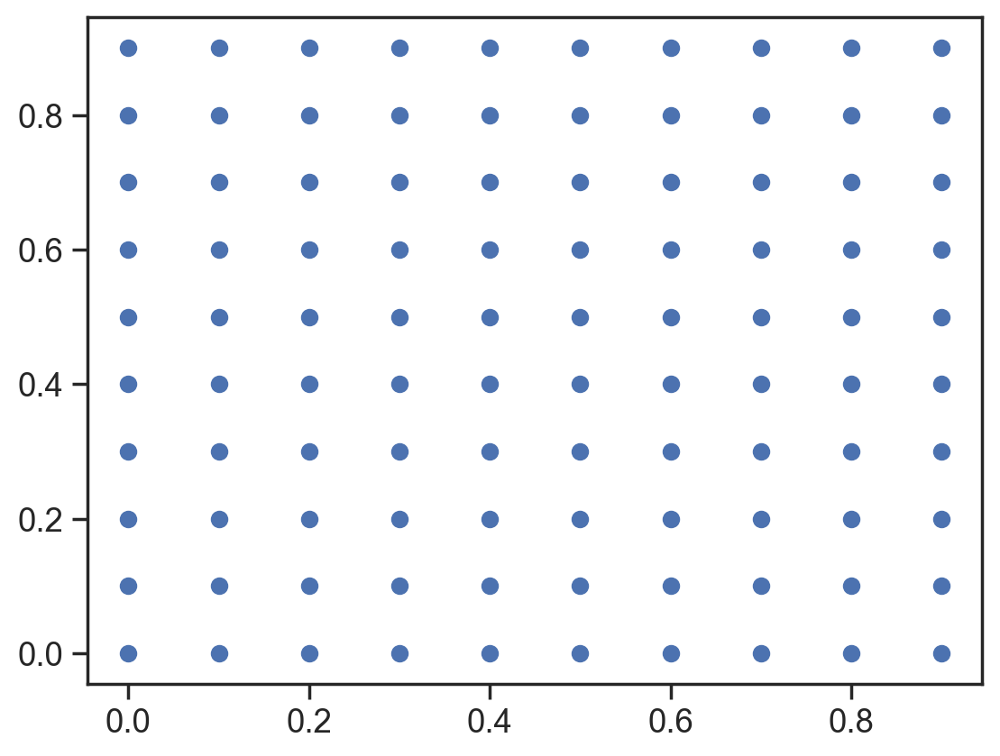

In [27]:
x,y = np.mgrid[:10, :10]/10
plt.scatter(x,y)

In [3]:
def get_2d_sort(x1,x2,resx,resy):
    """
    Reshapes x1 and x2 into square arrays, and then sorts
    them such that x1 increases downward and x2 increases
    rightward. Returns the order.
    """
    n = np.minimum(resx,resy)
    total_order = x1.argsort()
    total_order = total_order.reshape(resx,resy)
    for i in np.arange(n):
        row_order = x2[total_order.ravel()].reshape(resx,resy)[i].argsort()
        total_order[i] = total_order[i,row_order]
    total_order = total_order.ravel()
    return total_order

In [4]:
def mexican_hat(t, sigma):
    return (2 / (np.sqrt(3 * sigma) * np.pi ** 0.25)) * (1 - (t ** 2) / sigma ** 2) * np.exp(-(t ** 2) / (2 * sigma ** 2))

# SIMULATE DATA

In [11]:
def initialize_attractor(n_g, ring_noise, speed_noise, speed_bias):

    speed_strength=1/50
    speed_val = speed_strength * n_g
    # INITIALIZE ATTRACTOR
    
    ub = n_g//50
    lb = -1*ub
    psi = mexican_hat(np.linspace(lb,ub,n_g), 2)
    mod_psi = psi-0.2
    w_all = np.roll(mod_psi, n_g//2)
    W = np.zeros((np.shape(w_all)[0],np.shape(w_all)[0]))
    for i in np.arange(np.shape(w_all)[0]):
        w_circ = np.roll(w_all, i)
        W[i, :] = w_circ
        
    # add noise
    W = W + ring_noise * np.random.randn(W.shape[0], W.shape[1])# attractor weights
    
    W_s = np.zeros((w_all.shape[0],w_all.shape[0])) # speed cell weights
    # if np.abs(speed_bias) > 0:
    #     W_s = np.zeros((int(np.round(w_all.shape[0]*1.2)), int(np.round(w_all.shape[0]*1.2))))
   
    one_hot = np.roll(mexican_hat(np.linspace(-int(n_g//10), int(n_g//10), W_s.shape[0]), 1) * speed_val, W_s.shape[0]//2+int(n_g//40))
    
    for i in np.arange(W_s.shape[0]):
        W_s[i, :] = np.roll(one_hot, i+1)

    W_s = W_s + speed_noise * speed_val * np.random.randn(W_s.shape[0], W_s.shape[1])
    
    if np.abs(speed_bias) > 0:
        val = int(np.round(speed_bias*n_g))
        for i in range(W_s.shape[0]):
            W_s[i, :] = np.roll(W_s[i, :], val)
            
    # W_s = rotate(W_s, speed_bias, mode='nearest')
    # W_s = W_s[W_s.shape[0]//2 - n_g//2:W_s.shape[0]//2+n_g//2, W_s.shape[0]//2 - n_g//2:W_s.shape[0]//2+n_g//2]

    # if np.abs(speed_bias) > 0:
    #     W_s = rotate(W_s, speed_bias, mode='nearest')
    #     W_s = W_s[W_s.shape[0]//2 - n_g//2:W_s.shape[0]//2+n_g//2, W_s.shape[0]//2 - n_g//2:W_s.shape[0]//2+n_g//2]
    

    return W, W_s

In [68]:
# a = rotate(W, 60, mode='nearest')[25:75, 25:75]
# b = rotate(W, -60, mode='nearest')[25:75, 25:75]
# c = W[25:75, 25:75]

# x, y = np.mgrid[:50,:50]/50
# u, v = coord_from_phase(x+1,y+1)

# plt.pcolormesh(u,v,a+b+c)

In [69]:
def simulate_attractor(W, W_s, init_state, T, 
                       l_x, W_l_init, max_W_l, min_W_l, 
                       hebb_strength, posx):
    drift_val = 0
    decay_strength = 0.1
    inc = True
    # Simulation
    n_g = W_l_init.shape[0]
    n_l = W_l_init.shape[1]
    
    states = np.zeros((n_g, T+1)) # will store the initial state 
    W_l_all = np.zeros((n_g, n_l, T+1))
    
    states[:, 0] = init_state
    W_l_all[:, :, 0] = W_l_init
    
    for t in np.arange(1, T):
        this_pos = posx[t]
    
        if np.any(np.any(this_pos == l_x)):
            this_l = np.where(this_pos == l_x)[0][0]
            l_weights = W_l_all[:, this_l, t-1]
    
            states[:, t] = (np.divide(np.ones((n_g,)), (1+np.exp(-W @ states[:, t-1] - W_s @ states[:, t-1] - l_weights)))
                                      + decay_strength * states[:, t-1] + 0.2*np.random.randn(n_g))
            neg_idxs = states[:, t] < 0
            states[neg_idxs, t] = 0;
            
            # get cells that were active during this time step, when the landmark contributed
            active_g = states[:, t] > 0.75; 
            
            if t > 6:
                # get cells that were active before this time step
                a = states[:, t-6] > 0.75
                b = states[:, t-5] > 0.75
                active_g_prev = a+b
            else:
                active_g_prev = np.zeros((n_g, ))
    
            # copy over weights 
            W_l_all[:, :, t] = W_l_all[:, :, t-1]
            
            # changes weights for this landmark
            new_weights = l_weights + hebb_strength * active_g - hebb_strength * active_g_prev
            new_weights[new_weights >= max_W_l] = max_W_l;
            new_weights[new_weights <= min_W_l] = min_W_l;
            W_l_all[:, this_l, t] = new_weights  
        else:
            # if ((drift_val < 5) and (inc)):
            #     drift_val += 0.2 * np.ndarray.item(np.random.randn(1)) + 0.2
            # else:
            #     drift_val += 0.2 * np.ndarray.item(np.random.randn(1)) - 0.2
            #     inc=False
                
            #     if drift_val < 1:
            #         inc=True
            drift_val=0
                    
            W_s_use = np.roll(W_s, int(np.round(drift_val)), axis=1) 

            states[:, t] = (np.divide(np.ones((n_g,)), (1+np.exp(-W @ states[:, t-1] - W_s @ states[:, t-1])))
                                      + decay_strength * states[:, t-1] + 0.2*np.random.randn(n_g)) # don't add landmark input
            neg_idxs = states[:, t] < 0
            states[neg_idxs, t] = 0
    
            # keep weights the same
            W_l_all[:, :, t] = W_l_all[:, :, t-1];

    return states, W_l_all

In [93]:
n_g=100
ring_noise=0.01
speed_noise=0.01
speed_bias=0 # should be between -1 and 0
W, W_s = initialize_attractor(n_g, ring_noise, speed_noise, speed_bias)

# for i in range(n_g):
#     for j in range(n_g):
#         if W[i,j] < 0:
#             W[i,j] = -1

In [223]:
n_vals=100
x_vals = np.linspace(-np.pi, np.pi, n_vals)
base = 0.5*np.tile(np.cos(x_vals), (n_vals, 1))

ext_copies = 3
x_vals_ext = np.linspace(-ext_copies*np.pi, ext_copies*np.pi, ext_copies*n_vals)
base_ext = 0.5*np.tile(np.cos(x_vals_ext), (ext_copies*n_vals, 1))
midpt = (ext_copies * n_vals) // 2
n_points = n_vals // 2
idxs = np.arange(midpt-n_points, midpt+n_points)

rot1_base_ext = rotate(base_ext, 60)[idxs, :]
rot1_base = rot1_base_ext[:, idxs]
rot2_base_ext = rotate(base_ext, -60)[idxs, :]
rot2_base = rot2_base_ext[:, idxs]

# plt.imshow(base+rot1_base+rot2_base)
W = np.copy(base+rot1_base+rot2_base)



# need to do the phase shift within x_vals, not after 
phase_shift = 0.25
x_vals_ext = np.linspace(-ext_copies*np.pi-np.pi*phase_shift, ext_copies*np.pi-np.pi*phase_shift, ext_copies*n_vals)
base_ext = 0.5*np.tile(np.cos(x_vals_ext), (ext_copies*n_vals, 1))
midpt = (ext_copies * n_vals) // 2
n_points = n_vals // 2
idxs = np.arange(midpt-n_points, midpt+n_points)

rot_base_ext = rotate(base_ext, 0)[idxs,:]
rot_base_phase_shifted = rot_base_ext[:, idxs]
rot1_base_ext = rotate(base_ext, 60)[idxs, :]
rot1_base_phase_shifted = rot1_base_ext[:, idxs]
rot2_base_ext = rotate(base_ext, -60)[idxs, :]
rot2_base_phase_shifted = rot2_base_ext[:, idxs]


# # not like this 
# phase_shift = 0.1 # phase shift value between 0 to 1
# phase_shift_rad = int(np.round(phase_shift * n_vals))
# phase_shifted = rotate(base_ext, -60)[idxs + phase_shift_rad, :]
# phase_shifted = phase_shifted[:, idxs+phase_shift_rad]


# W_s = base+rot1_base_phase_shifted+rot2_base_phase_shifted
W_s = rot_base_phase_shifted +rot1_base+rot2_base


# W_s = np.copy(W)
# for i in range(n_vals):
#     W_s[i, :] = np.roll(W_s[i, :], i)
# plt.imshow(W_s)

In [ ]:
phase_shift_base = W_s[:, 0]
W_s = 

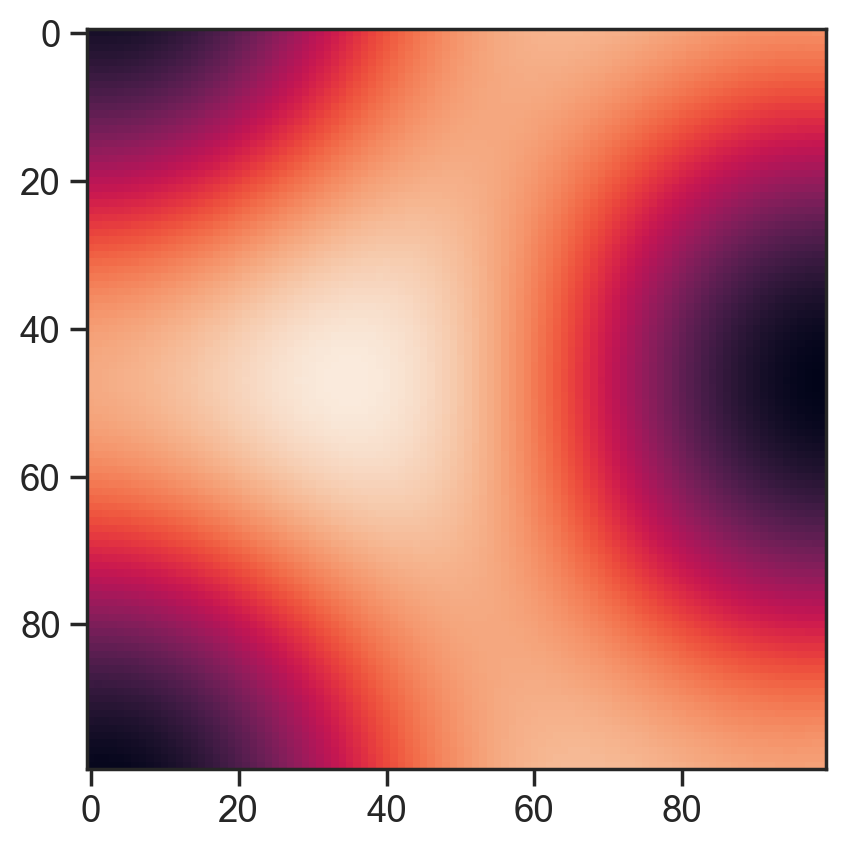

In [234]:
plt.imshow(W+W_s)

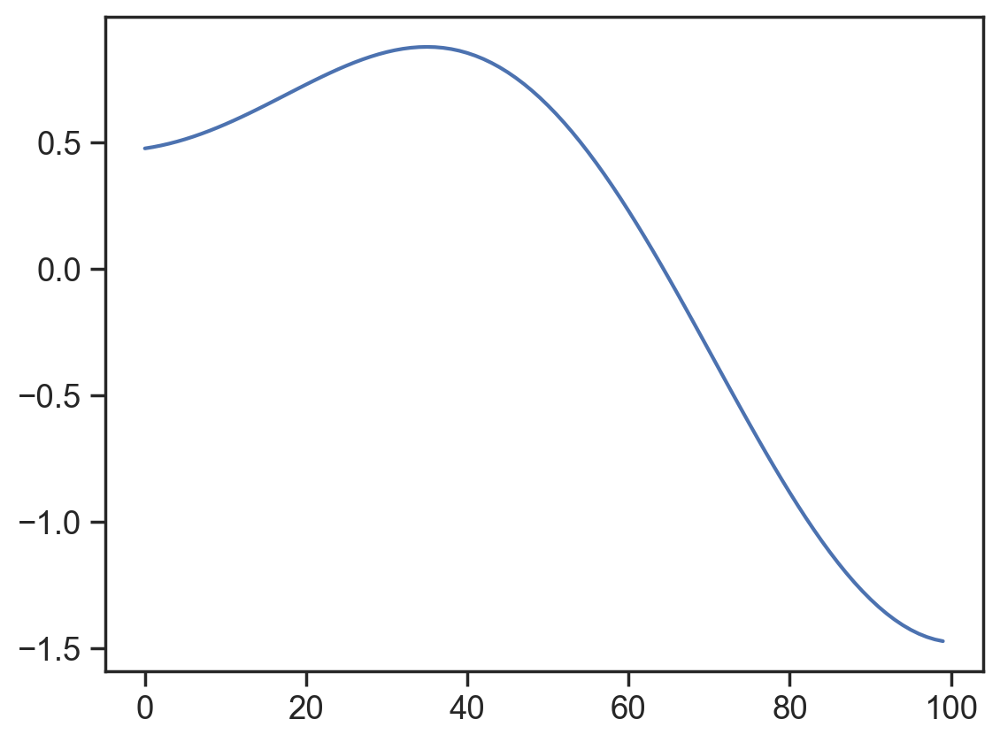

In [237]:
plt.plot(W[n_g//2,:].reshape(-1))

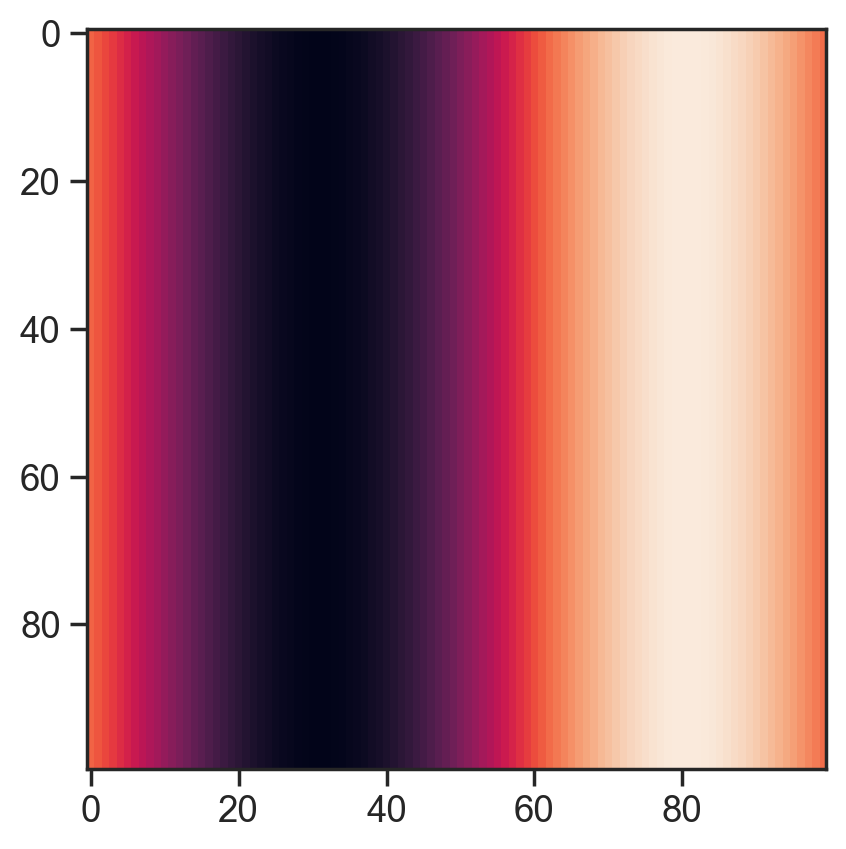

In [224]:
plt.imshow(W_s-W)

In [225]:
# plt.subplot(1,2,1)
# plt.imshow(W)
# plt.subplot(1,2,2)
# plt.imshow(W_s)

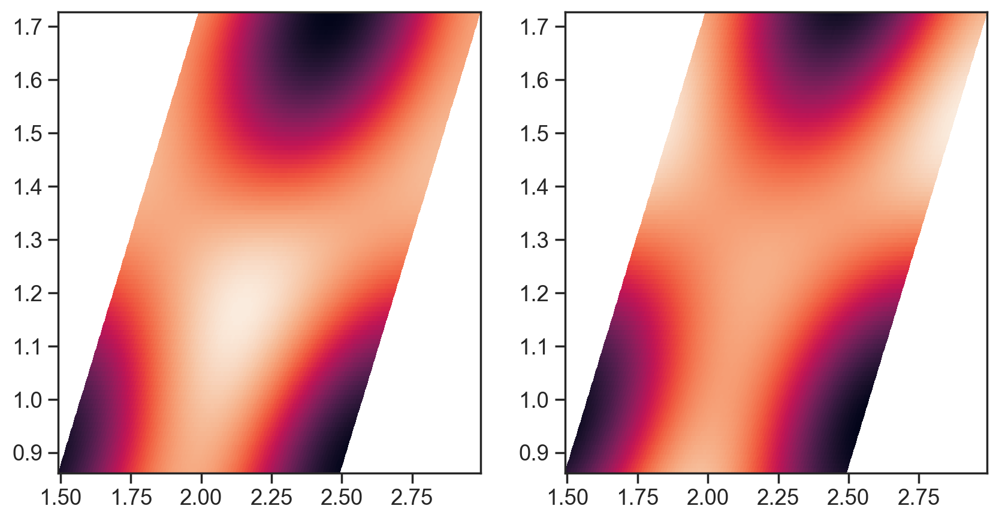

In [226]:
x, y = np.mgrid[:n_g,:n_g]/n_g
u, v = coord_from_phase(x+1,y+1)

plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
plt.pcolormesh(u, v, W, shading='auto')

plt.subplot(1,2,2)
plt.pcolormesh(u, v, W_s, shading='auto')

In [227]:
# can also do with three planar waves

In [228]:
# simple exp
T=1000-1
n_spatial_bins=100
posx = np.mod(np.arange(T+1), n_spatial_bins)
trial_vec = np.concatenate((np.array([1]), 1+np.cumsum(np.diff(posx) < -10)))

# init_state = np.zeros((n_g,))
# init_state[1*n_g//9:2*n_g//9] = 1
# init_state[4*n_g//9:5*n_g//9] = 1
# init_state[7*n_g//9:8*n_g//9] = 1
# init_state[5*n_g//9:8*n_g//9] = 1
# init_state[25:75]=1
init_state = W[:, n_g//2]

l_x = np.zeros((5,5))
n_l = l_x.shape[0]
W_l_init = np.zeros((n_g, n_l))
max_W_l = 1/5 * n_g
min_W_l = 0.1
hebb_strength = 0

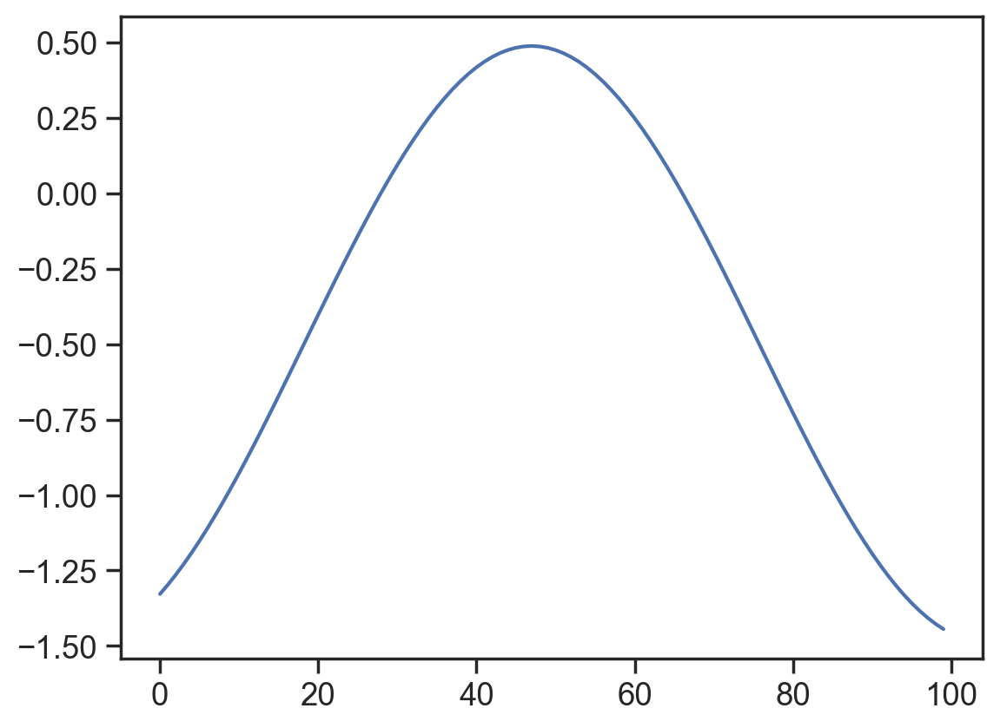

In [245]:
plt.plot(W[:, 0])

In [229]:
W_s = np.zeros((n_g, n_g))

In [230]:
states, W_l_all = simulate_attractor(W, W_s, init_state, T, l_x, W_l_init, max_W_l, min_W_l, hebb_strength, posx)
g_fr=np.copy(states)

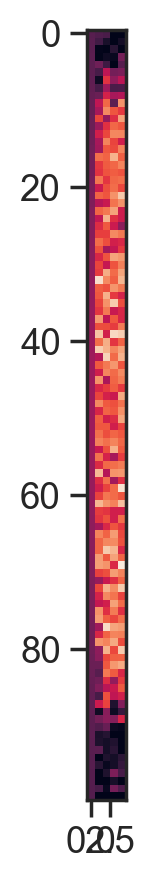

In [231]:
plt.figure(figsize=(5,5))
plt.imshow(states[:,:5])

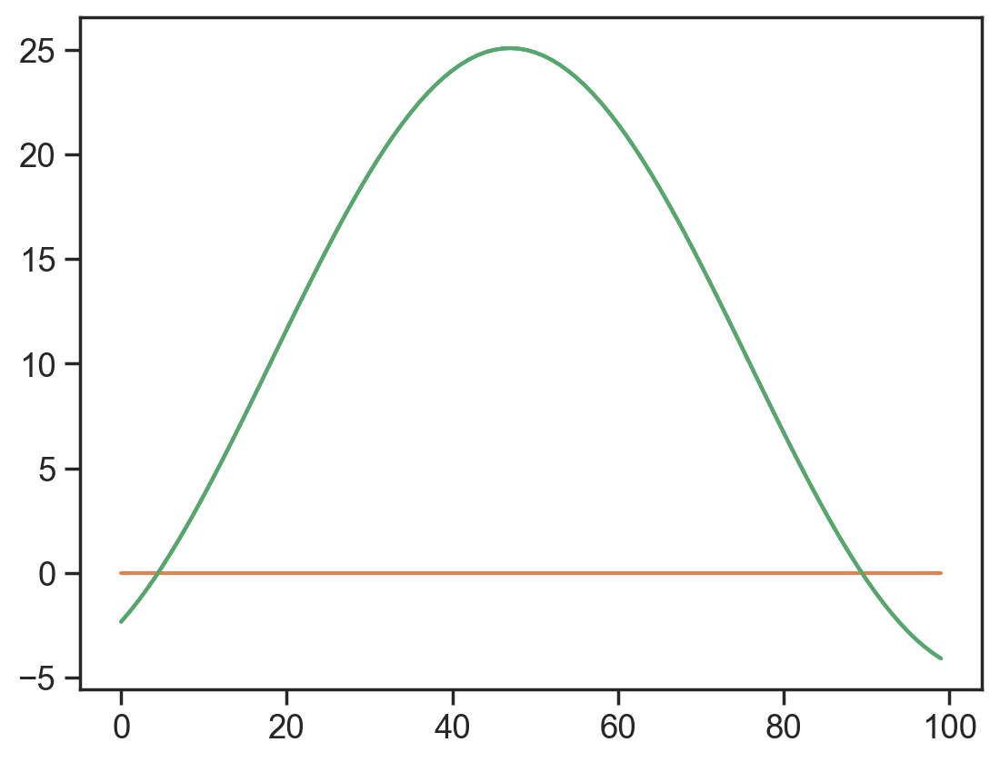

In [232]:
# plt.plot(states[:,0])
idx_use = 1
plt.plot(W@states[:,idx_use])
plt.plot(W_s @ states[:,idx_use])
plt.plot(W @ states[:,idx_use]+W_s @ states[:,idx_use])
# (np.divide(np.ones((n_g,)), (1+np.exp(-W @ states[:, t-1] - W_s @ states[:, t-1])))
#                                       + decay_strength * states[:, t-1] + 0.2*np.random.randn(n_g)) # don't add landmark input

# plt.plot(states[:,1])

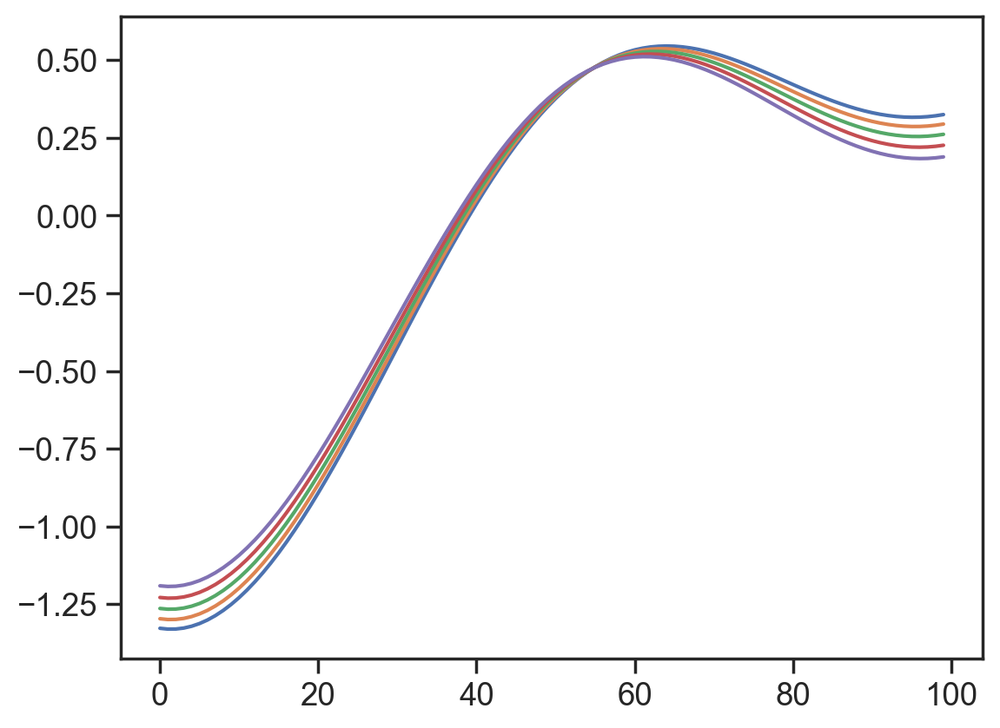

In [233]:
for i in range(5):
    plt.plot(W[i, :])

In [286]:
# Set experiment-specific parameters
n_exps = 5
W_l_init_exps = zeros(n_exps, n_g, n_l);
W_l_init_exps(2, :, :) = W_l_random;
W_l_init_exps(3, :, :) = W_l_random;
W_l_init_exps(4, :, :) = W_l_gaussian;
W_l_init_exps(5, :, :) = W_l_gaussian;

hebb_exps = zeros(n_exps, 1);
hebb_exps([2,4]) = hebb_slow;
hebb_exps([3,5])= hebb_fast;

# Initialize each experiment's states and W_l_over_time
bump_std_dev = 1/50 * n_g; 
state_init = gaussmf(1:n_g, [bump_std_dev, n_g/2]);

states_exp = zeros(n_exps, n_g, T);
W_l_exp = zeros(n_exps, n_g, n_l, T);

for experiment = 1:n_exps
    
    hebb_strength = hebb_exps(experiment);
    if experiment == 1
        this_min_W_l = 0;
        this_max_W_l = 0;
    else
        this_min_W_l = min_W_l;
        this_max_W_l = max_W_l;
    end
    
    for block = 1:n_blocks
        
        t_start = t_starts_all(block);
        t_end = t_starts_all(block+1)-1;
          
        if block == 1
            init_state = state_init;
            t_timepoints = numel(t_start:t_end) - 1; 
            W_l_init = squeeze(W_l_init_exps(experiment, :, :));
            block_posx = posx(t_start:t_end);
        else
            init_state = states_exp(experiment, :, t_start-1);
            t_timepoints = numel(t_start:t_end); 
            W_l_init = squeeze(W_l_exp(experiment, :, :, t_start-1));
            block_posx = [nan, posx(t_start:t_end)];
        end
        
        block_l_idxs = block_conds{block};
        block_l_x = landmark_positions(block_l_idxs, :);
        
        [temp_states, temp_W_l_all] = simulate_attractor(W, W_s, ...
            init_state, t_timepoints, block_l_x, W_l_init, ...
            this_max_W_l, this_min_W_l, hebb_strength, block_posx);
        
        if block == 1
            states_exp(experiment, :, t_start:t_end) = temp_states;
            W_l_exp(experiment, :, :, t_start:t_end) = temp_W_l_all; 
        else
            states_exp(experiment, :, t_start:t_end) = temp_states(:, 2:end);
            W_l_exp(experiment, :, :, t_start:t_end) = temp_W_l_all(:, :, 2:end);
        end
        
        
    end
       
    fprintf('Finished experiment %s of %s\n', num2str(experiment), num2str(n_exps))
         
end


SyntaxError: invalid syntax (4160283769.py, line 4)

In [ ]:
#l_x  of shape n_landmarks x n_positions_per_landmark

In [4]:
l_x = np.vstack(([19, 20, 21],[30, 31, 32], [40,41,42]))

In [18]:
i1,i2=np.where(l_x==42)
i1
i2

array([2], dtype=int64)

In [20]:
np.ones((5,)).shape

(5,)

In [92]:
new_posx_lin=data_dict['new_posx_lin']
g_fr=data_dict["g_fr"]
gridsort=data_dict["gridsort"]
resx=data_dict["resx"]
resy=data_dict["resy"]
phases_all=data_dict["phases_all"]
discs_smooth=data_dict["discs_smooth"]
all_angles_smooth_norm=data_dict["all_angles_smooth_norm"]
phase1_use=data_dict["phase1_use"]
phase2_use=data_dict["phase2_use"]


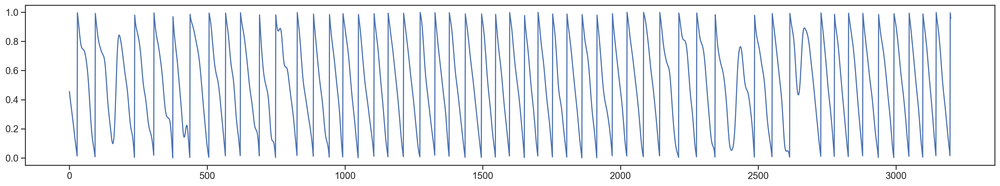

In [119]:
plt.figure(figsize=(24,4))
plt.plot(all_angles_smooth_norm[phase2_use][367*160:387*160])

In [94]:
new_posx_lin.shape

(99040,)

In [95]:
discs_smooth[phase2_use].shape

(1657,)

In [96]:
discs_smooth[phase1_use].shape

(1657,)

In [9]:
new_posx_lin_smooth = gaussian_filter(new_posx_lin, 5)


In [71]:
6440*0.5

3220.0

In [142]:
trial_idxs=np.where(np.diff(np.mod(new_posx_lin, 160))<-25)[0]
trial_idxs=np.hstack((np.array([0]),trial_idxs))

In [150]:
trial_idxs[180]

1656

In [144]:
speed=np.diff(new_posx_lin_smooth)*2

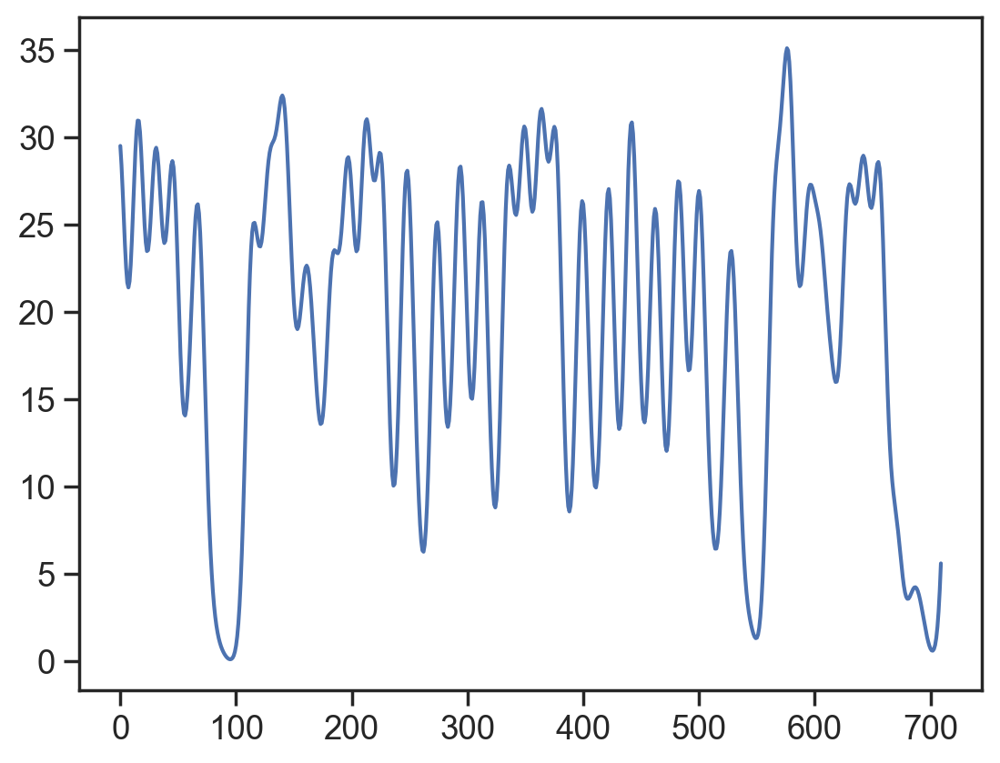

In [155]:
plt.plot(speed[1430:1430+710])

In [193]:
# for AQ1 session
# discontinuity at 460+1430
# discontinuity at 1430+400+310
# disc at 1456+410
# discs_smooth[phase1_use]=np.delete(discs_smooth[phase1_use], 122)
# discs_smooth[phase2_use]=np.delete(discs_smooth[phase2_use], 125)
# idx1=np.where(discs_smooth[phase1_use]==2140)[0]
# idx2=np.where(discs_smooth[phase2_use]==2140)[0]
# discs_smooth[phase1_use]=np.delete(discs_smooth[phase1_use], idx1)
# discs_smooth[phase2_use]=np.delete(discs_smooth[phase2_use], idx2)
# idx2=np.where(discs_smooth[phase2_use]==1456+410)[0]
# discs_smooth[phase2_use]=np.delete(discs_smooth[phase2_use], idx2)


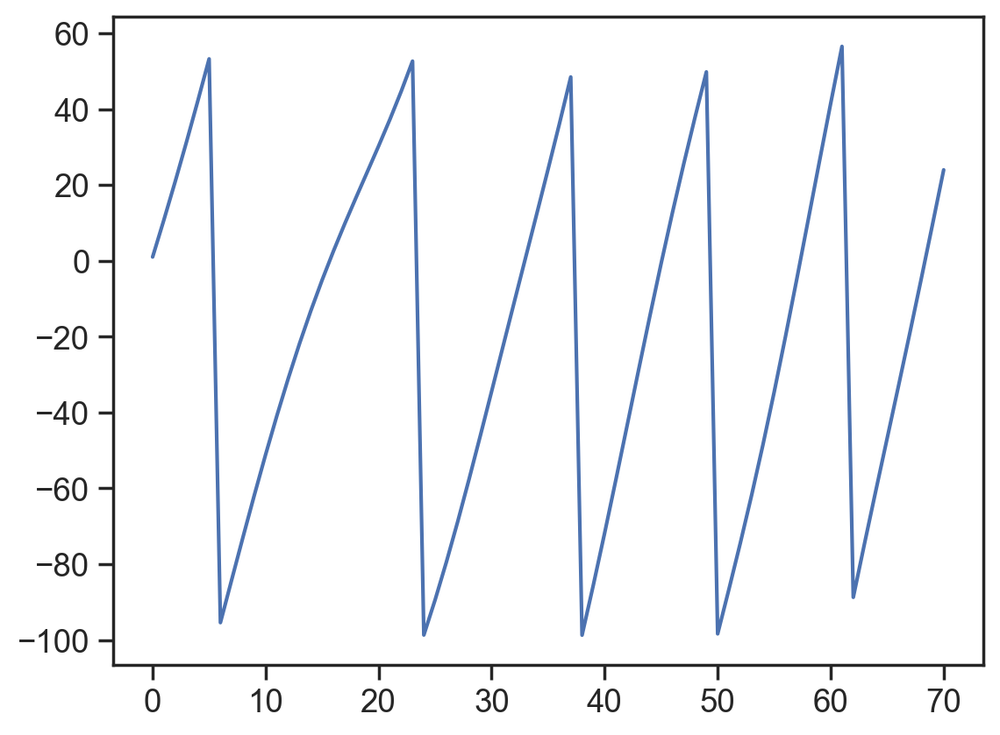

In [234]:
plt.plot(np.mod(new_posx_lin_smooth[1585:1656], 160)-100)

In [97]:
# g_fr_ds = np.zeros((g_fr.shape[0], g_fr.shape[1]//2))
# for i in np.arange(g_fr.shape[0]):
#     g_fr_ds[i] = np.interp(np.arange(0,g_fr.shape[1],2), np.arange(0,g_fr.shape[1],1), g_fr[i].reshape(-1))

# g_fr_old = np.copy(g_fr)
# g_fr = np.copy(g_fr_ds)

In [86]:
# phase1_use=1

In [106]:
# phase2_use=2

In [ ]:
plt.plot(all_angles_

In [117]:
a=discs_smooth[phase1_use]>367*160
b=discs_smooth[phase1_use]<387*160
print(np.sum(a*b))

a=discs_smooth[phase2_use]>367*160
b=discs_smooth[phase2_use]<387*160
np.sum(a*b)

41


70

In [118]:
a=discs_smooth[phase1_use]>40*160
b=discs_smooth[phase1_use]<60*160
print(np.sum(a*b))

a=discs_smooth[phase2_use]>40*160
b=discs_smooth[phase2_use]<60*160
print(np.sum(a*b))

42
52


In [73]:
212800/160

1330.0

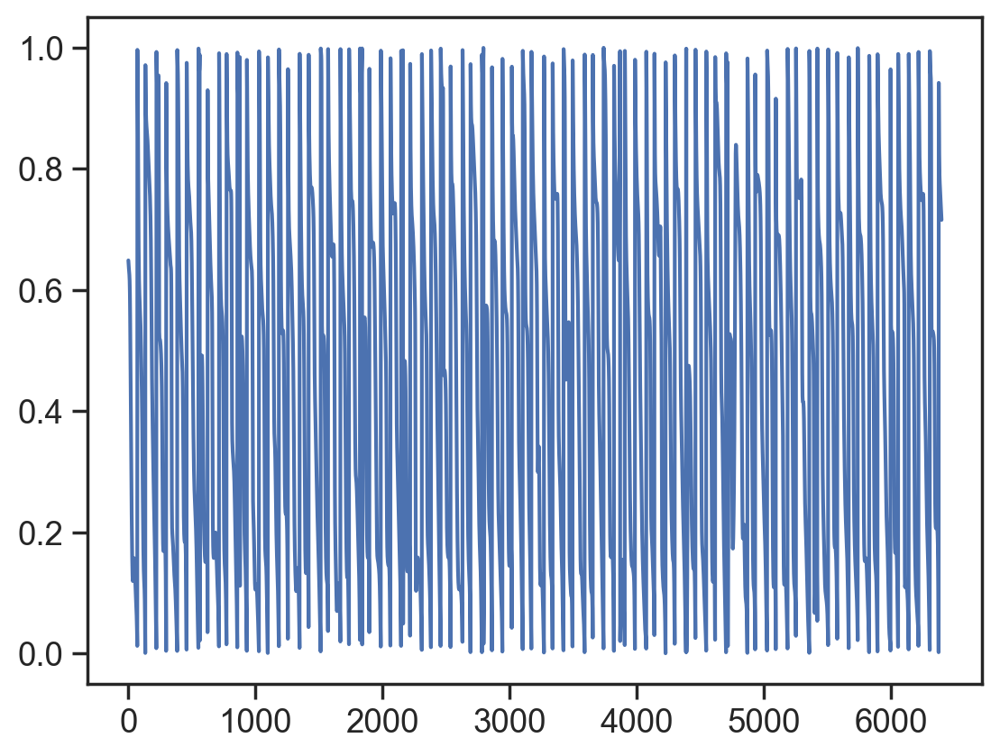

In [74]:
plt.plot(all_angles_smooth_norm[phase1_use, 420*320:440*160])


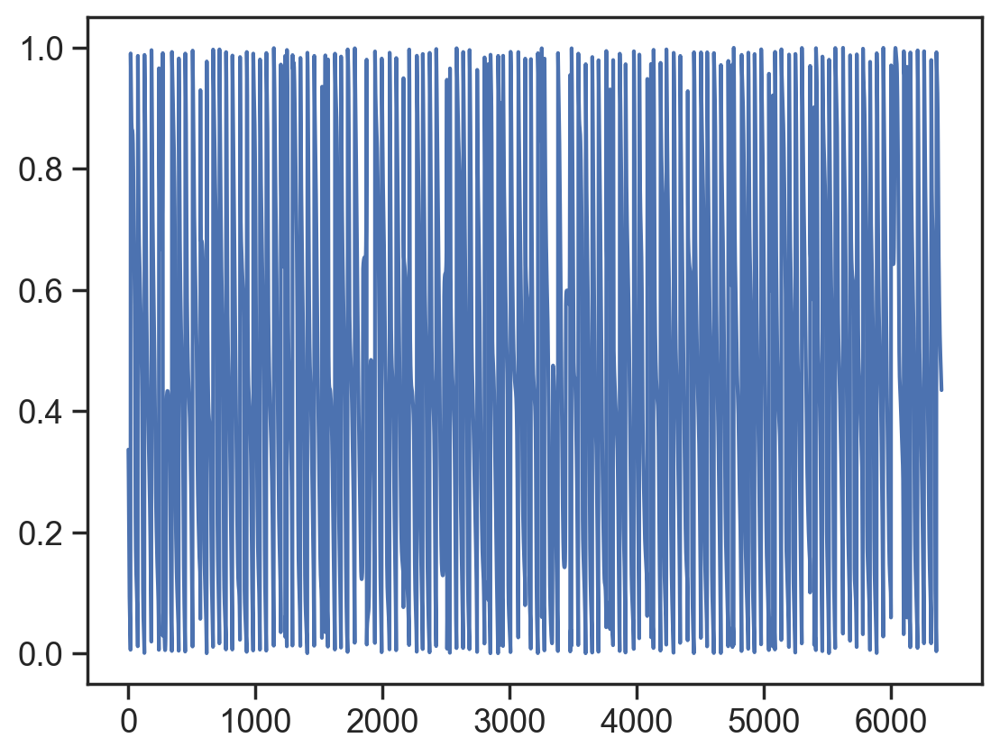

In [78]:
plt.plot(all_angles_smooth_norm[phase2_use, 420*320:440*160])

In [49]:
new_posx_lin.shape

(212800,)

# FOR N2 BUILDUP SESSION

In [45]:
330-300

30

In [120]:
# WILL JUST START WITH 3 COPIES OF THE SHEET
# pickle the variables here
from scipy.interpolate import LinearNDInterpolator
from scipy.ndimage import gaussian_filter
from matplotlib.ticker import FormatStrFormatter

# maps_linearized = maps[grid_cell_idxs[:resx*resy]].reshape(resx*resy, -1)
new_posx_lin_smooth = gaussian_filter(new_posx_lin, 5)
maps_linearized = g_fr[:resx*resy,:].reshape(resx*resy, -1)

spatial_window = 2
# n_windows = 470 # no boundary issue
# n_windows = 1 
# start_frame=1585 #1202 start of landmarks for AQ1, 1656 start of demo
# start_frame=900 #1200 is landmarks on (N2 track10)

n_skip = 1
sigma1 = 2
sigma2 = 1.5

start_trial = 367
end_trial = 387
start_frame=start_trial*160
end_frame=end_trial*160

n_windows = end_frame-start_frame

# n_windows=(20*160)//n_skip

n_rows = int(np.ceil(np.sqrt(n_windows)))

formatter = plt.FuncFormatter(lambda x, pos: f'{x:03.0f}')
yformatter = plt.FuncFormatter(lambda x, pos: f'{x:04.0f}')
yformatter2 = plt.FuncFormatter(lambda x, pos: f'{x:2.0f}')

dpi_val=300
base_save_dir = 'D:/Code/bump_video/N2_lm/'
copy_vals = np.array([1, 3, 75])
old1=[]
old2=[]
distance_counter = 0

for max_i in np.arange(2,copy_vals.shape[0]):
  n_max_copies = copy_vals[max_i]
  save_dir = base_save_dir + f'{n_max_copies}'

  if os.path.isdir(save_dir):
    abc=1
  else:
    os.mkdir(save_dir)

  pid = 0
  phase1_copy_idx = n_max_copies
  phase2_copy_idx = n_max_copies


  for i in np.arange(n_windows):
    fig,ax=plt.subplots(1,1,figsize=(12,8))

    start = i*n_skip+start_frame
    dat = maps_linearized[:, start:start+spatial_window]

    dat = dat.mean(1)
    rm = zscore(dat, axis=0)
    im = rm[gridsort].reshape(resx,resy)

    im_weak=1*im
    im_exp_full=np.tile(im_weak,(3,3))
    im_exp_full[resx:2*resx,resx:2*resx]=im
    im_exp_full_smooth = gaussian_filter(im_exp_full, (sigma1, sigma2))

    range_val = (np.max(im_exp_full_smooth.reshape(-1)) -
            np.min(im_exp_full_smooth.reshape(-1)))

    im_exp_full_smooth = np.divide(im_exp_full_smooth
                                  - np.min(im_exp_full_smooth.reshape(-1)),
                                  range_val)

    im=im_exp_full_smooth[resx:2*resx,resx:2*resx]

    phase1_copies_added = []
    phase2_copies_added = []
    if start in discs_smooth[phase1_use]:
      if phase1_copy_idx - 1 < 1:
        phase1_copy_idx = n_max_copies
      else:
        phase1_copy_idx -= 1

    if start in discs_smooth[phase2_use]:
      if phase2_copy_idx - 1 < 1:
        phase2_copy_idx = n_max_copies
      else:
        phase2_copy_idx -= 1

    im_copies = np.tile(im, (n_max_copies, n_max_copies))

    if n_max_copies > 1:
      phase1_val = all_angles_smooth_norm[phase1_use, start]
      phase2_val = all_angles_smooth_norm[phase2_use, start]

      phase1_loc = resx * (phase1_copy_idx-1) + int(np.round(phase1_val*resx))
      phase2_loc = resx * (phase2_copy_idx-1) + int(np.round(phase2_val*resx))

      if phase1_copy_idx == n_max_copies and phase1_val > 0.5:
        phase1_left_thr = int(np.round(phase1_val*resx)) - resx//2
        im_copies[phase1_left_thr:phase1_loc - resx//2, :] = 0

        phase1_right_thr = phase1_loc + resx//2
        im_copies[phase1_right_thr:, :] = 0
      elif phase1_copy_idx == 1 and phase1_val < 0.5:
        phase1_left_thr = phase1_loc + resx//2
        phase1_right_thr = (n_max_copies * resx) - resx // 4
        im_copies[phase1_left_thr:phase1_right_thr, :] = 0
      else:
        phase1_left_thr = phase1_loc - resx//2
        im_copies[0:phase1_left_thr, :] = 0

        phase1_right_thr = phase1_loc + resx//2
        im_copies[phase1_right_thr:, :] = 0

      if phase2_copy_idx == n_max_copies and phase2_val > 0.5:
        phase2_left_thr = int(np.round(phase2_val*resx)) - resx//2
        im_copies[:, phase2_left_thr:phase2_loc - resx//2] = 0

        phase2_right_thr = phase2_loc + resx//2
        im_copies[:, phase2_right_thr:] = 0
      elif phase2_copy_idx == 1 and phase2_val < 0.5:
        phase2_left_thr = phase2_loc + resx//2
        phase2_right_thr = (n_max_copies * resx) - resx // 4
        im_copies[:, phase2_left_thr:phase2_right_thr] = 0
      else:
        phase2_left_thr = phase2_loc - resx//2
        im_copies[:, 0:phase2_left_thr] = 0

        phase2_right_thr = phase2_loc + resx//2
        im_copies[:, phase2_right_thr:] = 0

      im_copies = gaussian_filter(im_copies, (sigma1, sigma2))

    x_copies, y_copies = np.mgrid[:n_max_copies*resx,:n_max_copies*resy]/resy
    u_copies, v_copies = coord_from_phase(x_copies+1,y_copies+1)

    plt.pcolormesh(u_copies, v_copies, im_copies, shading='auto')

    if n_max_copies >= 5:
        if ((np.mod(start,160)==0) and (i>0)): # 320 is two trials worth
            distance_counter+=1
            old1_temp, old2_temp = coord_from_phase((phase1_loc)/resx+1,(phase2_loc)/resx+1)
            old1.append(old1_temp)
            old2.append(old2_temp)

    if len(old1)>0: # add code to plot the star later
        aa=np.array(old1)
        bb=np.array(old2)
        plt.plot(aa,bb,'w*', ms=10)

    plt.axis('off')
    ax.spines[['left','top','right','bottom']].set_visible(False)
    plt.xticks([])
    plt.yticks([])

    plt.title(f'{start}')

    if n_windows > 1:
      plt.savefig(os.path.join(save_dir,f'{pid:04d}.png'), dpi=dpi_val)
      # fig.savefig(os.path.join(save_dir,f'{pid:03d}.png'), dpi=dpi_val)
      plt.close()
    pid += 1
    if np.mod(i, 100)==0:
      print(f'{i}')

0
100
200
300
400
500
600
700
800
900
1000
1100
1200
1300
1400
1500
1600
1700
1800
1900
2000
2100
2200
2300
2400
2500
2600
2700
2800
2900
3000
3100


# ORIGINAL ONE

In [236]:
# WILL JUST START WITH 3 COPIES OF THE SHEET
# pickle the variables here
from scipy.interpolate import LinearNDInterpolator
from scipy.ndimage import gaussian_filter
from matplotlib.ticker import FormatStrFormatter


flip_lr = False
flip_ud = False
# maps_linearized = maps[grid_cell_idxs[:resx*resy]].reshape(resx*resy, -1)
new_posx_lin_smooth = gaussian_filter(new_posx_lin, 5)
maps_linearized = g_fr[:resx*resy,:].reshape(resx*resy, -1)

spatial_window = 2
n_windows = 470 # no boundary issue
# n_windows = 1 
start_frame=0
# start_frame=1585 #1202 start of landmarks for AQ1, 1656 start of demo
# start_frame=900 #1200 is landmarks on (N2 track10)


#current_xrange = 0.5 * (n_windows // 60) * 60
current_xrange = 240
current_yrange = np.round(new_posx_lin_smooth[start_frame+n_windows]-new_posx_lin_smooth[start_frame])
yl2 = np.round(np.max(np.diff(new_posx_lin_smooth[start_frame:start_frame+n_windows+2]))*2)

n_skip = 1
sigma1 = 2
sigma2 = 1.5
n_rows = int(np.ceil(np.sqrt(n_windows)))

formatter = plt.FuncFormatter(lambda x, pos: f'{x:03.0f}')
yformatter = plt.FuncFormatter(lambda x, pos: f'{x:04.0f}')
yformatter2 = plt.FuncFormatter(lambda x, pos: f'{x:2.0f}')

dpi_val=50
base_save_dir = 'D:/Code/bump_video/N2/'
copy_vals = np.array([1, 3, 3000])
old1=[]
old2=[]
distance_counter = 0

for max_i in np.arange(2,copy_vals.shape[0]):
  n_max_copies = copy_vals[max_i]
  save_dir = base_save_dir + f'{n_max_copies}'

  if os.path.isdir(save_dir):
    abc=1
  else:
    os.mkdir(save_dir)

  pid = 0
  phase1_copy_idx = n_max_copies
  phase2_copy_idx = n_max_copies


  for i in np.arange(n_windows):
    # plt.subplot(n_rows, n_rows, i+1)
    # fig, ax = plt.subplots(1,3, figsize=(24,8))

    plt.figure(figsize=(24,8))

    start = i*n_skip+start_frame
    dat = maps_linearized[:, start:start+spatial_window]

    dat = dat.mean(1)
    rm = zscore(dat, axis=0)
    im = rm[gridsort].reshape(resx,resy)

    if flip_lr:
        im = np.fliplr(im)
    if flip_ud:
        im = np.flipud(im)

    im_weak=1*im
    im_exp_full=np.tile(im_weak,(3,3))
    im_exp_full[resx:2*resx,resx:2*resx]=im

    im_exp_full_smooth = gaussian_filter(im_exp_full, (sigma1, sigma2))

    range = (np.max(im_exp_full_smooth.reshape(-1)) -
            np.min(im_exp_full_smooth.reshape(-1)))

    im_exp_full_smooth = np.divide(im_exp_full_smooth
                                  - np.min(im_exp_full_smooth.reshape(-1)),
                                  range)

    im=im_exp_full_smooth[resx:2*resx,resx:2*resx]

    phase1_copies_added = []
    phase2_copies_added = []
    if start in discs_smooth[phase1_use]:
      if phase1_copy_idx - 1 < 0:
        phase1_copy_idx = n_max_copies
      else:
        phase1_copy_idx -= 1

    if start in discs_smooth[phase2_use]:
      if phase2_copy_idx - 1 < 0:
        phase2_copy_idx = n_max_copies
      else:
        phase2_copy_idx -= 1

    im_copies = np.tile(im, (n_max_copies, n_max_copies))

    if n_max_copies > 1:
      phase1_val = all_angles_smooth_norm[phase1_use, start]
      phase2_val = all_angles_smooth_norm[phase2_use, start]

      phase1_loc = resx * (phase1_copy_idx-1) + int(np.round(phase1_val*resx))
      phase2_loc = resx * (phase2_copy_idx-1) + int(np.round(phase2_val*resx))

      if phase1_copy_idx == n_max_copies and phase1_val > 0.5:
        phase1_left_thr = int(np.round(phase1_val*resx)) - resx//2
        im_copies[phase1_left_thr:phase1_loc - resx//2, :] = 0

        phase1_right_thr = phase1_loc + resx//2
        im_copies[phase1_right_thr:, :] = 0
      elif phase1_copy_idx == 1 and phase1_val < 0.5:
        phase1_left_thr = phase1_loc + resx//2
        phase1_right_thr = (n_max_copies * resx) - resx // 4
        im_copies[phase1_left_thr:phase1_right_thr, :] = 0
      else:
        phase1_left_thr = phase1_loc - resx//2
        im_copies[0:phase1_left_thr, :] = 0

        phase1_right_thr = phase1_loc + resx//2
        im_copies[phase1_right_thr:, :] = 0

      if phase2_copy_idx == n_max_copies and phase2_val > 0.5:
        phase2_left_thr = int(np.round(phase2_val*resx)) - resx//2
        im_copies[:, phase2_left_thr:phase2_loc - resx//2] = 0

        phase2_right_thr = phase2_loc + resx//2
        im_copies[:, phase2_right_thr:] = 0
      elif phase2_copy_idx == 1 and phase2_val < 0.5:
        phase2_left_thr = phase2_loc + resx//2
        phase2_right_thr = (n_max_copies * resx) - resx // 4
        im_copies[:, phase2_left_thr:phase2_right_thr] = 0
      else:
        phase2_left_thr = phase2_loc - resx//2
        im_copies[:, 0:phase2_left_thr] = 0

        phase2_right_thr = phase2_loc + resx//2
        im_copies[:, phase2_right_thr:] = 0

      im_copies = gaussian_filter(im_copies, (sigma1, sigma2))

    x_copies, y_copies = np.mgrid[:n_max_copies*resx,:n_max_copies*resy]/resy
    u_copies, v_copies = coord_from_phase(x_copies+1,y_copies+1)

    ax=plt.subplot(1,3,1)
    plt.pcolormesh(u_copies, v_copies, im_copies, shading='auto')

    # consider adding history for large sheet
    if n_max_copies > 5:
        if (new_posx_lin_smooth[start_frame+i]-new_posx_lin_smooth[start_frame]) > distance_counter * 320:
            distance_counter+=1
            old1_temp, old2_temp = coord_from_phase((phase1_loc)/resx+1,(phase2_loc)/resx+1)
            old1.append(old1_temp)
            old2.append(old2_temp)


    if len(old1)>0: # add code to plot the star later
        aa=np.array(old1)
        bb=np.array(old2)
        plt.plot(aa,bb,'w*', ms=10)

    plt.axis('off')
    ax.spines[['left','top','right','bottom']].set_visible(False)
    # plt.text(1.85, 0.71, 'Grid Axis 1',fontsize=20)
    # plt.text(1.45, 1.2, 'Grid Axis 2', rotation=69,fontsize=20)
    plt.xticks([])
    plt.yticks([])


    ax = plt.subplot(1,3,2)
    dat=new_posx_lin_smooth[start_frame:start_frame+i+1]-new_posx_lin_smooth[start_frame]
    plt.plot(np.linspace(0,0.5*dat.shape[0],dat.shape[0]), dat, 'k*-', linewidth=5, ms=15)

    if 0.5*dat.shape[0] > current_xrange:
      current_xrange = 2*current_xrange
      # plt.xticks(np.arange(xl0, xl0+5.5, 1))

    plt.xlim([0, current_xrange])
    xl0 = 0
    xlm = current_xrange/2
    num_ticks = 5
    xtick_locations = np.arange(0, current_xrange + 1, current_xrange / (num_ticks - 1))
    plt.xticks(xtick_locations)
    plt.gca().xaxis.set_major_formatter(formatter)

    if dat[-1]>=current_yrange:
      current_yrange = 2*current_yrange
    else:
      yl0 = 0

    plt.ylim([0, current_yrange])
    yl0=0

    num_ticks = 4
    ytick_locations = np.arange(0, current_yrange + 1, current_yrange / (num_ticks - 1))

    plt.gca().yaxis.set_major_formatter(yformatter)
    plt.xlabel('Time (s)', fontsize=24)
    plt.ylabel('Position (cm)', fontsize=24)
    # plt.text(xlm, yl0-12, 'Time (s)', fontsize=20, horizontalalignment='center', verticalalignment='top')
    # plt.text(xl0-0.75, mp, 'Position (cm)', fontsize=20, rotation=90, verticalalignment='center')
    plt.xticks(fontsize=20)
    plt.yticks(ytick_locations, fontsize=20)
    plt.tight_layout()

    # Hide the right and top spines
    ax.spines[['right', 'top']].set_visible(False)


    ax = plt.subplot(1,3,3)
    dat2=np.diff(new_posx_lin_smooth[start_frame:start_frame+i+2]) * 2
    plt.plot(np.linspace(0,0.5*dat2.shape[0],dat2.shape[0]), dat2, 'k*-', linewidth=5, ms=15)

    plt.xlim([0, current_xrange])
    xl0 = 0
    xlm = current_xrange/2
    num_ticks = 5
    xtick_locations = np.arange(0, current_xrange + 1, current_xrange / (num_ticks - 1))
    plt.xticks(xtick_locations)
    plt.gca().xaxis.set_major_formatter(formatter)


    plt.ylim([0, yl2])
    num_ticks = 4
    ytick_locations = np.arange(0, yl2+1, yl2 / (num_ticks - 1))
    plt.gca().yaxis.set_major_formatter(yformatter2)
    plt.xlabel('Time (s)', fontsize=24)
    plt.ylabel('Speed (cm/s)', fontsize=24)
    plt.xticks(fontsize=20)
    plt.yticks(ytick_locations, fontsize=20)

    # Hide the right and top spines
    ax.spines[['right', 'top']].set_visible(False)

    plt.suptitle(f'{i}')

    plt.tight_layout()
    if n_windows > 1:
      plt.savefig(os.path.join(save_dir,f'{pid:04d}.png'), dpi=dpi_val)
      # fig.savefig(os.path.join(save_dir,f'{pid:03d}.png'), dpi=dpi_val)
      plt.close()
    pid += 1
    if np.mod(i, 50)==0:
      print(f'{i}')

0
50
100
150
200
250
300
350
400
450


In [49]:
# # WILL JUST START WITH 3 COPIES OF THE SHEET
# # pickle the variables here
# from scipy.interpolate import LinearNDInterpolator
# from scipy.ndimage import gaussian_filter
# from matplotlib.ticker import FormatStrFormatter


# # maps_linearized = maps[grid_cell_idxs[:resx*resy]].reshape(resx*resy, -1)
# new_posx_lin_smooth = gaussian_filter(new_posx_lin, 5)
# maps_linearized = g_fr[:resx*resy,:].reshape(resx*resy, -1)

# spatial_window = 2
# n_windows = 710 # no boundary issue
# # n_windows = 1 
# start_frame=3494

# if start_frame==0:
#   current_yrange = (np.round(np.max(new_posx_lin_smooth)/100))*100
#   current_xrange = 3600
#   yl2 = np.max(np.diff(new_posx_lin_smooth) * 2)
# else:
#   #current_xrange = 0.5 * (n_windows // 60) * 60
#   current_xrange = 360
#   current_yrange = 3600
#   yl2 = np.round(np.max(np.diff(new_posx_lin_smooth[start_frame:start_frame+n_windows+2]))*2)

# n_skip = 1
# sigma1 = 2
# sigma2 = 1.5
# n_rows = int(np.ceil(np.sqrt(n_windows)))

# formatter = plt.FuncFormatter(lambda x, pos: f'{x:03.0f}')
# yformatter = plt.FuncFormatter(lambda x, pos: f'{x:04.0f}')
# yformatter2 = plt.FuncFormatter(lambda x, pos: f'{x:2.0f}')

# dpi_val=300
# base_save_dir = 'D:/Code/bump_video/'
# copy_vals = np.array([1, 3, 50])
# old1=[]
# old2=[]
# distance_counter = 0

# for max_i in np.arange(copy_vals.shape[0]):
#   n_max_copies = copy_vals[max_i]
#   save_dir = base_save_dir + f'{n_max_copies}'

#   if os.path.isdir(save_dir):
#     abc=1
#   else:
#     os.mkdir(save_dir)

#   pid = 0
#   phase1_copy_idx = 1
#   phase2_copy_idx = 1


#   for i in np.arange(n_windows):
#     # plt.subplot(n_rows, n_rows, i+1)
#     # fig, ax = plt.subplots(1,3, figsize=(24,8))

#     plt.figure(figsize=(24,8))

#     start = i*n_skip+start_frame
#     dat = maps_linearized[:, start:start+spatial_window]

#     dat = dat.mean(1)
#     rm = zscore(dat, axis=0)
#     im = rm[gridsort].reshape(resx,resy)

#     im_weak=1*im
#     im_exp_full=np.tile(im_weak,(3,3))
#     im_exp_full[resx:2*resx,resx:2*resx]=im

#     im_exp_full_smooth = gaussian_filter(im_exp_full, (sigma1, sigma2))

#     range = (np.max(im_exp_full_smooth.reshape(-1)) -
#             np.min(im_exp_full_smooth.reshape(-1)))

#     im_exp_full_smooth = np.divide(im_exp_full_smooth
#                                   - np.min(im_exp_full_smooth.reshape(-1)),
#                                   range)

#     im=im_exp_full_smooth[resx:2*resx,resx:2*resx]

#     phase1_copies_added = []
#     phase2_copies_added = []
#     if start in discs_smooth[phase1_use]:
#       if phase1_copy_idx + 1 > n_max_copies:
#         phase1_copy_idx = 1
#       else:
#         phase1_copy_idx += 1

#     if start in discs_smooth[phase2_use]:
#       if phase2_copy_idx + 1 > n_max_copies:
#         phase2_copy_idx = 1
#       else:
#         phase2_copy_idx += 1

#     im_copies = np.tile(im, (n_max_copies, n_max_copies))

#     if n_max_copies > 1:
#       phase1_val = all_angles_smooth_norm[phase1_use, start]
#       phase2_val = all_angles_smooth_norm[phase2_use, start]

#       phase1_loc = resx * (phase1_copy_idx-1) + int(np.round(phase1_val*resx))
#       phase2_loc = resx * (phase2_copy_idx-1) + int(np.round(phase2_val*resx))

#       if phase1_copy_idx == n_max_copies and phase1_val > 0.5:
#         phase1_left_thr = int(np.round(phase1_val*resx)) - resx//2
#         im_copies[phase1_left_thr:phase1_loc - resx//2, :] = 0

#         phase1_right_thr = phase1_loc + resx//2
#         im_copies[phase1_right_thr:, :] = 0
#       elif phase1_copy_idx == 1 and phase1_val < 0.5:
#         phase1_left_thr = phase1_loc + resx//2
#         phase1_right_thr = (n_max_copies * resx) - resx // 4
#         im_copies[phase1_left_thr:phase1_right_thr, :] = 0
#       else:
#         phase1_left_thr = phase1_loc - resx//2
#         im_copies[0:phase1_left_thr, :] = 0

#         phase1_right_thr = phase1_loc + resx//2
#         im_copies[phase1_right_thr:, :] = 0

#       if phase2_copy_idx == n_max_copies and phase2_val > 0.5:
#         phase2_left_thr = int(np.round(phase2_val*resx)) - resx//2
#         im_copies[:, phase2_left_thr:phase2_loc - resx//2] = 0

#         phase2_right_thr = phase2_loc + resx//2
#         im_copies[:, phase2_right_thr:] = 0
#       elif phase2_copy_idx == 1 and phase2_val < 0.5:
#         phase2_left_thr = phase2_loc + resx//2
#         phase2_right_thr = (n_max_copies * resx) - resx // 4
#         im_copies[:, phase2_left_thr:phase2_right_thr] = 0
#       else:
#         phase2_left_thr = phase2_loc - resx//2
#         im_copies[:, 0:phase2_left_thr] = 0

#         phase2_right_thr = phase2_loc + resx//2
#         im_copies[:, phase2_right_thr:] = 0

#       im_copies = gaussian_filter(im_copies, (sigma1, sigma2))

#     x_copies, y_copies = np.mgrid[:n_max_copies*resx,:n_max_copies*resy]/resy
#     u_copies, v_copies = coord_from_phase(x_copies+1,y_copies+1)

#     ax=plt.subplot(1,3,1)
#     plt.pcolormesh(u_copies, v_copies, im_copies, shading='auto')

#     # consider adding history for large sheet
#     if n_max_copies == 50:
#         if new_posx_lin_smooth[start_frame+i]-new_posx_lin_smooth[start_frame] > distance_counter * 200:
#             distance_counter+=1
#             old1_temp, old2_temp = coord_from_phase((phase1_loc)/resx+1,(phase2_loc)/resx+1)
#             old1.append(old1_temp)
#             old2.append(old2_temp)


#     if len(old1)>0: # add code to plot the star later
#         aa=np.array(old1)
#         bb=np.array(old2)
#         plt.plot(aa,bb,'w*', ms=10)

#     plt.axis('off')
#     ax.spines[['left','top','right','bottom']].set_visible(False)
#     # plt.text(1.85, 0.71, 'Grid Axis 1',fontsize=20)
#     # plt.text(1.45, 1.2, 'Grid Axis 2', rotation=69,fontsize=20)
#     plt.xticks([])
#     plt.yticks([])


#     ax = plt.subplot(1,3,2)
#     dat=new_posx_lin_smooth[start_frame:start_frame+i+1]-new_posx_lin_smooth[start_frame]
#     plt.plot(np.linspace(0,0.5*dat.shape[0],dat.shape[0]), dat, 'k*-', linewidth=5, ms=15)

#     if 0.5*dat.shape[0] > current_xrange:
#       current_xrange = 2*current_xrange
#       # plt.xticks(np.arange(xl0, xl0+5.5, 1))

#     plt.xlim([0, current_xrange])
#     xl0 = 0
#     xlm = current_xrange/2
#     num_ticks = 5
#     xtick_locations = np.arange(0, current_xrange + 1, current_xrange / (num_ticks - 1))
#     plt.xticks(xtick_locations)
#     plt.gca().xaxis.set_major_formatter(formatter)

#     if dat[-1]>=current_yrange:
#       current_yrange = 2*current_yrange
#     else:
#       yl0 = 0

#     plt.ylim([0, current_yrange])
#     yl0=0

#     num_ticks = 4
#     ytick_locations = np.arange(0, current_yrange + 1, current_yrange / (num_ticks - 1))

#     plt.gca().yaxis.set_major_formatter(yformatter)
#     plt.xlabel('Time (s)', fontsize=24)
#     plt.ylabel('Position (cm)', fontsize=24)
#     # plt.text(xlm, yl0-12, 'Time (s)', fontsize=20, horizontalalignment='center', verticalalignment='top')
#     # plt.text(xl0-0.75, mp, 'Position (cm)', fontsize=20, rotation=90, verticalalignment='center')
#     plt.xticks(fontsize=20)
#     plt.yticks(ytick_locations, fontsize=20)
#     plt.tight_layout()

#     # Hide the right and top spines
#     ax.spines[['right', 'top']].set_visible(False)


#     ax = plt.subplot(1,3,3)
#     dat2=np.diff(new_posx_lin_smooth[start_frame:start_frame+i+2]) * 2
#     plt.plot(np.linspace(0,0.5*dat2.shape[0],dat2.shape[0]), dat2, 'k*-', linewidth=5, ms=15)

#     plt.xlim([0, current_xrange])
#     xl0 = 0
#     xlm = current_xrange/2
#     num_ticks = 5
#     xtick_locations = np.arange(0, current_xrange + 1, current_xrange / (num_ticks - 1))
#     plt.xticks(xtick_locations)
#     plt.gca().xaxis.set_major_formatter(formatter)


#     plt.ylim([0, yl2])
#     num_ticks = 4
#     ytick_locations = np.arange(0, yl2+1, yl2 / (num_ticks - 1))
#     plt.gca().yaxis.set_major_formatter(yformatter2)
#     plt.xlabel('Time (s)', fontsize=24)
#     plt.ylabel('Speed (cm/s)', fontsize=24)
#     plt.xticks(fontsize=20)
#     plt.yticks(ytick_locations, fontsize=20)

#     # Hide the right and top spines
#     ax.spines[['right', 'top']].set_visible(False)

#     plt.suptitle(f'{i}')

#     plt.tight_layout()
#     if n_windows > 1:
#       plt.savefig(os.path.join(save_dir,f'{pid:04d}.png'), dpi=dpi_val)
#       # fig.savefig(os.path.join(save_dir,f'{pid:03d}.png'), dpi=dpi_val)
#       plt.close()
#     pid += 1
#     if np.mod(i, 50)==0:
#       print(f'{i}')

0
50
100
150
200
250
300
350
400
450
500
550
600
650
700
0
50
100
150
200
250
300
350
400
450
500
550
600
650
700
0
50
100
150
200
250
300
350
400
450
500
550
600
650
700


In [ ]:
# Neural data
# try AO2_231220_postop_day6 session
# 'AQ1_240817_dark_exp01'

animal='AO2'
#session='240826_gain_change_exp01'
# session='231222_postop_day8_dark01'
session='231220_postop_day6_dark01'

fname=animal+'_'+session

mouse,date = fname.split('_')[:2]

data_dir = '/content/drive/MyDrive/Mouse Training/recordings'

# data_dir = '/content/drive/MyDrive/Mouse Training/object_recordings'
# data_dir = '/content/drive/MyDrive/Mouse Training/object_recordings/dredge_ks4'

save_dir = f'/content/drive/MyDrive/Mouse Training/{mouse}/'

# while not os.path.isfile(os.path.join(data_dir,fname+'_all_maps.mat')):
#   time.sleep(1.0)

data = loadmat(os.path.join(data_dir,fname+'_all_maps.mat'))
data2 = loadmat(os.path.join(data_dir,fname+'.mat'))
# data3 = mat73.loadmat(os.path.join(data_dir,fname+'_time_fr.mat'))
spatial_bin = 2

if spatial_bin == 1:
  raw_maps = np.nan_to_num(data['all_maps']) # your spatial firing rate maps (cells x trials x spatial bins)
elif spatial_bin == 2:
  raw_maps = np.nan_to_num(data['all_maps']) # your spatial firing rate maps (cells x trials x spatial bins)
elif spatial_bin == 5:
  raw_maps = np.nan_to_num(data['all_maps5']) # your spatial firing rate maps (cells x trials x spatial bins)


params = pd.read_csv(os.path.join(save_dir,'_'.join(fname.split('_')[1:])+'_params.txt'),
                     sep=' = ', header=None,index_col=0)

trials_per_block = [int(r) for r in params.loc['TrialsPerBlock'].to_numpy()[0].split(' ')]
# trials_per_block.insert(0,120)
trial_starts = np.concatenate([[0],np.cumsum(trials_per_block)])
n_blocks = len(trial_starts)-1
tower_pos1 = [float(r) for r in params.loc['Tower1PositionPerBlock'].to_numpy()[0].split(' ')]
tower_pos2 = [float(r) for r in params.loc['Tower2PositionPerBlock'].to_numpy()[0].split(' ')]
tower_pos3 = [float(r) for r in params.loc['Tower3PositionPerBlock'].to_numpy()[0].split(' ')]
gc_pos = [float(r) for r in params.loc['GCPositionPerBlock'].to_numpy()[0].split(' ')]
reward_pos = [float(r) for r in params.loc['RewardPosition1PerBlock'].to_numpy()[0].split(' ')]
landmark_positions = np.vstack([tower_pos1,tower_pos2,tower_pos3,gc_pos,reward_pos]).T
#demo_per_block = [float(r) for r in params.loc['DemoMinVelocityPerBlock'].to_numpy()[0].split(' ')]
#demo_per_block = np.array(demo_per_block) > 0
#demo_blocks = np.where(demo_per_block)[0]

of_per_block = [int(r) for r in params.loc['PrePostPerBlock'].to_numpy()[0].split(' ')]
of_per_block = np.array(of_per_block) > 0

# demo_params = pd.read_csv(os.path.join(save_dir,'_'.join(fname.split('_')[1:])+'_demo_params.txt'),
#                           sep=' = ', header=None,index_col=0)
# demo_start_pos = demo_params.loc['StartPosition'].to_numpy()[0]

#Get trial times using positions
positions = pd.read_csv(os.path.join(save_dir,'_'.join(fname.split('_')[1:])+'_position.txt'),
                        sep='\t',header=None).to_numpy()
x = positions[:,0]
t = positions[:,1]
trial_times = t[np.where(np.abs(np.diff(x))>100)[0]]

N = raw_maps.shape[0]          # num neurons
n_trials = raw_maps.shape[1]    # num trials
L = raw_maps.shape[-1]         # num spatial bins
print(f'{N} cells, {n_trials} trials, {L} spatial bins')


# shifts_load = pd.read_csv(os.path.join(save_dir,'_'.join(fname.split('_')[1:])+'_shifts.txt'),header=None, sep=', ', engine='python').to_numpy()

# shifts = []
# for i in range(len(shifts_load)):
#     shifts.append([float(s) for s in shifts_load[i][0].split(',')])

# shifted_maps = np.zeros_like(raw_maps)
# for b in range(n_blocks):
#   block_trials = np.arange(trial_starts[b], trial_starts[b+1])
#   block_shifts = shifts[b]

#   if np.all(block_trials < n_trials):
#     block_maps = raw_maps[:, block_trials, :]

#     for t_idx in range(len(block_shifts)):
#       if block_shifts[t_idx] > 0:
#         shifted_maps[:, t_idx+block_trials[0], :] = np.roll(block_maps[:, t_idx, :], -int(round(block_shifts[t_idx])), axis=-1)
#       else:
#         shifted_maps[:, t_idx+block_trials[0], :] = block_maps[:, t_idx, :]

# demo_vel_file = os.path.join(save_dir,'_'.join(fname.split('_')[1:])+'_demo_velocities.txt')
# with open(demo_vel_file, 'r') as temp_f:
#     # get No of columns in each line
#     col_count = [len(l.split(",")) for l in temp_f.readlines() ]

# ### Generate column names  (names will be 0, 1, 2, ..., maximum columns - 1)
# column_names = [i for i in range(0, max(col_count))]

# ### Read csv
# np_array = pd.read_csv(demo_vel_file, header=None, delimiter=",", names=column_names).to_numpy()
# demo_vels = np_array[~np.isnan(np_array)]

<ipython-input-2-a29ad2abd554>:37: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  params = pd.read_csv(os.path.join(save_dir,'_'.join(fname.split('_')[1:])+'_params.txt'),


342 cells, 194 trials, 100 spatial bins


In [ ]:
sp=data2['sp']
spt=np.squeeze(sp['st'][0][0])
cids=np.squeeze(sp['cids'][0][0])
clu=np.squeeze(sp['clu'][0][0])
cells_to_plot = np.squeeze(data['cells_to_plot'][0])

In [ ]:
#calculate grid cell instantaneous firing rate
post=np.squeeze(data2['post'])
posx=np.squeeze(data2['posx'])

trial_idxs = np.where(np.diff(posx)<-5)[0]+1
posx_lin = np.zeros_like(posx)
posx_lin[:trial_idxs[0]]=posx[:trial_idxs[0]]

for t in np.arange(trial_idxs.shape[0]-1):
  posx_lin[trial_idxs[t]:trial_idxs[t+1]] = posx[trial_idxs[t]:trial_idxs[t+1]]+200*(t+1)
  if (t == trial_idxs.shape[0]-2):
    posx_lin[trial_idxs[t+1]:] = posx[trial_idxs[t+1]:]+200*(t+2)

new_t=0.5
new_post=np.arange(0,np.max(post),new_t)
new_posx = np.interp(new_post,post,posx)
new_posx_lin = np.interp(new_post,post,posx_lin)
# trial_idxs = np.where(np.diff(new_posx)<-10)[0]+1
# new_posx_lin = np.zeros_like(new_posx)
# new_posx_lin[:trial_idxs[0]]=new_posx[:trial_idxs[0]]

# for t in np.arange(trial_idxs.shape[0]-1):
#   new_posx_lin[trial_idxs[t]:trial_idxs[t+1]] = new_posx[trial_idxs[t]:trial_idxs[t+1]]+200*(t+1)

In [ ]:
# grid_cell_idxs=np.array([  0,   2,  10,  11,  14,  15,  16,  18,  20,  25,  40,  43,  48,
#         49,  57,  60,  61,  63,  65,  66,  67,  69,  71,  73,  74,  83,
#         85,  86,  88,  93,  95,  96, 101, 103, 105, 107, 108, 110, 111,
#        114, 116, 118, 120, 122, 126, 128, 133, 137, 140, 143, 149, 151,
#        152, 164, 165, 178, 191, 202, 206, 220, 223, 229, 239, 245, 246])


In [ ]:
# phases_all=[]
# phases_all.append([ 2.66396512, -2.18175464, -0.16772444,  1.42789813, -1.6157439 ,
#         -1.64827123,  1.56141801,  1.33267952, -1.71253722, -0.35024886,
#          1.67716576,  0.13698621, -0.27180333, -2.09052633, -1.27916396,
#          2.02044824,  0.58534405, -3.03042601,  2.26190512,  0.87861191,
#          0.72113886, -1.53489239, -3.08826011,  0.16955344,  1.11578644,
#         -2.12847568, -0.15435298,  0.81372666, -0.15205552,  1.70904839,
#          3.10697452,  0.92196324, -1.03483527,  0.09412092, -1.30782663,
#          3.02695709,  0.2928019 ,  2.01963759, -0.04318064, -0.58696944,
#         -3.06245731,  2.55725735,  1.99749876,  2.56601363,  2.78864036,
#         -0.06189756, -1.37515942, -0.40493225,  1.89360505, -0.69310334,
#          1.40633792,  2.13606556,  1.74891785,  0.7900622 , -2.96031222,
#          0.16840425, -0.41014239,  1.85674399, -3.13249264, -0.59471475,
#          0.52760507,  2.88032335, -0.77200938, -2.60934191, -2.69258079])

# phases_all.append([-2.22004677, -1.12444736, -1.47304647, -2.95456674, -1.4880663 ,
#         -0.78973531,  2.13297491, -0.90167603, -0.03048174,  0.0284717 ,
#          2.60100491, -0.06712561, -1.2549062 ,  0.42959796, -2.11142301,
#          0.8613721 , -1.86717288,  2.44618334,  0.94498266, -0.03666242,
#          2.17826346, -0.48346514,  2.82313426, -0.87348173,  0.92944172,
#         -2.2113159 ,  1.02004153, -0.06413147,  0.37239562,  0.28293284,
#         -0.75426393,  1.13795251, -0.05018146,  1.90755599, -1.99963038,
#          1.85475466, -1.0609367 ,  1.72254948,  1.62187847,  1.0500646 ,
#          1.01033432, -2.94073772, -2.64097974,  2.48872569, -1.75369064,
#          0.4474912 , -0.16305746, -0.56062974,  0.4686294 , -2.43824277,
#          0.70463271,  2.86017992,  1.38929177, -0.1322219 , -1.56148501,
#          1.33721607, -1.37672664,  2.08617509,  0.3612483 , -0.06935929,
#         -0.12180667, -0.69798656, -0.21814563, -0.88145316, -1.02353738])

# phases_all.append([-2.08729123, -1.31225568,  0.94253705, -2.9309147 , -0.3687333 ,
#         -0.88431335, -2.40474002,  2.28277904, -1.16958079,  0.17634849,
#          0.16797835,  1.03234214,  0.83476407, -1.66429918,  0.49699152,
#          2.63460089,  0.60055312,  1.70302176,  2.93312232,  1.80447826,
#         -0.00932356, -1.17243589,  0.76862638,  1.36141559,  1.64659562,
#          0.39385174, -0.0405014 ,  1.69156152, -0.03172062,  2.5460847 ,
#         -2.44099369,  1.17263334, -0.54393292, -1.04085212,  0.52528487,
#         -2.30724596,  1.32540941,  2.08175185, -1.66024724, -0.27772896,
#         -2.3011986 , -2.51838678, -2.70246573, -0.40690811, -2.12054364,
#          0.62953017, -0.93395327, -0.37961534,  2.86748107,  0.36142733,
#          2.30242416,  2.80692895,  2.10934956,  1.26952776, -1.74728457,
#          0.16108639,  0.81193197, -1.71907955, -2.38429346, -0.11965274,
#          1.11980076, -2.37949184, -0.24445736, -2.00595413, -2.12057939])

Keeping 2 of 3 modules


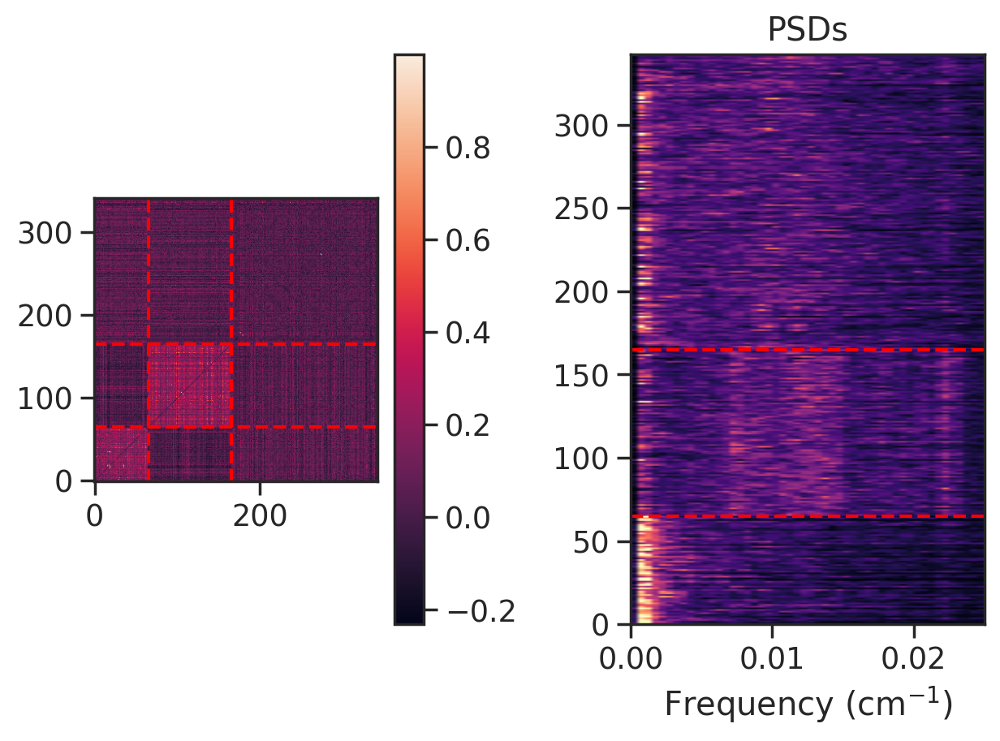

In [ ]:
# These first two are most sensitive, try different values
k=3 # max num clusters
n_trialsperseg=20
n_trialsoverlap=10

nperseg=n_trialsperseg*L//spatial_bin  # spectrogram resolution (higher means )
noverlap=n_trialsoverlap*L//spatial_bin
# noverlap = n_trialsperseg // 6

# Make sure to set these to the dark block!! (depends on recording)
# start_trial = trial_starts[0]
# end_trial = trial_starts[1]

start_trial=0
end_trial=80

sigma=2/spatial_bin
smooth_times=1
flattened_maps = np.copy(raw_maps).reshape(N, -1)

for smooth_time in range(smooth_times):
  flattened_maps = gaussian_filter1d(flattened_maps, sigma)

mean = np.expand_dims(np.nanmean(flattened_maps, axis=1), axis=1)
std = np.expand_dims(np.nanstd(flattened_maps, axis=1), axis=1)
std[std==0] = 1
zmaps = (((flattened_maps-mean)/std).reshape(N, raw_maps.shape[1], -1))

dat = np.copy(zmaps)

# maps_bin = (raw_maps > 0).astype(int)
# dat = np.copy(maps_bin)

# Thes
min_freq = 1/1000   # cm^-1
max_freq = 1/40 # cm^-1

# # int freq
# min_freq = 1/600   # cm^-1
# max_freq = 1/50 # cm^-1

# # high freq
# min_freq = 1/150  # cm^-1
# max_freq = 1/30 # cm^-1

# # low freq
# min_freq = 1/1000  # cm^-1
# max_freq = 1/100 # cm^-1

# min_freq = min_freq * spatial_bin
# max_freq = max_freq * spatial_bin

# Spectrograms
Sxs = []
phase_grams = []
for mp in dat:
    # f,t,Sxx = spectrogram(mp.ravel(),nperseg=nperseg)
    # _,_,phase_gram = spectrogram(mp.ravel(),nperseg=nperseg,mode='angle')
    f,t,Sxx = spectrogram(mp.ravel(),nperseg=nperseg,noverlap=noverlap, fs=1/spatial_bin)
    _,_,phase_gram = spectrogram(mp.ravel(),nperseg=nperseg,mode='angle',noverlap=noverlap, fs=1/spatial_bin)

    Sxs.append(Sxx[(min_freq<f)*(f<max_freq)])
    phase_grams.append(phase_gram[(min_freq<f)*(f<max_freq)])
phase_grams = np.stack(phase_grams).T
Sxs = np.stack(Sxs)
Sxs /= (np.linalg.norm(Sxs,axis=1,keepdims=True)+1e-5)
Sxs = np.nan_to_num(Sxs)
fvalid = f[(min_freq<f)*(f<max_freq)]
cutoff_idx = np.where(min_freq<f)[0][0]
# Neuron x neuron spectrogram similarity matrix in dark
# dark_idxs = np.where((t/L>start_trial)*(t/L<end_trial))
# dark_idxs = np.concatenate([np.where(t/L<trial_starts[0])[0],
#                             np.where(t/L>trial_starts[-2])[0]])
dark_idxs = np.concatenate([np.where((t/L>start_trial)*(t/L<end_trial))[0]])
RR = np.corrcoef(Sxs[:,:,dark_idxs].reshape(N,-1))
np.fill_diagonal(RR,0)

# Cluster by spectrograms
kmeans = KMeans(n_clusters=k)
kmeans.fit(Sxs[:,:,dark_idxs].reshape(N,-1))
counts = [np.sum(kmeans.labels_==i) for i in range(k)]
sort = np.argsort(kmeans.labels_)

# Keep only the modules w high similarity in the dark
avg_corrs = []
for mi in range(k):
    grid_cell_idxs = np.where(kmeans.labels_==mi)[0]
    avg_corrs.append(RR[grid_cell_idxs][:,grid_cell_idxs].mean())
avg_corrs = np.stack(avg_corrs)
module_idxs = np.where(avg_corrs>0.15)[0] # lower this 0.20 threshold if not getting any grid cells
print('Keeping {} of {} modules'.format(len(module_idxs),k))
kvalid = len(module_idxs)

# PSDs
from scipy.signal import welch
PSDs = []

for mp in dat[:,start_trial:end_trial,:].reshape(N,-1):
#for mp in maps[:,trials_use].reshape(N,-1):
    # f,Pxx = welch(mp,fs=1/spatial_bin)
    f,Pxx = welch(mp,nperseg=nperseg,fs=1/spatial_bin)

    PSDs.append(Pxx)
PSDs = np.stack(PSDs)
PSDs /= (np.linalg.norm(PSDs,axis=-1,keepdims=True)+1e-5)
PSDs = np.nan_to_num(PSDs)

plt.subplot(121)
plt.imshow(RR[sort][:,sort],origin='lower')
for i in np.cumsum(counts)[:-1]:
    plt.axvline(i,c='red',linestyle='dashed')
    plt.axhline(i,c='red',linestyle='dashed')
plt.colorbar()

plt.subplot(122)
plt.imshow(PSDs[sort][:,f<max_freq],aspect='auto',extent=(0,max_freq,0,N),
           cmap='magma',vmax=0.5,origin='lower')
for i in np.cumsum(counts)[:-1]:
    plt.axhline(i,c='red',linestyle='dashed')
plt.title('PSDs')
plt.xlabel(r'Frequency (cm$^{-1}$)');
plt.tight_layout()
# for i in range(1,8):
#   plt.axvline(i/L,c='red',linestyle='dashed',linewidth=1)

In [ ]:
all_grid_cell_idxs_list = []
Ng_per_mod = []
mi_per_mod = []
for grid_module in range(len(module_idxs)):
  mi = module_idxs[grid_module]
  grid_cell_idxs = np.where(kmeans.labels_==mi)[0]
  all_grid_cell_idxs_list.append(grid_cell_idxs)
  Ng_per_mod.append(grid_cell_idxs.shape[0])
  mi_per_mod.append(module_idxs[grid_module])

all_grid_cell_idxs = np.hstack(all_grid_cell_idxs_list)
Ng_per_mod = np.array(Ng_per_mod)
mi_per_mod = np.array(mi_per_mod)

In [ ]:
# mi = module_idxs[-1]
mi=mi_per_mod[np.argmax(Ng_per_mod)]
grid_cell_idxs = np.where(kmeans.labels_==mi)[0]
# demo_grid_cell_idxs = grid_cell_idxs
Ng = len(grid_cell_idxs)
print(f'{Ng} grid cells')
# 0 = 14, 50.4
# 1 = 13, 95.4
# 2 = 6, 86.1
# 3 = 12, 102.1
# 4 = 10, 123.0

100 grid cells


In [ ]:
# grid_cell_idxs = all_grid_cell_idxs
grid_cell_idxs

array([  0,   3,   4,   5,   7,  10,  17,  25,  27,  30,  32,  34,  35,
        37,  42,  43,  45,  46,  48,  49,  50,  51,  54,  61,  62,  64,
        65,  68,  71,  73,  76,  80,  88,  93,  97,  99, 100, 102, 104,
       107, 108, 109, 110, 112, 115, 117, 118, 120, 130, 136, 137, 142,
       144, 145, 148, 151, 152, 153, 154, 155, 161, 162, 164, 170, 172,
       173, 175, 176, 177, 180, 182, 183, 185, 186, 198, 204, 206, 208,
       209, 212, 217, 219, 220, 222, 223, 224, 226, 228, 240, 246, 250,
       251, 255, 257, 258, 264, 267, 296, 317, 319])

# Grid cells

scale=39.33563772268565


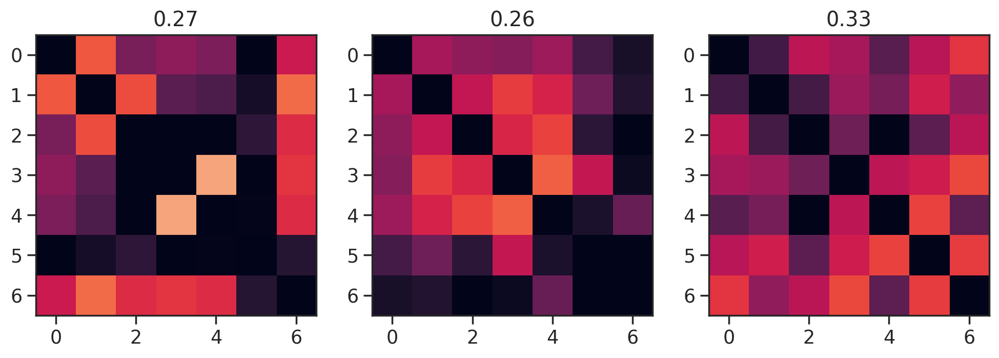

In [ ]:
Ng = len(grid_cell_idxs)
S = Sxs[grid_cell_idxs].mean(0).reshape(-1,len(t)).T
# S = Sxs[grid_cell_idxs]
# S = S[:,:,dark_idxs].mean(0).T

peak1s = []
peak2s = []
peak3s = []
f1s = []
f2s = []
f3s = []
phi1s,phi2s,phi3s = [],[],[]
colinearity_scores = []
for phase_gram,s in zip(phase_grams,S):
    peaks, props = find_peaks(s,distance=1)
    proms,_,_ = peak_prominences(s, peaks)
    top_peaks = peaks[np.argsort(proms)][-2:]
    if len(top_peaks)>0:
        peak1,peak2 = np.min(top_peaks),np.max(top_peaks)
        if peak1+peak2+cutoff_idx >= len(fvalid):
            peak3 = np.abs(peak1-peak2)-cutoff_idx
        elif np.abs(peak1-peak2)-cutoff_idx < 0:
            peak3 = peak1+peak2+cutoff_idx
        else:
            peak3_options = [peak1+peak2+cutoff_idx,np.abs(peak1-peak2)-cutoff_idx]
            peak3 = peak3_options[np.argmax(s[peak3_options])]
        peak1s.append(peak1)
        peak2s.append(peak2)
        peak3s.append(peak3)
        f1s.append(fvalid[peak1])
        f2s.append(fvalid[peak2])
        f3s.append(fvalid[peak3])
        phi1s.append(phase_gram[peak1])
        phi2s.append(phase_gram[peak2])
        phi3s.append(phase_gram[peak3])
        uniq_peaks = np.unique([peak1,peak2,peak3])
        colinearity_scores.append(100*(s[uniq_peaks]**2).sum()/(s**2).sum())
    else:
        peak1s.append(np.nan)
        peak2s.append(np.nan)
        peak3s.append(np.nan)
        f1s.append(np.nan)
        f2s.append(np.nan)
        f3s.append(np.nan)
        phi1s.append(np.nan)
        phi2s.append(np.nan)
        phi3s.append(np.nan)
        colinearity_scores.append(np.nan)
f1s = np.stack(f1s)
f2s = np.stack(f2s)
f3s = np.stack(f3s)
phi1s = np.stack(phi1s)
phi2s = np.stack(phi2s)
phi3s = np.stack(phi3s)

phi1_dark = phi1s[dark_idxs][:,grid_cell_idxs]
phi1_dark = (phi1_dark - circ_mean(phi1_dark,axis=-1,keepdims=True))%(2*np.pi)
phi2_dark = phi2s[dark_idxs][:,grid_cell_idxs]
phi2_dark = (phi2_dark - circ_mean(phi2_dark,axis=-1,keepdims=True))%(2*np.pi)
phi3_dark = phi3s[dark_idxs][:,grid_cell_idxs]
phi3_dark = (phi3_dark - circ_mean(phi3_dark,axis=-1,keepdims=True))%(2*np.pi)

xy1 = np.hstack([np.cos(phi1_dark),np.sin(phi1_dark)])
xy2 = np.hstack([np.cos(phi2_dark),np.sin(phi2_dark)])
xy3 = np.hstack([np.cos(phi3_dark),np.sin(phi3_dark)])
xy = [xy1,xy2,xy3]

kmeans_phases = KMeans(n_clusters=3)
kmeans_phases.fit(np.vstack(xy))
labels = np.stack(np.split(kmeans_phases.labels_,3)).T

phi_all = [phi1_dark,phi2_dark,phi3_dark]

phi1_hat = []
fs_all = [f1s,f2s,f3s]
fs = {}
phis = {}
for j in range(3):
    phis[j] = []
    fs[j] = []
for i in range(len(dark_idxs)):
    for j in range(3):
        label = np.where(labels[i]==j)[0]
        if len(label)>0:
            phis[j].append(phi_all[label[0]][i])
            fs[j].append(fs_all[label[0]][i])
        else:
            min_label = ((np.stack(xy)[:,i] - kmeans_phases.cluster_centers_[j])**2).sum(-1).argmin()
            fs[j].append(fs_all[min_label][i])
            phis[j].append(phi_all[min_label][i])
#             fs[j].append(np.nan)

for j in range(3):
    phis[j] = np.stack(phis[j])
    fs[j] = np.stack(fs[j])

scale = 1/np.sqrt(fs[0]**2+fs[1]**2+fs[2]**2)
angle = np.arcsin(np.sqrt(3)*scale/2*fs[0])

phases_all = []
plt.figure(figsize=(12,4))
for j in range(3):
    plt.subplot(1,3,j+1)
    r = np.corrcoef(np.sin(phis[j]))
    np.fill_diagonal(r,0)
    phases_all.append(circ_mean(phis[j][r.max(0)>0.5],axis=0))
    plt.imshow(r,vmin=0,vmax=1)
    plt.title('{:.2f}'.format(np.mean(r)))

phases1,phases2,phases3 = phases_all
print(f'scale={np.mean(scale)}')


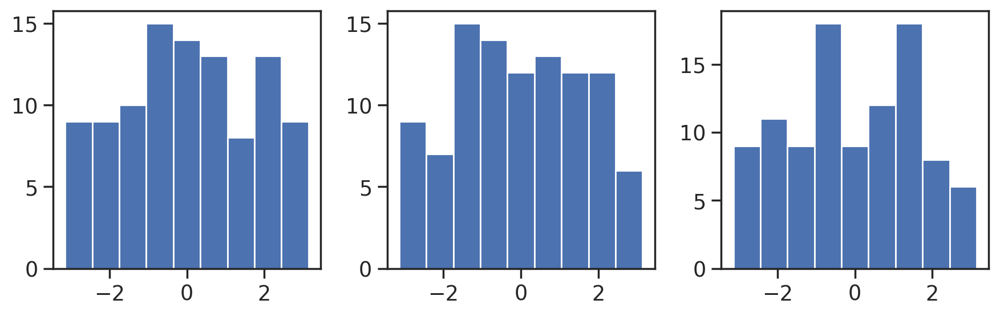

In [ ]:
plt.figure(figsize=(9,3))
plt.subplot(1,3,1)
h=plt.hist(phases1,bins=np.linspace(-np.pi,np.pi,10))
plt.subplot(1,3,2)
h=plt.hist(phases2,bins=np.linspace(-np.pi,np.pi,10))
plt.subplot(1,3,3)
h=plt.hist(phases3,bins=np.linspace(-np.pi,np.pi,10))
plt.tight_layout()

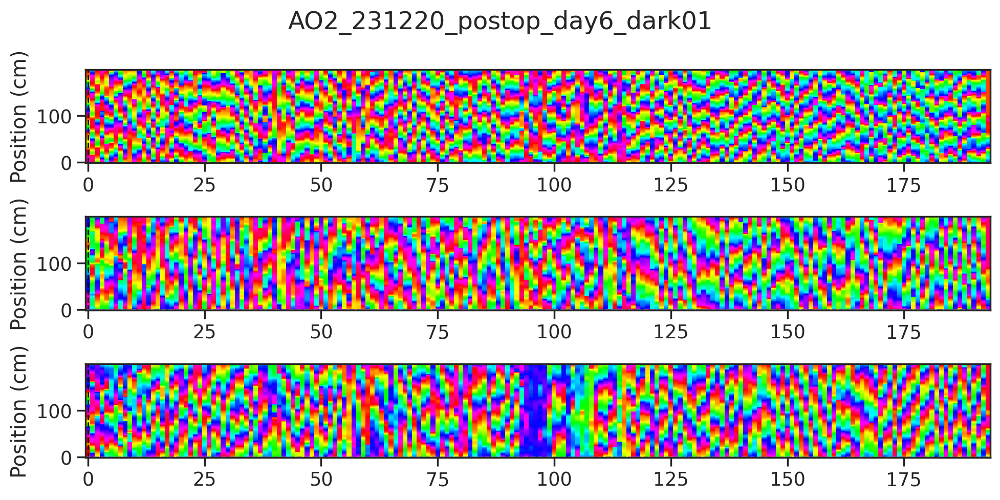

In [ ]:
zscore_by_block = False
interp_maps = True
sigma = 2.5
n_smooth_times = 2

if zscore_by_block:
  maps = np.zeros((N, n_trials, L))
  # zscore by block
  for b in range(n_blocks):
    block_trials = np.arange(trial_starts[b], trial_starts[b+1])

    if np.all(block_trials < n_trials):
      n_block_trials = len(block_trials)
      # flattened_maps = shifted_maps[:, block_trials, :].reshape(N, -1)
      flattened_maps = raw_maps[:, block_trials, :].reshape(N, -1)
      for smooth_idx in range(n_smooth_times):
        flattened_maps = gaussian_filter1d(flattened_maps, sigma, axis=-1)

      mean = np.expand_dims(np.nanmean(flattened_maps, axis=1), axis=1)
      std = np.expand_dims(np.nanstd(flattened_maps, axis=1), axis=1)
      std[std==0] = 1 # hack to deal with divide by 0 issues
      # maps = ((flattened_maps - mean)/std).reshape(N, trial_starts[1], -1)
      maps[:, block_trials, :] = ((flattened_maps - mean)/std).reshape(N, n_block_trials, -1)
else:
  flattened_maps = raw_maps.reshape(N, -1)
  # flattened_maps = shifted_maps.reshape(N, -1)
  flattened_maps = gaussian_filter1d(flattened_maps, sigma, axis=-1)
  mean = np.expand_dims(np.nanmean(flattened_maps, axis=1), axis=1)
  std = np.expand_dims(np.nanstd(flattened_maps, axis=1), axis=1)
  std[std==0] = 1 # hack to deal with divide by 0 issues
  # maps = ((flattened_maps - mean)/std).reshape(N, trial_starts[1], -1)
  maps = ((flattened_maps - mean)/std).reshape(N, n_trials, -1)

if interp_maps:
  interp_rate = spatial_bin
  interp_maps = np.zeros((N, n_trials, L*interp_rate))
  interp_bins = np.arange(0, n_trials*L, 1/interp_rate)
  original_bins = np.arange(0, n_trials*L)
  for c in range(N):
    interp_maps[c, :, :] = (np.interp(interp_bins, original_bins, maps[c, :, :].reshape(-1))).reshape(n_trials, -1)
  maps = interp_maps
else:
  interp_rate = 1

plt.figure(figsize=(10,5))

vr_maps = maps[grid_cell_idxs].reshape(Ng,-1)
n_trials_per_period = 1
# vr_maps = demo_zmaps[grid_cell_idxs].reshape(Ng,-1)

all_angles = []

all_u = []
all_v = []

for i,phases in enumerate(phases_all):
  plt.subplot(3,1,i+1)
  u = np.cos(phases)@vr_maps
  v = np.sin(phases)@vr_maps

  u = u.reshape(-1,n_trials_per_period*maps.shape[2])
  v = v.reshape(-1,n_trials_per_period*maps.shape[2])

  angle = np.arctan2(v,u)
  all_angles.append(angle)

  all_u.append(u)
  all_v.append(v)

  plt.pcolormesh(np.arange(n_trials//n_trials_per_period),np.arange(n_trials_per_period*maps.shape[2]),angle.T,cmap='hsv',)
  # plt.pcolormesh(np.arange(n_trials//n_trials_per_period),np.arange(n_trials_per_period*L*2),angle.T,cmap='hsv',)


  plt.ylabel('Position (cm)')

  for j,trial in enumerate(trial_starts[:-1]):
    plt.axvline(trial//n_trials_per_period,c='black',linestyle='dashed',linewidth=1)


  # Plot landmarks
  for j in range(len(landmark_positions)):
    for a,lm in enumerate(landmark_positions[j]):
      plt.axhline(lm,trial_starts[j]/(n_trials*n_trials_per_period),
                  trial_starts[j+1]/(n_trials*n_trials_per_period),
                  c='C'+str(a),linewidth=1,linestyle='dashed')
      # plt.axhline(lm,trial_starts[j]/(2*n_trials),
      #       trial_starts[j+1]/(2*n_trials),
      #       c='C'+str(a),linewidth=1,linestyle='dashed')

plt.suptitle(fname)
plt.tight_layout()

all_angles = np.stack(all_angles)
all_u = np.stack(all_u)
all_v = np.stack(all_v)

# Neural sheet

In [ ]:
flip_fr = False
g_fr = np.zeros((grid_cell_idxs.shape[0], new_post.shape[0]-1))
t_bin_smooth = 2
for g in np.arange(grid_cell_idxs.shape[0]):
# for g in range(1):

  this_g = cells_to_plot[grid_cell_idxs[g]]
  # find all spike times associated with this cell in cids
  spike_times_this_g=spt[np.where(clu==this_g)[0]]
  g_fr[g,:]=gaussian_filter(np.divide(np.histogram(spike_times_this_g, bins=new_post)[0], new_t), t_bin_smooth)

g_fr = zscore(g_fr, axis=1)

if flip_fr:
  g_fr = np.fliplr(g_fr)
  new_posx_lin_old = np.copy(new_posx_lin)
  new_posx_old = np.copy(new_posx)
  new_posx_lin = np.flipud(new_posx_lin)*-1 + np.max(new_posx_lin)
  new_posx = np.flipud(new_posx)*-1 + np.max(new_posx)


In [ ]:
# plt.plot(g_fr[5,])

In [ ]:
# 100000*0.02

In [ ]:
# plt.plot(posx[6200:8000])

In [ ]:
# post[8000]
#124s-160s pause

In [ ]:
# plt.plot(new_posx)

In [ ]:
# plt.plot(new_posx_lin[4250:4750])


In [ ]:
# 8000-6200

In [ ]:
# np.where(new_post>124)[0]

In [ ]:
# plt.plot(new_posx_lin[240:400])

In [ ]:
# from scipy.interpolate import LinearNDInterpolator
# from scipy.ndimage import gaussian_filter
# from matplotlib.ticker import FormatStrFormatter

# save_dir = '/content/drive/MyDrive/Bump video/dark5'

# # maps_linearized = maps[grid_cell_idxs[:resx*resy]].reshape(resx*resy, -1)
# maps_linearized = g_fr[:resx*resy,:].reshape(resx*resy, -1)

# spatial_window = 2
# n_windows = 1000
# n_skip = 1
# sigma1 = 1.5
# sigma2 = 1.5
# n_rows = int(np.ceil(np.sqrt(n_windows)))
# start_frame=4250+676

# # start_frame=220
# # plt.figure(figsize=(n_rows,n_rows))

# pid = 0
# for i in np.arange(1):
#   # plt.subplot(n_rows, n_rows, i+1)

#   plt.figure(figsize=(20,10))

#   start = i*n_skip+start_frame
#   dat = maps_linearized[:, start:start+spatial_window]

#   dat = dat.mean(1)
#   rm = zscore(dat, axis=0)
#   im = rm[gridsort].reshape(resx,resy)

#   im_weak=0.75*im
#   im_exp_full=np.tile(im_weak,(3,3))
#   im_exp_full[resx:2*resx,resx:2*resx]=im
#   # for i in range(3*resx):
#   #   im_exp_full[i]=np.roll(im_exp_full[i],-i)

#   im_exp_full_smooth = gaussian_filter(im_exp_full, (sigma1, sigma2))
#   im=im_exp_full_smooth[resx:2*resx,resx:2*resx]
#   im=zscore(im.reshape(-1)).reshape(resx,resy)

#   U = np.linspace(np.min(u.reshape(-1)), np.max(u.reshape(-1)), 100)
#   V = np.linspace(np.min(v.reshape(-1)), np.max(v.reshape(-1)), 100)

#   U, V = np.meshgrid(U, V)  # 2D grid for interpolation
#   interp = LinearNDInterpolator(list(zip(u.reshape(-1), v.reshape(-1))), im.reshape(-1))
#   Z = interp(U, V)
#   # plt.pcolormesh(U, V, Z, shading='auto')

#   ax=plt.subplot(1,2,1)
#   plt.pcolormesh(U, V, Z, shading='auto')
#   # plt.axis('off')
#   ax.spines[['left','top','right','bottom']].set_visible(False)
#   plt.text(1.85, 0.77, 'Grid Axis 1',fontsize=20)
#   plt.text(1.45, 1.2, 'Grid Axis 2', rotation=69,fontsize=20)
#   plt.xticks([])
#   plt.yticks([])


#   ax = plt.subplot(1,2,2)
#   dat=new_posx_lin[start_frame:start_frame+i+1]-new_posx_lin[start_frame]
#   plt.plot(np.linspace(0,0.5*dat.shape[0],dat.shape[0]), dat, 'k*-', linewidth=5, ms=20)
#   if i >= 10:
#     # if np.mod(i-9, 5)==0:
#     #   plt.xlim([(i-9)/2.5+0.001, (i+1)/2.5+0.001])
#     # else:
#     #   plt.xlim([(i-9)/2.5, (i+1)/2.5])
#     # xl0 = (i-9)/2.5
#     # xlm = ((i-9+i+1)/2)/2.5
#     plt.xlim([i/2+0.5-5, i/2+0.5])
#     xl0 = i/2+0.5-5
#     xlm = (i/2+0.5-5 + i/2+0.5)/2
#     plt.xticks(np.arange(xl0, xl0+5.5, 1))
#     # Create a custom formatter
#     formatter = plt.FuncFormatter(lambda x, pos: f'{x:04.1f}')

#     # Apply the formatter to the x-axis
#     plt.gca().xaxis.set_major_formatter(formatter)
#     # ax.xaxis.set_major_formatter(FormatStrFormatter('%.1f'))

#     # plt.xlim(0.5*(dat.shape[0])-4, 0.5*(dat.shape[0]))
#     # xl0 = 0.5*(dat.shape[0])-4
#     # xlm = (0.5*(dat.shape[0])-4 + 0.5*(dat.shape[0]))/2

#   else:
#     plt.xlim([0, 10/2])
#     ax.xaxis.set_major_formatter(FormatStrFormatter('%.1f'))
#     xl0=0
#     xlm=5/2
#     formatter = plt.FuncFormatter(lambda x, pos: f'{x:04.1f}')

#     # Apply the formatter to the x-axis
#     plt.gca().xaxis.set_major_formatter(formatter)

#   if dat[-1]>80:
#     max_val = np.ceil(dat[-1]/10) * 10
#     plt.ylim([max_val-80, max_val])
#     mp = (max_val-80 + max_val)/2
#     yl0 = max_val-80
#   else:
#     plt.ylim([0, 80])
#     mp=40
#     yl0 = 0

#   plt.text(xlm, yl0-7.5, 'Time (s)', fontsize=20, horizontalalignment='center', verticalalignment='top')
#   plt.text(xl0-0.5, mp, 'Position (cm)', fontsize=20, rotation=90, verticalalignment='center')
#   plt.xticks(fontsize=16)
#   plt.yticks(fontsize=16)
#   plt.tight_layout()

#   # Hide the right and top spines
#   ax.spines[['right', 'top']].set_visible(False)



#   # plt.savefig(os.path.join(save_dir,f'{pid:03d}.png'), dpi=50)
#   # plt.close()
#   # pid += 1


In [ ]:
# plt.plot(all_angles_smooth_norm[0,:])


In [ ]:
# plt.plot(new_posx)

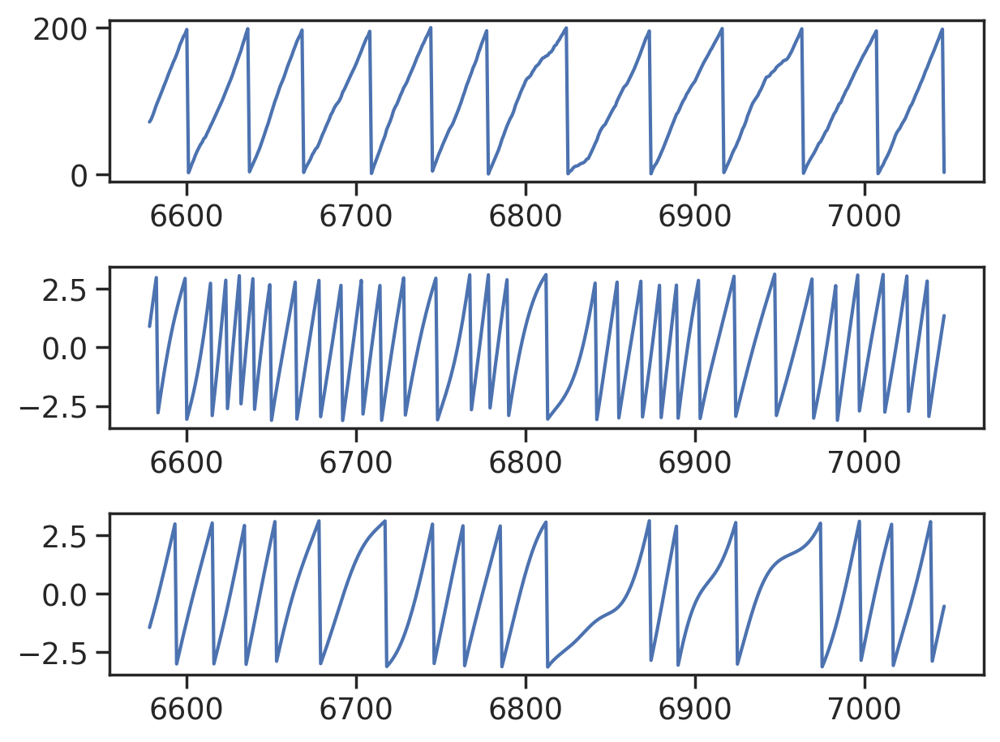

In [ ]:
# bins_plot = np.arange(550, 550+625)
# bins_plot = np.arange(7204-550-625, 7204-550)
bins_plot = np.arange(6578, 6578+470)

plt.subplot(3,1,1)
plt.plot(bins_plot, new_posx[bins_plot])
plt.subplot(3,1,2)
plt.plot(bins_plot, all_angles_smooth[phase1_use, bins_plot])
plt.subplot(3,1,3)
plt.plot(bins_plot, all_angles_smooth[phase2_use, bins_plot])

plt.tight_layout()

In [ ]:
print(f'{discs_smooth[phase1_use].shape[0]}')
print(f'{discs_smooth[phase2_use].shape[0]}')

309
238


In [ ]:
# discs_smooth[phase1_use]
# # 6044

In [ ]:
# discs_smooth[phase2_use]
# # 6048

In [ ]:
# from scipy.interpolate import LinearNDInterpolator
# from scipy.ndimage import gaussian_filter
# from matplotlib.ticker import FormatStrFormatter

# save_dir = '/content/drive/MyDrive/Bump video/dark5'

# # maps_linearized = maps[grid_cell_idxs[:resx*resy]].reshape(resx*resy, -1)
# maps_linearized = g_fr[:resx*resy,:].reshape(resx*resy, -1)

# spatial_window = 2
# n_windows = 25
# n_skip = 1
# sigma1 = 1.5
# sigma2 = 1.5
# n_rows = int(np.ceil(np.sqrt(n_windows)))
# # start_frame=7204-550-625
# start_frame=6030


# plt.figure(figsize=(n_rows*1.5,n_rows*1.5))

# pid = 0
# for i in np.arange(n_windows):
#   plt.subplot(n_rows, n_rows, i+1)

#   start = i*n_skip+start_frame
#   dat = maps_linearized[:, start:start+spatial_window]

#   dat = dat.mean(1)
#   rm = zscore(dat, axis=0)
#   im = rm[gridsort].reshape(resx,resy)

#   im_weak=0.75*im
#   im_exp_full=np.tile(im_weak,(3,3))
#   im_exp_full[resx:2*resx,resx:2*resx]=im
#   # for i in range(3*resx):
#   #   im_exp_full[i]=np.roll(im_exp_full[i],-i)

#   im_exp_full_smooth = gaussian_filter(im_exp_full, (sigma1, sigma2))
#   im=im_exp_full_smooth[resx:2*resx,resx:2*resx]
#   im=zscore(im.reshape(-1)).reshape(resx,resy)

#   U = np.linspace(np.min(u.reshape(-1)), np.max(u.reshape(-1)), 50)
#   V = np.linspace(np.min(v.reshape(-1)), np.max(v.reshape(-1)), 50)

#   U, V = np.meshgrid(U, V)  # 2D grid for interpolation
#   interp = LinearNDInterpolator(list(zip(u.reshape(-1), v.reshape(-1))), im.reshape(-1))
#   Z = interp(U, V)
#   # plt.pcolormesh(U, V, Z, shading='auto')

#   plt.pcolormesh(U, V, Z, shading='auto')
#   plt.gca().set_axis_off()
#   plt.title(f'{start}', fontsize=6)

#   # plt.savefig(os.path.join(save_dir,f'{pid:03d}.png'), dpi=50)
#   # plt.close()
#   # pid += 1


In [ ]:
# if cross over: add one more set to the other side and leave it there for plotting.
# original one must be decreased too

In [ ]:
# 6061-6043

In [ ]:
# all_angles_smooth_norm[phase1_use, 6040]

In [ ]:
# all_angles_smooth_norm.shape

In [3]:
matplotlib.use('agg')
# %matplotlib inline


In [ ]:
# WILL JUST START WITH 3 COPIES OF THE SHEET

from scipy.interpolate import LinearNDInterpolator
from scipy.ndimage import gaussian_filter
from matplotlib.ticker import FormatStrFormatter


# maps_linearized = maps[grid_cell_idxs[:resx*resy]].reshape(resx*resy, -1)
new_posx_lin_smooth = gaussian_filter(new_posx_lin, 5)
maps_linearized = g_fr[:resx*resy,:].reshape(resx*resy, -1)

spatial_window = 2
n_windows = 470
# n_windows = 1

# n_windows = 100

n_skip = 1
sigma1 = 2
sigma2 = 1.5
n_rows = int(np.ceil(np.sqrt(n_windows)))

formatter = plt.FuncFormatter(lambda x, pos: f'{x:03.0f}')
yformatter = plt.FuncFormatter(lambda x, pos: f'{x:04.0f}')
yformatter2 = plt.FuncFormatter(lambda x, pos: f'{x:2.0f}')

dpi_val=300
base_save_dir = '/content/drive/MyDrive/Bump video/copies/'
copy_vals = np.array([1, 3, 25])

for max_i in np.arange(copy_vals.shape[0]):
  n_max_copies = copy_vals[max_i]
  # n_max_copies = max_i * np.power(2, max_i) + 1
  # if max_i == 0:
  #   n_max_copies = 1
  # elif max_i == 1:
  #   n_max_copies = 3
  # else:
  #   n_max_copies = 5

  # if n_max_copies == 1:
  #   save_dir = '/content/drive/MyDrive/Bump video/one_copy_2'
  # elif n_max_copies == 3:
  #   save_dir = '/content/drive/MyDrive/Bump video/three_copies_2'
  # elif n_max_copies == 5:
  #   save_dir = '/content/drive/MyDrive/Bump video/five_copies_2'

  save_dir = base_save_dir + f'{n_max_copies}'

  if os.path.isdir(save_dir):
    abc=1
  else:
    os.mkdir(save_dir)
  # start_frame=7204-550-625
  # start_frame=6040+522
  # start_frame=6578
  # start_frame=6578
  start_frame=0
  n_windows=7000

  # plt.figure(figsize=(n_rows*1.5,n_rows*1.5))

  pid = 0
  phase1_copy_idx = 1
  phase2_copy_idx = 1
  current_yrange = 6400
  current_xrange = 240

  if start_frame==0:
    current_yrange = (np.round(np.max(new_posx_lin_smooth)/100))*100
    current_xrange = 3600
    yl2 = np.max(np.diff(new_posx_lin_smooth) * 2)
  else:
    yl2 = np.round(np.max(np.diff(new_posx_lin_smooth[start_frame:start_frame+n_windows])))

  for i in np.arange(n_windows):
    # plt.subplot(n_rows, n_rows, i+1)
    # fig, ax = plt.subplots(1,3, figsize=(24,8))

    plt.figure(figsize=(24,8))

    start = i*n_skip+start_frame
    dat = maps_linearized[:, start:start+spatial_window]

    dat = dat.mean(1)
    rm = zscore(dat, axis=0)
    im = rm[gridsort].reshape(resx,resy)

    im_weak=1*im
    im_exp_full=np.tile(im_weak,(3,3))
    im_exp_full[resx:2*resx,resx:2*resx]=im

    im_exp_full_smooth = gaussian_filter(im_exp_full, (sigma1, sigma2))

    range = (np.max(im_exp_full_smooth.reshape(-1)) -
            np.min(im_exp_full_smooth.reshape(-1)))

    im_exp_full_smooth = np.divide(im_exp_full_smooth
                                  - np.min(im_exp_full_smooth.reshape(-1)),
                                  range)

    im=im_exp_full_smooth[resx:2*resx,resx:2*resx]

    phase1_copies_added = []
    phase2_copies_added = []
    if start in discs_smooth[phase1_use]:
      if phase1_copy_idx + 1 > n_max_copies:
        phase1_copy_idx = 1
      else:
        phase1_copy_idx += 1

    if start in discs_smooth[phase2_use]:
      if phase2_copy_idx + 1 > n_max_copies:
        phase2_copy_idx = 1
      else:
        phase2_copy_idx += 1

    im_copies = np.tile(im, (n_max_copies, n_max_copies))

    if n_max_copies > 1:
      phase1_val = all_angles_smooth_norm[phase1_use, start]
      phase2_val = all_angles_smooth_norm[phase2_use, start]

      phase1_loc = resx * (phase1_copy_idx-1) + int(np.round(phase1_val*resx))
      phase2_loc = resx * (phase2_copy_idx-1) + int(np.round(phase2_val*resx))

      if phase1_copy_idx == n_max_copies and phase1_val > 0.5:
        phase1_left_thr = int(np.round(phase1_val*resx)) - resx//2
        im_copies[phase1_left_thr:phase1_loc - resx//2, :] = 0

        phase1_right_thr = phase1_loc + resx//2
        im_copies[phase1_right_thr:, :] = 0
      elif phase1_copy_idx == 1 and phase1_val < 0.5:
        phase1_left_thr = phase1_loc + resx//2
        phase1_right_thr = (n_max_copies * resx) - resx // 4
        im_copies[phase1_left_thr:phase1_right_thr, :] = 0
      else:
        phase1_left_thr = phase1_loc - resx//2
        im_copies[0:phase1_left_thr, :] = 0

        phase1_right_thr = phase1_loc + resx//2
        im_copies[phase1_right_thr:, :] = 0

      if phase2_copy_idx == n_max_copies and phase2_val > 0.5:
        phase2_left_thr = int(np.round(phase2_val*resx)) - resx//2
        im_copies[:, phase2_left_thr:phase2_loc - resx//2] = 0

        phase2_right_thr = phase2_loc + resx//2
        im_copies[:, phase2_right_thr:] = 0
      elif phase2_copy_idx == 1 and phase2_val < 0.5:
        phase2_left_thr = phase2_loc + resx//2
        phase2_right_thr = (n_max_copies * resx) - resx // 4
        im_copies[:, phase2_left_thr:phase2_right_thr] = 0
      else:
        phase2_left_thr = phase2_loc - resx//2
        im_copies[:, 0:phase2_left_thr] = 0

        phase2_right_thr = phase2_loc + resx//2
        im_copies[:, phase2_right_thr:] = 0

      im_copies = gaussian_filter(im_copies, (sigma1, sigma2))

    x_copies, y_copies = np.mgrid[:n_max_copies*resx,:n_max_copies*resy]/resy
    u_copies, v_copies = coord_from_phase(x_copies+1,y_copies+1)

    ax=plt.subplot(1,3,1)
    plt.pcolormesh(u_copies, v_copies, im_copies, shading='auto')

    plt.axis('off')
    ax.spines[['left','top','right','bottom']].set_visible(False)
    # plt.text(1.85, 0.71, 'Grid Axis 1',fontsize=20)
    # plt.text(1.45, 1.2, 'Grid Axis 2', rotation=69,fontsize=20)
    plt.xticks([])
    plt.yticks([])


    ax = plt.subplot(1,3,2)
    dat=new_posx_lin_smooth[start_frame:start_frame+i+1]-new_posx_lin_smooth[start_frame]
    plt.plot(np.linspace(0,0.5*dat.shape[0],dat.shape[0]), dat, 'k*-', linewidth=5, ms=15)

    # if i >= 10:
    #   plt.xlim([i/2+0.5-5, i/2+0.5])
    #   xl0 = i/2+0.5-5
    #   xlm = (i/2+0.5-5 + i/2+0.5)/2
    #   plt.xticks(np.arange(xl0, xl0+5.5, 1))

    #   plt.gca().xaxis.set_major_formatter(formatter)
    # else:
    #   plt.xlim([0, 10/2])
    #   xl0=0
    #   xlm=5/2
    #   formatter = plt.FuncFormatter(lambda x, pos: f'{x:04.1f}')

    #   plt.gca().xaxis.set_major_formatter(formatter)
    if 0.5*dat.shape[0] >=current_xrange:
      current_xrange = 2*current_xrange
      # plt.xticks(np.arange(xl0, xl0+5.5, 1))

    plt.xlim([0, current_xrange])
    xl0 = 0
    xlm = current_xrange/2
    num_ticks = 5
    xtick_locations = np.arange(0, current_xrange + 1, current_xrange / (num_ticks - 1))
    plt.xticks(xtick_locations)
    plt.gca().xaxis.set_major_formatter(formatter)

    if dat[-1]>=current_yrange:
      current_yrange = 2*current_yrange
      # max_val = np.ceil(dat[-1]/25) * 25
      # plt.ylim([max_val-200, max_val])
      # mp = (max_val-200 + max_val)/2

      # yl0 = max_val-200
    else:
      # plt.ylim([0, 400])
      # mp=200
      yl0 = 0

    plt.ylim([0, current_yrange])
    yl0=0

    num_ticks = 5
    ytick_locations = np.arange(0, current_yrange + 1, current_yrange / (num_ticks - 1))

    plt.gca().yaxis.set_major_formatter(yformatter)
    plt.xlabel('Time (s)', fontsize=24)
    plt.ylabel('Position (cm)', fontsize=24)
    # plt.text(xlm, yl0-12, 'Time (s)', fontsize=20, horizontalalignment='center', verticalalignment='top')
    # plt.text(xl0-0.75, mp, 'Position (cm)', fontsize=20, rotation=90, verticalalignment='center')
    plt.xticks(fontsize=20)
    plt.yticks(ytick_locations, fontsize=20)
    plt.tight_layout()

    # Hide the right and top spines
    ax.spines[['right', 'top']].set_visible(False)


    ax = plt.subplot(1,3,3)
    dat2=np.diff(new_posx_lin_smooth[start_frame:start_frame+i+2]) * 2
    plt.plot(np.linspace(0,0.5*dat2.shape[0],dat2.shape[0]), dat2, 'k*-', linewidth=5, ms=15)

    # if i >= 10:
    #   plt.xlim([i/2+0.5-5, i/2+0.5])
    #   xl0 = i/2+0.5-5
    #   xlm = (i/2+0.5-5 + i/2+0.5)/2
    #   plt.xticks(np.arange(xl0, xl0+5.5, 1))
    #   plt.gca().xaxis.set_major_formatter(formatter)
    # else:
    #   plt.xlim([0, 10/2])
    #   xl0=0
    #   xlm=5/2
    #   formatter = plt.FuncFormatter(lambda x, pos: f'{x:04.1f}')
    #   plt.gca().xaxis.set_major_formatter(formatter)


    # plt.xticks(np.arange(xl0, xl0+5.5, 1))

    plt.xlim([0, current_xrange])
    xl0 = 0
    xlm = current_xrange/2
    num_ticks = 5
    xtick_locations = np.arange(0, current_xrange + 1, current_xrange / (num_ticks - 1))
    plt.xticks(xtick_locations)
    plt.gca().xaxis.set_major_formatter(formatter)


    plt.ylim([0, yl2])
    num_ticks = 4
    ytick_locations = np.arange(0, yl2+1, yl2 / (num_ticks - 1))
    plt.gca().yaxis.set_major_formatter(yformatter2)
    plt.xlabel('Time (s)', fontsize=24)
    plt.ylabel('Speed (cm/s)', fontsize=24)
    plt.xticks(fontsize=20)
    plt.yticks(ytick_locations, fontsize=20)

    # Hide the right and top spines
    ax.spines[['right', 'top']].set_visible(False)

    plt.suptitle(f'{i}')

    plt.tight_layout()
    if n_windows > 1:
      plt.savefig(os.path.join(save_dir,f'{pid:03d}.png'), dpi=dpi_val)
      # fig.savefig(os.path.join(save_dir,f'{pid:03d}.png'), dpi=dpi_val)
      plt.close()
    pid += 1
    if np.mod(i, 50)==0:
      print(f'{i}')

0
50
100


In [ ]:
# filename = '/content/drive/MyDrive/Bump video/copies/250113_2.pkl'

# dill.dump_session(filename)

In [ ]:
# start_frame=6040+522
start_frame=6578
n_windows=470
plt.plot(new_posx_lin_smooth[start_frame:start_frame+470+1]-new_posx_lin_smooth[start_frame])
plt.title(f'{np.max(new_posx_lin_smooth[start_frame:start_frame+470+1]-new_posx_lin_smooth[start_frame])}')


Text(0.5, 1.0, '2333.7758856617656')

In [ ]:
# start_frame = 6040+518

dat2=np.diff(new_posx_lin_smooth[start_frame:start_frame+n_windows]) * 2
plt.plot(dat2)
plt.title(f'{np.max(dat2)}')

n_factor = 0
diff=np.diff(all_angles_unw_smooth[phase1_use, start_frame+n_factor:start_frame+n_windows+n_factor])
diff2=np.diff(all_angles_unw_smooth[phase2_use, start_frame+n_factor:start_frame+n_windows+n_factor])

plt.plot((diff+diff2)*10)


In [ ]:
# n_windows=5000
# start_frame=1000
# start_frame=start_frame+1000
# n_windows=470
diff=np.diff(all_angles_unw_smooth[phase1_use, start_frame:start_frame+n_windows])
# diff[diff<0] = 0
# diff[np.where(diff==0)[0]] = np.interp(np.where(diff==0)[0],
#                                       np.arange(0, diff.shape[0]), diff)


diff2=np.diff(all_angles_unw_smooth[phase2_use, start_frame:start_frame+n_windows])
# diff2[diff2<0] = 0
# diff2[np.where(diff2==0)[0]] = np.interp(np.where(diff2==0)[0],
#                                         np.arange(0, diff2.shape[0]), diff2)

full_diff = np.sqrt(np.power(diff,2)+np.power(diff2,2))
full_diff = diff+diff2

# plt.plot(full_diff)
# plt.show()
# plt.scatter(np.diff(new_posx_lin_smooth[:-51]), full_diff)

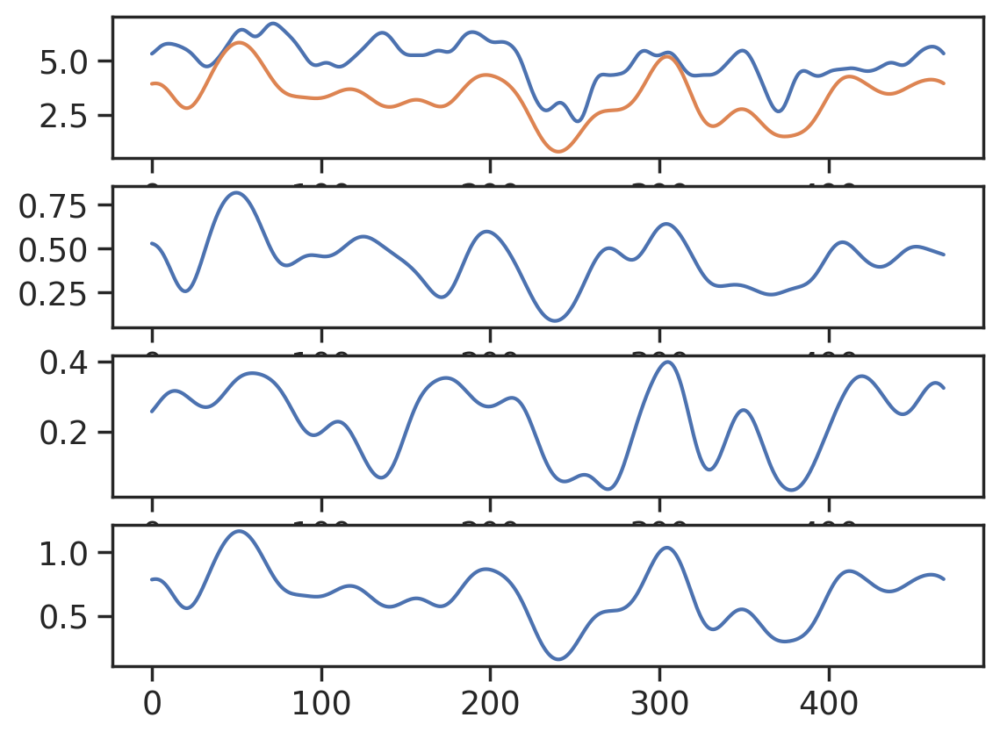

In [ ]:
# new_posx_lin_smooth = gaussian_filter(new_posx_lin, 5)
# %matplotlib ipympl
# matplotlib.use('inline')
plt.subplot(4,1,1)
plt.plot(np.diff(new_posx_lin_smooth[start_frame:start_frame+n_windows]))
plt.plot(np.roll(full_diff,0)*5)

plt.subplot(4,1,2)
plt.plot(diff)
plt.subplot(4,1,3)
plt.plot(diff2)
plt.subplot(4,1,4)
plt.plot(full_diff)


In [ ]:
smooth_factors = np.array([1,2,5])
shift_vals = np.arange(-150,150)
corr_vals = np.zeros((smooth_factors.shape[0], shift_vals.shape[0]))
for s in np.arange(smooth_factors.shape[0]):
  this_smooth_dat = gaussian_filter(new_posx_lin[start_frame:start_frame+n_windows+1], smooth_factors[s])[:-1]

  for t in np.arange(shift_vals.shape[0]):
    # dat1=np.roll(full_diff, shift_vals[t])
    dat_a=diff=np.diff(all_angles_unw_smooth[phase1_use, start_frame+shift_vals[t]:start_frame+n_windows+shift_vals[t]])
    dat_b=diff=np.diff(all_angles_unw_smooth[phase2_use, start_frame+shift_vals[t]:start_frame+n_windows+shift_vals[t]])
    dat1=dat_a+dat_b

    dat2=np.diff(this_smooth_dat)
    corr_vals[s,t] = np.corrcoef(dat1,dat2)[0,1]

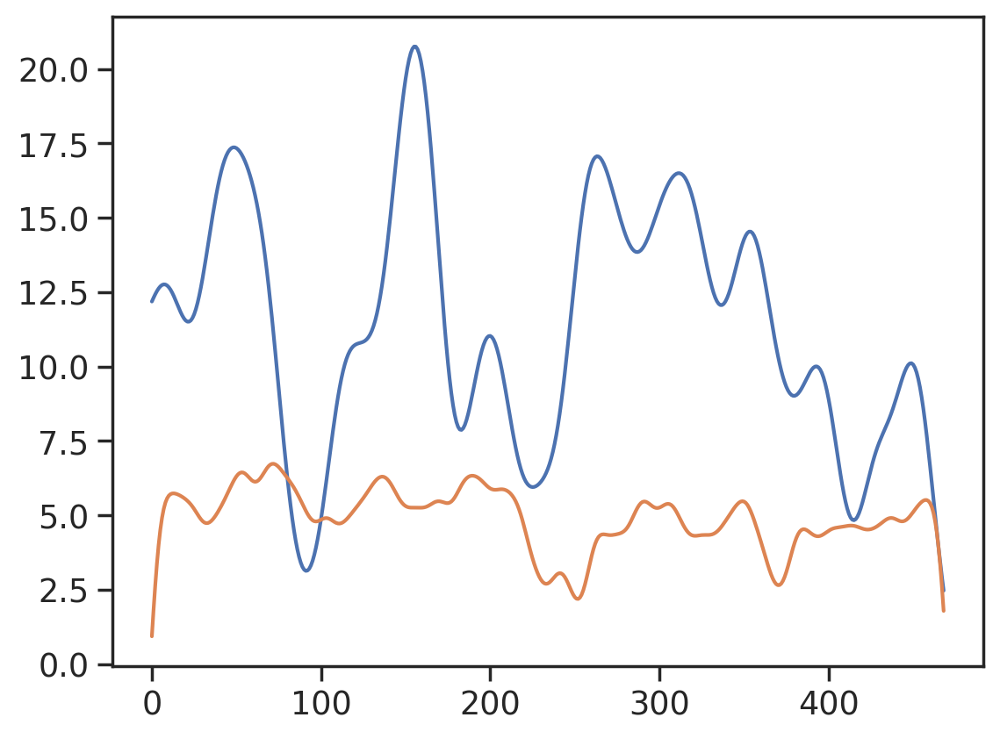

In [ ]:
plt.plot(dat1*20)
plt.plot(dat2)

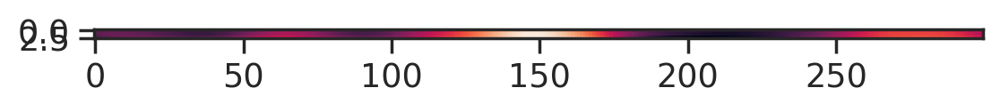

In [ ]:
plt.imshow(corr_vals)

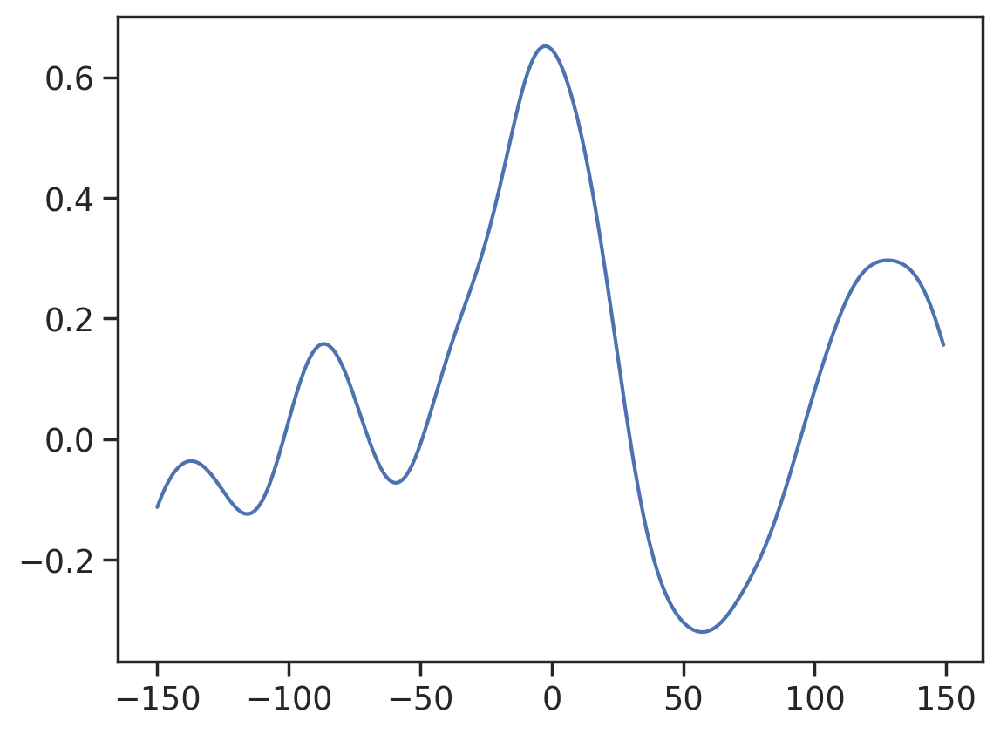

In [ ]:
plt.plot(shift_vals,corr_vals[-1,:])

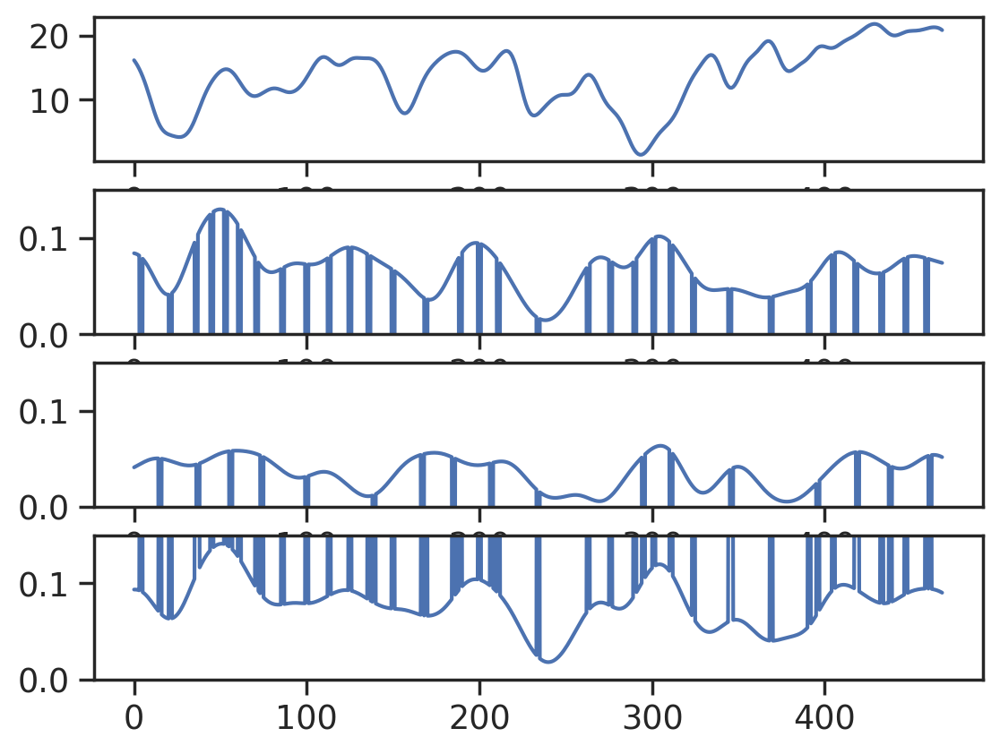

In [ ]:
# new_posx_lin_smooth = gaussian_filter(new_posx_lin, 5)
# %matplotlib ipympl
# matplotlib.use('inline')
plt.subplot(4,1,1)
plt.plot(np.diff(new_posx_lin_smooth[start_frame:start_frame+n_windows]))
plt.subplot(4,1,2)
plt.plot(np.diff(all_angles_smooth_norm[phase1_use, start_frame:start_frame+n_windows]))
plt.ylim([0, 0.15])
plt.subplot(4,1,3)
plt.plot(np.diff(all_angles_smooth_norm[phase2_use, start_frame:start_frame+n_windows]))
plt.ylim([0, 0.15])
plt.subplot(4,1,4)
plt.plot(np.sqrt(
    np.power(np.diff(all_angles_smooth_norm[phase1_use, start_frame:start_frame+n_windows]),2) +
    np.power(np.diff(all_angles_smooth_norm[phase2_use, start_frame:start_frame+n_windows]),2)))
plt.ylim([0, 0.15])
plt.show()

In [ ]:
zz=[]
for t in np.arange(-25,25):
  zz.append(np.corrcoef(np.diff(new_posx_lin_smooth[6040+t:6040+501+t]), full_diff[6040:6040+500])[0,1])


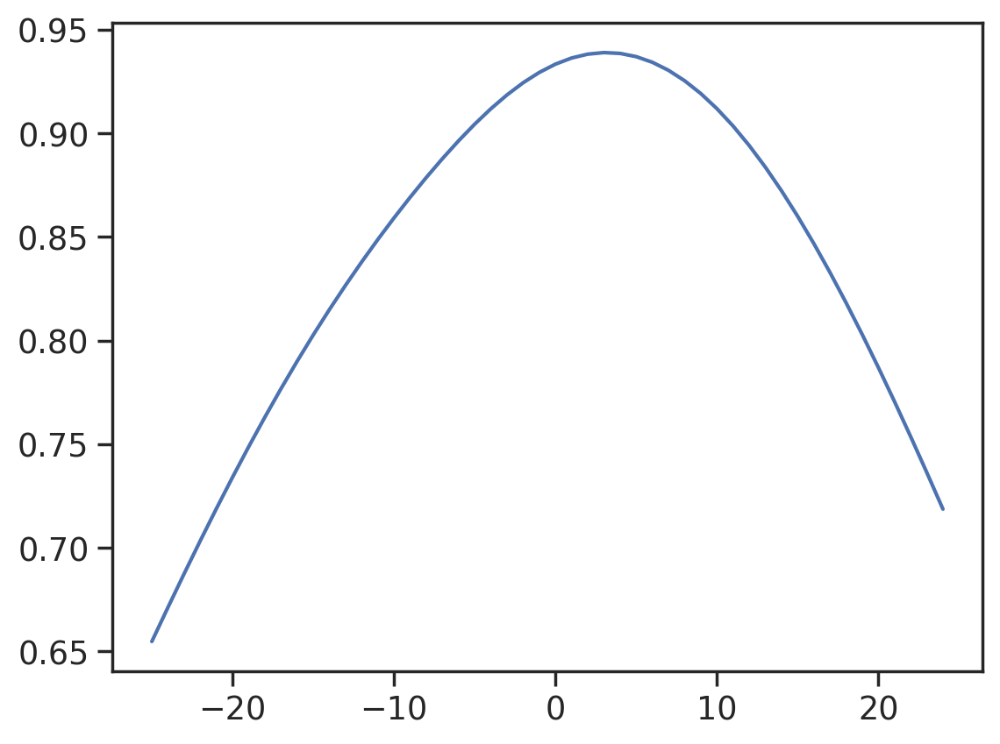

In [ ]:
plt.plot(np.arange(-25,25),zz)

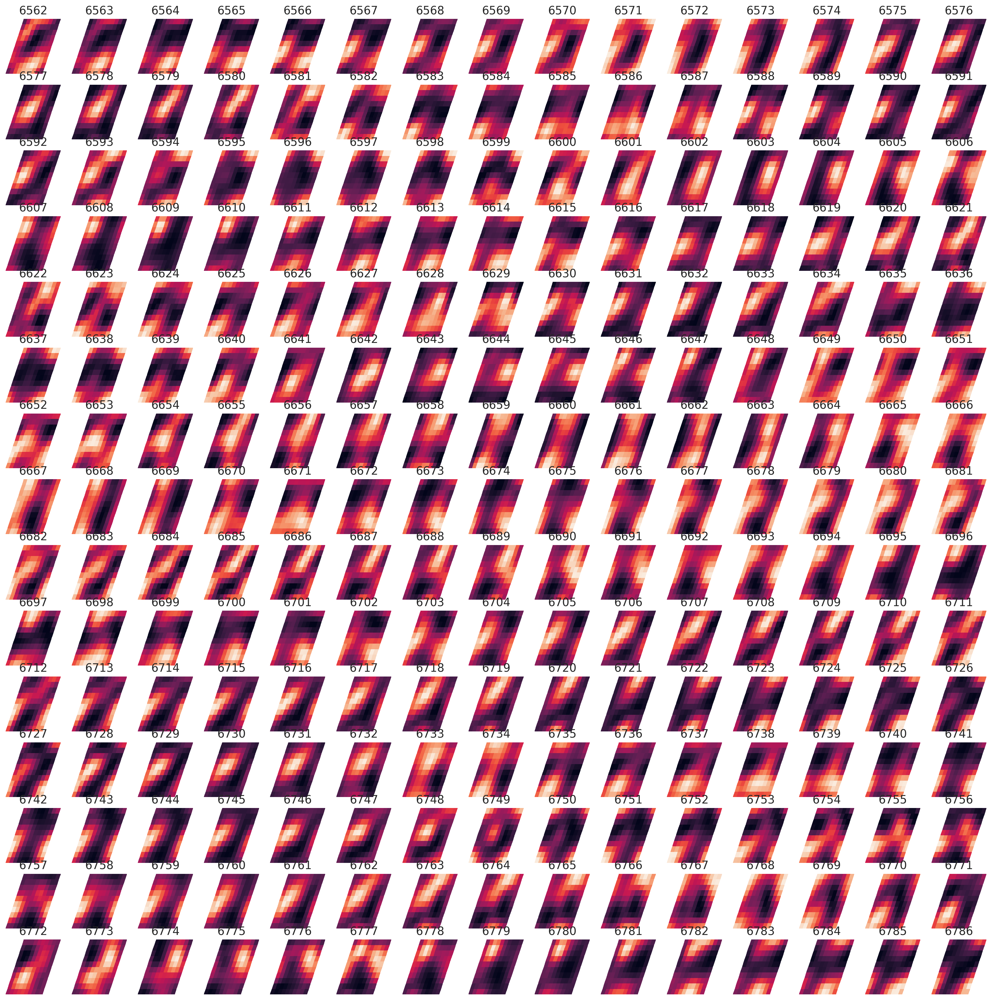

In [ ]:
# THIS WORKS, BUT THE PROBLEM IS THAT THE BUMP GETS TOO SMALL.
#BETTER TO JUST KEEP MAYBE 2 OR 3 COPIES OF SHEET AT MOST
from scipy.interpolate import LinearNDInterpolator
from scipy.ndimage import gaussian_filter
from matplotlib.ticker import FormatStrFormatter

save_dir = '/content/drive/MyDrive/Bump video/dark5'

# maps_linearized = maps[grid_cell_idxs[:resx*resy]].reshape(resx*resy, -1)
maps_linearized = g_fr[:resx*resy,:].reshape(resx*resy, -1)

spatial_window = 2
n_windows = 225
n_skip = 1
sigma1 = 1.5
sigma2 = 1.5
n_rows = int(np.ceil(np.sqrt(n_windows)))
# start_frame=7204-550-625
start_frame=6040+522

plt.figure(figsize=(n_rows*1.5,n_rows*1.5))

pid = 0
phase1_copies = 1
phase2_copies = 1

for i in np.arange(n_windows):
  plt.subplot(n_rows, n_rows, i+1)

  start = i*n_skip+start_frame
  dat = maps_linearized[:, start:start+spatial_window]

  dat = dat.mean(1)
  rm = zscore(dat, axis=0)
  im = rm[gridsort].reshape(resx,resy)

  im_weak=1*im
  im_exp_full=np.tile(im_weak,(3,3))
  im_exp_full[resx:2*resx,resx:2*resx]=im

  im_exp_full_smooth = gaussian_filter(im_exp_full, (sigma1, sigma2))

  range = (np.max(im_exp_full_smooth.reshape(-1)) -
           np.min(im_exp_full_smooth.reshape(-1)))

  im_exp_full_smooth = np.divide(im_exp_full_smooth
                                 - np.min(im_exp_full_smooth.reshape(-1)),
                                 range)

  im=im_exp_full_smooth[resx:2*resx,resx:2*resx]

  x_copies, y_copies = np.mgrid[:phase1_copies*resx,:phase2_copies*resy]/resy
  u_copies, v_copies = coord_from_phase(x_copies+1,y_copies+1)
  plt.pcolormesh(u_copies, v_copies, im, shading='auto')

  plt.title(f'{start}')
  plt.gca().set_axis_off()

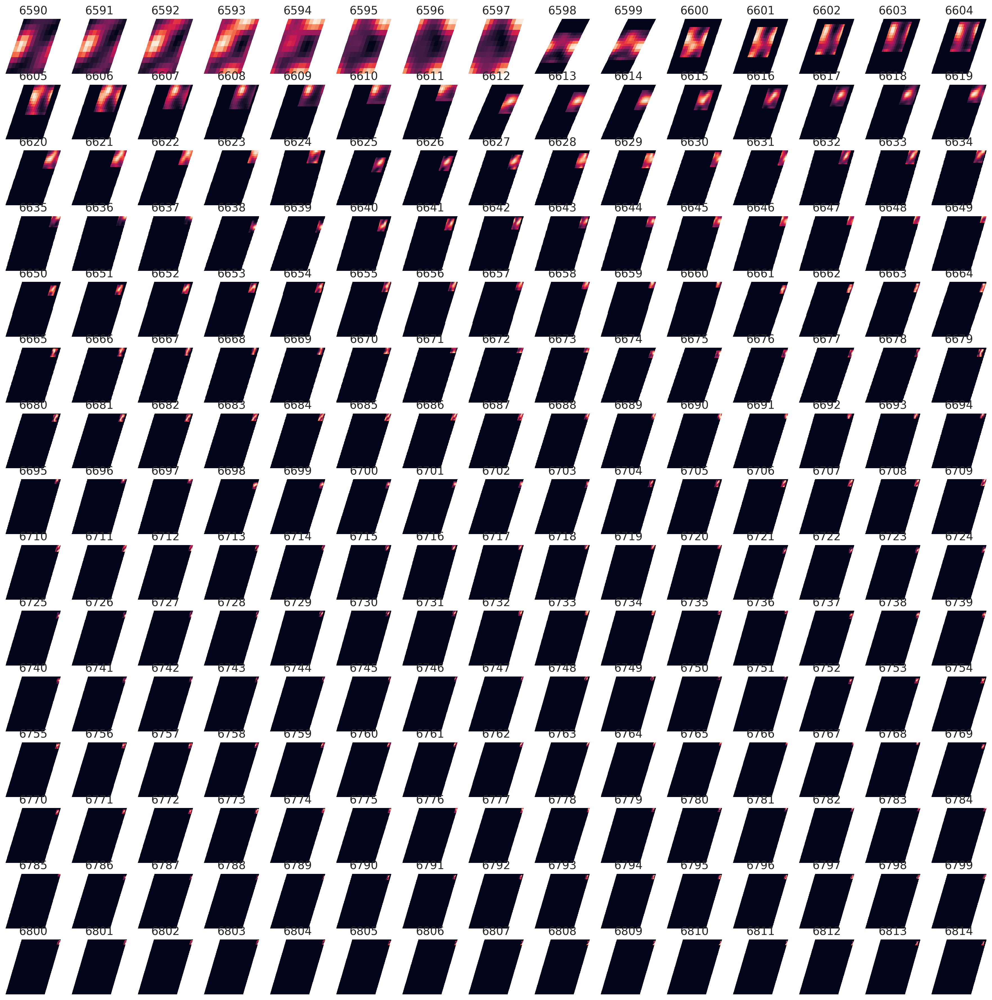

In [ ]:
# THIS WORKS, BUT THE PROBLEM IS THAT THE BUMP GETS TOO SMALL.
#BETTER TO JUST KEEP MAYBE 2 OR 3 COPIES OF SHEET AT MOST
from scipy.interpolate import LinearNDInterpolator
from scipy.ndimage import gaussian_filter
from matplotlib.ticker import FormatStrFormatter

save_dir = '/content/drive/MyDrive/Bump video/dark5'

# maps_linearized = maps[grid_cell_idxs[:resx*resy]].reshape(resx*resy, -1)
maps_linearized = g_fr[:resx*resy,:].reshape(resx*resy, -1)

spatial_window = 2
n_windows = 225
n_skip = 1
sigma1 = 1.5
sigma2 = 1.5
n_rows = int(np.ceil(np.sqrt(n_windows)))
# start_frame=7204-550-625
start_frame=6040

plt.figure(figsize=(n_rows*1.5,n_rows*1.5))

pid = 0
phase1_copies = 1
phase2_copies = 1

for i in np.arange(n_windows):
  plt.subplot(n_rows, n_rows, i+1)

  start = i*n_skip+start_frame
  dat = maps_linearized[:, start:start+spatial_window]

  dat = dat.mean(1)
  rm = zscore(dat, axis=0)
  im = rm[gridsort].reshape(resx,resy)

  im_weak=1*im
  im_exp_full=np.tile(im_weak,(3,3))
  im_exp_full[resx:2*resx,resx:2*resx]=im

  im_exp_full_smooth = gaussian_filter(im_exp_full, (sigma1, sigma2))

  range = (np.max(im_exp_full_smooth.reshape(-1)) -
           np.min(im_exp_full_smooth.reshape(-1)))

  im_exp_full_smooth = np.divide(im_exp_full_smooth
                                 - np.min(im_exp_full_smooth.reshape(-1)),
                                 range)

  im=im_exp_full_smooth[resx:2*resx,resx:2*resx]

  phase1_copies_added = []
  phase2_copies_added = []
  if start in discs_smooth[phase1_use]:
    phase1_copies += 1
    phase1_copies_added.append(start)

  if start in discs_smooth[phase2_use]:
    phase2_copies += 1
    phase2_copies_added.append(start)

  im_copies = np.tile(im, (phase1_copies, phase2_copies))
  if phase1_copies > 1:
    # im_copies[0:(phase1_copies-1)*resx-resx//2, :] = im_copies[0:(phase1_copies-1)*resx-resx//2, :]*0.25
    # im_copies[phase1_copies*resx-resx//2:phase1_copies*resx, :] = im_copies[phase1_copies*resx-resx//2:phase1_copies*resx, :]*0.5
    phase1_val = all_angles_smooth_norm[phase1_use, start]
    allow1 = int(np.round(phase1_val * resx))
    im_copies[0:(phase1_copies - 1) * resx - resx//2 + allow1 - 1, :] = 0
    im_copies[(phase1_copies - 1) * resx + resx//2 + allow1:, :] = 0

  if phase2_copies > 1:
    # im_copies[:, (phase2_copies-1)*resx-resx//2] = im_copies[:, (phase2_copies-1)*resx-resx//2]*0.25
    # im_copies[:, phase2_copies*resx-resx//2:phase2_copies*resx] = im_copies[:, phase2_copies*resx-resx//2:phase2_copies*resx]*0.5
    phase2_val = all_angles_smooth_norm[phase2_use, start]
    allow2 = int(np.round(phase2_val * resx))
    im_copies[:, 0:(phase2_copies - 1) * resx - resx//2 + allow2 - 1] = 0
    im_copies[:, (phase2_copies - 1) * resx + resx//2 + allow2:] = 0

  x_copies, y_copies = np.mgrid[:phase1_copies*resx,:phase2_copies*resy]/resy
  u_copies, v_copies = coord_from_phase(x_copies+1,y_copies+1)
  plt.pcolormesh(u_copies, v_copies, im_copies, shading='auto')

  # plt.imshow(im_copies)
  plt.title(f'{start}')
  plt.gca().set_axis_off()



  # plt.pcolormesh(u, v, im, shading='auto')

  # x_wide,y_wide = np.mgrid[:2*resx,:resy]/resy
  # u_wide,v_wide = coord_from_phase(x_wide+1,y_wide+1)

  # x_tall,y_tall = np.mgrid[:resx,:2*resy]/resy
  # u_tall,v_tall = coord_from_phase(x_tall+1,y_tall+1)

  # im2=im_exp_full_smooth[resx:3*resx,resx:2*resx]
  # subim2 = im2[0:resx,:]
  # subim2[subim2>0] = subim2[subim2>0]*0.5
  # im2[0:resx,:]=subim2
  # im2[0:resx, :] >0 = 0.1*(im2[0:resx, :] >0)

  # im2=(zscore(im2.reshape(-1)).reshape(2*resx,resy))
  # plt.imshow(im)
  # im=zscore(im.reshape(-1)).reshape(resx,resy)
  # plt.pcolormesh(u, v, im, shading='auto')

  # upos = u.reshape(-1) + (np.diff(u)[0][0] * (resx+1))
  # u_full=np.concatenate((upos, u.reshape(-1))).reshape(2*resx,resy)
  # u_full=np.concatenate((u, u.reshape(-1))).reshape(2*resx,resy)

  # vpos = v.reshape(-1) + (np.diff(v)[0][0] * (resx+1))
  # v_full=np.concatenate((v.reshape(-1), vpos)).reshape(2*resx,resy)
  # plt.subplot(2,1,2)
  # plt.pcolormesh(u_wide, v_wide, im2, shading='auto')

  # keep track of indices that are the "main" ones and multiply the other
  # non-main indices by 0.5 each frame to dim them out


  # need a u_tall, v_tall for when phase


  # U = np.linspace(np.min(u.reshape(-1)), np.max(u.reshape(-1)), 50)
  # U = np.linspace(np.min(u.reshape(-1)), 2*np.max(u.reshape(-1)), 50)
  # V = np.linspace(np.min(v.reshape(-1)), np.max(v.reshape(-1)), 50)

  # U, V = np.meshgrid(U, V)  # 2D grid for interpolation

  # uneg = u.reshape(-1) + (np.diff(u)[0][0] * (resx+1))
  # u_full=np.concatenate((uneg, u.reshape(-1)))
  # v_full = np.tile(v, (1,2))
  # interp = LinearNDInterpolator(list(zip(u_full.reshape(-1), v_full.reshape(-1))), im.reshape(-1))

  # interp = LinearNDInterpolator(list(zip(u.reshape(-1), v.reshape(-1))), im.reshape(-1))
  # Z = interp(U, V)
  # plt.pcolormesh(U, V, Z, shading='auto')

  # plt.pcolormesh(U, V, Z, shading='auto')
  # plt.gca().set_axis_off()
  # plt.title(f'{start}', fontsize=6)

  # plt.savefig(os.path.join(save_dir,f'{pid:03d}.png'), dpi=50)
  # plt.close()
  # pid += 1


In [ ]:
np.ceil(phase1_val*resx)

9

In [ ]:
phase1_val = all_angles_smooth_norm[phase1_use, start]
phase1_val

0.04276184449741121

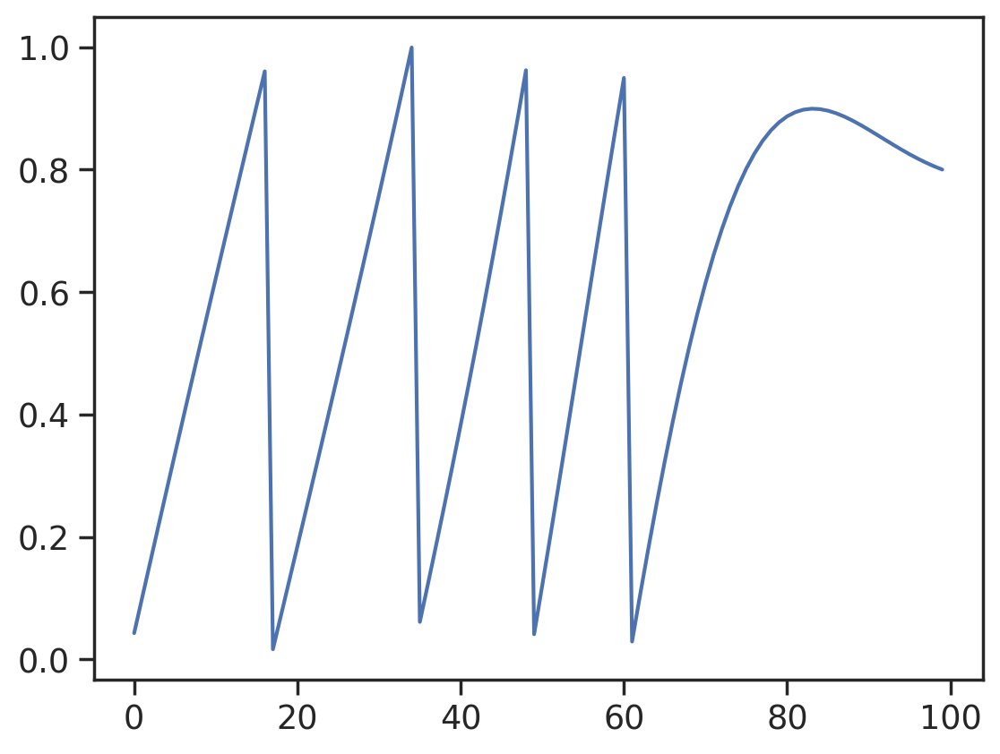

In [ ]:
plt.plot(all_angles_smooth_norm[phase1_use, start:start+100])

In [ ]:
(phase1_copies - 1 + 0.5)

In [ ]:
phase1_val = all_angles_smooth[phase1_use, start]
phase1_val

-1.981314334570449

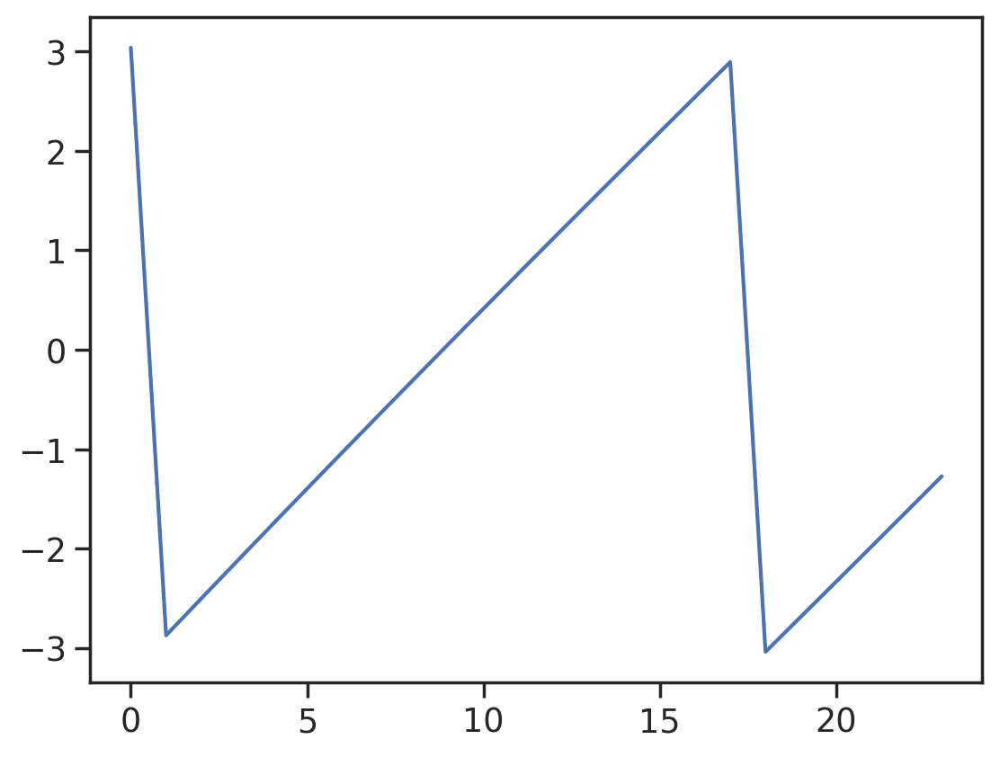

In [ ]:
plt.plot(all_angles_smooth[phase1_use, 6043:6067])

In [ ]:
np.arange(0,(phase1_copies-1)*resx

array([0, 1, 2, 3, 4, 5, 6, 7, 8])

In [ ]:
start in discs_smooth[phase1_use]

True

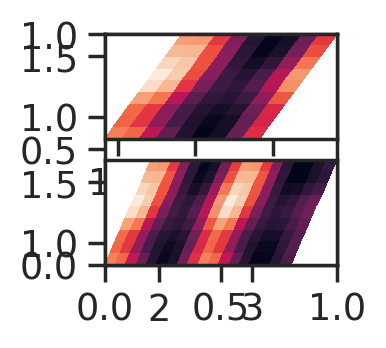

In [ ]:
from scipy.interpolate import LinearNDInterpolator
from scipy.ndimage import gaussian_filter
from matplotlib.ticker import FormatStrFormatter

save_dir = '/content/drive/MyDrive/Bump video/dark5'

# maps_linearized = maps[grid_cell_idxs[:resx*resy]].reshape(resx*resy, -1)
maps_linearized = g_fr[:resx*resy,:].reshape(resx*resy, -1)

spatial_window = 2
n_windows = 1
n_skip = 1
sigma1 = 1.5
sigma2 = 1.5
n_rows = int(np.ceil(np.sqrt(n_windows)))
# start_frame=7204-550-625
start_frame=6044


plt.figure(figsize=(n_rows*1.5,n_rows*1.5))

pid = 0
for i in np.arange(n_windows):
  plt.subplot(n_rows, n_rows, i+1)

  start = i*n_skip+start_frame
  dat = maps_linearized[:, start:start+spatial_window]

  dat = dat.mean(1)
  rm = zscore(dat, axis=0)
  im = rm[gridsort].reshape(resx,resy)

  im_weak=1*im
  im_exp_full=np.tile(im_weak,(3,3))
  im_exp_full[resx:2*resx,resx:2*resx]=im
  # for i in range(3*resx):
  #   im_exp_full[i]=np.roll(im_exp_full[i],-i)

  im_exp_full_smooth = gaussian_filter(im_exp_full, (sigma1, sigma2))

  range = (np.max(im_exp_full_smooth.reshape(-1)) -
           np.min(im_exp_full_smooth.reshape(-1)))

  im_exp_full_smooth = np.divide(im_exp_full_smooth - np.min(im_exp_full_smooth.reshape(-1)),
                                 range)
  # im=im_exp_full_smooth[resx:2*resx,resx:2*resx]


  im=im_exp_full_smooth[resx:2*resx,resx:2*resx]


  plt.subplot(2,1,1)
  plt.pcolormesh(u, v, im, shading='auto')

  x_wide,y_wide = np.mgrid[:2*resx,:resy]/resy
  u_wide,v_wide = coord_from_phase(x_wide+1,y_wide+1)

  x_tall,y_tall = np.mgrid[:resx,:2*resy]/resy
  u_tall,v_tall = coord_from_phase(x_tall+1,y_tall+1)

  im2=im_exp_full_smooth[resx:3*resx,resx:2*resx]
  # subim2 = im2[0:resx,:]
  # subim2[subim2>0] = subim2[subim2>0]*0.5
  # im2[0:resx,:]=subim2
  # im2[0:resx, :] >0 = 0.1*(im2[0:resx, :] >0)

  # im2=(zscore(im2.reshape(-1)).reshape(2*resx,resy))
  # plt.imshow(im)
  # im=zscore(im.reshape(-1)).reshape(resx,resy)
  # plt.pcolormesh(u, v, im, shading='auto')

  # upos = u.reshape(-1) + (np.diff(u)[0][0] * (resx+1))
  # u_full=np.concatenate((upos, u.reshape(-1))).reshape(2*resx,resy)
  # u_full=np.concatenate((u, u.reshape(-1))).reshape(2*resx,resy)

  # vpos = v.reshape(-1) + (np.diff(v)[0][0] * (resx+1))
  # v_full=np.concatenate((v.reshape(-1), vpos)).reshape(2*resx,resy)
  plt.subplot(2,1,2)
  plt.pcolormesh(u_wide, v_wide, im2, shading='auto')

  # keep track of indices that are the "main" ones and multiply the other
  # non-main indices by 0.5 each frame to dim them out


  # need a u_tall, v_tall for when phase


  # U = np.linspace(np.min(u.reshape(-1)), np.max(u.reshape(-1)), 50)
  # U = np.linspace(np.min(u.reshape(-1)), 2*np.max(u.reshape(-1)), 50)
  # V = np.linspace(np.min(v.reshape(-1)), np.max(v.reshape(-1)), 50)

  # U, V = np.meshgrid(U, V)  # 2D grid for interpolation

  # uneg = u.reshape(-1) + (np.diff(u)[0][0] * (resx+1))
  # u_full=np.concatenate((uneg, u.reshape(-1)))
  # v_full = np.tile(v, (1,2))
  # interp = LinearNDInterpolator(list(zip(u_full.reshape(-1), v_full.reshape(-1))), im.reshape(-1))

  # interp = LinearNDInterpolator(list(zip(u.reshape(-1), v.reshape(-1))), im.reshape(-1))
  # Z = interp(U, V)
  # plt.pcolormesh(U, V, Z, shading='auto')

  # plt.pcolormesh(U, V, Z, shading='auto')
  # plt.gca().set_axis_off()
  # plt.title(f'{start}', fontsize=6)

  # plt.savefig(os.path.join(save_dir,f'{pid:03d}.png'), dpi=50)
  # plt.close()
  # pid += 1


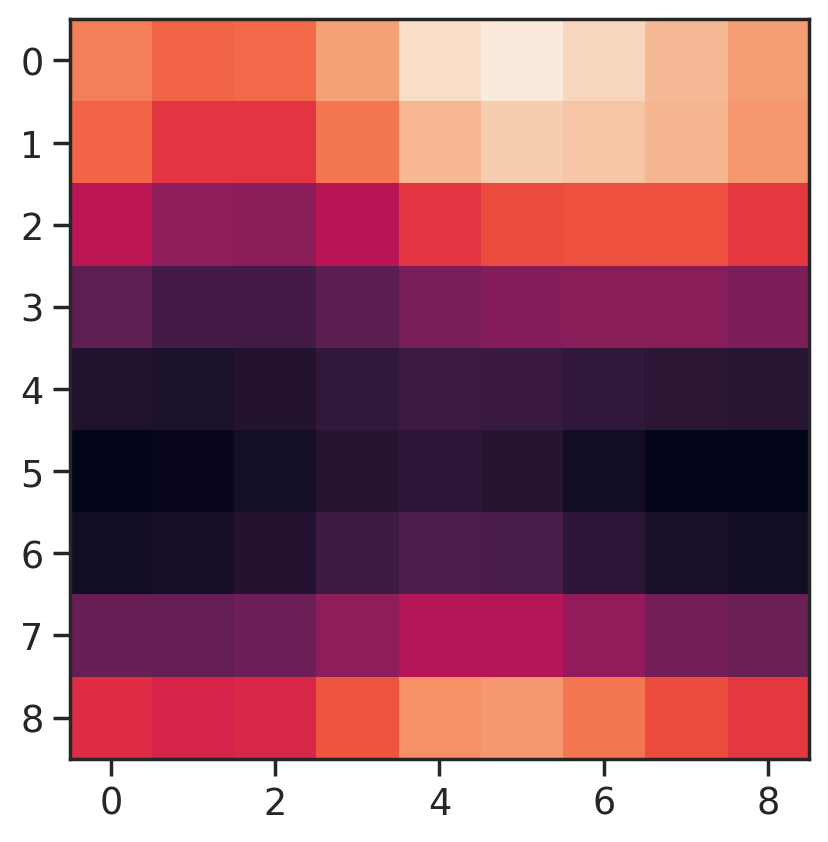

In [ ]:
plt.imshow(im)

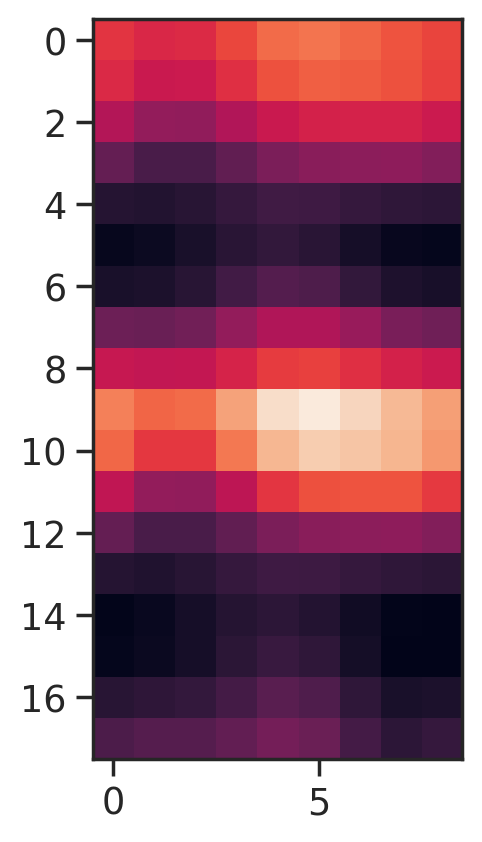

In [ ]:
plt.imshow(im2)

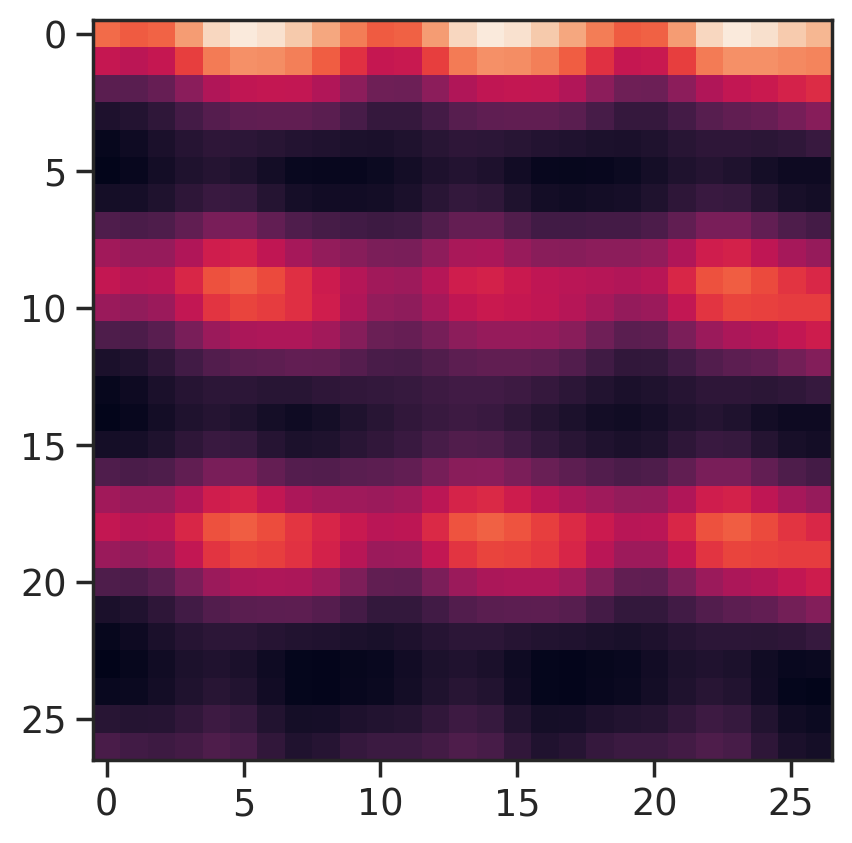

In [ ]:
plt.imshow(im_exp_full_smooth)

In [ ]:
v_wide.shape

(9, 18)

In [ ]:
x_wide,y_wide = np.mgrid[:2*resx,:resy]/resy
u_wide,v_wide = coord_from_phase(x_wide+1,y_wide+1)

x_tall,y_tall = np.mgrid[:resx,:2*resy]/resy
u_tall,v_tall = coord_from_phase(x_tall+1,y_tall+1)

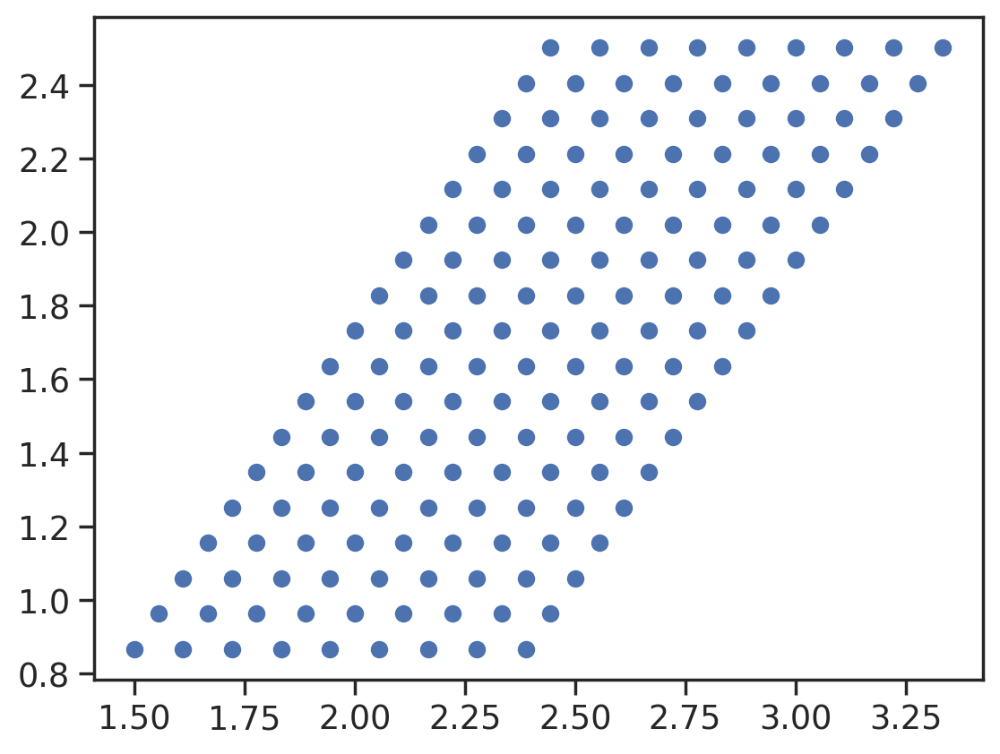

In [ ]:
plt.scatter(u_tall, v_tall)

ValueError: x and y must be the same size

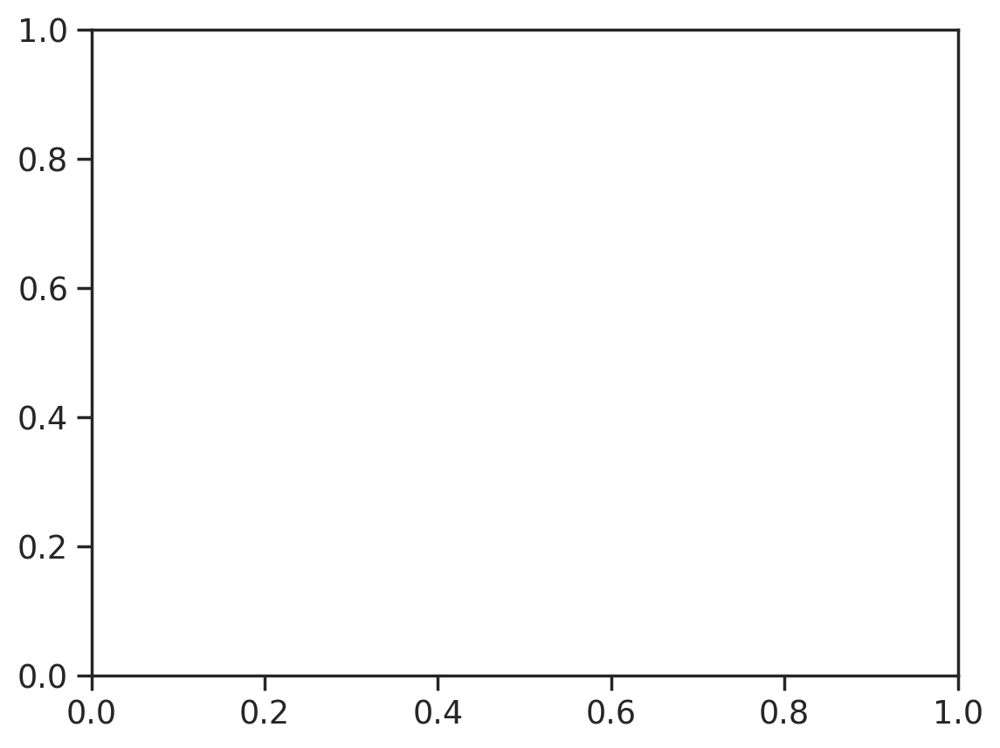

In [ ]:
plt.scatter(u_full, v_full)

In [ ]:
np.diff(vpos)

array([ 0.05555556,  0.05555556,  0.05555556,  0.05555556,  0.05555556,
        0.05555556,  0.05555556,  0.05555556, -0.33333333,  0.05555556,
        0.05555556,  0.05555556,  0.05555556,  0.05555556,  0.05555556,
        0.05555556,  0.05555556, -0.33333333,  0.05555556,  0.05555556,
        0.05555556,  0.05555556,  0.05555556,  0.05555556,  0.05555556,
        0.05555556, -0.33333333,  0.05555556,  0.05555556,  0.05555556,
        0.05555556,  0.05555556,  0.05555556,  0.05555556,  0.05555556,
       -0.33333333,  0.05555556,  0.05555556,  0.05555556,  0.05555556,
        0.05555556,  0.05555556,  0.05555556,  0.05555556, -0.33333333,
        0.05555556,  0.05555556,  0.05555556,  0.05555556,  0.05555556,
        0.05555556,  0.05555556,  0.05555556, -0.33333333,  0.05555556,
        0.05555556,  0.05555556,  0.05555556,  0.05555556,  0.05555556,
        0.05555556,  0.05555556, -0.33333333,  0.05555556,  0.05555556,
        0.05555556,  0.05555556,  0.05555556,  0.05555556,  0.05

In [ ]:
im.shape

(18, 9)

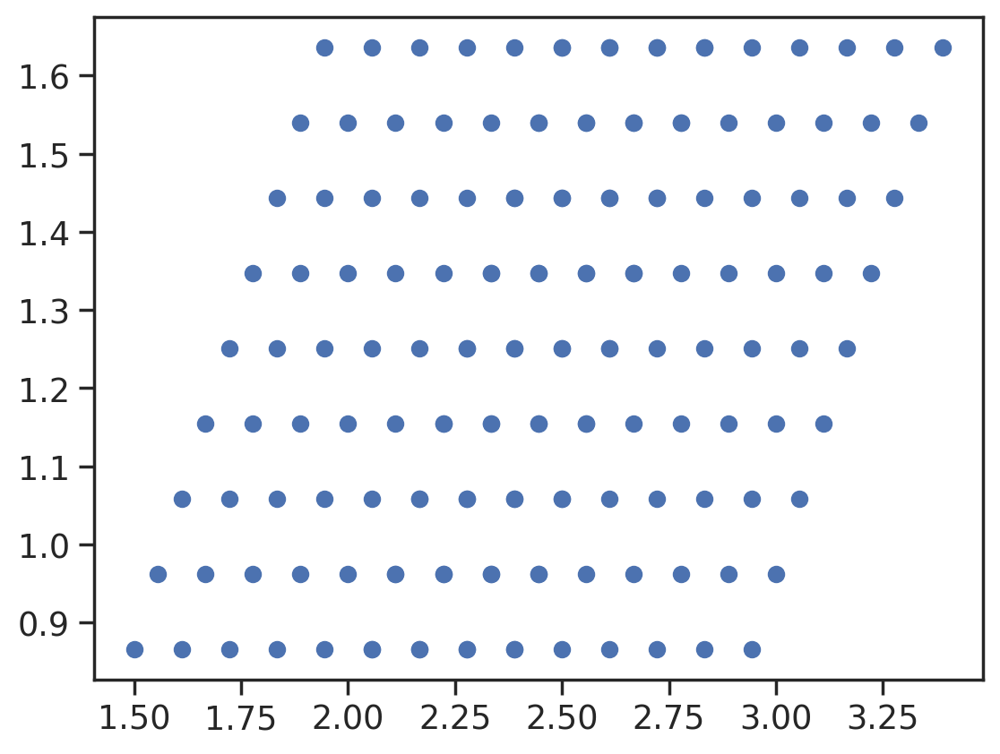

In [ ]:
plt.scatter(u_full, v_full)

In [ ]:
v_full.shape

(9, 18)

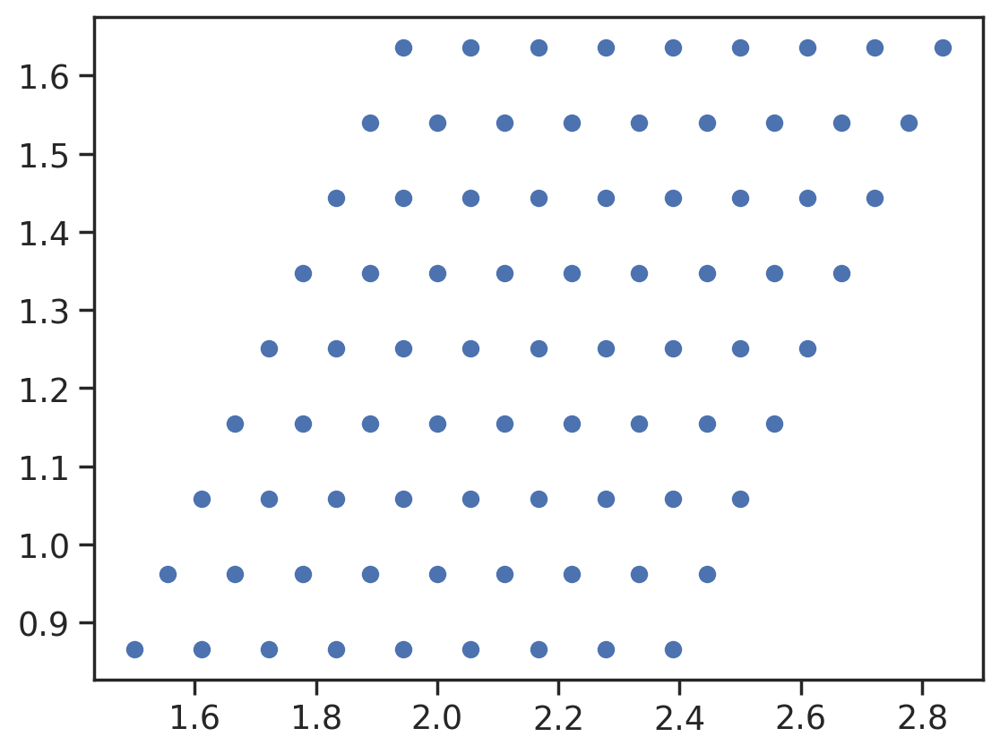

In [ ]:
plt.scatter(u.reshape(-1), v.reshape(-1))

In [ ]:
np.diff(u)

array([[0.05555556, 0.05555556, 0.05555556, 0.05555556, 0.05555556,
        0.05555556, 0.05555556, 0.05555556],
       [0.05555556, 0.05555556, 0.05555556, 0.05555556, 0.05555556,
        0.05555556, 0.05555556, 0.05555556],
       [0.05555556, 0.05555556, 0.05555556, 0.05555556, 0.05555556,
        0.05555556, 0.05555556, 0.05555556],
       [0.05555556, 0.05555556, 0.05555556, 0.05555556, 0.05555556,
        0.05555556, 0.05555556, 0.05555556],
       [0.05555556, 0.05555556, 0.05555556, 0.05555556, 0.05555556,
        0.05555556, 0.05555556, 0.05555556],
       [0.05555556, 0.05555556, 0.05555556, 0.05555556, 0.05555556,
        0.05555556, 0.05555556, 0.05555556],
       [0.05555556, 0.05555556, 0.05555556, 0.05555556, 0.05555556,
        0.05555556, 0.05555556, 0.05555556],
       [0.05555556, 0.05555556, 0.05555556, 0.05555556, 0.05555556,
        0.05555556, 0.05555556, 0.05555556],
       [0.05555556, 0.05555556, 0.05555556, 0.05555556, 0.05555556,
        0.05555556, 0.055555

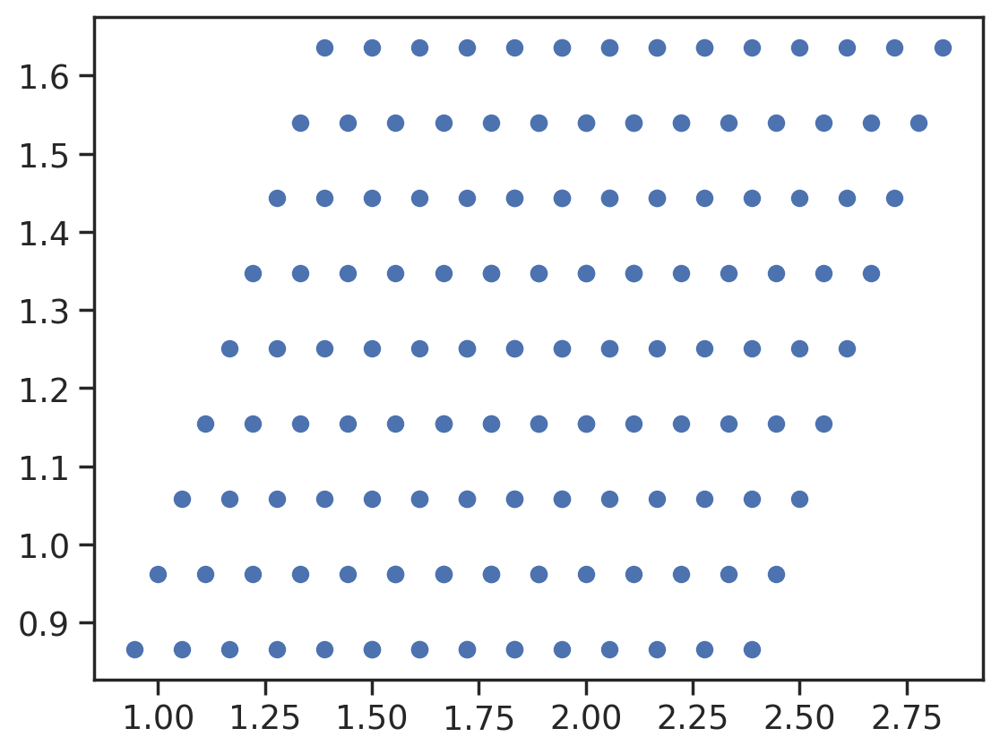

In [ ]:
plt.scatter(u_full, np.tile(v.reshape(-1), (1,2)))

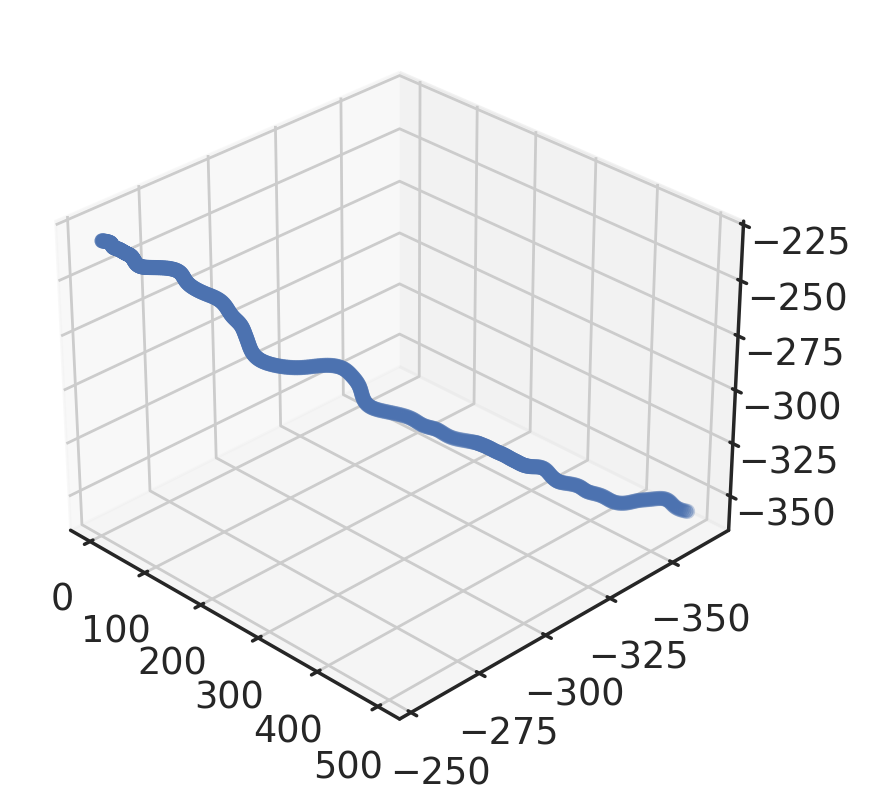

In [ ]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Generate some data
x = np.arange(0, bins_plot.shape[0])
y = all_angles_unw_smooth[phase1_use, bins_plot]
z = all_angles_unw_smooth[phase2_use, bins_plot]


# Plot the surface
ax.scatter(x,y,z)
ax.invert_yaxis()

ax.view_init(elev=30, azim=-45, roll=0)


In [ ]:
# plt.scatter(all_angles_unw_smooth[phase1_use,bins_plot],
#             all_angles_unw_smooth[phase2_use,bins_plot])

In [ ]:
# plt.scatter(new_posx_lin[bins_plot],
#             all_angles_unw_smooth[phase2_use,bins_plot])

# plt.scatter(new_posx_lin[bins_plot],
#             all_angles_unw_smooth[phase1_use,bins_plot])

In [ ]:
# c=[]
# plt.figure(figsize=(2,10))
# for i in range(10):
#   plt.subplot(10,1,i+1)
#   c.append(i)
#   plt.plot(c, '*')
#   if i >= 5:
#     plt.xlim([i-5, i+1])
#   else:
#     plt.xlim([0, 5])
#   plt.ylim([0, 10])

In [ ]:
dat

array([1763.24129485, 1771.10929685, 1778.64772401, 1785.1005793 ,
       1790.3671141 , 1797.90210302, 1805.20151973, 1811.8144116 ,
       1817.42898381, 1822.95563674, 1828.91641755, 1835.9263419 ,
       1843.47158189, 1847.81846462, 1855.2473501 , 1859.33577165,
       1861.373     , 1861.55312397, 1864.38778894, 1866.32534667,
       1866.558     , 1870.68725811, 1875.30934872, 1881.131     ,
       1885.96114113, 1888.01233312, 1890.53757372, 1897.55410222,
       1903.48279977, 1909.784     , 1913.31981974, 1920.97509897,
       1929.25511063, 1933.70607314, 1936.80534951, 1943.7389278 ,
       1951.76751932, 1958.63947603, 1962.843     , 1963.379     ,
       1963.468     , 1963.558     , 1963.602     , 1963.558     ,
       1963.602     , 1963.73257836, 1963.737     , 1963.647     ,
       1963.647     , 1963.647     , 1963.826     , 1963.96      ,
       1964.094     , 1963.96      , 1963.96      , 1963.96      ,
       1963.96      , 1963.96      , 1964.005     , 1964.139  

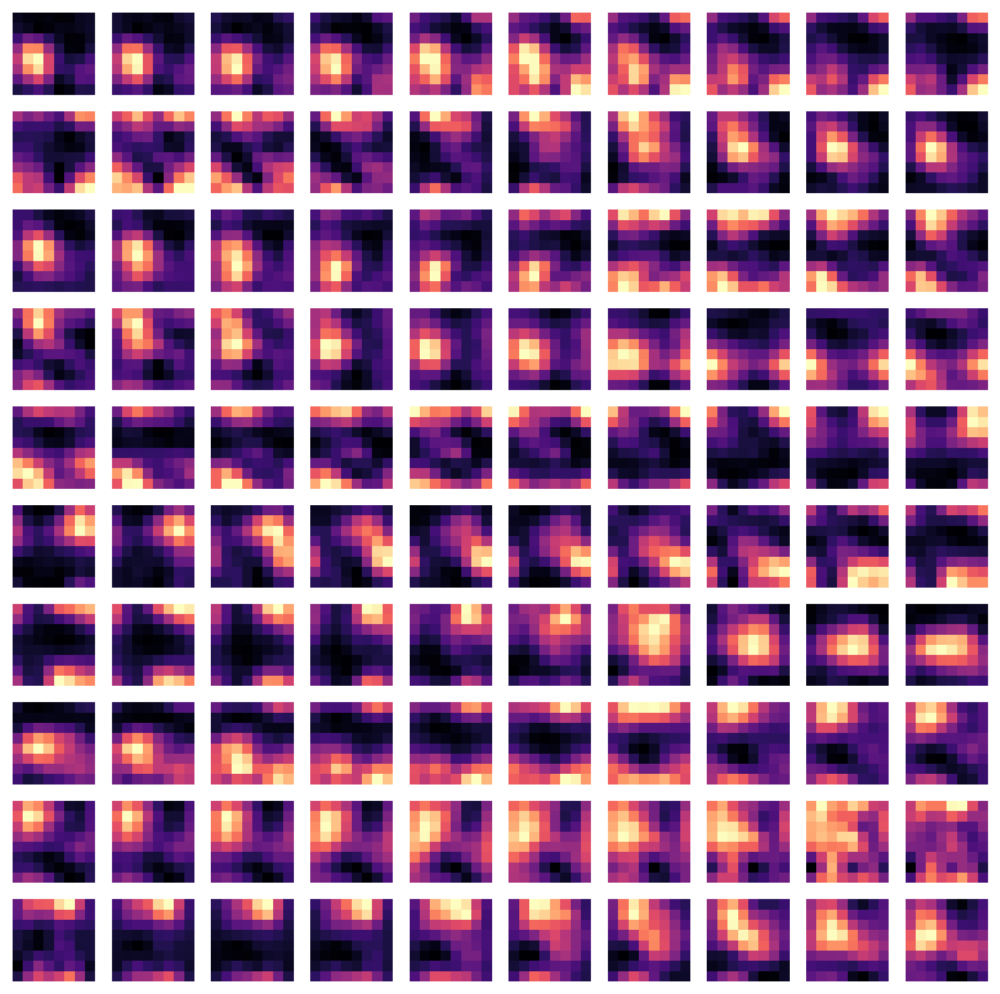

In [ ]:
from scipy.ndimage import gaussian_filter
save_dir = '/content/drive/MyDrive/Bump video/dark2'

maps_linearized = maps[grid_cell_idxs[:resx*resy]].reshape(resx*resy, -1)

spatial_window = 2
n_windows = 100
n_skip = 5
n_rows = int(np.ceil(np.sqrt(n_windows)))
plt.figure(figsize=(10, 10))

pid = 50
for i in np.arange(n_windows):
  plt.subplot(n_rows, n_rows, i+1)
  pid += 1
  start = i*n_skip
  dat = maps_linearized[:, start:start+spatial_window]

  dat = dat.mean(1)
  rm = zscore(dat, axis=0)
  # rm = dat.mean(1)
  # rm = maps_linearized[:, start:start+spatial_window].mean(1)
  # rm = zscore(rm)
  im = rm[gridsort].reshape(resx,resy)

  # replicates, place onto rhomboid shape, then spatial smoothing, finally take center
  sigma=1
  im = gaussian_filter(im, sigma, mode='wrap')

  # repim = np.tile(im, (3,3))
  # smooth_repim = gaussian_filter(repim, (sigma,sigma))
  # im=smooth_repim
  # # im = smooth_repim[resx:2*resx, resy:2*resy]

  # # im = gaussian_filter(im, (1.5, 1.5)) # spatial filtering
  # udiff=np.diff(u)[0][0]
  # vdiff=np.diff(v)[0][0]

  # newdimu=im.shape[0]
  # newdimv=im.shape[1]

  # lu=np.arange(0,udiff*newdimu**2,udiff).reshape(newdimu,-1)
  # lv=np.tile(np.arange(0,vdiff*(newdimv),vdiff)[:-1], (newdimv,1))

  # plt.pcolormesh(lu,
  #                lv,
  #                im,shading='auto',cmap='magma')

  plt.pcolormesh(np.linspace(0,1,u.shape[0]),np.linspace(0,1,u.shape[0]),im,shading='auto',cmap='magma') # square
  # plt.pcolormesh(u,v,im,shading='auto',cmap='magma')
  # plt.pcolormesh(np.linspace(0,1,8),np.linspace(0,1,8),im,shading='auto',cmap='magma') # square

#     plt.scatter(u.ravel(),v.ravel(),c=im.T.ravel(),s=35,marker='h',cmap='magma')
  plt.axis('off')
  # plt.title(f'{np.round(rm.std(0))}')
  # plt.savefig(os.path.join(save_dir,f'{pid}.png'), dpi=50)

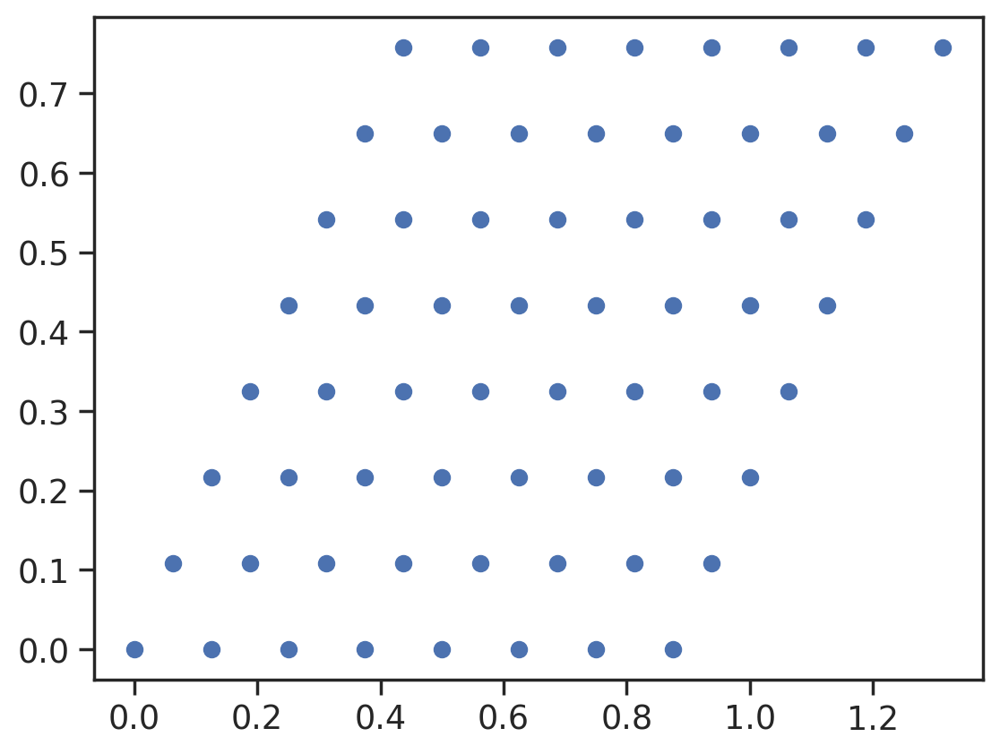

In [ ]:
plt.scatter(u, v)
# plt.imshow(im)

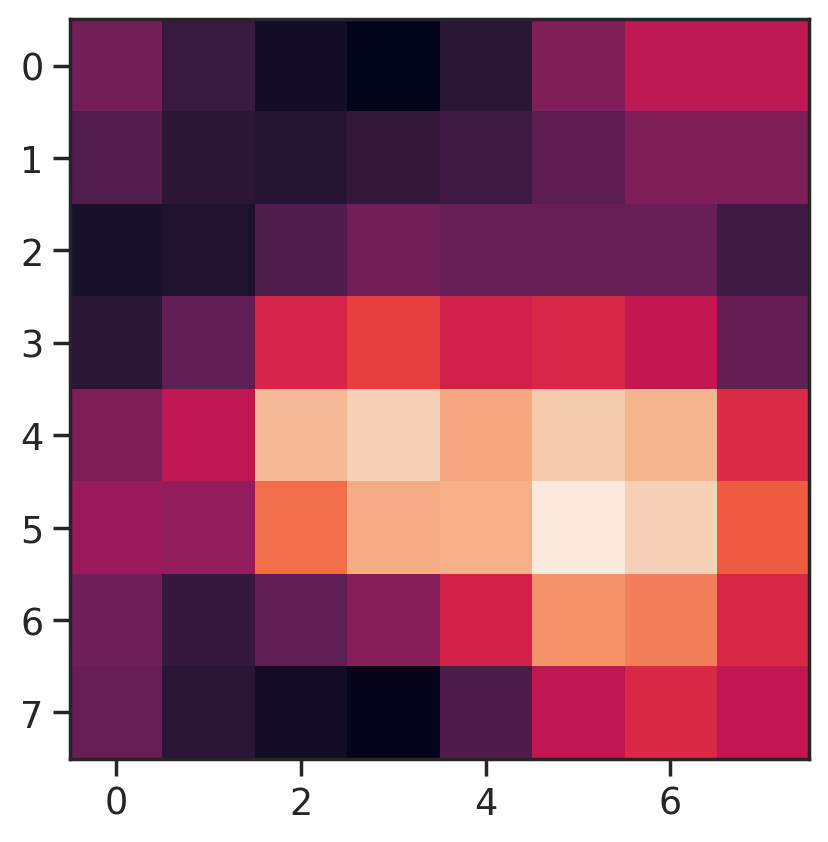

In [ ]:
plt.imshow(im)

In [ ]:
np.sqrt(3)

1.7320508075688772

In [ ]:
phases_all[0]

array([-1.49944864,  2.49782012,  2.91691177, -1.15885215, -0.33658132,
       -3.10299104,  0.55749641,  0.43938232, -2.23723146,  2.14931329,
        0.85400043,  0.42677421,  2.02602724, -0.98937728, -1.2273841 ,
        1.82525272,  0.05355585, -0.87450715,  0.72304933,  2.91157602,
        0.34565694,  1.26070943, -2.59835601, -1.39112361,  1.31962099,
        2.08277305, -2.12090023,  0.29940582, -0.77414372,  0.98125239,
        1.07702573, -1.32719725, -1.92826726, -0.25687422,  1.85542398,
        0.66272053, -1.47368509, -0.43104951, -1.46912929,  2.1796475 ,
        0.39354206, -1.61001911,  2.55571431, -0.6969622 ,  2.05128401,
       -2.34642746,  2.47709161,  2.07708322, -0.33303522,  1.95840048,
        2.96297984, -0.94441951,  0.32317351, -2.87690751,  2.92153232,
       -1.89201874,  3.13228085,  0.36856439, -2.37668912, -2.50774416,
       -0.59521129, -1.70722589, -0.59547336, -2.93098921,  1.17490944,
       -1.68061622,  0.55766232,  0.45412733,  0.16554514,  2.44

In [ ]:
from scipy.interpolate import interpn

In [ ]:
z=np.zeros((8,7))
z[:]=np.nan
z.shape

(8, 7)

In [ ]:
im_exp=np.concatenate((z,im), axis=1)
for i in range(8):
  im_exp[i]=np.roll(im_exp[i],-i)

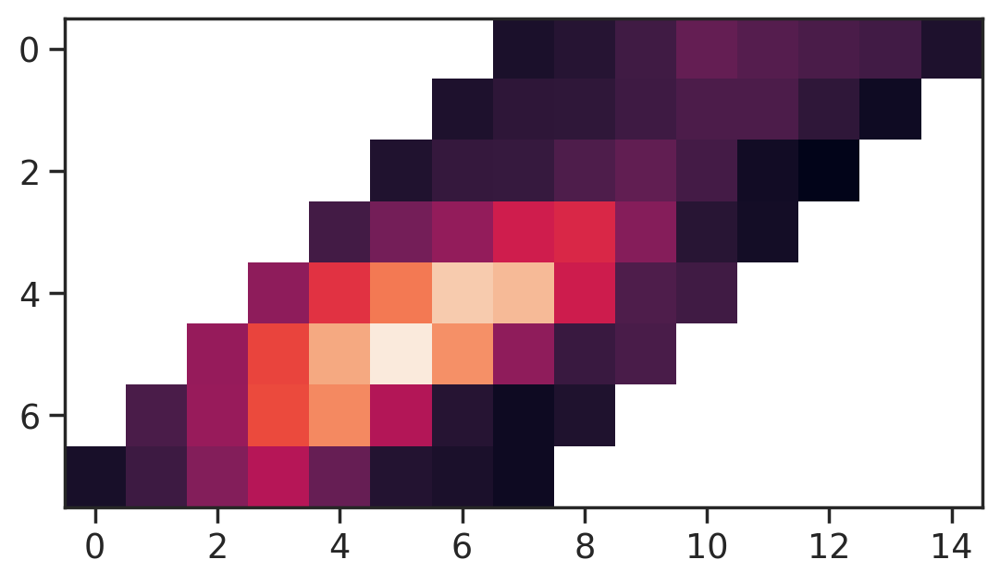

In [ ]:
plt.imshow(im_exp)

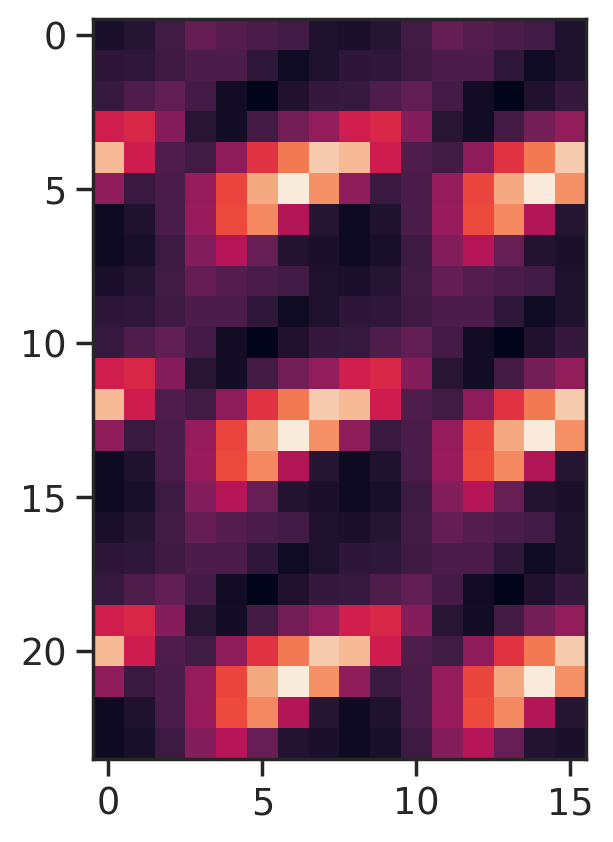

In [ ]:
im_exp_full=np.concatenate((im,im), axis=1)
for i in range(8):
  im_exp_full[i]=np.roll(im_exp_full[i],-i)

im_exp_full=np.tile(im_exp_full,(3,1))
plt.imshow(im_exp_full)


In [ ]:
im_exp_full=np.tile(im,(3,3))
for i in range(24):
  im_exp_full[i]=np.roll(im_exp_full[i],-i)


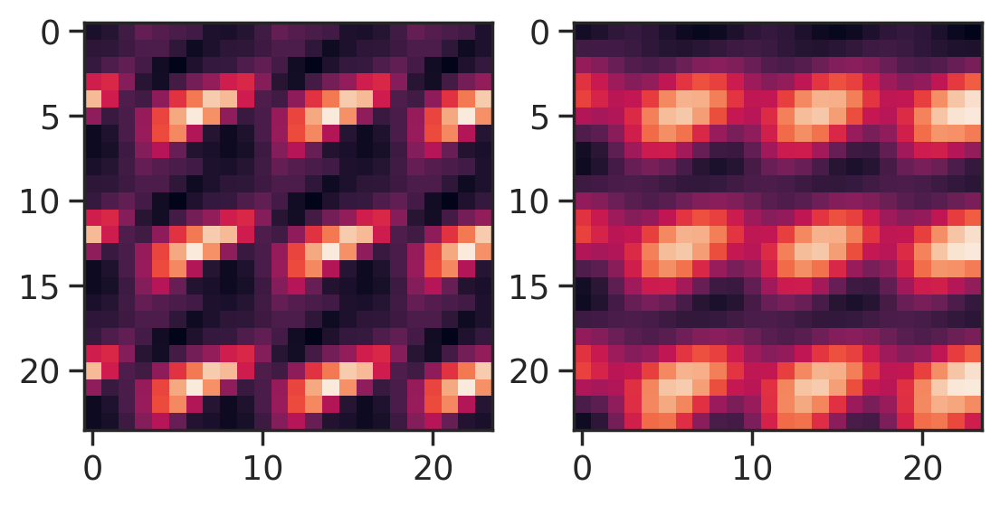

In [ ]:
im_exp_full_smooth = gaussian_filter(im_exp_full, 1.5)
plt.subplot(1,2,1)
plt.imshow(im_exp_full)
plt.subplot(1,2,2)
plt.imshow(im_exp_full_smooth)

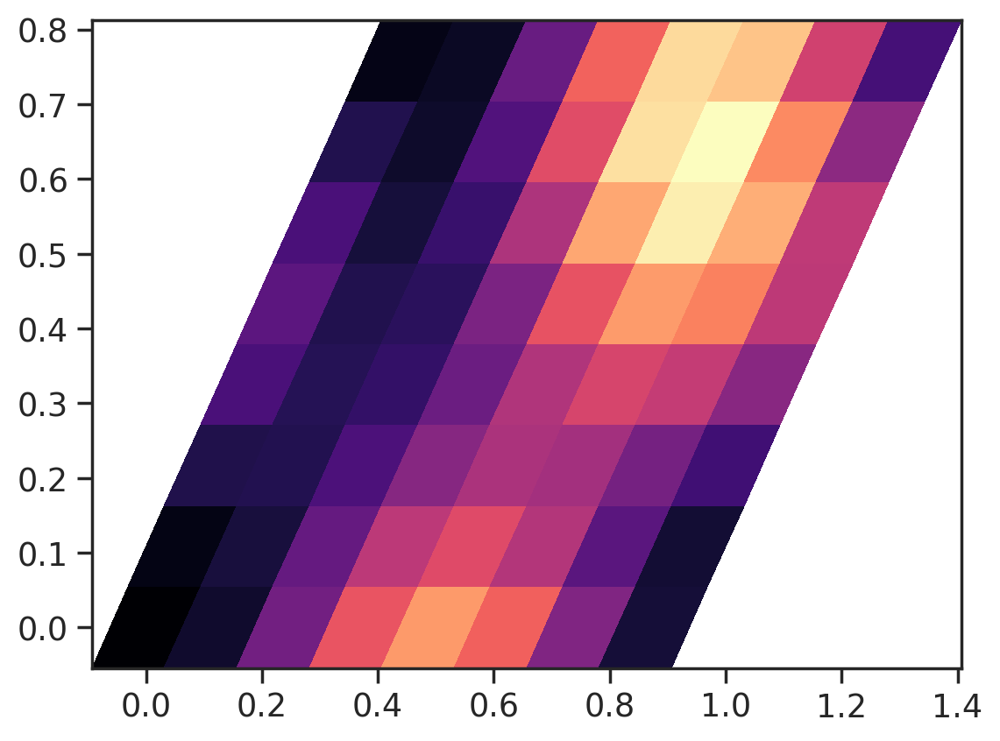

In [ ]:
g=im_exp_full_smooth[8:16,8:16]
plt.pcolormesh(u,v,g,shading='auto',cmap='magma')


In [ ]:
# why not work with square one first, including smoothing, then plot?

In [ ]:
plt.scatter(phases_all[1])

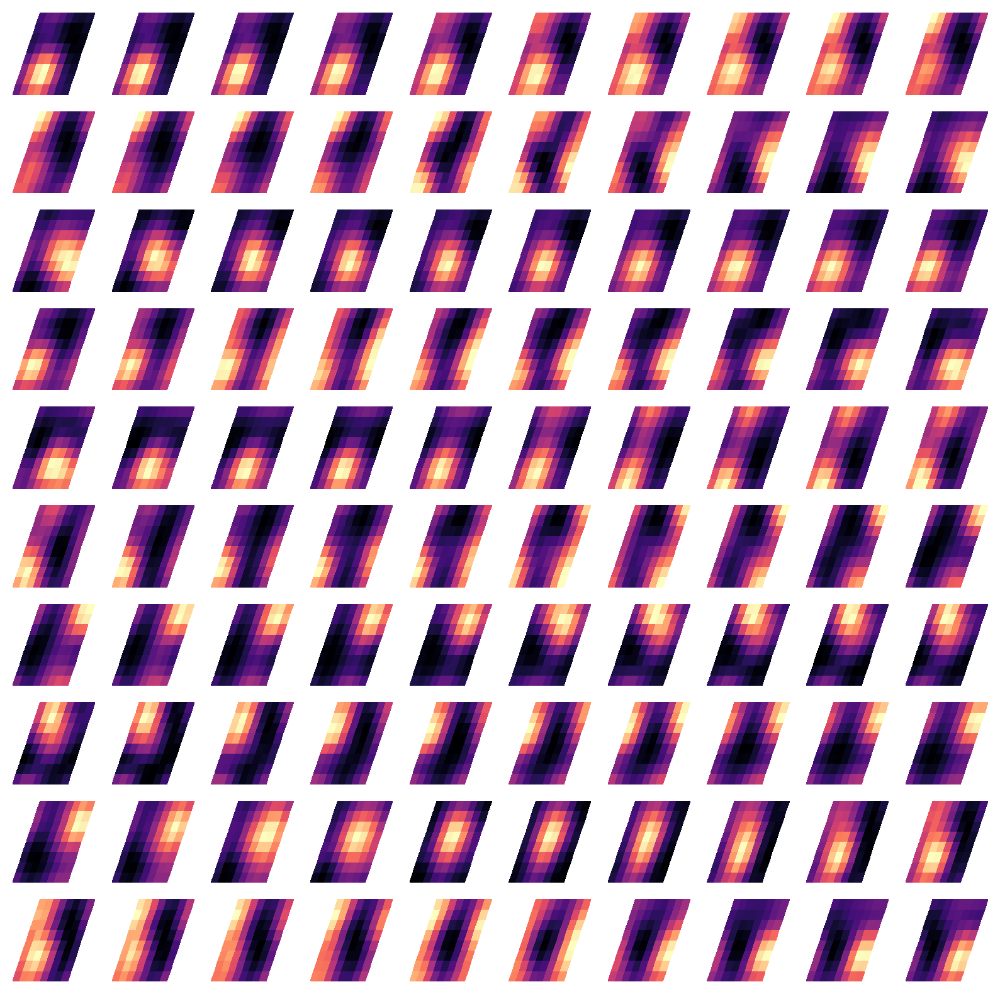

In [ ]:
from scipy.ndimage import gaussian_filter
save_dir = '/content/drive/MyDrive/Bump video/dark2'

maps_linearized = maps[grid_cell_idxs[:resx*resy]].reshape(resx*resy, -1)

spatial_window = 2
n_windows = 100
n_skip = 4
sigma = 1.5
n_rows = int(np.ceil(np.sqrt(n_windows)))
plt.figure(figsize=(n_rows,n_rows))

pid = 50
for i in np.arange(n_windows):
  plt.subplot(n_rows, n_rows, i+1)
  pid += 1
  start = i*n_skip
  dat = maps_linearized[:, start:start+spatial_window]

  dat = dat.mean(1)
  rm = zscore(dat, axis=0)
  # rm = dat.mean(1)
  # rm = maps_linearized[:, start:start+spatial_window].mean(1)
  # rm = zscore(rm)
  im = rm[gridsort].reshape(resx,resy)
  # im = gaussian_filter(im, 1, mode='wrap')

  im_weak=0.5*im
  im_exp_full=np.tile(im_weak,(3,3))
  im_exp_full[resx:2*resx,resx:2*resx]=im
  # for i in range(3*resx):
  #   im_exp_full[i]=np.roll(im_exp_full[i],-i)

  im_exp_full_smooth = gaussian_filter(im_exp_full, sigma)
  im=im_exp_full_smooth[resx:2*resx,resx:2*resx]

  # # replicates, place onto rhomboid shape, then spatial smoothing, finally take center
  # sigma=1
  # im = gaussian_filter(im, sigma, mode='wrap')

  # repim = np.tile(im, (3,3))
  # smooth_repim = gaussian_filter(repim, (sigma,sigma))
  # im=smooth_repim
  # # im = smooth_repim[resx:2*resx, resy:2*resy]

  # # im = gaussian_filter(im, (1.5, 1.5)) # spatial filtering
  # udiff=np.diff(u)[0][0]
  # vdiff=np.diff(v)[0][0]

  # newdimu=im.shape[0]
  # newdimv=im.shape[1]

  # lu=np.arange(0,udiff*newdimu**2,udiff).reshape(newdimu,-1)
  # lv=np.tile(np.arange(0,vdiff*(newdimv),vdiff)[:-1], (newdimv,1))

  # plt.pcolormesh(lu,
  #                lv,
  #                im,shading='auto',cmap='magma')

  # plt.pcolormesh(np.linspace(0,1,u.shape[0]),np.linspace(0,1,u.shape[0]),im,shading='auto',cmap='magma') # square
  plt.pcolormesh(u,v,im,shading='auto',cmap='magma')
  # plt.pcolormesh(np.linspace(0,1,8),np.linspace(0,1,8),im,shading='auto',cmap='magma') # square

#     plt.scatter(u.ravel(),v.ravel(),c=im.T.ravel(),s=35,marker='h',cmap='magma')
  plt.axis('off')
  # plt.title(f'{np.round(rm.std(0))}')
  # plt.savefig(os.path.join(save_dir,f'{pid}.png'), dpi=30)

In [ ]:
points=(np.linspace(0,1,8),np.linspace(0,1,15))

xi=[]

for i in range(100):
  for j in range(188):
    xi.append([i/100, j/188])

xi=np.array(xi)

a=interpn(points,im_exp,xi)
a=a.reshape(100,-1)

In [ ]:
im_exp_full.shape

(24, 16)

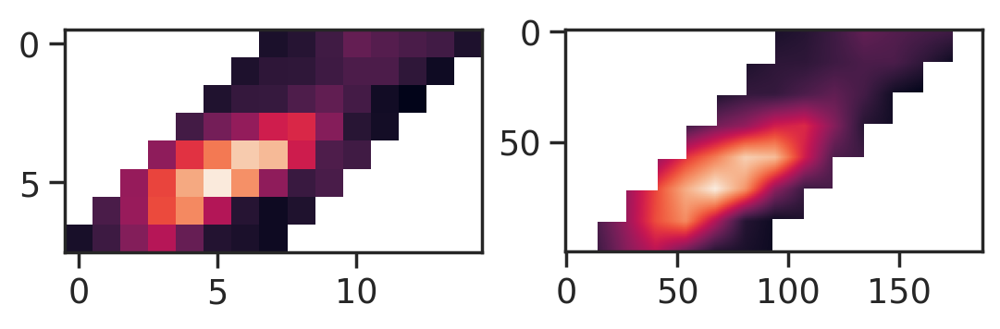

In [ ]:
plt.subplot(1,2,1)
plt.imshow(im_exp)
plt.subplot(1,2,2)
plt.imshow(a)

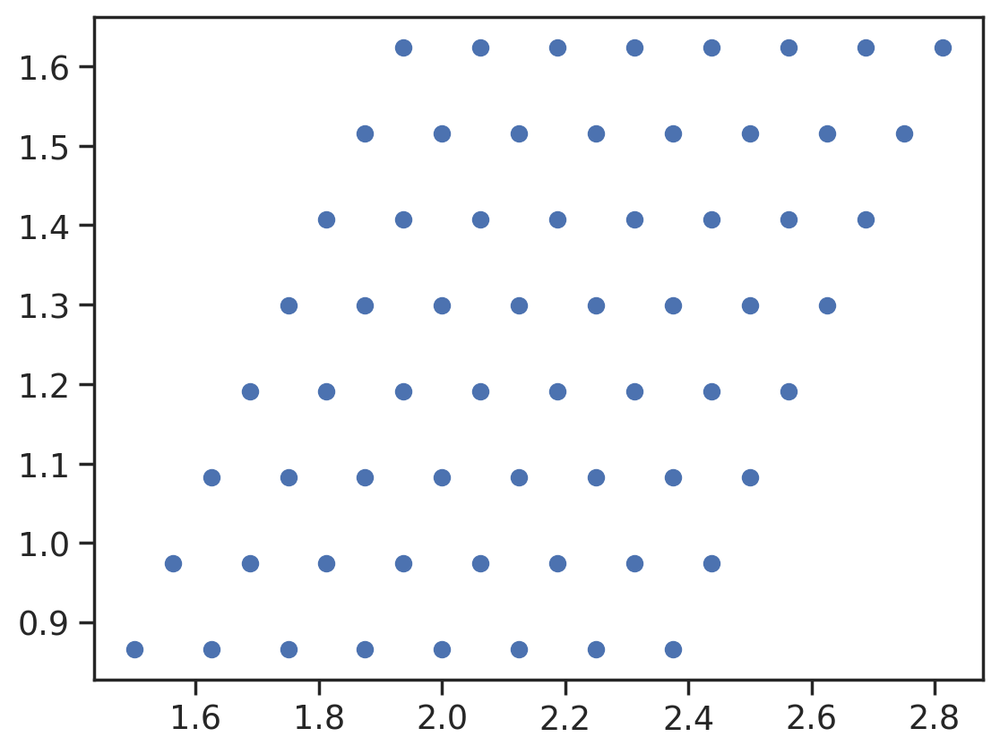

In [ ]:
plt.scatter(points2[0], points2[1])

In [ ]:
list(zip(u, v))

[(array([1.5   , 1.5625, 1.625 , 1.6875, 1.75  , 1.8125, 1.875 , 1.9375]),
  array([0.8660254 , 0.97427858, 1.08253175, 1.19078493, 1.29903811,
         1.40729128, 1.51554446, 1.62379763])),
 (array([1.625 , 1.6875, 1.75  , 1.8125, 1.875 , 1.9375, 2.    , 2.0625]),
  array([0.8660254 , 0.97427858, 1.08253175, 1.19078493, 1.29903811,
         1.40729128, 1.51554446, 1.62379763])),
 (array([1.75  , 1.8125, 1.875 , 1.9375, 2.    , 2.0625, 2.125 , 2.1875]),
  array([0.8660254 , 0.97427858, 1.08253175, 1.19078493, 1.29903811,
         1.40729128, 1.51554446, 1.62379763])),
 (array([1.875 , 1.9375, 2.    , 2.0625, 2.125 , 2.1875, 2.25  , 2.3125]),
  array([0.8660254 , 0.97427858, 1.08253175, 1.19078493, 1.29903811,
         1.40729128, 1.51554446, 1.62379763])),
 (array([2.    , 2.0625, 2.125 , 2.1875, 2.25  , 2.3125, 2.375 , 2.4375]),
  array([0.8660254 , 0.97427858, 1.08253175, 1.19078493, 1.29903811,
         1.40729128, 1.51554446, 1.62379763])),
 (array([2.125 , 2.1875, 2.25  , 2.3125,

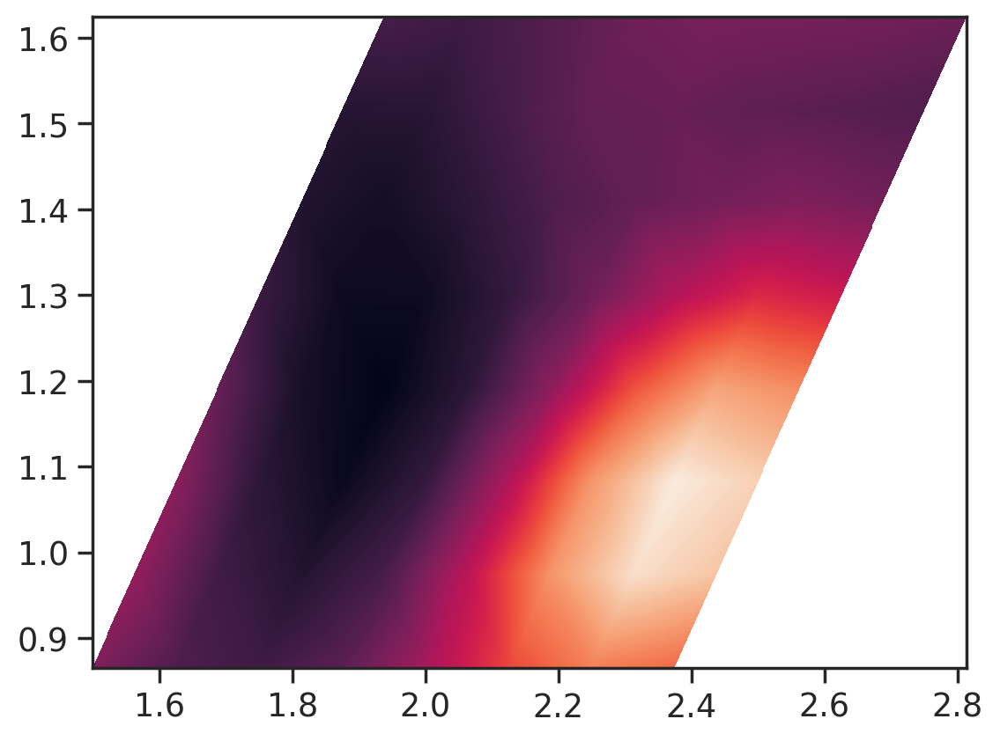

In [ ]:
from scipy.interpolate import LinearNDInterpolator

# rng = np.random.default_rng()
# x = rng.random(10) - 0.5
# y = rng.random(10) - 0.5
# z = np.hypot(x, y)
# X = np.linspace(min(x), max(x))
# Y = np.linspace(min(y), max(y))
# udiff = np.diff(u)[0,0]
# vdiff = np.diff(v)[0,0]
U = np.linspace(np.min(u.reshape(-1)), np.max(u.reshape(-1)), 1000)
V = np.linspace(np.min(v.reshape(-1)), np.max(v.reshape(-1)), 1000)

U, V = np.meshgrid(U, V)  # 2D grid for interpolation
interp = LinearNDInterpolator(list(zip(u.reshape(-1), v.reshape(-1))), im.reshape(-1))
Z = interp(U, V)
plt.pcolormesh(U, V, Z, shading='auto')
# plt.plot(u.reshape(-1), v.reshape(-1), "ok", label="input point")
# plt.legend()
# plt.colorbar()
# plt.axis("equal")
# plt.show()

In [ ]:
from scipy.interpolate import interpn
ulin=u.reshape(-1)
vlin=v.reshape(-1)

sort_i = np.argsort(ulin)

points2=(ulin[sort_i],vlin[sort_i])
xi2=[]

for i in range(100):
  for j in range(100):
    xi2.append([i/100, j/100])

xi2=np.array(xi2)

a=interpn(points2,im,xi2)
a=a.reshape(100,-1)

plt.imshow(a)

ValueError: The points in dimension 0 must be strictly ascending or descending

In [ ]:
udiff

array([0.0625, 0.0625, 0.0625, 0.0625, 0.0625, 0.0625, 0.0625])

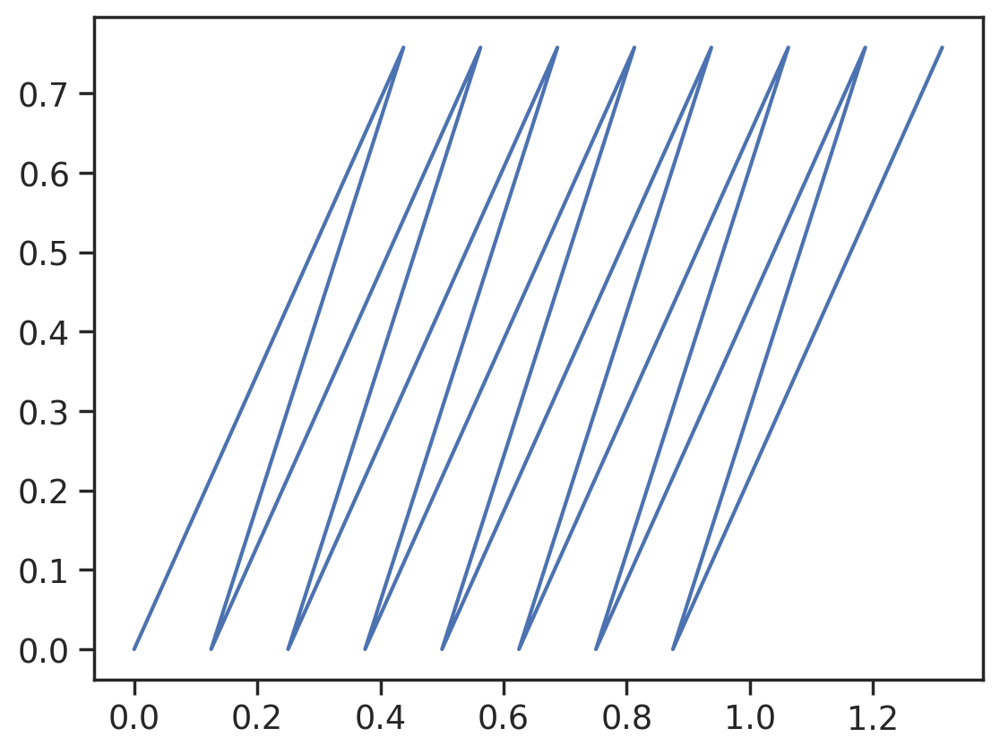

In [ ]:
plt.plot(ulin,vlin)

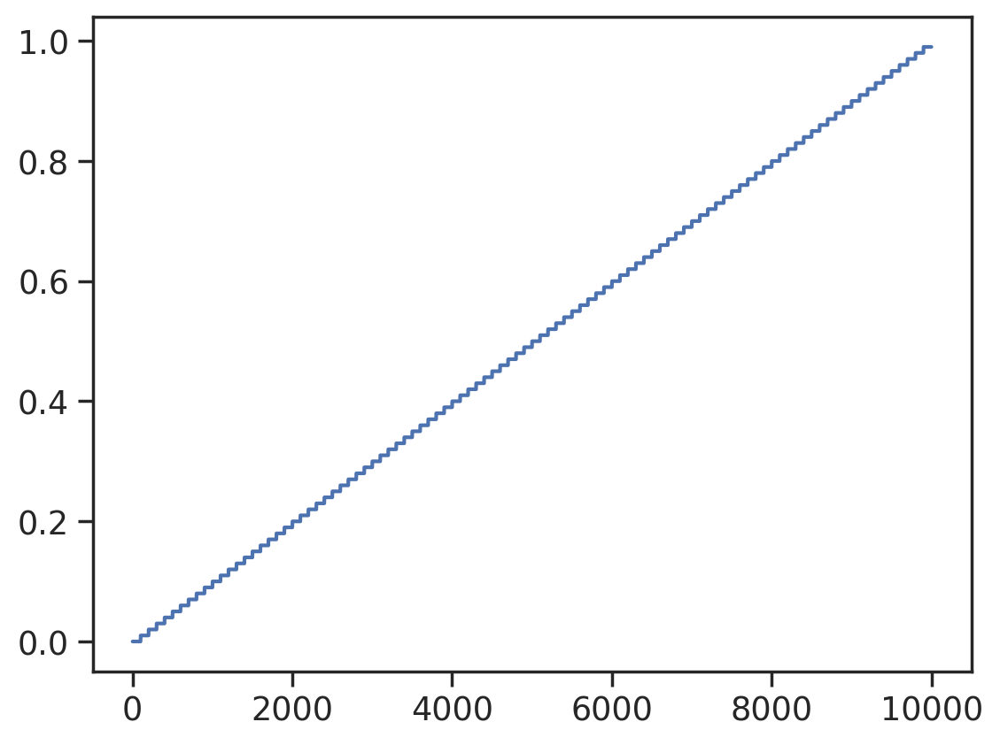

In [ ]:
plt.plot(xi2[:,0])

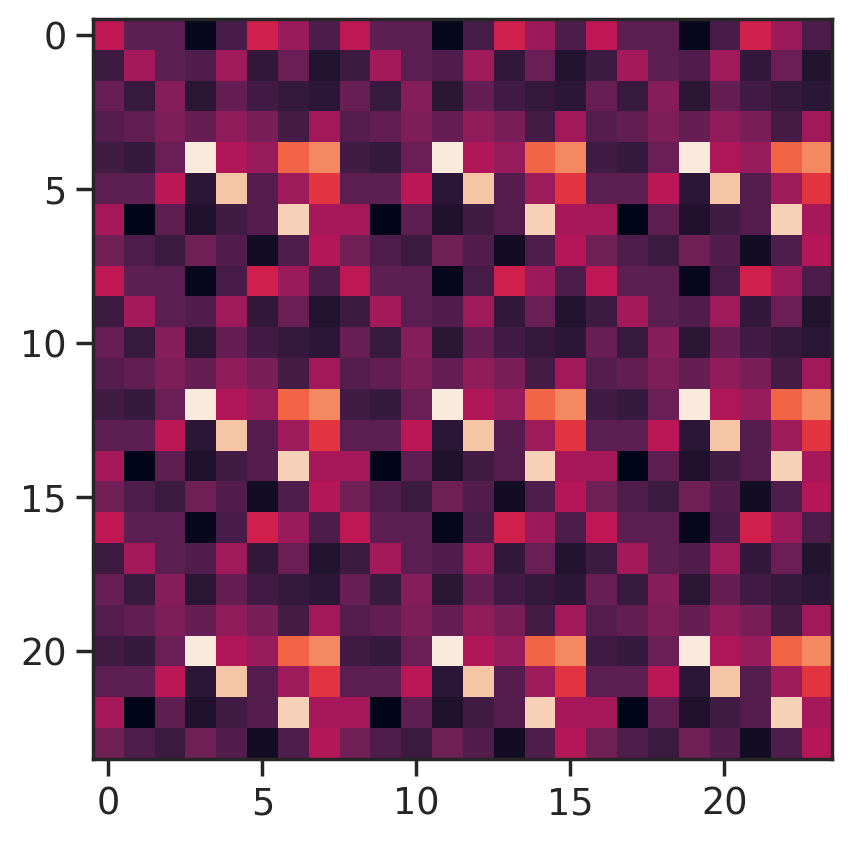

In [ ]:
# interpolate axes to get higher resolution image first,
# then can do integer shifts with 0 padding and then filter with symmetric gaussian

# yaxis sqrt3 and x just units of 1

# OR: don't interpolate and just use a filter that's tilted?

In [ ]:
u

In [ ]:
lv=np.tile(np.arange(0,vdiff*(newdimv),vdiff)[:-1], (newdimv,1))
lv.shape

(24, 24)

In [ ]:
np.arange(0,vdiff*(newdimv),vdiff).shape

(25,)

In [ ]:
vdiff*8

0.8660254037844386

In [ ]:
udiff

0.0625

(24, 24)

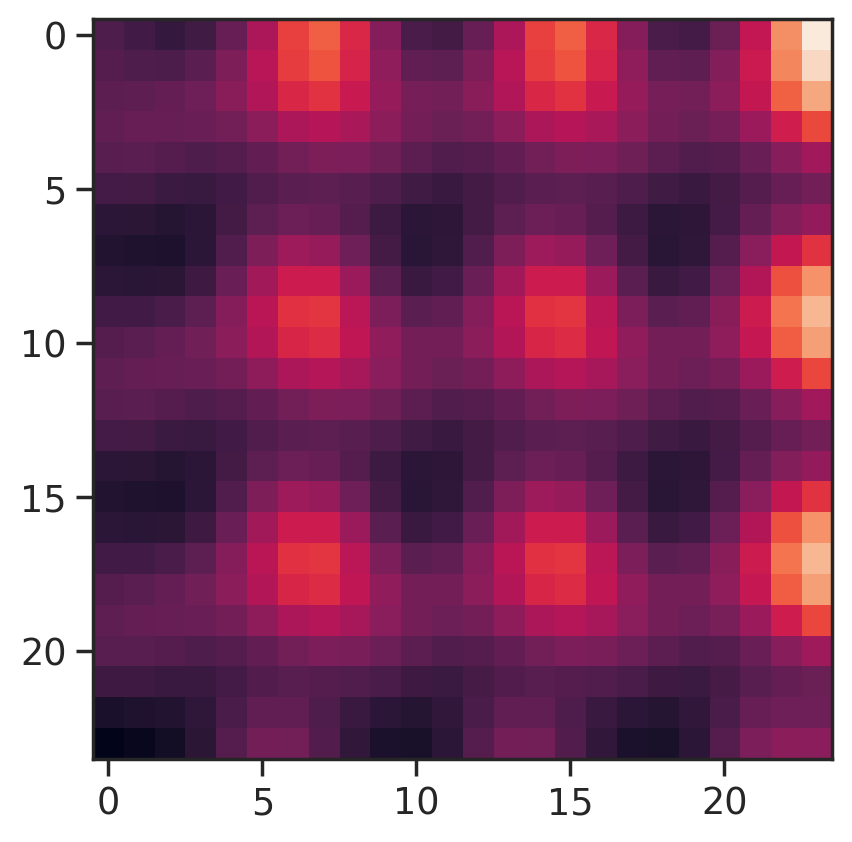

In [ ]:
plt.imshow(smooth_repim)

In [ ]:
np.tile()

(8, 8)

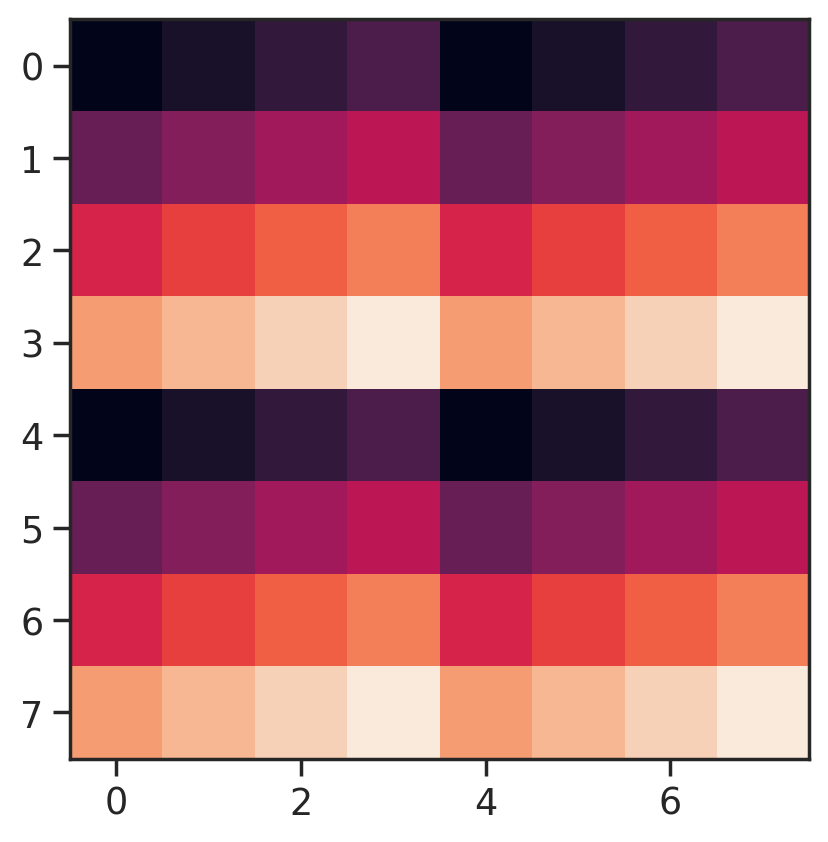

In [ ]:
a=np.arange(16).reshape(4,-1)
b=np.tile(a,(2,2))
plt.imshow(b)

In [ ]:
a.shape

(4, 4)

In [ ]:
trial_starts

In [ ]:
landmark_positions[0]

In [ ]:
landmark_positions[i+1][1]//2

In [ ]:
k

In [ ]:
i = 3
int(landmark_positions[i+1][1]/2)
k = int(landmark_positions[i+1][1]/2)
maps[grid_cell_idxs,trial_starts[i]:trial_starts[i+1]].mean(1)[:,np.maximum(0,k-5):k+5].shape

In [ ]:
k-5

In [ ]:
avg_sheetmaps = []
for j in range(5):
    plt.figure(figsize=(16,1))
    for i in range(1,12):
        plt.subplot(1,11,i)
        k = int(landmark_positions[i+1][j]/2)
        rm = maps[grid_cell_idxs,trial_starts[i]:trial_starts[i+1]].mean(1)[:,np.maximum(0,k-10):k+10].mean(-1)
        avg_sheetmaps.append(rm)
        im = rm[gridsort].reshape(resx,resy)
        plt.pcolormesh(u,v,im,shading='auto')
        plt.axis('off')

In [ ]:
avg_sheetmaps = np.stack(avg_sheetmaps).reshape(5,11,Ng)

In [ ]:
plt.figure(figsize=(15,2))
for i in range(5):
    plt.subplot(1,5,i+1)
    rm = avg_sheetmaps[i].mean(0)
    im = rm[gridsort].reshape(resx,resy)
    im = gaussian_filter(im, (0.75,0.75))
    plt.pcolormesh(u,v,im,shading='auto')
    plt.axis('off')

In [ ]:
plt.figure(figsize=(15,2))
for i in range(5):
    plt.subplot(1,5,i+1)
    rm = avg_sheetmaps[i].mean(0)
    im = rm[gridsort].reshape(resx,resy)
    plt.pcolormesh(u,v,im,shading='auto')
    plt.axis('off')

In [ ]:
fname

# Subspace analysis

In [ ]:
U = np.vstack([np.cos(phases1),np.sin(phases1),
               np.cos(phases2),np.sin(phases2),
               np.cos(phases3),np.sin(phases3),])
U,_ = np.linalg.qr(U.T)

In [ ]:
# z-score the full maps!
mean = raw_maps.reshape(N,-1).mean(-1,keepdims=True)
std = raw_maps.reshape(N,-1).std(-1,keepdims=True)
zmaps = ((raw_maps.reshape(N,-1) - mean)/std).reshape(N,ntrials,-1)

# smooth the maps
from scipy.ndimage import gaussian_filter1d
maps = gaussian_filter1d(zmaps.reshape(N,-1),4).reshape(N,ntrials,L)

In [ ]:
ss_maps = U.T@zmaps[grid_cell_idxs].reshape(Ng,-1)

In [ ]:
ss_frac = np.linalg.norm(ss_maps,axis=0) / np.linalg.norm(maps[grid_cell_idxs].reshape(Ng,-1),axis=0)
ss_frac = ss_frac.reshape(ntrials,L)

In [ ]:
plt.figure(figsize=(12,5))
plt.imshow(np.linalg.norm(maps,axis=0).T,aspect='auto')
plt.colorbar()

for j,trial in enumerate(trial_starts[:-1]):
    plt.axvline(trial,c='black',linestyle='dashed',linewidth=2)

    # Plot landmarks
    for j in range(len(landmark_positions)):         # BEN: un-hardcode num blocks
      for a,lm in enumerate(landmark_positions[j]):
        plt.axhline(lm/2,(trials_per_block[0]+(j-1)*trials_per_block[1])/ntrials,(trials_per_block[0]+j*trials_per_block[1])/ntrials,
                    c='C'+str(a),linewidth=2,linestyle='dashed')

In [ ]:
plt.figure(figsize=(12,5))
plt.imshow(ss_frac.T,aspect='auto',vmax=1,vmin=0.2)
plt.colorbar()

for j,trial in enumerate(trial_starts[:-1]):
    plt.axvline(trial,c='black',linestyle='dashed',linewidth=2)

    # Plot landmarks
    for j in range(len(landmark_positions)):         # BEN: un-hardcode num blocks
      for a,lm in enumerate(landmark_positions[j]):
        plt.axhline(lm/2,(trials_per_block[0]+(j-1)*trials_per_block[1])/ntrials,(trials_per_block[0]+j*trials_per_block[1])/ntrials,
                    c='C'+str(a),linewidth=2,linestyle='dashed')

In [ ]:
plt.figure(figsize=(12,5))
plt.imshow(ss_frac.T,aspect='auto')

for j,trial in enumerate(trial_starts[:-1]):
    plt.axvline(trial,c='black',linestyle='dashed',linewidth=2)

    # Plot landmarks
    for j in range(len(landmark_positions)):         # BEN: un-hardcode num blocks
      for a,lm in enumerate(landmark_positions[j]):
        plt.axhline(lm/2,(trials_per_block[0]+(j-1)*trials_per_block[1])/ntrials,(trials_per_block[0]+j*trials_per_block[1])/ntrials,
                    c='C'+str(a),linewidth=2,linestyle='dashed')

In [ ]:
frac_near_lm = []
frac_far_lm = []
for i in range(len(trial_starts)-2):
    lm_idxs = []
    for lm in landmark_positions[i+1][4:5]:
        lm_idxs.extend(np.arange(np.maximum(0,int(lm/2)-7),np.minimum(L,int(lm/2)+3)))
    non_lm_idxs = np.setxor1d(np.arange(L),lm_idxs)

    frac_near_lm.append(ss_frac[trial_starts[i]:trial_starts[i+1],lm_idxs])
    frac_far_lm.append(ss_frac[trial_starts[i]:trial_starts[i+1],non_lm_idxs])

In [ ]:
sns.distplot(np.stack(frac_near_lm).ravel(),kde=True)
sns.distplot(np.stack(frac_far_lm).ravel(),kde=True)
# plt.hist(np.stack(frac_far_lm).ravel())

In [ ]:
sns.distplot(np.stack(frac_near_lm).ravel(),kde=True)
sns.distplot(np.stack(frac_far_lm).ravel(),kde=True)
# plt.hist(np.stack(frac_far_lm).ravel())

In [ ]:
plt.figure(figsize=(12,5))
plt.imshow(ss_frac.T,aspect='auto')

for j,trial in enumerate(trial_starts[:-1]):
    plt.axvline(trial,c='black',linestyle='dashed',linewidth=2)

    # Plot landmarks
    for j in range(len(landmark_positions)):         # BEN: un-hardcode num blocks
      for a,lm in enumerate(landmark_positions[j]):
        plt.axhline(lm/2,(trials_per_block[0]+(j-1)*trials_per_block[1])/ntrials,(trials_per_block[0]+j*trials_per_block[1])/ntrials,
                    c='C'+str(a),linewidth=2,linestyle='dashed')